### Imports

In [1]:
import pickle as pkl
import pandas as pd
import numpy as np
from numpy import asarray as ar
import json
import os
import torch.optim as optim
import shap
from matplotlib import pyplot as plt
from time import time
from torch.autograd import Variable
from sklearn.cluster import KMeans
from scipy.stats.stats import pearsonr

#### Import model definitions

In [2]:
# %load /home/ninow/master_thesis/code/project/model/Baseline.py
import torch
import torch.nn as nn
import torch.nn.functional as F
import sys


class AbstractNetwork(nn.Module):
    n_station_features = 3
    n_time_features = 5

    def num_flat_features(self, x):
        size = x.size()[1:]  # all dimensions except the batch dimension
        num_features = 1
        for s in size:
            num_features *= s
        return num_features

    def getNumberOfAdditionalFeatures(self, useSTI, useTimeData):
        return (self.n_station_features if useSTI else 0) + (self.n_time_features if useTimeData else 0)

    def getAdditionaFeatureHandling(self, useSTI, useTimeData):
        if useSTI and useTimeData:
            return lambda x, time_features, station_data: torch.cat((x, time_features, station_data), 1)
        elif useSTI:
            return lambda x, _, station_data: torch.cat((x, station_data), 1)
        elif useTimeData:
            return lambda x, time_features, _: torch.cat((x, time_features), 1)
        else:
            return lambda x, *_: x


class CNN(AbstractNetwork):
    def conv_out_size(self, grid_in, grid_conv, stride):
        return int((grid_in - grid_conv) / stride + 1)


class CNN0L(CNN):
    def __init__(self, filter_conv1, grid_conv1, stride, n_parameters, n_time_invariant_parameters, n_grid,
                 useSTI, useTimeData, prediction_times):
        super(CNN0L, self).__init__()
        self.prediciton_times = prediction_times
        self.n_predictions = len(prediction_times)
        self.conv1 = nn.Conv2d(n_parameters + 1 + n_time_invariant_parameters, filter_conv1, grid_conv1)
        self.addNonGridFeatures = self.getAdditionaFeatureHandling(useSTI, useTimeData)
        self.fc1 = nn.Linear(
            filter_conv1 * (self.conv_out_size(n_grid, grid_conv1, stride) ** 2) + self.getNumberOfAdditionalFeatures(
                useSTI, useTimeData), self.n_predictions)

    def forward(self, x, time_features, station_features):
        x = F.relu(self.conv1(x))
        x = x.view(-1, self.num_flat_features(x))
        x = self.addNonGridFeatures(x, time_features, station_features)
        x = self.fc1(x)
        return x


class CNN1L(CNN0L):
    def __init__(self, filter_conv1, grid_conv1, stride, n_fc1, n_parameters, n_time_invariant_parameters, n_grid,
                 useSTI, useTimeData, prediction_times):
        super(CNN1L, self).__init__(filter_conv1, grid_conv1, stride, n_parameters, n_time_invariant_parameters,
                                    n_grid, useSTI, useTimeData, prediction_times)
        self.fc1 = nn.Linear(
            filter_conv1 * (self.conv_out_size(n_grid, grid_conv1, stride) ** 2) + self.getNumberOfAdditionalFeatures(
                useSTI, useTimeData), n_fc1)
        self.fc2 = nn.Linear(n_fc1, self.n_predictions)

    def forward(self, x, time_features, station_features):
        x = F.relu(super(CNN1L, self).forward(x, time_features, station_features))
        x = self.fc2(x)
        return x


class CNN2L(CNN1L):
    def __init__(self, filter_conv1, grid_conv1, stride, n_fc1, n_fc2, n_parameters, n_time_invariant_parameters,
                 n_grid,
                 useSTI, useTimeData, prediction_times):
        super(CNN2L, self).__init__(filter_conv1, grid_conv1, stride, n_fc1, n_parameters,
                                    n_time_invariant_parameters, n_grid,
                                    useSTI, useTimeData, prediction_times)
        self.fc2 = nn.Linear(n_fc1, n_fc2)
        self.fc3 = nn.Linear(n_fc2, self.n_predictions)

    def forward(self, x, time_features, station_features):
        x = F.relu(super(CNN2L, self).forward(x, time_features, station_features))
        x = self.fc3(x)
        return x


class FullyConnected1L(AbstractNetwork):
    def __init__(self, n_fc1, n_parameters, n_time_invariant_parameters, n_grid, useSTI, useTimeData, prediction_times):
        super(FullyConnected1L, self).__init__()
        self.prediciton_times = prediction_times
        self.n_predictions = len(prediction_times)
        # n_parameters: features of cosmo grid depending on lead time, 1: temperature of lead time = 0,
        # n_time_invariant_parameters: time invariant grid features such as soil type, fraction of land, height diff.
        # to station, etc.
        self.fc1 = nn.Linear((n_parameters + 1 + n_time_invariant_parameters) * (n_grid ** 2) + self.getNumberOfAdditionalFeatures(useSTI, useTimeData), n_fc1)
        self.addNonGridFeatures = self.getAdditionaFeatureHandling(useSTI, useTimeData)
        self.fc2 = nn.Linear(n_fc1, self.n_predictions)

    def forward(self, x, time_features, station_features):
        x = x.view(-1, self.num_flat_features(x))
        x = self.addNonGridFeatures(x, time_features, station_features)
        x = F.relu(self.fc1(x))
        x = self.fc2(x)
        return x


class FullyConnected2L(FullyConnected1L):
    def __init__(self, n_fc1, n_fc2, n_parameters, n_time_invariant_parameters, n_grid, useSTI,
                 useTimeData, prediction_times):
        super(FullyConnected2L, self).__init__(n_fc1, n_parameters, n_time_invariant_parameters, n_grid,
                                               useSTI, useTimeData, prediction_times)
        self.fc2 = nn.Linear(n_fc1 + self.getNumberOfAdditionalFeatures(useSTI, useTimeData), n_fc2)
        self.fc3 = nn.Linear(n_fc2, self.n_predictions)

    def forward(self, x, time_features, station_features):
        x = F.relu(super(FullyConnected2L, self).forward(x, time_features, station_features))
        x = self.fc3(x)
        return x


class FullyConnected3L(FullyConnected2L):
    def __init__(self, n_fc1, n_fc2, n_fc3, n_parameters, n_time_invariant_parameters, n_grid, useSTI,
                 useTimeData, prediction_times):
        super(FullyConnected3L, self).__init__(n_fc1, n_fc2, n_parameters, n_time_invariant_parameters, n_grid,
                                               useSTI, useTimeData, prediction_times)
        self.fc3 = nn.Linear(n_fc2, n_fc3)
        self.fc4 = nn.Linear(n_fc3, self.n_predictions)

    def forward(self, x, time_features, station_features):
        x = F.relu(super(FullyConnected3L, self).forward(x, time_features, station_features))
        x = self.fc4(x)
        return x

class FullyConnectedSingleGrid1L(AbstractNetwork):
    def __init__(self, n_fc1, n_parameters, n_time_invariant_parameters, useSTI, useTimeData, prediction_times, n_points=1, droupout_prob=0):
        super(FullyConnectedSingleGrid1L, self).__init__()
        self.prediciton_times = prediction_times
        self.n_predictions = len(prediction_times)
        # n_parameters: features of cosmo grid depending on lead time, 1: temperature of lead time = 0,
        # n_time_invariant_parameters: time invariant grid features such as soil type, fraction of land, height diff.
        # to station, etc.
        self.addNonGridFeatures = self.getAdditionaFeatureHandling(useSTI, useTimeData)
        self.fc1 = nn.Linear(((n_parameters + 1 + n_time_invariant_parameters) * n_points + self.getNumberOfAdditionalFeatures(useSTI, useTimeData)), n_fc1)
        self.fc2 = nn.Linear(n_fc1, self.n_predictions)
        self.dropout1 = nn.Dropout(p=droupout_prob)
        print('Model uses dropout probability: %s' % droupout_prob)

    def forward(self, x, time_features, station_features):
        try:
            # this awkward squeezing is necessary because we got problems, when the batch is randomly 1 (due to not
            # dividable training or test set size by the batch size)
            x = self.addNonGridFeatures(x.squeeze(dim=-1).squeeze(dim=-1), time_features, station_features)
        except RuntimeError:
            sys.stderr.write("Shapes X, time_features, station_features: " + str(x.shape) + str(time_features.shape) + str(station_features.shape))
            sys.stderr.write("X: " + str(x))
            sys.stderr.write("time_features: ", time_features)
            sys.stderr.write("station_features: ", station_features)
            raise

        x = x.view(-1, self.num_flat_features(x))
        x = F.relu(self.fc1(x))
        x = self.dropout1(x)
        x = self.fc2(x)
        return x


class FullyConnectedSingleGrid2L(FullyConnectedSingleGrid1L):
    def __init__(self, n_fc1, n_fc2, n_parameters, n_time_invariant_parameters, useSTI, useTimeData, prediction_times,n_points=1, droupout_prob=0):
        super(FullyConnectedSingleGrid2L, self).__init__(n_fc1, n_parameters, n_time_invariant_parameters,
                                               useSTI, useTimeData, prediction_times,n_points,droupout_prob=droupout_prob)
        self.fc2 = nn.Linear(n_fc1, n_fc2)
        self.fc3 = nn.Linear(n_fc2, self.n_predictions)
        self.dropout2 = nn.Dropout(p=droupout_prob)
        self.i = 0

    def forward(self, x, time_features, station_features):
        x = F.relu(super(FullyConnectedSingleGrid2L, self).forward(x, time_features, station_features))
        x = self.dropout2(x)
        x = self.fc3(x)
        self.i = self.i + 1
        return x


class FullyConnectedSingleGrid3L(FullyConnectedSingleGrid2L):
    def __init__(self, n_fc1, n_fc2, n_fc3, n_parameters, n_time_invariant_parameters, useSTI, useTimeData, prediction_times,n_points=1,droupout_prob=0):
        super(FullyConnectedSingleGrid3L, self).__init__(n_fc1, n_fc2, n_parameters, n_time_invariant_parameters,
                                               useSTI, useTimeData, prediction_times,n_points, droupout_prob=droupout_prob)
        self.fc3 = nn.Linear(n_fc2, n_fc3)
        self.fc4 = nn.Linear(n_fc3, self.n_predictions)
        self.dropout3 = nn.Dropout(p=droupout_prob)

    def forward(self, x, time_features, station_features):
        x = F.relu(super(FullyConnectedSingleGrid3L, self).forward(x, time_features, station_features))
        x = self.dropout3(x)
        x = self.fc4(x)
        return x


def model_factory(model_dict, params, time_invariant_params, grid, prediction_times):
    print(model_dict)
    # CNN
    if model_dict['type'] == 'CNN':
        if not 'fc_layers' in model_dict:
            return CNN0L(filter_conv1=model_dict['n_conv1'],
                         grid_conv1=model_dict['grid_conv1'],
                         stride=model_dict['stride'],
                         n_parameters=params,
                         n_time_invariant_parameters=time_invariant_params,
                         n_grid=grid,
                         useSTI=model_dict[
                             'station_time_invariant'] if 'station_time_invariant' in model_dict else True,
                         useTimeData=model_dict['useTimeData'] if 'useTimeData' in model_dict else True,
                         prediction_times=prediction_times)

        elif model_dict['fc_layers'] == 1:
            return CNN1L(filter_conv1=model_dict['n_conv1'],
                         grid_conv1=model_dict['grid_conv1'],
                         stride=model_dict['stride'],
                         n_fc1=model_dict['n_fc1'],
                         n_parameters=params,
                         n_time_invariant_parameters=time_invariant_params,
                         n_grid=grid,
                         useSTI=model_dict[
                             'station_time_invariant'] if 'station_time_invariant' in model_dict else True,
                         useTimeData=model_dict['useTimeData'] if 'useTimeData' in model_dict else True,
                         prediction_times=prediction_times)
        elif model_dict['fc_layers'] == 2:
            return CNN2L(filter_conv1=model_dict['n_conv1'],
                         grid_conv1=model_dict['grid_conv1'],
                         stride=model_dict['stride'],
                         n_fc1=model_dict['n_fc1'],
                         n_fc2=model_dict['n_fc2'],
                         n_parameters=params,
                         n_time_invariant_parameters=time_invariant_params,
                         n_grid=grid,
                         useSTI=model_dict[
                             'station_time_invariant'] if 'station_time_invariant' in model_dict else True,
                         useTimeData=model_dict['useTimeData'] if 'useTimeData' in model_dict else True,
                         prediction_times=prediction_times)

    # Fully connected network
    elif model_dict['type'] == 'FC':
        if grid == 1:
            if 'knn' in model_dict:
                n_points = 3
            else:
                n_points = 1
            if model_dict['fc_layers'] == 1:
                return FullyConnectedSingleGrid1L(n_fc1=model_dict['n_fc1'],
                                        n_parameters=params,
                                        n_time_invariant_parameters=time_invariant_params,
                                        useSTI=model_dict[
                                            'station_time_invariant'] if 'station_time_invariant' in model_dict else True,
                                        useTimeData=model_dict['useTimeData'] if 'useTimeData' in model_dict else True,
                                        prediction_times=prediction_times,
                                        n_points=n_points,
                                        droupout_prob=model_dict['dropout_prop'] if 'dropout_prop' in model_dict else 0)
            elif model_dict['fc_layers'] == 2:
                return FullyConnectedSingleGrid2L(n_fc1=model_dict['n_fc1'],
                                        n_fc2=model_dict['n_fc2'],
                                        n_parameters=params,
                                        n_time_invariant_parameters=time_invariant_params,
                                        useSTI=model_dict[
                                            'station_time_invariant'] if 'station_time_invariant' in model_dict else True,
                                        useTimeData=model_dict['useTimeData'] if 'useTimeData' in model_dict else True,
                                        prediction_times=prediction_times,
                                        n_points=n_points,
                                        droupout_prob=model_dict['dropout_prop'] if 'dropout_prop' in model_dict else 0)
            elif model_dict['fc_layers'] == 3:
                return FullyConnectedSingleGrid3L(n_fc1=model_dict['n_fc1'],
                                        n_fc2=model_dict['n_fc2'],
                                        n_fc3=model_dict['n_fc3'],
                                        n_parameters=params,
                                        n_time_invariant_parameters=time_invariant_params,
                                        useSTI=model_dict[
                                            'station_time_invariant'] if 'station_time_invariant' in model_dict else True,
                                        useTimeData=model_dict['useTimeData'] if 'useTimeData' in model_dict else True,
                                        prediction_times=prediction_times,
                                        n_points=n_points,
                                        droupout_prob=model_dict['dropout_prop'] if 'dropout_prop' in model_dict else 0)

        else:
            if model_dict['fc_layers'] == 1:
                return FullyConnected1L(n_fc1=model_dict['n_fc1'],
                                        n_parameters=params,
                                        n_time_invariant_parameters=time_invariant_params,
                                        n_grid=grid,
                                        useSTI=model_dict[
                                            'station_time_invariant'] if 'station_time_invariant' in model_dict else True,
                                        useTimeData=model_dict['useTimeData'] if 'useTimeData' in model_dict else True,
                                        prediction_times=prediction_times)
            elif model_dict['fc_layers'] == 2:
                return FullyConnected2L(n_fc1=model_dict['n_fc1'],
                                        n_fc2=model_dict['n_fc2'],
                                        n_parameters=params,
                                        n_time_invariant_parameters=time_invariant_params,
                                        n_grid=grid,
                                        useSTI=model_dict[
                                            'station_time_invariant'] if 'station_time_invariant' in model_dict else True,
                                        useTimeData=model_dict['useTimeData'] if 'useTimeData' in model_dict else True,
                                        prediction_times=prediction_times)
            elif model_dict['fc_layers'] == 3:
                return FullyConnected3L(n_fc1=model_dict['n_fc1'],
                                        n_fc2=model_dict['n_fc2'],
                                        n_fc3=model_dict['n_fc3'],
                                        n_parameters=params,
                                        n_time_invariant_parameters=time_invariant_params,
                                        n_grid=grid,
                                        useSTI=model_dict[
                                            'station_time_invariant'] if 'station_time_invariant' in model_dict else True,
                                        useTimeData=model_dict['useTimeData'] if 'useTimeData' in model_dict else True,
                                        prediction_times=prediction_times)

    raise Exception('No matching model found for name \"%s\"' % model_dict['name'])


### Helper methods for feature correlation calculation

In [87]:
# return a data frame with each feature (named by columns)
# and it's position in a array sorted by feature importance
def getImportanceIdxByFeature(shap_values, columns):
    # remove base value
    shap_values = shap_values[:,:-1]
    # remove Init, Station and Target
    columns = columns[2:-2]
    sum_absolute_inportance_per_feature = np.sum(np.absolute(shap_values),axis=0)
    position_array = np.zeros((30,))
    for idx, pos in list(zip(np.argsort(sum_absolute_inportance_per_feature)[::-1], np.arange(0,30))):
        position_array[idx] = pos
    return pd.DataFrame(data=position_array[None,...], columns=columns, dtype=int)

# return a data frame with the absolute importance per feature
def getMeanAbsoluteImportanceByFeature(shap_values, columns):
    # remove base value
    shap_values = shap_values[:,:-1]
    # remove Init, Station and Target
    columns = columns[2:-2]
    sum_absolute_inportance_per_feature = np.mean(np.absolute(shap_values),axis=0)
    return pd.DataFrame(data=sum_absolute_inportance_per_feature[None,...], columns=columns, dtype=float)

In [4]:
# print the JS visualization code to the notebook
shap.initjs()

### Get input data

In [102]:
config = pkl.load(open('/mnt/ds3lab-scratch/ninow/final_results/network/model_predictions/knn_1/shap/config.pkl', 'rb'))
config['experiment_path'] = '/mnt/ds3lab-scratch/ninow/final_results/network/model_predictions/error_label'
model = config['model']
model['path'] = '/mnt/ds3lab-scratch/ninow/final_results/network/model_predictions/error_label/models/FC_L3_1024_256_64_TD_GTI_STI.txt'
config['model'] = model
config['trained_model_output_path'] = '/mnt/ds3lab-scratch/ninow/final_results/network/model_predictions/error_label/FC_L3_1024_256_64_TD_GTI_STI_grid_1_bs_64_tf_0.1_optim_sgd_lr_0.0005_sl_24/'

In [6]:
# load network ready data
train_data = pd.read_pickle('/mnt/ds3lab-scratch/ninow/preprocessed_data/network_ready_data/train_data')
test_data = pd.read_pickle('/mnt/ds3lab-scratch/ninow/preprocessed_data/network_ready_data/test_data')

In [8]:
# Define feature names for nicer SHAP plots
column_names = ['Init', 'Station', 'Pressure', 'Wind U-Comp.', 'Wind V-Comp.',
       'Wind VMAX', '2m-Temperature', 'Temp. of Dew Point',
       'Cloud Coverage (High)', 'Cloud Coverage (Medium)',
       'Cloud Coverage (Low)', 'Tot. Precipitation', 'ALB_RAD', 'ASAB', 'ATHB',
       'HPBL', '2m-Temperature (Lead=0)', 'Grid Height',
       'Grid-Station Height Diff.', 'Fraction of Land', 'Soiltype',
       'Latitiude', 'Longitued', 'Grid-Station 2d Distance', 'Station Height',
       'Station Latitude', 'Station Longitude', 'Hour (Cosine)', 'Hour (Sine)',
       'Month (Cosine)', 'Month (Sine)', 'Lead-Time', 'Target 2m-Temp.']

In [9]:
# load station positions to plot them on map
station_data = pkl.load(open('/mnt/ds3lab-scratch/ninow/preprocessed_data/station/grid_size_1/time_invariant_data_per_station.pkl','rb'))
station_positions = station_data.station_position.sel(positinal_attribute = ['rlat', 'rlon','height_raw'])
stations = station_data.station
station_names = station_data.station_name

# mapping of station idx to station position in array representation
station_idx_mapping = {}
for s_idx, s in enumerate(stations.data):
    station_idx_mapping[s] = s_idx

In [11]:
# load complete grid data for 19.06.2016 03:00
with open('/home/ninow/master_thesis/code/project/results/feature_interpretation/complete_674_1058_preprocessed_grid_data_flat.pkl', 'rb') as handle:
    complete_grid_data = pkl.load(handle)
# create pandas data frame
complete_grid_data_set = pd.DataFrame(data=complete_grid_data, columns=train_data.columns[2:-2])

## Define wrapper to use pytorch NN

In [13]:
def network_output_wrapper(net, X):
    print(net)
    grid_data = getVariable(torch.Tensor(X[:,:22])).float()
    if X.shape[1] >= 30:
        station_time_inv_input = getVariable(torch.Tensor(X[:,22:25])).float()
    else:
        station_time_inv_input = None
    time_data = getVariable(torch.Tensor(X[:,-5:])).float()
    return net(grid_data, time_data, station_time_inv_input).data.cpu().numpy()

# wrapper for pytorch network output
f = lambda X: network_output_wrapper(net=net, X=X)

In [14]:
def getVariable(tensor):
    if torch.cuda.is_available():
        input = Variable(tensor.cuda())
    else:
        input = Variable(tensor)
    return input

In [15]:
def load_checkpoint(path, model, optimizer):
    file_path = path + '/model_best.pth.tar'
    if os.path.isfile(file_path):
        print("Loading checkpoint from: %s" % file_path)
        checkpoint = torch.load(file_path)
        epoch = checkpoint['epoch'] + 1
        best_epoch_test_rmse = checkpoint['best_epoch_test_rmse']
        model.load_state_dict(checkpoint['state_dict'])
        optimizer.load_state_dict(checkpoint['optimizer'])
        print("Loaded checkpoint with best test rmse %s (epoch %s)" % (best_epoch_test_rmse, checkpoint['epoch']))
    else:
        raise Exception("No checkpoint found at %s" % file_path)
    return model, optimizer, epoch, best_epoch_test_rmse

## Load trained network

In [103]:
# assign all program arguments to local variables
with open(config['model']['path']) as handle:
    ModelDict = json.loads(handle.read())

# initialize network, optimizer and loss function
net = model_factory(model_dict=ModelDict, params=len(config['input_parameters']),
                             time_invariant_params=len(config['grid_time_invariant_parameters']),
                             grid=config['grid_size'], prediction_times=config['prediction_times'])

# get optimizer config
optimizer_config = config['optimizer']

# if not explicitly specified, don't use regularization
if 'weight_decay' not in optimizer_config: optimizer_config['weight_decay'] = 0

optimizer = torch.optim.SGD(net.parameters(), lr=optimizer_config['learning_rate'],
                            momentum=optimizer_config['momentum'], weight_decay=optimizer_config['weight_decay'])


net, optimizer, *_ = load_checkpoint(config['trained_model_output_path'] + '/stored_models/run_0', model=net,
                                                optimizer=optimizer)

if torch.cuda.is_available():
    net.cuda()

# we do not train, but only output the evaluation of the network on train and test data
net.eval()

{'fc_layers': 3, 'time_data': True, 'grid_time_invariant': True, 'name': 'FC_L3_1024_256_64_TD_GTI_STI', 'n_fc1': 1024, 'layers': 3, 'type': 'FC', 'n_fc3': 64, 'station_time_invariant': True, 'n_fc2': 256}
Model uses dropout probability: 0
Loading checkpoint from: /mnt/ds3lab-scratch/ninow/final_results/network/model_predictions/error_label/FC_L3_1024_256_64_TD_GTI_STI_grid_1_bs_64_tf_0.1_optim_sgd_lr_0.0005_sl_24//stored_models/run_0/model_best.pth.tar
Loaded checkpoint with best test rmse 1.2687412554348299 (epoch 27)


FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)

# Set mode to generation of shapley values or use existing

In [17]:
load_existing=True
# this parameter is for differnet representations in the summary plot
plot_type = 'dot' # 'dot' / 'violin'

# Experiment with all data

### Prepare data

In [29]:
# fix seed to randomly sample 1000 samples from ~1M train points
seed = 17257
# select randomly points from training set to train explanation model
#explanation_training_set = train_data.sample(n=100000, random_state=seed)
explanation_training_set = train_data
explanation_training_data = explanation_training_set.iloc[:,2:-2]
# select randomly test points from test set to calculate SHAP values
shap_test_set = test_data.sample(n=5000, random_state=seed)
shap_test_data = shap_test_set.iloc[:,2:-2]

### Calculate 200 training centroids (the more training points/centroids as reference are used, the longer takes the SHAP value calculation

In [30]:
start = time()
dense_train_data = shap.kmeans(explanation_training_data, 200)
print("Run Time for KMeans: %ss" % str(time() - start))

Run Time for KMeans: 3311.462240457535s


In [31]:
# define KernelShap explainer
explainer = shap.KernelExplainer(f, dense_train_data)

Using 200 background data samples could cause slower run times. Consider using shap.kmeans(data, K) to summarize the background as K weighted samples.


FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


### Calculate or load SHAP values

In [ ]:
if load_existing:
    with open('/mnt/ds3lab-scratch/ninow/final_results/network/model_predictions/knn_1/shap/shap_values_all_train_k_200_test_5000_nsamples_150.pkl','rb') as handle:
        all_data_shap_values = pkl.load(handle)    
else:
    all_data_shap_values = explainer.shap_values(shap_test_data, nsamples=150)

In [32]:
all_data_shap_values = explainer.shap_values(shap_test_data, nsamples=150)

  0%|          | 0/5000 [00:00<?, ?it/s]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


  0%|          | 1/5000 [00:01<1:40:49,  1.21s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  0%|          | 2/5000 [00:02<1:42:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  0%|          | 3/5000 [00:03<1:43:34,  1.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  0%|          | 4/5000 [00:04<1:43:53,  1.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  0%|          | 5/5000 [00:06<1:43:56,  1.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  0%|          | 6/5000 [00:07<1:43:58,  1.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  0%|          | 7/5000 [00:08<1:44:14,  1.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  0%|          | 8/5000 [00:09<1:43:58,  1.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  0%|          | 9/5000 [00:11<1:43:47,  1.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  0%|          | 10/5000 [00:12<1:43:36,  1.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  0%|          | 11/5000 [00:13<1:43:19,  1.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  0%|          | 12/5000 [00:14<1:43:25,  1.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  0%|          | 13/5000 [00:16<1:43:20,  1.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  0%|          | 14/5000 [00:17<1:43:07,  1.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  0%|          | 15/5000 [00:18<1:43:03,  1.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  0%|          | 16/5000 [00:19<1:43:00,  1.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  0%|          | 17/5000 [00:21<1:42:49,  1.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  0%|          | 18/5000 [00:22<1:42:41,  1.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  0%|          | 19/5000 [00:23<1:42:36,  1.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  0%|          | 20/5000 [00:24<1:42:31,  1.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  0%|          | 21/5000 [00:25<1:42:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  0%|          | 22/5000 [00:27<1:42:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  0%|          | 23/5000 [00:28<1:42:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  0%|          | 24/5000 [00:29<1:42:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  0%|          | 25/5000 [00:30<1:42:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 26/5000 [00:32<1:42:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 27/5000 [00:33<1:42:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 28/5000 [00:34<1:41:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 29/5000 [00:35<1:41:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 30/5000 [00:36<1:41:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 31/5000 [00:38<1:41:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 32/5000 [00:39<1:41:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 33/5000 [00:40<1:41:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 34/5000 [00:41<1:41:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 35/5000 [00:43<1:41:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 36/5000 [00:44<1:41:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 37/5000 [00:45<1:41:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 38/5000 [00:46<1:41:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 39/5000 [00:47<1:41:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 40/5000 [00:49<1:41:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 41/5000 [00:50<1:41:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 42/5000 [00:51<1:41:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 43/5000 [00:52<1:41:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 44/5000 [00:54<1:41:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 45/5000 [00:55<1:41:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 46/5000 [00:56<1:41:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 47/5000 [00:57<1:41:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 48/5000 [00:59<1:41:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 49/5000 [01:00<1:41:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 50/5000 [01:01<1:41:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 51/5000 [01:02<1:41:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 52/5000 [01:04<1:41:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 53/5000 [01:05<1:41:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 54/5000 [01:06<1:41:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 55/5000 [01:07<1:41:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 56/5000 [01:08<1:41:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 57/5000 [01:10<1:41:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 58/5000 [01:11<1:41:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 59/5000 [01:12<1:41:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 60/5000 [01:13<1:41:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 61/5000 [01:15<1:41:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 62/5000 [01:16<1:41:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|▏         | 63/5000 [01:17<1:41:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|▏         | 64/5000 [01:18<1:41:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|▏         | 65/5000 [01:20<1:41:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|▏         | 66/5000 [01:21<1:41:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|▏         | 67/5000 [01:22<1:41:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|▏         | 68/5000 [01:23<1:41:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|▏         | 69/5000 [01:24<1:41:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|▏         | 70/5000 [01:26<1:41:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|▏         | 71/5000 [01:27<1:41:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|▏         | 72/5000 [01:28<1:41:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|▏         | 73/5000 [01:29<1:41:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|▏         | 74/5000 [01:31<1:41:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 75/5000 [01:32<1:41:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 76/5000 [01:33<1:41:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 77/5000 [01:34<1:41:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 78/5000 [01:36<1:41:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 79/5000 [01:37<1:41:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 80/5000 [01:38<1:41:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 81/5000 [01:39<1:41:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 82/5000 [01:41<1:41:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 83/5000 [01:42<1:41:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 84/5000 [01:43<1:41:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 85/5000 [01:44<1:41:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 86/5000 [01:46<1:40:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 87/5000 [01:47<1:40:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 88/5000 [01:48<1:40:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 89/5000 [01:49<1:40:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 90/5000 [01:50<1:40:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 91/5000 [01:52<1:40:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 92/5000 [01:53<1:40:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 93/5000 [01:54<1:40:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 94/5000 [01:55<1:40:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 95/5000 [01:57<1:40:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 96/5000 [01:58<1:40:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 97/5000 [01:59<1:40:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 98/5000 [02:01<1:40:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 99/5000 [02:02<1:40:54,  1.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 100/5000 [02:03<1:40:53,  1.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 101/5000 [02:04<1:40:53,  1.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 102/5000 [02:06<1:40:51,  1.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 103/5000 [02:07<1:40:49,  1.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 104/5000 [02:08<1:40:47,  1.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 105/5000 [02:09<1:40:45,  1.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 106/5000 [02:10<1:40:45,  1.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 107/5000 [02:12<1:40:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 108/5000 [02:13<1:40:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 109/5000 [02:14<1:40:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 110/5000 [02:15<1:40:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 111/5000 [02:17<1:40:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 112/5000 [02:18<1:40:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 113/5000 [02:19<1:40:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 114/5000 [02:20<1:40:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 115/5000 [02:21<1:40:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 116/5000 [02:23<1:40:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 117/5000 [02:24<1:40:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 118/5000 [02:25<1:40:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 119/5000 [02:26<1:40:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 120/5000 [02:28<1:40:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 121/5000 [02:29<1:40:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 122/5000 [02:30<1:40:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 123/5000 [02:31<1:40:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 124/5000 [02:32<1:40:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▎         | 125/5000 [02:34<1:40:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 126/5000 [02:35<1:40:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 127/5000 [02:36<1:40:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 128/5000 [02:37<1:40:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 129/5000 [02:39<1:40:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 130/5000 [02:40<1:40:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 131/5000 [02:41<1:40:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 132/5000 [02:42<1:40:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 133/5000 [02:44<1:40:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 134/5000 [02:45<1:40:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 135/5000 [02:46<1:40:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 136/5000 [02:47<1:40:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 137/5000 [02:49<1:40:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 138/5000 [02:50<1:40:06,  1.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 139/5000 [02:51<1:40:04,  1.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 140/5000 [02:52<1:40:02,  1.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 141/5000 [02:54<1:40:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 142/5000 [02:55<1:39:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 143/5000 [02:56<1:39:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 144/5000 [02:57<1:39:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 145/5000 [02:59<1:39:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 146/5000 [03:00<1:39:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 147/5000 [03:01<1:39:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 148/5000 [03:02<1:39:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 149/5000 [03:03<1:39:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 150/5000 [03:05<1:39:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 151/5000 [03:06<1:39:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 152/5000 [03:07<1:39:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 153/5000 [03:08<1:39:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 154/5000 [03:10<1:39:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 155/5000 [03:11<1:39:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 156/5000 [03:12<1:39:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 157/5000 [03:13<1:39:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 158/5000 [03:14<1:39:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 159/5000 [03:16<1:39:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 160/5000 [03:17<1:39:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 161/5000 [03:18<1:39:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 162/5000 [03:19<1:39:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 163/5000 [03:21<1:39:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 164/5000 [03:22<1:39:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 165/5000 [03:23<1:39:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 166/5000 [03:24<1:39:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 167/5000 [03:25<1:39:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 168/5000 [03:27<1:39:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 169/5000 [03:28<1:39:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 170/5000 [03:29<1:39:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 171/5000 [03:30<1:39:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 172/5000 [03:32<1:39:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 173/5000 [03:33<1:39:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 174/5000 [03:34<1:39:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▎         | 175/5000 [03:35<1:39:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▎         | 176/5000 [03:37<1:39:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▎         | 177/5000 [03:38<1:39:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▎         | 178/5000 [03:39<1:39:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▎         | 179/5000 [03:40<1:39:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▎         | 180/5000 [03:41<1:39:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▎         | 181/5000 [03:43<1:39:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▎         | 182/5000 [03:44<1:38:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▎         | 183/5000 [03:45<1:38:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▎         | 184/5000 [03:46<1:38:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▎         | 185/5000 [03:48<1:38:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▎         | 186/5000 [03:49<1:38:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▎         | 187/5000 [03:50<1:38:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 188/5000 [03:51<1:38:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 189/5000 [03:52<1:38:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 190/5000 [03:54<1:38:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 191/5000 [03:55<1:38:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 192/5000 [03:56<1:38:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 193/5000 [03:57<1:38:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 194/5000 [03:59<1:38:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 195/5000 [04:00<1:38:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 196/5000 [04:01<1:38:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 197/5000 [04:02<1:38:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 198/5000 [04:03<1:38:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 199/5000 [04:05<1:38:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 200/5000 [04:06<1:38:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 201/5000 [04:07<1:38:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 202/5000 [04:08<1:38:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 203/5000 [04:09<1:38:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 204/5000 [04:11<1:38:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 205/5000 [04:12<1:38:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 206/5000 [04:13<1:38:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 207/5000 [04:14<1:38:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 208/5000 [04:16<1:38:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 209/5000 [04:17<1:38:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 210/5000 [04:18<1:38:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 211/5000 [04:19<1:38:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 212/5000 [04:21<1:38:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 213/5000 [04:22<1:38:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 214/5000 [04:23<1:38:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 215/5000 [04:24<1:38:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 216/5000 [04:26<1:38:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 217/5000 [04:27<1:38:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 218/5000 [04:28<1:38:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 219/5000 [04:29<1:38:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 220/5000 [04:31<1:38:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 221/5000 [04:32<1:38:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 222/5000 [04:33<1:38:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 223/5000 [04:34<1:38:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 224/5000 [04:35<1:38:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 225/5000 [04:37<1:38:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▍         | 226/5000 [04:38<1:38:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▍         | 227/5000 [04:39<1:38:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▍         | 228/5000 [04:41<1:38:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▍         | 229/5000 [04:42<1:38:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▍         | 230/5000 [04:43<1:38:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▍         | 231/5000 [04:44<1:37:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▍         | 232/5000 [04:46<1:37:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▍         | 233/5000 [04:47<1:37:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▍         | 234/5000 [04:48<1:37:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▍         | 235/5000 [04:49<1:37:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▍         | 236/5000 [04:51<1:37:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▍         | 237/5000 [04:52<1:37:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▍         | 238/5000 [04:53<1:37:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▍         | 239/5000 [04:54<1:37:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▍         | 240/5000 [04:55<1:37:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▍         | 241/5000 [04:57<1:37:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▍         | 242/5000 [04:58<1:37:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▍         | 243/5000 [04:59<1:37:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▍         | 244/5000 [05:00<1:37:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▍         | 245/5000 [05:02<1:37:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▍         | 246/5000 [05:03<1:37:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▍         | 247/5000 [05:04<1:37:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▍         | 248/5000 [05:05<1:37:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▍         | 249/5000 [05:06<1:37:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▌         | 250/5000 [05:08<1:37:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▌         | 251/5000 [05:09<1:37:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▌         | 252/5000 [05:10<1:37:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▌         | 253/5000 [05:11<1:37:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▌         | 254/5000 [05:13<1:37:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▌         | 255/5000 [05:14<1:37:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▌         | 256/5000 [05:15<1:37:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▌         | 257/5000 [05:16<1:37:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▌         | 258/5000 [05:17<1:37:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▌         | 259/5000 [05:19<1:37:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▌         | 260/5000 [05:20<1:37:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▌         | 261/5000 [05:21<1:37:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▌         | 262/5000 [05:22<1:37:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▌         | 263/5000 [05:24<1:37:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▌         | 264/5000 [05:25<1:37:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▌         | 265/5000 [05:26<1:37:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▌         | 266/5000 [05:27<1:37:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▌         | 267/5000 [05:29<1:37:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▌         | 268/5000 [05:30<1:37:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▌         | 269/5000 [05:31<1:37:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▌         | 270/5000 [05:32<1:37:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▌         | 271/5000 [05:34<1:37:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▌         | 272/5000 [05:35<1:37:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▌         | 273/5000 [05:36<1:37:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▌         | 274/5000 [05:37<1:37:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 275/5000 [05:38<1:37:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 276/5000 [05:40<1:37:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 277/5000 [05:41<1:37:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 278/5000 [05:42<1:36:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 279/5000 [05:43<1:36:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 280/5000 [05:45<1:36:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 281/5000 [05:46<1:36:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 282/5000 [05:47<1:36:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 283/5000 [05:48<1:36:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 284/5000 [05:50<1:36:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 285/5000 [05:51<1:36:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 286/5000 [05:52<1:36:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 287/5000 [05:53<1:36:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 288/5000 [05:55<1:36:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 289/5000 [05:56<1:36:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 290/5000 [05:57<1:36:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 291/5000 [05:58<1:36:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 292/5000 [06:00<1:36:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 293/5000 [06:01<1:36:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 294/5000 [06:02<1:36:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 295/5000 [06:03<1:36:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 296/5000 [06:05<1:36:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 297/5000 [06:06<1:36:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 298/5000 [06:07<1:36:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 299/5000 [06:08<1:36:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 300/5000 [06:10<1:36:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 301/5000 [06:11<1:36:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 302/5000 [06:12<1:36:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 303/5000 [06:13<1:36:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 304/5000 [06:15<1:36:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 305/5000 [06:16<1:36:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 306/5000 [06:17<1:36:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 307/5000 [06:18<1:36:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 308/5000 [06:19<1:36:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 309/5000 [06:21<1:36:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 310/5000 [06:22<1:36:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 311/5000 [06:23<1:36:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 312/5000 [06:24<1:36:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▋         | 313/5000 [06:26<1:36:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▋         | 314/5000 [06:27<1:36:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▋         | 315/5000 [06:28<1:36:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▋         | 316/5000 [06:29<1:36:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▋         | 317/5000 [06:31<1:36:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▋         | 318/5000 [06:32<1:36:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▋         | 319/5000 [06:33<1:36:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▋         | 320/5000 [06:34<1:36:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▋         | 321/5000 [06:35<1:36:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▋         | 322/5000 [06:37<1:36:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▋         | 323/5000 [06:38<1:36:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▋         | 324/5000 [06:39<1:36:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▋         | 325/5000 [06:40<1:36:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 326/5000 [06:41<1:36:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 327/5000 [06:43<1:36:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 328/5000 [06:44<1:36:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 329/5000 [06:45<1:35:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 330/5000 [06:46<1:35:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 331/5000 [06:48<1:35:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 332/5000 [06:49<1:35:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 333/5000 [06:50<1:35:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 334/5000 [06:51<1:35:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 335/5000 [06:52<1:35:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 336/5000 [06:54<1:35:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 337/5000 [06:55<1:35:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 338/5000 [06:56<1:35:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 339/5000 [06:57<1:35:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 340/5000 [06:59<1:35:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 341/5000 [07:00<1:35:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 342/5000 [07:01<1:35:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 343/5000 [07:02<1:35:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 344/5000 [07:04<1:35:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 345/5000 [07:05<1:35:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 346/5000 [07:06<1:35:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 347/5000 [07:07<1:35:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 348/5000 [07:09<1:35:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 349/5000 [07:10<1:35:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 350/5000 [07:11<1:35:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 351/5000 [07:12<1:35:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 352/5000 [07:14<1:35:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 353/5000 [07:15<1:35:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 354/5000 [07:16<1:35:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 355/5000 [07:17<1:35:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 356/5000 [07:18<1:35:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 357/5000 [07:20<1:35:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 358/5000 [07:21<1:35:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 359/5000 [07:22<1:35:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 360/5000 [07:23<1:35:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 361/5000 [07:25<1:35:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 362/5000 [07:26<1:35:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 363/5000 [07:27<1:35:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 364/5000 [07:28<1:35:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 365/5000 [07:30<1:35:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 366/5000 [07:31<1:35:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 367/5000 [07:32<1:35:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 368/5000 [07:33<1:35:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 369/5000 [07:35<1:35:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 370/5000 [07:36<1:35:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 371/5000 [07:37<1:35:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 372/5000 [07:38<1:35:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 373/5000 [07:39<1:35:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 374/5000 [07:41<1:35:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 375/5000 [07:42<1:35:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 376/5000 [07:43<1:35:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 377/5000 [07:44<1:35:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 378/5000 [07:46<1:34:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 379/5000 [07:47<1:34:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 380/5000 [07:48<1:34:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 381/5000 [07:49<1:34:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 382/5000 [07:51<1:34:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 383/5000 [07:52<1:34:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 384/5000 [07:53<1:34:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 385/5000 [07:54<1:34:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 386/5000 [07:56<1:34:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 387/5000 [07:57<1:34:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 388/5000 [07:58<1:34:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 389/5000 [07:59<1:34:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 390/5000 [08:01<1:34:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 391/5000 [08:02<1:34:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 392/5000 [08:03<1:34:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 393/5000 [08:04<1:34:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 394/5000 [08:05<1:34:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 395/5000 [08:07<1:34:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 396/5000 [08:08<1:34:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 397/5000 [08:09<1:34:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 398/5000 [08:10<1:34:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 399/5000 [08:12<1:34:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 400/5000 [08:13<1:34:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 401/5000 [08:14<1:34:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 402/5000 [08:15<1:34:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 403/5000 [08:16<1:34:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 404/5000 [08:18<1:34:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 405/5000 [08:19<1:34:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 406/5000 [08:20<1:34:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 407/5000 [08:21<1:34:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 408/5000 [08:23<1:34:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 409/5000 [08:24<1:34:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 410/5000 [08:25<1:34:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 411/5000 [08:26<1:34:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 412/5000 [08:27<1:34:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 413/5000 [08:29<1:34:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 414/5000 [08:30<1:34:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 415/5000 [08:31<1:34:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 416/5000 [08:32<1:34:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 417/5000 [08:34<1:34:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 418/5000 [08:35<1:34:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 419/5000 [08:36<1:34:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 420/5000 [08:37<1:34:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 421/5000 [08:38<1:34:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 422/5000 [08:40<1:34:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 423/5000 [08:41<1:34:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 424/5000 [08:42<1:34:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 425/5000 [08:43<1:33:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▊         | 426/5000 [08:45<1:33:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▊         | 427/5000 [08:46<1:33:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▊         | 428/5000 [08:47<1:33:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▊         | 429/5000 [08:48<1:33:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▊         | 430/5000 [08:50<1:33:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▊         | 431/5000 [08:51<1:33:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▊         | 432/5000 [08:52<1:33:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▊         | 433/5000 [08:53<1:33:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▊         | 434/5000 [08:54<1:33:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▊         | 435/5000 [08:56<1:33:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▊         | 436/5000 [08:57<1:33:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▊         | 437/5000 [08:58<1:33:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 438/5000 [08:59<1:33:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 439/5000 [09:01<1:33:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 440/5000 [09:02<1:33:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 441/5000 [09:03<1:33:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 442/5000 [09:04<1:33:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 443/5000 [09:05<1:33:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 444/5000 [09:07<1:33:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 445/5000 [09:08<1:33:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 446/5000 [09:09<1:33:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 447/5000 [09:10<1:33:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 448/5000 [09:11<1:33:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 449/5000 [09:13<1:33:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 450/5000 [09:14<1:33:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 451/5000 [09:15<1:33:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 452/5000 [09:16<1:33:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 453/5000 [09:18<1:33:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 454/5000 [09:19<1:33:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 455/5000 [09:20<1:33:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 456/5000 [09:21<1:33:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 457/5000 [09:22<1:33:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 458/5000 [09:24<1:33:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 459/5000 [09:25<1:33:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 460/5000 [09:26<1:33:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 461/5000 [09:27<1:33:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 462/5000 [09:29<1:33:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 463/5000 [09:30<1:33:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 464/5000 [09:31<1:33:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 465/5000 [09:32<1:33:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 466/5000 [09:34<1:33:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 467/5000 [09:35<1:33:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 468/5000 [09:36<1:33:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 469/5000 [09:37<1:33:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 470/5000 [09:38<1:32:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 471/5000 [09:40<1:32:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 472/5000 [09:41<1:32:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 473/5000 [09:42<1:32:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 474/5000 [09:43<1:32:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|▉         | 475/5000 [09:45<1:32:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|▉         | 476/5000 [09:46<1:32:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|▉         | 477/5000 [09:47<1:32:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|▉         | 478/5000 [09:48<1:32:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|▉         | 479/5000 [09:49<1:32:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|▉         | 480/5000 [09:51<1:32:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|▉         | 481/5000 [09:52<1:32:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|▉         | 482/5000 [09:53<1:32:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|▉         | 483/5000 [09:54<1:32:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|▉         | 484/5000 [09:56<1:32:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|▉         | 485/5000 [09:57<1:32:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|▉         | 486/5000 [09:58<1:32:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|▉         | 487/5000 [09:59<1:32:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|▉         | 488/5000 [10:01<1:32:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|▉         | 489/5000 [10:02<1:32:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|▉         | 490/5000 [10:03<1:32:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|▉         | 491/5000 [10:04<1:32:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|▉         | 492/5000 [10:05<1:32:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|▉         | 493/5000 [10:07<1:32:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|▉         | 494/5000 [10:08<1:32:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|▉         | 495/5000 [10:09<1:32:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|▉         | 496/5000 [10:10<1:32:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|▉         | 497/5000 [10:11<1:32:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|▉         | 498/5000 [10:13<1:32:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|▉         | 499/5000 [10:14<1:32:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|█         | 500/5000 [10:15<1:32:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|█         | 501/5000 [10:16<1:32:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|█         | 502/5000 [10:18<1:32:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|█         | 503/5000 [10:19<1:32:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|█         | 504/5000 [10:20<1:32:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|█         | 505/5000 [10:21<1:32:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|█         | 506/5000 [10:23<1:32:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|█         | 507/5000 [10:24<1:32:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|█         | 508/5000 [10:25<1:32:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|█         | 509/5000 [10:26<1:32:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|█         | 510/5000 [10:28<1:32:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|█         | 511/5000 [10:29<1:32:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|█         | 512/5000 [10:30<1:32:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|█         | 513/5000 [10:31<1:32:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|█         | 514/5000 [10:33<1:32:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|█         | 515/5000 [10:34<1:32:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|█         | 516/5000 [10:35<1:32:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|█         | 517/5000 [10:36<1:32:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|█         | 518/5000 [10:37<1:31:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|█         | 519/5000 [10:39<1:31:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|█         | 520/5000 [10:40<1:31:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|█         | 521/5000 [10:41<1:31:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|█         | 522/5000 [10:42<1:31:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|█         | 523/5000 [10:44<1:31:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|█         | 524/5000 [10:45<1:31:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|█         | 525/5000 [10:46<1:31:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 526/5000 [10:47<1:31:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 527/5000 [10:48<1:31:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 528/5000 [10:50<1:31:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 529/5000 [10:51<1:31:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 530/5000 [10:52<1:31:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 531/5000 [10:53<1:31:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 532/5000 [10:55<1:31:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 533/5000 [10:56<1:31:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 534/5000 [10:57<1:31:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 535/5000 [10:58<1:31:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 536/5000 [11:00<1:31:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 537/5000 [11:01<1:31:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 538/5000 [11:02<1:31:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 539/5000 [11:03<1:31:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 540/5000 [11:04<1:31:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 541/5000 [11:06<1:31:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 542/5000 [11:07<1:31:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 543/5000 [11:08<1:31:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 544/5000 [11:09<1:31:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 545/5000 [11:11<1:31:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 546/5000 [11:12<1:31:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 547/5000 [11:13<1:31:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 548/5000 [11:14<1:31:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 549/5000 [11:16<1:31:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 550/5000 [11:17<1:31:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 551/5000 [11:18<1:31:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 552/5000 [11:19<1:31:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 553/5000 [11:20<1:31:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 554/5000 [11:22<1:31:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 555/5000 [11:23<1:31:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 556/5000 [11:24<1:31:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 557/5000 [11:25<1:31:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 558/5000 [11:27<1:31:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 559/5000 [11:28<1:31:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 560/5000 [11:29<1:31:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 561/5000 [11:30<1:31:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 562/5000 [11:31<1:31:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█▏        | 563/5000 [11:33<1:31:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█▏        | 564/5000 [11:34<1:31:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█▏        | 565/5000 [11:35<1:30:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█▏        | 566/5000 [11:36<1:30:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█▏        | 567/5000 [11:37<1:30:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█▏        | 568/5000 [11:39<1:30:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█▏        | 569/5000 [11:40<1:30:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█▏        | 570/5000 [11:41<1:30:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█▏        | 571/5000 [11:42<1:30:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█▏        | 572/5000 [11:44<1:30:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█▏        | 573/5000 [11:45<1:30:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█▏        | 574/5000 [11:46<1:30:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 575/5000 [11:47<1:30:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 576/5000 [11:48<1:30:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 577/5000 [11:50<1:30:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 578/5000 [11:51<1:30:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 579/5000 [11:52<1:30:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 580/5000 [11:53<1:30:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 581/5000 [11:55<1:30:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 582/5000 [11:56<1:30:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 583/5000 [11:57<1:30:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 584/5000 [11:58<1:30:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 585/5000 [12:00<1:30:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 586/5000 [12:01<1:30:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 587/5000 [12:02<1:30:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 588/5000 [12:03<1:30:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 589/5000 [12:04<1:30:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 590/5000 [12:06<1:30:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 591/5000 [12:07<1:30:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 592/5000 [12:08<1:30:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 593/5000 [12:09<1:30:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 594/5000 [12:11<1:30:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 595/5000 [12:12<1:30:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 596/5000 [12:13<1:30:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 597/5000 [12:14<1:30:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 598/5000 [12:15<1:30:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 599/5000 [12:17<1:30:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 600/5000 [12:18<1:30:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 601/5000 [12:19<1:30:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 602/5000 [12:20<1:30:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 603/5000 [12:22<1:30:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 604/5000 [12:23<1:30:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 605/5000 [12:24<1:30:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 606/5000 [12:25<1:30:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 607/5000 [12:27<1:30:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 608/5000 [12:28<1:30:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 609/5000 [12:29<1:30:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 610/5000 [12:30<1:30:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 611/5000 [12:32<1:30:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 612/5000 [12:33<1:30:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 613/5000 [12:34<1:30:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 614/5000 [12:35<1:29:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 615/5000 [12:37<1:29:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 616/5000 [12:38<1:29:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 617/5000 [12:39<1:29:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 618/5000 [12:40<1:29:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 619/5000 [12:42<1:29:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 620/5000 [12:43<1:29:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 621/5000 [12:44<1:29:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 622/5000 [12:45<1:29:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 623/5000 [12:46<1:29:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 624/5000 [12:48<1:29:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▎        | 625/5000 [12:49<1:29:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 626/5000 [12:50<1:29:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 627/5000 [12:51<1:29:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 628/5000 [12:53<1:29:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 629/5000 [12:54<1:29:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 630/5000 [12:55<1:29:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 631/5000 [12:56<1:29:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 632/5000 [12:58<1:29:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 633/5000 [12:59<1:29:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 634/5000 [13:00<1:29:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 635/5000 [13:01<1:29:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 636/5000 [13:02<1:29:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 637/5000 [13:04<1:29:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 638/5000 [13:05<1:29:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 639/5000 [13:06<1:29:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 640/5000 [13:07<1:29:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 641/5000 [13:09<1:29:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 642/5000 [13:10<1:29:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 643/5000 [13:11<1:29:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 644/5000 [13:13<1:29:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 645/5000 [13:14<1:29:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 646/5000 [13:15<1:29:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 647/5000 [13:16<1:29:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 648/5000 [13:18<1:29:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 649/5000 [13:19<1:29:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 650/5000 [13:20<1:29:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 651/5000 [13:21<1:29:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 652/5000 [13:22<1:29:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 653/5000 [13:24<1:29:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 654/5000 [13:25<1:29:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 655/5000 [13:26<1:29:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 656/5000 [13:27<1:29:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 657/5000 [13:29<1:29:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 658/5000 [13:30<1:29:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 659/5000 [13:31<1:29:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 660/5000 [13:32<1:29:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 661/5000 [13:34<1:29:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 662/5000 [13:35<1:29:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 663/5000 [13:36<1:29:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 664/5000 [13:37<1:28:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 665/5000 [13:38<1:28:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 666/5000 [13:40<1:28:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 667/5000 [13:41<1:28:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 668/5000 [13:42<1:28:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 669/5000 [13:43<1:28:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 670/5000 [13:45<1:28:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 671/5000 [13:46<1:28:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 672/5000 [13:47<1:28:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 673/5000 [13:48<1:28:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 674/5000 [13:49<1:28:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▎        | 675/5000 [13:51<1:28:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▎        | 676/5000 [13:52<1:28:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▎        | 677/5000 [13:53<1:28:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▎        | 678/5000 [13:54<1:28:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▎        | 679/5000 [13:56<1:28:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▎        | 680/5000 [13:57<1:28:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▎        | 681/5000 [13:58<1:28:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▎        | 682/5000 [13:59<1:28:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▎        | 683/5000 [14:00<1:28:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▎        | 684/5000 [14:02<1:28:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▎        | 685/5000 [14:03<1:28:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▎        | 686/5000 [14:04<1:28:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▎        | 687/5000 [14:05<1:28:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 688/5000 [14:07<1:28:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 689/5000 [14:08<1:28:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 690/5000 [14:09<1:28:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 691/5000 [14:10<1:28:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 692/5000 [14:11<1:28:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 693/5000 [14:13<1:28:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 694/5000 [14:14<1:28:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 695/5000 [14:15<1:28:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 696/5000 [14:16<1:28:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 697/5000 [14:18<1:28:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 698/5000 [14:19<1:28:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 699/5000 [14:20<1:28:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 700/5000 [14:21<1:28:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 701/5000 [14:22<1:28:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 702/5000 [14:24<1:28:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 703/5000 [14:25<1:28:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 704/5000 [14:26<1:28:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 705/5000 [14:27<1:28:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 706/5000 [14:29<1:28:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 707/5000 [14:30<1:28:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 708/5000 [14:31<1:28:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 709/5000 [14:32<1:28:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 710/5000 [14:34<1:28:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 711/5000 [14:35<1:27:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 712/5000 [14:36<1:27:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 713/5000 [14:37<1:27:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 714/5000 [14:38<1:27:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 715/5000 [14:40<1:27:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 716/5000 [14:41<1:27:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 717/5000 [14:42<1:27:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 718/5000 [14:43<1:27:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 719/5000 [14:45<1:27:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 720/5000 [14:46<1:27:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 721/5000 [14:47<1:27:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 722/5000 [14:48<1:27:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 723/5000 [14:50<1:27:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 724/5000 [14:51<1:27:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 725/5000 [14:52<1:27:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▍        | 726/5000 [14:53<1:27:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▍        | 727/5000 [14:54<1:27:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▍        | 728/5000 [14:56<1:27:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▍        | 729/5000 [14:57<1:27:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▍        | 730/5000 [14:58<1:27:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▍        | 731/5000 [14:59<1:27:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▍        | 732/5000 [15:00<1:27:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▍        | 733/5000 [15:02<1:27:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▍        | 734/5000 [15:03<1:27:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▍        | 735/5000 [15:04<1:27:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▍        | 736/5000 [15:05<1:27:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▍        | 737/5000 [15:07<1:27:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▍        | 738/5000 [15:08<1:27:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▍        | 739/5000 [15:09<1:27:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▍        | 740/5000 [15:10<1:27:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▍        | 741/5000 [15:11<1:27:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▍        | 742/5000 [15:13<1:27:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▍        | 743/5000 [15:14<1:27:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▍        | 744/5000 [15:15<1:27:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▍        | 745/5000 [15:16<1:27:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▍        | 746/5000 [15:18<1:27:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▍        | 747/5000 [15:19<1:27:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▍        | 748/5000 [15:20<1:27:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▍        | 749/5000 [15:21<1:27:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▌        | 750/5000 [15:23<1:27:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▌        | 751/5000 [15:24<1:27:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▌        | 752/5000 [15:25<1:27:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▌        | 753/5000 [15:26<1:27:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▌        | 754/5000 [15:28<1:27:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▌        | 755/5000 [15:29<1:27:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▌        | 756/5000 [15:30<1:27:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▌        | 757/5000 [15:31<1:27:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▌        | 758/5000 [15:32<1:27:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▌        | 759/5000 [15:34<1:27:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▌        | 760/5000 [15:35<1:26:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▌        | 761/5000 [15:36<1:26:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▌        | 762/5000 [15:37<1:26:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▌        | 763/5000 [15:39<1:26:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▌        | 764/5000 [15:40<1:26:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▌        | 765/5000 [15:41<1:26:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▌        | 766/5000 [15:42<1:26:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▌        | 767/5000 [15:44<1:26:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▌        | 768/5000 [15:45<1:26:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▌        | 769/5000 [15:46<1:26:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▌        | 770/5000 [15:47<1:26:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▌        | 771/5000 [15:49<1:26:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▌        | 772/5000 [15:50<1:26:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▌        | 773/5000 [15:51<1:26:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▌        | 774/5000 [15:52<1:26:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 775/5000 [15:54<1:26:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 776/5000 [15:55<1:26:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 777/5000 [15:56<1:26:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 778/5000 [15:57<1:26:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 779/5000 [15:58<1:26:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 780/5000 [16:00<1:26:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 781/5000 [16:01<1:26:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 782/5000 [16:02<1:26:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 783/5000 [16:03<1:26:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 784/5000 [16:05<1:26:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 785/5000 [16:06<1:26:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 786/5000 [16:07<1:26:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 787/5000 [16:08<1:26:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 788/5000 [16:10<1:26:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 789/5000 [16:11<1:26:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 790/5000 [16:12<1:26:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 791/5000 [16:13<1:26:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 792/5000 [16:14<1:26:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 793/5000 [16:16<1:26:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 794/5000 [16:17<1:26:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 795/5000 [16:18<1:26:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 796/5000 [16:19<1:26:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 797/5000 [16:20<1:26:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 798/5000 [16:22<1:26:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 799/5000 [16:23<1:26:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 800/5000 [16:24<1:26:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 801/5000 [16:25<1:26:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 802/5000 [16:27<1:26:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 803/5000 [16:28<1:26:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 804/5000 [16:29<1:26:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 805/5000 [16:31<1:26:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 806/5000 [16:32<1:26:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 807/5000 [16:33<1:26:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 808/5000 [16:34<1:26:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 809/5000 [16:36<1:26:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 810/5000 [16:37<1:25:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 811/5000 [16:38<1:25:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 812/5000 [16:39<1:25:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▋        | 813/5000 [16:41<1:25:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▋        | 814/5000 [16:42<1:25:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▋        | 815/5000 [16:43<1:25:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▋        | 816/5000 [16:44<1:25:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▋        | 817/5000 [16:46<1:25:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▋        | 818/5000 [16:47<1:25:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▋        | 819/5000 [16:48<1:25:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▋        | 820/5000 [16:49<1:25:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▋        | 821/5000 [16:50<1:25:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▋        | 822/5000 [16:52<1:25:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▋        | 823/5000 [16:53<1:25:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▋        | 824/5000 [16:54<1:25:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▋        | 825/5000 [16:55<1:25:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 826/5000 [16:57<1:25:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 827/5000 [16:58<1:25:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 828/5000 [16:59<1:25:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 829/5000 [17:00<1:25:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 830/5000 [17:01<1:25:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 831/5000 [17:03<1:25:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 832/5000 [17:04<1:25:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 833/5000 [17:05<1:25:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 834/5000 [17:06<1:25:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 835/5000 [17:08<1:25:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 836/5000 [17:09<1:25:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 837/5000 [17:10<1:25:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 838/5000 [17:11<1:25:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 839/5000 [17:13<1:25:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 840/5000 [17:14<1:25:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 841/5000 [17:15<1:25:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 842/5000 [17:16<1:25:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 843/5000 [17:17<1:25:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 844/5000 [17:19<1:25:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 845/5000 [17:20<1:25:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 846/5000 [17:21<1:25:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 847/5000 [17:22<1:25:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 848/5000 [17:24<1:25:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 849/5000 [17:25<1:25:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 850/5000 [17:26<1:25:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 851/5000 [17:27<1:25:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 852/5000 [17:28<1:25:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 853/5000 [17:30<1:25:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 854/5000 [17:31<1:25:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 855/5000 [17:32<1:25:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 856/5000 [17:33<1:25:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 857/5000 [17:35<1:25:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 858/5000 [17:36<1:24:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 859/5000 [17:37<1:24:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 860/5000 [17:38<1:24:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 861/5000 [17:40<1:24:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 862/5000 [17:41<1:24:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 863/5000 [17:42<1:24:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 864/5000 [17:43<1:24:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 865/5000 [17:44<1:24:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 866/5000 [17:46<1:24:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 17%|█▋        | 867/5000 [17:47<1:24:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 868/5000 [17:48<1:24:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 869/5000 [17:49<1:24:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 870/5000 [17:50<1:24:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 871/5000 [17:52<1:24:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 872/5000 [17:53<1:24:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 873/5000 [17:54<1:24:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 874/5000 [17:55<1:24:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 875/5000 [17:57<1:24:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 876/5000 [17:58<1:24:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 877/5000 [17:59<1:24:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 878/5000 [18:00<1:24:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 879/5000 [18:02<1:24:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 880/5000 [18:03<1:24:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 881/5000 [18:04<1:24:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 882/5000 [18:05<1:24:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 883/5000 [18:06<1:24:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 884/5000 [18:08<1:24:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 885/5000 [18:09<1:24:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 886/5000 [18:10<1:24:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 887/5000 [18:12<1:24:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 888/5000 [18:13<1:24:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 889/5000 [18:14<1:24:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 890/5000 [18:15<1:24:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 891/5000 [18:16<1:24:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 892/5000 [18:18<1:24:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 893/5000 [18:19<1:24:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 894/5000 [18:20<1:24:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 895/5000 [18:21<1:24:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 896/5000 [18:23<1:24:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 897/5000 [18:24<1:24:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 898/5000 [18:25<1:24:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 899/5000 [18:26<1:24:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 900/5000 [18:28<1:24:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 901/5000 [18:29<1:24:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 902/5000 [18:30<1:24:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 903/5000 [18:31<1:24:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 904/5000 [18:33<1:24:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 905/5000 [18:34<1:24:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 906/5000 [18:35<1:24:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 907/5000 [18:36<1:24:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 908/5000 [18:38<1:23:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 909/5000 [18:39<1:23:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 910/5000 [18:40<1:23:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 911/5000 [18:42<1:23:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 912/5000 [18:43<1:23:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 913/5000 [18:44<1:23:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 914/5000 [18:45<1:23:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 915/5000 [18:46<1:23:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 916/5000 [18:48<1:23:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 917/5000 [18:49<1:23:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 918/5000 [18:50<1:23:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 919/5000 [18:51<1:23:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 920/5000 [18:53<1:23:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 921/5000 [18:54<1:23:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 922/5000 [18:55<1:23:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 923/5000 [18:56<1:23:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 924/5000 [18:58<1:23:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 925/5000 [18:59<1:23:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▊        | 926/5000 [19:00<1:23:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▊        | 927/5000 [19:02<1:23:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▊        | 928/5000 [19:03<1:23:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▊        | 929/5000 [19:04<1:23:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▊        | 930/5000 [19:05<1:23:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▊        | 931/5000 [19:06<1:23:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▊        | 932/5000 [19:08<1:23:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▊        | 933/5000 [19:09<1:23:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▊        | 934/5000 [19:10<1:23:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▊        | 935/5000 [19:11<1:23:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▊        | 936/5000 [19:13<1:23:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▊        | 937/5000 [19:14<1:23:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 938/5000 [19:15<1:23:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 939/5000 [19:16<1:23:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 940/5000 [19:17<1:23:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 941/5000 [19:19<1:23:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 942/5000 [19:20<1:23:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 943/5000 [19:21<1:23:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 944/5000 [19:22<1:23:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 945/5000 [19:24<1:23:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 946/5000 [19:25<1:23:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 947/5000 [19:26<1:23:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 948/5000 [19:27<1:23:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 949/5000 [19:29<1:23:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 950/5000 [19:30<1:23:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 951/5000 [19:31<1:23:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 952/5000 [19:32<1:23:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 953/5000 [19:34<1:23:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 954/5000 [19:35<1:23:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 955/5000 [19:36<1:23:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 956/5000 [19:37<1:23:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 957/5000 [19:39<1:23:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 958/5000 [19:40<1:23:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 959/5000 [19:41<1:22:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 960/5000 [19:43<1:22:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 961/5000 [19:44<1:22:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 962/5000 [19:45<1:22:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 963/5000 [19:46<1:22:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 964/5000 [19:48<1:22:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 965/5000 [19:49<1:22:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 966/5000 [19:50<1:22:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 967/5000 [19:51<1:22:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 968/5000 [19:52<1:22:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 969/5000 [19:54<1:22:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 970/5000 [19:55<1:22:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 971/5000 [19:56<1:22:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 972/5000 [19:58<1:22:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 973/5000 [19:59<1:22:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 974/5000 [20:00<1:22:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|█▉        | 975/5000 [20:01<1:22:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|█▉        | 976/5000 [20:03<1:22:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|█▉        | 977/5000 [20:04<1:22:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|█▉        | 978/5000 [20:05<1:22:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|█▉        | 979/5000 [20:06<1:22:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|█▉        | 980/5000 [20:08<1:22:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|█▉        | 981/5000 [20:09<1:22:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|█▉        | 982/5000 [20:10<1:22:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|█▉        | 983/5000 [20:11<1:22:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|█▉        | 984/5000 [20:13<1:22:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|█▉        | 985/5000 [20:14<1:22:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|█▉        | 986/5000 [20:15<1:22:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|█▉        | 987/5000 [20:16<1:22:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|█▉        | 988/5000 [20:18<1:22:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|█▉        | 989/5000 [20:19<1:22:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|█▉        | 990/5000 [20:20<1:22:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|█▉        | 991/5000 [20:21<1:22:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|█▉        | 992/5000 [20:23<1:22:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|█▉        | 993/5000 [20:24<1:22:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|█▉        | 994/5000 [20:25<1:22:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|█▉        | 995/5000 [20:26<1:22:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|█▉        | 996/5000 [20:28<1:22:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|█▉        | 997/5000 [20:29<1:22:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|█▉        | 998/5000 [20:30<1:22:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|█▉        | 999/5000 [20:31<1:22:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|██        | 1000/5000 [20:33<1:22:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|██        | 1001/5000 [20:34<1:22:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|██        | 1002/5000 [20:35<1:22:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|██        | 1003/5000 [20:36<1:22:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|██        | 1004/5000 [20:37<1:22:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|██        | 1005/5000 [20:39<1:22:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|██        | 1006/5000 [20:40<1:22:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|██        | 1007/5000 [20:41<1:22:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|██        | 1008/5000 [20:42<1:22:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|██        | 1009/5000 [20:44<1:22:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|██        | 1010/5000 [20:45<1:21:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|██        | 1011/5000 [20:46<1:21:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|██        | 1012/5000 [20:47<1:21:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|██        | 1013/5000 [20:48<1:21:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|██        | 1014/5000 [20:50<1:21:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|██        | 1015/5000 [20:51<1:21:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|██        | 1016/5000 [20:52<1:21:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|██        | 1017/5000 [20:53<1:21:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|██        | 1018/5000 [20:55<1:21:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|██        | 1019/5000 [20:56<1:21:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|██        | 1020/5000 [20:57<1:21:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|██        | 1021/5000 [20:58<1:21:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|██        | 1022/5000 [21:00<1:21:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|██        | 1023/5000 [21:01<1:21:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|██        | 1024/5000 [21:02<1:21:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|██        | 1025/5000 [21:03<1:21:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 1026/5000 [21:04<1:21:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 1027/5000 [21:06<1:21:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 1028/5000 [21:07<1:21:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 1029/5000 [21:08<1:21:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 1030/5000 [21:09<1:21:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 1031/5000 [21:11<1:21:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 1032/5000 [21:12<1:21:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 1033/5000 [21:13<1:21:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 1034/5000 [21:14<1:21:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 1035/5000 [21:16<1:21:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 1036/5000 [21:17<1:21:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 1037/5000 [21:18<1:21:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 1038/5000 [21:19<1:21:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 1039/5000 [21:20<1:21:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 1040/5000 [21:22<1:21:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 1041/5000 [21:23<1:21:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 1042/5000 [21:24<1:21:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 1043/5000 [21:25<1:21:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 1044/5000 [21:27<1:21:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 1045/5000 [21:28<1:21:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 1046/5000 [21:29<1:21:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 1047/5000 [21:30<1:21:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 1048/5000 [21:31<1:21:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 1049/5000 [21:33<1:21:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 1050/5000 [21:34<1:21:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 1051/5000 [21:35<1:21:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 1052/5000 [21:36<1:21:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 1053/5000 [21:38<1:21:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 1054/5000 [21:39<1:21:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 1055/5000 [21:40<1:21:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 1056/5000 [21:41<1:21:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 1057/5000 [21:43<1:21:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 1058/5000 [21:44<1:20:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 1059/5000 [21:45<1:20:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 1060/5000 [21:46<1:20:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 1061/5000 [21:48<1:20:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 1062/5000 [21:49<1:20:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██▏       | 1063/5000 [21:50<1:20:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██▏       | 1064/5000 [21:51<1:20:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██▏       | 1065/5000 [21:52<1:20:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██▏       | 1066/5000 [21:54<1:20:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██▏       | 1067/5000 [21:55<1:20:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██▏       | 1068/5000 [21:56<1:20:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██▏       | 1069/5000 [21:57<1:20:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██▏       | 1070/5000 [21:59<1:20:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██▏       | 1071/5000 [22:00<1:20:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██▏       | 1072/5000 [22:01<1:20:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██▏       | 1073/5000 [22:02<1:20:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██▏       | 1074/5000 [22:04<1:20:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 1075/5000 [22:05<1:20:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 1076/5000 [22:06<1:20:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 1077/5000 [22:07<1:20:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 1078/5000 [22:09<1:20:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 1079/5000 [22:10<1:20:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 1080/5000 [22:11<1:20:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 1081/5000 [22:12<1:20:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 1082/5000 [22:14<1:20:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 1083/5000 [22:15<1:20:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 1084/5000 [22:16<1:20:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 1085/5000 [22:17<1:20:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 1086/5000 [22:19<1:20:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 1087/5000 [22:20<1:20:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 1088/5000 [22:21<1:20:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 1089/5000 [22:22<1:20:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 1090/5000 [22:24<1:20:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 1091/5000 [22:25<1:20:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 1092/5000 [22:26<1:20:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 1093/5000 [22:27<1:20:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 1094/5000 [22:29<1:20:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 1095/5000 [22:30<1:20:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 1096/5000 [22:31<1:20:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 1097/5000 [22:32<1:20:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 1098/5000 [22:34<1:20:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 1099/5000 [22:35<1:20:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 1100/5000 [22:36<1:20:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 1101/5000 [22:37<1:20:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 1102/5000 [22:38<1:20:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 1103/5000 [22:40<1:20:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 1104/5000 [22:41<1:20:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 1105/5000 [22:42<1:20:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 1106/5000 [22:43<1:20:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 1107/5000 [22:45<1:20:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 1108/5000 [22:46<1:19:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 1109/5000 [22:47<1:19:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 1110/5000 [22:48<1:19:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 1111/5000 [22:49<1:19:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 1112/5000 [22:51<1:19:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 1113/5000 [22:52<1:19:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 1114/5000 [22:53<1:19:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 1115/5000 [22:54<1:19:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 1116/5000 [22:56<1:19:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 1117/5000 [22:57<1:19:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 1118/5000 [22:58<1:19:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 1119/5000 [22:59<1:19:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 1120/5000 [23:00<1:19:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 1121/5000 [23:02<1:19:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 1122/5000 [23:03<1:19:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 1123/5000 [23:04<1:19:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 1124/5000 [23:05<1:19:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▎       | 1125/5000 [23:07<1:19:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 1126/5000 [23:08<1:19:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 1127/5000 [23:09<1:19:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 1128/5000 [23:10<1:19:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 1129/5000 [23:11<1:19:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 1130/5000 [23:13<1:19:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 1131/5000 [23:14<1:19:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 1132/5000 [23:15<1:19:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 1133/5000 [23:16<1:19:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 1134/5000 [23:17<1:19:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 1135/5000 [23:19<1:19:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 1136/5000 [23:20<1:19:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 1137/5000 [23:21<1:19:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 1138/5000 [23:22<1:19:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 1139/5000 [23:24<1:19:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 1140/5000 [23:25<1:19:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 1141/5000 [23:26<1:19:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 1142/5000 [23:27<1:19:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 1143/5000 [23:28<1:19:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 1144/5000 [23:30<1:19:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 1145/5000 [23:31<1:19:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 1146/5000 [23:32<1:19:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 1147/5000 [23:33<1:19:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 1148/5000 [23:35<1:19:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 1149/5000 [23:36<1:19:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 1150/5000 [23:37<1:19:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 1151/5000 [23:38<1:19:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 1152/5000 [23:39<1:19:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 1153/5000 [23:41<1:19:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 1154/5000 [23:42<1:19:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 1155/5000 [23:43<1:18:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 1156/5000 [23:44<1:18:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 1157/5000 [23:46<1:18:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 1158/5000 [23:47<1:18:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 1159/5000 [23:48<1:18:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 1160/5000 [23:49<1:18:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 1161/5000 [23:51<1:18:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 1162/5000 [23:52<1:18:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 1163/5000 [23:53<1:18:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 1164/5000 [23:54<1:18:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 1165/5000 [23:55<1:18:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 1166/5000 [23:57<1:18:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 1167/5000 [23:58<1:18:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 1168/5000 [23:59<1:18:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 1169/5000 [24:00<1:18:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 1170/5000 [24:02<1:18:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 1171/5000 [24:03<1:18:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 1172/5000 [24:04<1:18:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 1173/5000 [24:05<1:18:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 1174/5000 [24:06<1:18:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▎       | 1175/5000 [24:08<1:18:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▎       | 1176/5000 [24:09<1:18:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▎       | 1177/5000 [24:10<1:18:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▎       | 1178/5000 [24:11<1:18:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▎       | 1179/5000 [24:13<1:18:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▎       | 1180/5000 [24:14<1:18:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▎       | 1181/5000 [24:15<1:18:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▎       | 1182/5000 [24:16<1:18:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▎       | 1183/5000 [24:17<1:18:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▎       | 1184/5000 [24:19<1:18:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▎       | 1185/5000 [24:20<1:18:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▎       | 1186/5000 [24:21<1:18:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▎       | 1187/5000 [24:22<1:18:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 1188/5000 [24:24<1:18:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 1189/5000 [24:25<1:18:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 1190/5000 [24:26<1:18:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 1191/5000 [24:27<1:18:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 1192/5000 [24:29<1:18:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 1193/5000 [24:30<1:18:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 1194/5000 [24:31<1:18:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 1195/5000 [24:32<1:18:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 1196/5000 [24:33<1:18:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 1197/5000 [24:35<1:18:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 1198/5000 [24:36<1:18:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 1199/5000 [24:37<1:18:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 1200/5000 [24:38<1:18:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 1201/5000 [24:40<1:18:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 1202/5000 [24:41<1:18:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 1203/5000 [24:42<1:17:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 1204/5000 [24:43<1:17:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 1205/5000 [24:45<1:17:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 1206/5000 [24:46<1:17:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 1207/5000 [24:47<1:17:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 1208/5000 [24:48<1:17:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 1209/5000 [24:49<1:17:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 1210/5000 [24:51<1:17:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 1211/5000 [24:52<1:17:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 1212/5000 [24:53<1:17:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 1213/5000 [24:54<1:17:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 1214/5000 [24:56<1:17:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 1215/5000 [24:57<1:17:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 1216/5000 [24:58<1:17:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 1217/5000 [24:59<1:17:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 1218/5000 [25:00<1:17:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 1219/5000 [25:02<1:17:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 1220/5000 [25:03<1:17:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 1221/5000 [25:04<1:17:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 1222/5000 [25:05<1:17:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 1223/5000 [25:07<1:17:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 1224/5000 [25:08<1:17:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 1225/5000 [25:09<1:17:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▍       | 1226/5000 [25:11<1:17:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▍       | 1227/5000 [25:12<1:17:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▍       | 1228/5000 [25:13<1:17:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▍       | 1229/5000 [25:14<1:17:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▍       | 1230/5000 [25:15<1:17:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▍       | 1231/5000 [25:17<1:17:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▍       | 1232/5000 [25:18<1:17:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▍       | 1233/5000 [25:19<1:17:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▍       | 1234/5000 [25:20<1:17:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▍       | 1235/5000 [25:22<1:17:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▍       | 1236/5000 [25:23<1:17:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▍       | 1237/5000 [25:24<1:17:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▍       | 1238/5000 [25:25<1:17:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▍       | 1239/5000 [25:26<1:17:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▍       | 1240/5000 [25:28<1:17:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▍       | 1241/5000 [25:29<1:17:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▍       | 1242/5000 [25:30<1:17:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▍       | 1243/5000 [25:31<1:17:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▍       | 1244/5000 [25:33<1:17:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▍       | 1245/5000 [25:34<1:17:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▍       | 1246/5000 [25:35<1:17:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▍       | 1247/5000 [25:36<1:17:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▍       | 1248/5000 [25:38<1:17:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▍       | 1249/5000 [25:39<1:17:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▌       | 1250/5000 [25:40<1:17:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▌       | 1251/5000 [25:41<1:17:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▌       | 1252/5000 [25:43<1:16:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▌       | 1253/5000 [25:44<1:16:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▌       | 1254/5000 [25:45<1:16:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▌       | 1255/5000 [25:46<1:16:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▌       | 1256/5000 [25:47<1:16:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▌       | 1257/5000 [25:49<1:16:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▌       | 1258/5000 [25:50<1:16:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▌       | 1259/5000 [25:51<1:16:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▌       | 1260/5000 [25:52<1:16:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▌       | 1261/5000 [25:54<1:16:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▌       | 1262/5000 [25:55<1:16:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▌       | 1263/5000 [25:56<1:16:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▌       | 1264/5000 [25:57<1:16:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▌       | 1265/5000 [25:59<1:16:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▌       | 1266/5000 [26:00<1:16:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▌       | 1267/5000 [26:01<1:16:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▌       | 1268/5000 [26:02<1:16:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▌       | 1269/5000 [26:04<1:16:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▌       | 1270/5000 [26:05<1:16:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▌       | 1271/5000 [26:06<1:16:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▌       | 1272/5000 [26:07<1:16:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▌       | 1273/5000 [26:08<1:16:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▌       | 1274/5000 [26:10<1:16:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 1275/5000 [26:11<1:16:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 1276/5000 [26:12<1:16:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 1277/5000 [26:13<1:16:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 1278/5000 [26:15<1:16:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 1279/5000 [26:16<1:16:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 1280/5000 [26:17<1:16:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 1281/5000 [26:18<1:16:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 1282/5000 [26:20<1:16:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 1283/5000 [26:21<1:16:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 1284/5000 [26:22<1:16:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 1285/5000 [26:23<1:16:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 1286/5000 [26:25<1:16:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 1287/5000 [26:26<1:16:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 1288/5000 [26:27<1:16:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 1289/5000 [26:28<1:16:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 1290/5000 [26:30<1:16:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 1291/5000 [26:31<1:16:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 1292/5000 [26:32<1:16:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 1293/5000 [26:33<1:16:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 1294/5000 [26:35<1:16:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 1295/5000 [26:36<1:16:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 1296/5000 [26:37<1:16:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 1297/5000 [26:38<1:16:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 1298/5000 [26:40<1:16:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 1299/5000 [26:41<1:16:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 1300/5000 [26:42<1:16:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 1301/5000 [26:43<1:16:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 1302/5000 [26:45<1:15:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 1303/5000 [26:46<1:15:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 1304/5000 [26:47<1:15:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 1305/5000 [26:48<1:15:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 1306/5000 [26:50<1:15:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 1307/5000 [26:51<1:15:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 1308/5000 [26:52<1:15:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 1309/5000 [26:53<1:15:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 1310/5000 [26:55<1:15:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 1311/5000 [26:56<1:15:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 1312/5000 [26:57<1:15:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▋       | 1313/5000 [26:58<1:15:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▋       | 1314/5000 [27:00<1:15:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▋       | 1315/5000 [27:01<1:15:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▋       | 1316/5000 [27:02<1:15:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▋       | 1317/5000 [27:03<1:15:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▋       | 1318/5000 [27:05<1:15:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▋       | 1319/5000 [27:06<1:15:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▋       | 1320/5000 [27:07<1:15:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▋       | 1321/5000 [27:08<1:15:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▋       | 1322/5000 [27:09<1:15:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▋       | 1323/5000 [27:11<1:15:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▋       | 1324/5000 [27:12<1:15:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▋       | 1325/5000 [27:13<1:15:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 1326/5000 [27:14<1:15:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 1327/5000 [27:16<1:15:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 1328/5000 [27:17<1:15:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 1329/5000 [27:18<1:15:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 1330/5000 [27:19<1:15:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 1331/5000 [27:21<1:15:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 1332/5000 [27:22<1:15:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 1333/5000 [27:23<1:15:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 1334/5000 [27:24<1:15:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 1335/5000 [27:25<1:15:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 1336/5000 [27:27<1:15:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 1337/5000 [27:28<1:15:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 1338/5000 [27:29<1:15:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 1339/5000 [27:30<1:15:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 1340/5000 [27:32<1:15:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 1341/5000 [27:33<1:15:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 1342/5000 [27:34<1:15:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 1343/5000 [27:35<1:15:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 1344/5000 [27:37<1:15:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 1345/5000 [27:38<1:15:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 1346/5000 [27:39<1:15:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 1347/5000 [27:40<1:15:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 1348/5000 [27:41<1:15:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 1349/5000 [27:43<1:15:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 1350/5000 [27:44<1:15:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 1351/5000 [27:45<1:14:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 1352/5000 [27:46<1:14:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 1353/5000 [27:48<1:14:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 1354/5000 [27:49<1:14:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 1355/5000 [27:50<1:14:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 1356/5000 [27:51<1:14:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 1357/5000 [27:52<1:14:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 1358/5000 [27:54<1:14:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 1359/5000 [27:55<1:14:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 1360/5000 [27:56<1:14:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 1361/5000 [27:57<1:14:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 1362/5000 [27:59<1:14:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 1363/5000 [28:00<1:14:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 1364/5000 [28:01<1:14:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 1365/5000 [28:02<1:14:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 1366/5000 [28:04<1:14:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 1367/5000 [28:05<1:14:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 1368/5000 [28:06<1:14:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 1369/5000 [28:07<1:14:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 1370/5000 [28:08<1:14:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 1371/5000 [28:10<1:14:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 1372/5000 [28:11<1:14:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 1373/5000 [28:12<1:14:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 1374/5000 [28:13<1:14:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 1375/5000 [28:15<1:14:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 1376/5000 [28:16<1:14:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 1377/5000 [28:17<1:14:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 1378/5000 [28:18<1:14:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 1379/5000 [28:19<1:14:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 1380/5000 [28:21<1:14:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 1381/5000 [28:22<1:14:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 1382/5000 [28:23<1:14:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 1383/5000 [28:24<1:14:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 1384/5000 [28:26<1:14:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 1385/5000 [28:27<1:14:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 1386/5000 [28:28<1:14:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 1387/5000 [28:29<1:14:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 1388/5000 [28:30<1:14:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 1389/5000 [28:32<1:14:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 1390/5000 [28:33<1:14:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 1391/5000 [28:34<1:14:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 1392/5000 [28:35<1:14:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 1393/5000 [28:37<1:14:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 1394/5000 [28:38<1:14:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 1395/5000 [28:39<1:14:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 1396/5000 [28:40<1:14:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 1397/5000 [28:41<1:14:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 1398/5000 [28:43<1:13:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 1399/5000 [28:44<1:13:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 1400/5000 [28:45<1:13:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 1401/5000 [28:46<1:13:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 1402/5000 [28:48<1:13:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 1403/5000 [28:49<1:13:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 1404/5000 [28:50<1:13:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 1405/5000 [28:51<1:13:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 1406/5000 [28:53<1:13:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 1407/5000 [28:54<1:13:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 1408/5000 [28:55<1:13:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 1409/5000 [28:56<1:13:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 1410/5000 [28:57<1:13:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 1411/5000 [28:59<1:13:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 1412/5000 [29:00<1:13:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 1413/5000 [29:01<1:13:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 1414/5000 [29:02<1:13:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 1415/5000 [29:04<1:13:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 1416/5000 [29:05<1:13:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 1417/5000 [29:06<1:13:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 1418/5000 [29:07<1:13:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 1419/5000 [29:08<1:13:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 1420/5000 [29:10<1:13:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 1421/5000 [29:11<1:13:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 1422/5000 [29:12<1:13:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 1423/5000 [29:13<1:13:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 1424/5000 [29:15<1:13:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 1425/5000 [29:16<1:13:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▊       | 1426/5000 [29:17<1:13:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▊       | 1427/5000 [29:18<1:13:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▊       | 1428/5000 [29:20<1:13:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▊       | 1429/5000 [29:21<1:13:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▊       | 1430/5000 [29:22<1:13:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▊       | 1431/5000 [29:23<1:13:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▊       | 1432/5000 [29:24<1:13:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▊       | 1433/5000 [29:26<1:13:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▊       | 1434/5000 [29:27<1:13:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▊       | 1435/5000 [29:28<1:13:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▊       | 1436/5000 [29:29<1:13:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▊       | 1437/5000 [29:31<1:13:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 1438/5000 [29:32<1:13:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 1439/5000 [29:33<1:13:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 1440/5000 [29:34<1:13:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 1441/5000 [29:36<1:13:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 1442/5000 [29:37<1:13:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 1443/5000 [29:38<1:13:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 1444/5000 [29:39<1:13:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 1445/5000 [29:41<1:13:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 1446/5000 [29:42<1:13:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 1447/5000 [29:43<1:12:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 1448/5000 [29:44<1:12:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 1449/5000 [29:45<1:12:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 1450/5000 [29:47<1:12:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 1451/5000 [29:48<1:12:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 1452/5000 [29:49<1:12:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 1453/5000 [29:50<1:12:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 1454/5000 [29:52<1:12:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 1455/5000 [29:53<1:12:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 1456/5000 [29:54<1:12:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 1457/5000 [29:55<1:12:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 1458/5000 [29:57<1:12:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 1459/5000 [29:58<1:12:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 1460/5000 [29:59<1:12:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 1461/5000 [30:00<1:12:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 1462/5000 [30:02<1:12:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 1463/5000 [30:03<1:12:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 1464/5000 [30:04<1:12:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 1465/5000 [30:05<1:12:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 1466/5000 [30:06<1:12:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 1467/5000 [30:08<1:12:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 1468/5000 [30:09<1:12:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 1469/5000 [30:10<1:12:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 1470/5000 [30:11<1:12:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 1471/5000 [30:13<1:12:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 1472/5000 [30:14<1:12:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 1473/5000 [30:15<1:12:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 1474/5000 [30:16<1:12:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|██▉       | 1475/5000 [30:18<1:12:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|██▉       | 1476/5000 [30:19<1:12:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|██▉       | 1477/5000 [30:20<1:12:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|██▉       | 1478/5000 [30:21<1:12:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|██▉       | 1479/5000 [30:22<1:12:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|██▉       | 1480/5000 [30:24<1:12:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|██▉       | 1481/5000 [30:25<1:12:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|██▉       | 1482/5000 [30:26<1:12:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|██▉       | 1483/5000 [30:27<1:12:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|██▉       | 1484/5000 [30:29<1:12:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|██▉       | 1485/5000 [30:30<1:12:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|██▉       | 1486/5000 [30:31<1:12:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|██▉       | 1487/5000 [30:32<1:12:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|██▉       | 1488/5000 [30:34<1:12:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|██▉       | 1489/5000 [30:35<1:12:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|██▉       | 1490/5000 [30:36<1:12:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|██▉       | 1491/5000 [30:37<1:12:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|██▉       | 1492/5000 [30:38<1:12:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|██▉       | 1493/5000 [30:40<1:12:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|██▉       | 1494/5000 [30:41<1:12:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|██▉       | 1495/5000 [30:42<1:11:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|██▉       | 1496/5000 [30:43<1:11:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|██▉       | 1497/5000 [30:45<1:11:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|██▉       | 1498/5000 [30:46<1:11:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|██▉       | 1499/5000 [30:47<1:11:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|███       | 1500/5000 [30:48<1:11:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|███       | 1501/5000 [30:49<1:11:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|███       | 1502/5000 [30:51<1:11:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|███       | 1503/5000 [30:52<1:11:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|███       | 1504/5000 [30:53<1:11:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|███       | 1505/5000 [30:54<1:11:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|███       | 1506/5000 [30:56<1:11:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|███       | 1507/5000 [30:57<1:11:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|███       | 1508/5000 [30:58<1:11:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|███       | 1509/5000 [30:59<1:11:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|███       | 1510/5000 [31:00<1:11:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|███       | 1511/5000 [31:02<1:11:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|███       | 1512/5000 [31:03<1:11:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|███       | 1513/5000 [31:04<1:11:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|███       | 1514/5000 [31:05<1:11:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|███       | 1515/5000 [31:07<1:11:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|███       | 1516/5000 [31:08<1:11:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|███       | 1517/5000 [31:09<1:11:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|███       | 1518/5000 [31:10<1:11:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|███       | 1519/5000 [31:11<1:11:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|███       | 1520/5000 [31:13<1:11:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|███       | 1521/5000 [31:14<1:11:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|███       | 1522/5000 [31:15<1:11:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|███       | 1523/5000 [31:16<1:11:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|███       | 1524/5000 [31:18<1:11:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|███       | 1525/5000 [31:19<1:11:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 1526/5000 [31:20<1:11:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 1527/5000 [31:21<1:11:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 1528/5000 [31:22<1:11:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 1529/5000 [31:24<1:11:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 1530/5000 [31:25<1:11:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 1531/5000 [31:26<1:11:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 1532/5000 [31:27<1:11:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 1533/5000 [31:29<1:11:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 1534/5000 [31:30<1:11:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 1535/5000 [31:31<1:11:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 1536/5000 [31:33<1:11:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 1537/5000 [31:34<1:11:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 1538/5000 [31:35<1:11:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 1539/5000 [31:36<1:11:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 1540/5000 [31:38<1:11:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 1541/5000 [31:39<1:11:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 1542/5000 [31:40<1:11:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 1543/5000 [31:41<1:11:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 1544/5000 [31:43<1:10:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 1545/5000 [31:44<1:10:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 1546/5000 [31:45<1:10:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 1547/5000 [31:46<1:10:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 1548/5000 [31:47<1:10:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 1549/5000 [31:49<1:10:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 1550/5000 [31:50<1:10:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 1551/5000 [31:51<1:10:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 1552/5000 [31:52<1:10:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 1553/5000 [31:54<1:10:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 1554/5000 [31:55<1:10:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 1555/5000 [31:56<1:10:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 1556/5000 [31:57<1:10:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 1557/5000 [31:59<1:10:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 1558/5000 [32:00<1:10:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 1559/5000 [32:01<1:10:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 1560/5000 [32:02<1:10:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 1561/5000 [32:04<1:10:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 1562/5000 [32:05<1:10:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███▏      | 1563/5000 [32:06<1:10:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███▏      | 1564/5000 [32:07<1:10:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███▏      | 1565/5000 [32:09<1:10:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███▏      | 1566/5000 [32:10<1:10:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███▏      | 1567/5000 [32:11<1:10:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███▏      | 1568/5000 [32:12<1:10:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███▏      | 1569/5000 [32:13<1:10:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███▏      | 1570/5000 [32:15<1:10:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███▏      | 1571/5000 [32:16<1:10:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███▏      | 1572/5000 [32:17<1:10:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███▏      | 1573/5000 [32:18<1:10:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███▏      | 1574/5000 [32:20<1:10:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 1575/5000 [32:21<1:10:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 1576/5000 [32:22<1:10:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 1577/5000 [32:23<1:10:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 1578/5000 [32:24<1:10:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 1579/5000 [32:26<1:10:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 1580/5000 [32:27<1:10:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 1581/5000 [32:28<1:10:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 1582/5000 [32:29<1:10:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 1583/5000 [32:30<1:10:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 1584/5000 [32:32<1:10:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 1585/5000 [32:33<1:10:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 1586/5000 [32:34<1:10:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 1587/5000 [32:35<1:10:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 1588/5000 [32:37<1:10:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 1589/5000 [32:38<1:10:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 1590/5000 [32:39<1:10:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 1591/5000 [32:40<1:10:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 1592/5000 [32:42<1:10:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 1593/5000 [32:43<1:09:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 1594/5000 [32:44<1:09:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 1595/5000 [32:45<1:09:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 1596/5000 [32:47<1:09:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 1597/5000 [32:48<1:09:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 1598/5000 [32:49<1:09:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 1599/5000 [32:50<1:09:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 1600/5000 [32:52<1:09:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 1601/5000 [32:53<1:09:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 1602/5000 [32:54<1:09:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 1603/5000 [32:55<1:09:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 1604/5000 [32:56<1:09:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 1605/5000 [32:58<1:09:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 1606/5000 [32:59<1:09:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 1607/5000 [33:00<1:09:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 1608/5000 [33:01<1:09:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 1609/5000 [33:03<1:09:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 1610/5000 [33:04<1:09:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 1611/5000 [33:05<1:09:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 1612/5000 [33:06<1:09:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 1613/5000 [33:07<1:09:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 1614/5000 [33:09<1:09:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 1615/5000 [33:10<1:09:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 1616/5000 [33:11<1:09:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 1617/5000 [33:12<1:09:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 1618/5000 [33:14<1:09:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 1619/5000 [33:15<1:09:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 1620/5000 [33:16<1:09:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 1621/5000 [33:17<1:09:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 1622/5000 [33:18<1:09:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 1623/5000 [33:20<1:09:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 1624/5000 [33:21<1:09:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▎      | 1625/5000 [33:22<1:09:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 1626/5000 [33:23<1:09:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 1627/5000 [33:25<1:09:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 1628/5000 [33:26<1:09:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 1629/5000 [33:27<1:09:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 1630/5000 [33:28<1:09:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 1631/5000 [33:30<1:09:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 1632/5000 [33:31<1:09:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 1633/5000 [33:32<1:09:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 1634/5000 [33:33<1:09:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 1635/5000 [33:34<1:09:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 1636/5000 [33:36<1:09:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 1637/5000 [33:37<1:09:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 1638/5000 [33:38<1:09:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 1639/5000 [33:39<1:09:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 1640/5000 [33:41<1:09:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 1641/5000 [33:42<1:08:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 1642/5000 [33:43<1:08:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 1643/5000 [33:44<1:08:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 1644/5000 [33:46<1:08:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 1645/5000 [33:47<1:08:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 1646/5000 [33:48<1:08:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 1647/5000 [33:49<1:08:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 1648/5000 [33:50<1:08:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 1649/5000 [33:52<1:08:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 1650/5000 [33:53<1:08:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 1651/5000 [33:54<1:08:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 1652/5000 [33:55<1:08:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 1653/5000 [33:57<1:08:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 1654/5000 [33:58<1:08:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 1655/5000 [33:59<1:08:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 1656/5000 [34:00<1:08:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 1657/5000 [34:02<1:08:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 1658/5000 [34:03<1:08:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 1659/5000 [34:04<1:08:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 1660/5000 [34:05<1:08:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 1661/5000 [34:07<1:08:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 1662/5000 [34:08<1:08:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 1663/5000 [34:09<1:08:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 1664/5000 [34:10<1:08:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 1665/5000 [34:11<1:08:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 1666/5000 [34:13<1:08:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 1667/5000 [34:14<1:08:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 1668/5000 [34:15<1:08:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 1669/5000 [34:16<1:08:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 1670/5000 [34:18<1:08:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 1671/5000 [34:19<1:08:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 1672/5000 [34:20<1:08:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 1673/5000 [34:21<1:08:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 1674/5000 [34:22<1:08:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▎      | 1675/5000 [34:24<1:08:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▎      | 1676/5000 [34:25<1:08:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▎      | 1677/5000 [34:26<1:08:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▎      | 1678/5000 [34:27<1:08:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▎      | 1679/5000 [34:29<1:08:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▎      | 1680/5000 [34:30<1:08:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▎      | 1681/5000 [34:31<1:08:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▎      | 1682/5000 [34:32<1:08:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▎      | 1683/5000 [34:34<1:08:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▎      | 1684/5000 [34:35<1:08:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▎      | 1685/5000 [34:36<1:08:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▎      | 1686/5000 [34:37<1:08:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▎      | 1687/5000 [34:38<1:08:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 1688/5000 [34:40<1:08:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 1689/5000 [34:41<1:08:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 1690/5000 [34:42<1:07:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 1691/5000 [34:43<1:07:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 1692/5000 [34:45<1:07:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 1693/5000 [34:46<1:07:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 1694/5000 [34:47<1:07:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 1695/5000 [34:48<1:07:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 1696/5000 [34:50<1:07:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 1697/5000 [34:51<1:07:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 1698/5000 [34:52<1:07:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 1699/5000 [34:53<1:07:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 1700/5000 [34:55<1:07:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 1701/5000 [34:56<1:07:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 1702/5000 [34:57<1:07:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 1703/5000 [34:58<1:07:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 1704/5000 [34:59<1:07:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 1705/5000 [35:01<1:07:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 1706/5000 [35:02<1:07:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 1707/5000 [35:03<1:07:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 1708/5000 [35:04<1:07:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 1709/5000 [35:06<1:07:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 1710/5000 [35:07<1:07:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 1711/5000 [35:08<1:07:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 1712/5000 [35:09<1:07:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 1713/5000 [35:11<1:07:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 1714/5000 [35:12<1:07:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 1715/5000 [35:13<1:07:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 1716/5000 [35:14<1:07:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 1717/5000 [35:16<1:07:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 1718/5000 [35:17<1:07:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 1719/5000 [35:18<1:07:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 1720/5000 [35:19<1:07:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 1721/5000 [35:20<1:07:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 1722/5000 [35:22<1:07:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 1723/5000 [35:23<1:07:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 1724/5000 [35:24<1:07:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 1725/5000 [35:25<1:07:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▍      | 1726/5000 [35:27<1:07:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▍      | 1727/5000 [35:28<1:07:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▍      | 1728/5000 [35:29<1:07:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▍      | 1729/5000 [35:30<1:07:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▍      | 1730/5000 [35:31<1:07:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▍      | 1731/5000 [35:33<1:07:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▍      | 1732/5000 [35:34<1:07:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▍      | 1733/5000 [35:35<1:07:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▍      | 1734/5000 [35:36<1:07:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▍      | 1735/5000 [35:38<1:07:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▍      | 1736/5000 [35:39<1:07:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▍      | 1737/5000 [35:40<1:07:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▍      | 1738/5000 [35:41<1:06:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▍      | 1739/5000 [35:43<1:06:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▍      | 1740/5000 [35:44<1:06:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▍      | 1741/5000 [35:45<1:06:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▍      | 1742/5000 [35:46<1:06:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▍      | 1743/5000 [35:48<1:06:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▍      | 1744/5000 [35:49<1:06:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▍      | 1745/5000 [35:50<1:06:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▍      | 1746/5000 [35:51<1:06:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▍      | 1747/5000 [35:53<1:06:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▍      | 1748/5000 [35:54<1:06:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▍      | 1749/5000 [35:55<1:06:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▌      | 1750/5000 [35:56<1:06:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▌      | 1751/5000 [35:57<1:06:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▌      | 1752/5000 [35:59<1:06:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▌      | 1753/5000 [36:00<1:06:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▌      | 1754/5000 [36:01<1:06:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▌      | 1755/5000 [36:02<1:06:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▌      | 1756/5000 [36:04<1:06:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▌      | 1757/5000 [36:05<1:06:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▌      | 1758/5000 [36:06<1:06:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▌      | 1759/5000 [36:07<1:06:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▌      | 1760/5000 [36:09<1:06:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▌      | 1761/5000 [36:10<1:06:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▌      | 1762/5000 [36:11<1:06:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▌      | 1763/5000 [36:12<1:06:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▌      | 1764/5000 [36:14<1:06:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▌      | 1765/5000 [36:15<1:06:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▌      | 1766/5000 [36:16<1:06:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▌      | 1767/5000 [36:17<1:06:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▌      | 1768/5000 [36:19<1:06:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▌      | 1769/5000 [36:20<1:06:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▌      | 1770/5000 [36:21<1:06:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▌      | 1771/5000 [36:22<1:06:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▌      | 1772/5000 [36:23<1:06:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▌      | 1773/5000 [36:25<1:06:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▌      | 1774/5000 [36:26<1:06:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 1775/5000 [36:27<1:06:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 1776/5000 [36:28<1:06:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 1777/5000 [36:30<1:06:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 1778/5000 [36:31<1:06:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 1779/5000 [36:32<1:06:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 1780/5000 [36:33<1:06:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 1781/5000 [36:34<1:06:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 1782/5000 [36:36<1:06:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 1783/5000 [36:37<1:06:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 1784/5000 [36:38<1:06:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 1785/5000 [36:39<1:06:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 1786/5000 [36:41<1:06:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 1787/5000 [36:42<1:05:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 1788/5000 [36:43<1:05:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 1789/5000 [36:44<1:05:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 1790/5000 [36:46<1:05:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 1791/5000 [36:47<1:05:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 1792/5000 [36:48<1:05:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 1793/5000 [36:49<1:05:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 1794/5000 [36:51<1:05:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 1795/5000 [36:52<1:05:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 1796/5000 [36:53<1:05:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 1797/5000 [36:54<1:05:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 1798/5000 [36:56<1:05:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 36%|███▌      | 1799/5000 [36:57<1:05:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 1800/5000 [36:58<1:05:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 1801/5000 [36:59<1:05:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 1802/5000 [37:00<1:05:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 1803/5000 [37:02<1:05:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 1804/5000 [37:03<1:05:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 1805/5000 [37:04<1:05:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 1806/5000 [37:05<1:05:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 1807/5000 [37:07<1:05:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 1808/5000 [37:08<1:05:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 1809/5000 [37:09<1:05:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 1810/5000 [37:10<1:05:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 1811/5000 [37:12<1:05:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 1812/5000 [37:13<1:05:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▋      | 1813/5000 [37:14<1:05:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▋      | 1814/5000 [37:15<1:05:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▋      | 1815/5000 [37:16<1:05:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▋      | 1816/5000 [37:18<1:05:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▋      | 1817/5000 [37:19<1:05:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▋      | 1818/5000 [37:20<1:05:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▋      | 1819/5000 [37:21<1:05:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▋      | 1820/5000 [37:23<1:05:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▋      | 1821/5000 [37:24<1:05:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▋      | 1822/5000 [37:25<1:05:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▋      | 1823/5000 [37:26<1:05:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▋      | 1824/5000 [37:28<1:05:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▋      | 1825/5000 [37:29<1:05:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 1826/5000 [37:30<1:05:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 1827/5000 [37:31<1:05:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 1828/5000 [37:32<1:05:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 1829/5000 [37:34<1:05:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 1830/5000 [37:35<1:05:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 1831/5000 [37:36<1:05:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 1832/5000 [37:37<1:05:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 1833/5000 [37:39<1:05:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 1834/5000 [37:40<1:05:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 1835/5000 [37:41<1:05:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 1836/5000 [37:42<1:04:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 1837/5000 [37:44<1:04:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 1838/5000 [37:45<1:04:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 1839/5000 [37:46<1:04:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 1840/5000 [37:47<1:04:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 1841/5000 [37:49<1:04:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 1842/5000 [37:50<1:04:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 1843/5000 [37:51<1:04:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 1844/5000 [37:52<1:04:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 1845/5000 [37:53<1:04:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 1846/5000 [37:55<1:04:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 1847/5000 [37:56<1:04:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 1848/5000 [37:57<1:04:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 1849/5000 [37:58<1:04:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 1850/5000 [38:00<1:04:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 1851/5000 [38:01<1:04:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 1852/5000 [38:02<1:04:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 1853/5000 [38:03<1:04:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 1854/5000 [38:04<1:04:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 1855/5000 [38:06<1:04:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 1856/5000 [38:07<1:04:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 1857/5000 [38:08<1:04:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 1858/5000 [38:09<1:04:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 1859/5000 [38:11<1:04:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 37%|███▋      | 1860/5000 [38:12<1:04:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 1861/5000 [38:13<1:04:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 1862/5000 [38:14<1:04:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 1863/5000 [38:15<1:04:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 1864/5000 [38:17<1:04:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 1865/5000 [38:18<1:04:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 1866/5000 [38:19<1:04:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 1867/5000 [38:20<1:04:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 1868/5000 [38:22<1:04:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 1869/5000 [38:23<1:04:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 1870/5000 [38:24<1:04:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 1871/5000 [38:25<1:04:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 1872/5000 [38:26<1:04:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 1873/5000 [38:28<1:04:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 1874/5000 [38:29<1:04:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 1875/5000 [38:30<1:04:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 1876/5000 [38:31<1:04:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 1877/5000 [38:33<1:04:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 1878/5000 [38:34<1:04:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 1879/5000 [38:35<1:04:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 1880/5000 [38:36<1:04:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 1881/5000 [38:38<1:04:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 1882/5000 [38:39<1:04:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 1883/5000 [38:40<1:04:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 1884/5000 [38:41<1:04:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 1885/5000 [38:43<1:03:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 1886/5000 [38:44<1:03:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 1887/5000 [38:45<1:03:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 1888/5000 [38:46<1:03:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 1889/5000 [38:47<1:03:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 1890/5000 [38:49<1:03:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 1891/5000 [38:50<1:03:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 1892/5000 [38:51<1:03:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 1893/5000 [38:52<1:03:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 1894/5000 [38:54<1:03:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 1895/5000 [38:55<1:03:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 1896/5000 [38:56<1:03:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 1897/5000 [38:57<1:03:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 1898/5000 [38:58<1:03:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 1899/5000 [39:00<1:03:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 1900/5000 [39:01<1:03:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 1901/5000 [39:02<1:03:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 1902/5000 [39:03<1:03:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 1903/5000 [39:05<1:03:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 1904/5000 [39:06<1:03:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 1905/5000 [39:07<1:03:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 1906/5000 [39:08<1:03:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 1907/5000 [39:10<1:03:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 1908/5000 [39:11<1:03:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 1909/5000 [39:12<1:03:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 1910/5000 [39:13<1:03:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 1911/5000 [39:15<1:03:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 1912/5000 [39:16<1:03:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 1913/5000 [39:17<1:03:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 1914/5000 [39:18<1:03:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 1915/5000 [39:20<1:03:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 1916/5000 [39:21<1:03:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 1917/5000 [39:22<1:03:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 1918/5000 [39:23<1:03:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 1919/5000 [39:25<1:03:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 1920/5000 [39:26<1:03:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 1921/5000 [39:27<1:03:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 1922/5000 [39:28<1:03:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 1923/5000 [39:30<1:03:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 1924/5000 [39:31<1:03:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 1925/5000 [39:32<1:03:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▊      | 1926/5000 [39:33<1:03:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▊      | 1927/5000 [39:34<1:03:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▊      | 1928/5000 [39:36<1:03:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▊      | 1929/5000 [39:37<1:03:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▊      | 1930/5000 [39:38<1:03:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▊      | 1931/5000 [39:39<1:03:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▊      | 1932/5000 [39:41<1:03:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▊      | 1933/5000 [39:42<1:03:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▊      | 1934/5000 [39:43<1:02:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▊      | 1935/5000 [39:44<1:02:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▊      | 1936/5000 [39:46<1:02:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▊      | 1937/5000 [39:47<1:02:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 1938/5000 [39:48<1:02:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 1939/5000 [39:49<1:02:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 1940/5000 [39:50<1:02:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 1941/5000 [39:52<1:02:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 1942/5000 [39:53<1:02:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 1943/5000 [39:54<1:02:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 1944/5000 [39:55<1:02:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 1945/5000 [39:57<1:02:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 1946/5000 [39:58<1:02:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 1947/5000 [39:59<1:02:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 1948/5000 [40:00<1:02:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 1949/5000 [40:01<1:02:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 1950/5000 [40:03<1:02:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 1951/5000 [40:04<1:02:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 1952/5000 [40:05<1:02:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 1953/5000 [40:06<1:02:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 1954/5000 [40:08<1:02:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 1955/5000 [40:09<1:02:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 1956/5000 [40:10<1:02:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 1957/5000 [40:11<1:02:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 1958/5000 [40:13<1:02:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 1959/5000 [40:14<1:02:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 1960/5000 [40:15<1:02:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 1961/5000 [40:16<1:02:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 1962/5000 [40:18<1:02:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 1963/5000 [40:19<1:02:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 1964/5000 [40:20<1:02:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 1965/5000 [40:21<1:02:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 1966/5000 [40:22<1:02:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 1967/5000 [40:24<1:02:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 1968/5000 [40:25<1:02:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 1969/5000 [40:26<1:02:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 1970/5000 [40:27<1:02:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 1971/5000 [40:29<1:02:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 1972/5000 [40:30<1:02:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 1973/5000 [40:31<1:02:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 1974/5000 [40:32<1:02:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|███▉      | 1975/5000 [40:34<1:02:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|███▉      | 1976/5000 [40:35<1:02:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|███▉      | 1977/5000 [40:36<1:02:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|███▉      | 1978/5000 [40:37<1:02:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|███▉      | 1979/5000 [40:39<1:02:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|███▉      | 1980/5000 [40:40<1:02:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|███▉      | 1981/5000 [40:41<1:02:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|███▉      | 1982/5000 [40:42<1:01:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|███▉      | 1983/5000 [40:43<1:01:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|███▉      | 1984/5000 [40:45<1:01:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|███▉      | 1985/5000 [40:46<1:01:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|███▉      | 1986/5000 [40:47<1:01:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|███▉      | 1987/5000 [40:48<1:01:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|███▉      | 1988/5000 [40:50<1:01:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|███▉      | 1989/5000 [40:51<1:01:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|███▉      | 1990/5000 [40:52<1:01:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|███▉      | 1991/5000 [40:53<1:01:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|███▉      | 1992/5000 [40:55<1:01:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|███▉      | 1993/5000 [40:56<1:01:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|███▉      | 1994/5000 [40:57<1:01:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|███▉      | 1995/5000 [40:58<1:01:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|███▉      | 1996/5000 [40:59<1:01:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|███▉      | 1997/5000 [41:01<1:01:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|███▉      | 1998/5000 [41:02<1:01:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|███▉      | 1999/5000 [41:03<1:01:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|████      | 2000/5000 [41:04<1:01:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|████      | 2001/5000 [41:06<1:01:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|████      | 2002/5000 [41:07<1:01:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|████      | 2003/5000 [41:08<1:01:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|████      | 2004/5000 [41:09<1:01:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|████      | 2005/5000 [41:11<1:01:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|████      | 2006/5000 [41:12<1:01:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|████      | 2007/5000 [41:13<1:01:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|████      | 2008/5000 [41:14<1:01:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|████      | 2009/5000 [41:15<1:01:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|████      | 2010/5000 [41:17<1:01:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|████      | 2011/5000 [41:18<1:01:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|████      | 2012/5000 [41:19<1:01:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|████      | 2013/5000 [41:20<1:01:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|████      | 2014/5000 [41:21<1:01:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|████      | 2015/5000 [41:23<1:01:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|████      | 2016/5000 [41:24<1:01:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|████      | 2017/5000 [41:25<1:01:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|████      | 2018/5000 [41:26<1:01:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|████      | 2019/5000 [41:28<1:01:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|████      | 2020/5000 [41:29<1:01:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|████      | 2021/5000 [41:30<1:01:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|████      | 2022/5000 [41:31<1:01:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|████      | 2023/5000 [41:33<1:01:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|████      | 2024/5000 [41:34<1:01:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|████      | 2025/5000 [41:35<1:01:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 2026/5000 [41:36<1:01:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 2027/5000 [41:38<1:01:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 2028/5000 [41:39<1:01:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 2029/5000 [41:40<1:01:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 2030/5000 [41:41<1:01:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 2031/5000 [41:43<1:00:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 2032/5000 [41:44<1:00:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 2033/5000 [41:45<1:00:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 2034/5000 [41:46<1:00:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 2035/5000 [41:47<1:00:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 2036/5000 [41:49<1:00:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 2037/5000 [41:50<1:00:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 2038/5000 [41:51<1:00:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 2039/5000 [41:52<1:00:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 2040/5000 [41:54<1:00:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 2041/5000 [41:55<1:00:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 2042/5000 [41:56<1:00:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 2043/5000 [41:57<1:00:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 2044/5000 [41:59<1:00:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 2045/5000 [42:00<1:00:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 2046/5000 [42:01<1:00:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 2047/5000 [42:02<1:00:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 2048/5000 [42:03<1:00:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 2049/5000 [42:05<1:00:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 2050/5000 [42:06<1:00:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 2051/5000 [42:07<1:00:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 2052/5000 [42:08<1:00:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 2053/5000 [42:10<1:00:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 2054/5000 [42:11<1:00:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 2055/5000 [42:12<1:00:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 2056/5000 [42:13<1:00:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 2057/5000 [42:15<1:00:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 2058/5000 [42:16<1:00:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 2059/5000 [42:17<1:00:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 2060/5000 [42:18<1:00:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 2061/5000 [42:19<1:00:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 2062/5000 [42:21<1:00:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████▏     | 2063/5000 [42:22<1:00:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████▏     | 2064/5000 [42:23<1:00:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████▏     | 2065/5000 [42:24<1:00:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████▏     | 2066/5000 [42:26<1:00:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████▏     | 2067/5000 [42:27<1:00:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████▏     | 2068/5000 [42:28<1:00:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████▏     | 2069/5000 [42:29<1:00:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████▏     | 2070/5000 [42:31<1:00:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████▏     | 2071/5000 [42:32<1:00:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████▏     | 2072/5000 [42:33<1:00:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████▏     | 2073/5000 [42:34<1:00:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████▏     | 2074/5000 [42:35<1:00:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 2075/5000 [42:37<1:00:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 2076/5000 [42:38<1:00:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 2077/5000 [42:39<1:00:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 2078/5000 [42:40<1:00:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 2079/5000 [42:42<59:59,  1.23s/it]  

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 2080/5000 [42:43<59:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 2081/5000 [42:44<59:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 2082/5000 [42:45<59:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 2083/5000 [42:47<59:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 2084/5000 [42:48<59:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 2085/5000 [42:49<59:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 2086/5000 [42:50<59:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 2087/5000 [42:52<59:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 2088/5000 [42:53<59:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 2089/5000 [42:54<59:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 2090/5000 [42:55<59:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 2091/5000 [42:56<59:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 2092/5000 [42:58<59:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 2093/5000 [42:59<59:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 2094/5000 [43:00<59:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 2095/5000 [43:01<59:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 2096/5000 [43:03<59:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 2097/5000 [43:04<59:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 2098/5000 [43:05<59:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 2099/5000 [43:06<59:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 2100/5000 [43:08<59:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 2101/5000 [43:09<59:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 2102/5000 [43:10<59:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 2103/5000 [43:11<59:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 2104/5000 [43:13<59:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 2105/5000 [43:14<59:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 2106/5000 [43:15<59:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 2107/5000 [43:16<59:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 2108/5000 [43:17<59:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 2109/5000 [43:19<59:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 2110/5000 [43:20<59:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 2111/5000 [43:21<59:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 2112/5000 [43:22<59:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 2113/5000 [43:24<59:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 2114/5000 [43:25<59:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 2115/5000 [43:26<59:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 2116/5000 [43:27<59:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 2117/5000 [43:29<59:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 2118/5000 [43:30<59:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 2119/5000 [43:31<59:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 2120/5000 [43:32<59:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 2121/5000 [43:33<59:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 2122/5000 [43:35<59:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 2123/5000 [43:36<59:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 2124/5000 [43:37<59:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▎     | 2125/5000 [43:38<59:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 2126/5000 [43:40<59:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 2127/5000 [43:41<59:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 2128/5000 [43:42<58:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 2129/5000 [43:43<58:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 2130/5000 [43:45<58:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 2131/5000 [43:46<58:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 2132/5000 [43:47<58:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 2133/5000 [43:48<58:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 2134/5000 [43:50<58:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 2135/5000 [43:51<58:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 2136/5000 [43:52<58:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 2137/5000 [43:53<58:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 2138/5000 [43:55<58:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 2139/5000 [43:56<58:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 2140/5000 [43:57<58:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 2141/5000 [43:58<58:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 2142/5000 [44:00<58:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 2143/5000 [44:01<58:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 2144/5000 [44:02<58:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 2145/5000 [44:03<58:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 2146/5000 [44:05<58:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 2147/5000 [44:06<58:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 2148/5000 [44:07<58:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 2149/5000 [44:08<58:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 2150/5000 [44:10<58:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 2151/5000 [44:11<58:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 2152/5000 [44:12<58:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 2153/5000 [44:13<58:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 2154/5000 [44:15<58:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 2155/5000 [44:16<58:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 2156/5000 [44:17<58:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 2157/5000 [44:18<58:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 2158/5000 [44:19<58:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 2159/5000 [44:21<58:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 2160/5000 [44:22<58:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 2161/5000 [44:23<58:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 2162/5000 [44:24<58:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 2163/5000 [44:26<58:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 2164/5000 [44:27<58:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 2165/5000 [44:28<58:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 2166/5000 [44:29<58:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 2167/5000 [44:31<58:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 2168/5000 [44:32<58:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 2169/5000 [44:33<58:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 2170/5000 [44:34<58:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 2171/5000 [44:35<58:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 2172/5000 [44:37<58:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 2173/5000 [44:38<58:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 2174/5000 [44:39<58:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▎     | 2175/5000 [44:40<58:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▎     | 2176/5000 [44:42<58:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▎     | 2177/5000 [44:43<57:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▎     | 2178/5000 [44:44<57:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▎     | 2179/5000 [44:45<57:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▎     | 2180/5000 [44:46<57:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▎     | 2181/5000 [44:48<57:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▎     | 2182/5000 [44:49<57:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▎     | 2183/5000 [44:50<57:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▎     | 2184/5000 [44:51<57:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▎     | 2185/5000 [44:53<57:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▎     | 2186/5000 [44:54<57:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▎     | 2187/5000 [44:55<57:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 2188/5000 [44:56<57:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 2189/5000 [44:58<57:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 2190/5000 [44:59<57:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 2191/5000 [45:00<57:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 2192/5000 [45:01<57:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 2193/5000 [45:03<57:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 2194/5000 [45:04<57:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 2195/5000 [45:05<57:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 2196/5000 [45:06<57:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 2197/5000 [45:07<57:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 2198/5000 [45:09<57:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 2199/5000 [45:10<57:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 2200/5000 [45:11<57:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 2201/5000 [45:13<57:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 2202/5000 [45:14<57:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 2203/5000 [45:15<57:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 2204/5000 [45:16<57:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 2205/5000 [45:18<57:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 2206/5000 [45:19<57:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 2207/5000 [45:20<57:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 2208/5000 [45:21<57:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 2209/5000 [45:23<57:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 2210/5000 [45:24<57:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 2211/5000 [45:25<57:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 2212/5000 [45:26<57:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 2213/5000 [45:28<57:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 2214/5000 [45:29<57:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 2215/5000 [45:30<57:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 2216/5000 [45:31<57:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 2217/5000 [45:33<57:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 2218/5000 [45:34<57:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 2219/5000 [45:35<57:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 2220/5000 [45:36<57:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 2221/5000 [45:38<57:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 2222/5000 [45:39<57:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 2223/5000 [45:40<57:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 2224/5000 [45:41<57:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 2225/5000 [45:42<57:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▍     | 2226/5000 [45:44<56:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▍     | 2227/5000 [45:45<56:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▍     | 2228/5000 [45:46<56:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▍     | 2229/5000 [45:47<56:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▍     | 2230/5000 [45:49<56:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▍     | 2231/5000 [45:50<56:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▍     | 2232/5000 [45:51<56:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▍     | 2233/5000 [45:53<56:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▍     | 2234/5000 [45:54<56:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▍     | 2235/5000 [45:55<56:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▍     | 2236/5000 [45:56<56:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▍     | 2237/5000 [45:58<56:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▍     | 2238/5000 [45:59<56:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▍     | 2239/5000 [46:00<56:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▍     | 2240/5000 [46:01<56:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▍     | 2241/5000 [46:03<56:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▍     | 2242/5000 [46:04<56:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▍     | 2243/5000 [46:05<56:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▍     | 2244/5000 [46:06<56:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▍     | 2245/5000 [46:08<56:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▍     | 2246/5000 [46:09<56:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▍     | 2247/5000 [46:10<56:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▍     | 2248/5000 [46:11<56:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▍     | 2249/5000 [46:13<56:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▌     | 2250/5000 [46:14<56:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▌     | 2251/5000 [46:15<56:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▌     | 2252/5000 [46:16<56:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▌     | 2253/5000 [46:17<56:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▌     | 2254/5000 [46:19<56:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▌     | 2255/5000 [46:20<56:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▌     | 2256/5000 [46:21<56:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▌     | 2257/5000 [46:22<56:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▌     | 2258/5000 [46:24<56:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▌     | 2259/5000 [46:25<56:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▌     | 2260/5000 [46:26<56:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▌     | 2261/5000 [46:27<56:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▌     | 2262/5000 [46:28<56:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▌     | 2263/5000 [46:30<56:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▌     | 2264/5000 [46:31<56:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▌     | 2265/5000 [46:32<56:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▌     | 2266/5000 [46:33<56:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▌     | 2267/5000 [46:35<56:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▌     | 2268/5000 [46:36<56:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▌     | 2269/5000 [46:37<56:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▌     | 2270/5000 [46:38<56:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▌     | 2271/5000 [46:40<56:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▌     | 2272/5000 [46:41<56:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▌     | 2273/5000 [46:42<56:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▌     | 2274/5000 [46:43<56:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 2275/5000 [46:44<55:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 2276/5000 [46:46<55:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 2277/5000 [46:47<55:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 2278/5000 [46:48<55:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 2279/5000 [46:49<55:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 2280/5000 [46:51<55:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 2281/5000 [46:52<55:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 2282/5000 [46:53<55:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 2283/5000 [46:54<55:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 2284/5000 [46:56<55:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 2285/5000 [46:57<55:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 2286/5000 [46:58<55:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 2287/5000 [46:59<55:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 2288/5000 [47:00<55:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 2289/5000 [47:02<55:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 2290/5000 [47:03<55:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 2291/5000 [47:04<55:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 2292/5000 [47:05<55:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 2293/5000 [47:07<55:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 2294/5000 [47:08<55:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 2295/5000 [47:09<55:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 2296/5000 [47:10<55:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 2297/5000 [47:12<55:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 2298/5000 [47:13<55:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 2299/5000 [47:14<55:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 2300/5000 [47:15<55:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 2301/5000 [47:17<55:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 2302/5000 [47:18<55:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 2303/5000 [47:19<55:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 2304/5000 [47:20<55:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 2305/5000 [47:21<55:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 2306/5000 [47:23<55:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 2307/5000 [47:24<55:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 2308/5000 [47:25<55:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 2309/5000 [47:26<55:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 2310/5000 [47:28<55:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 2311/5000 [47:29<55:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 2312/5000 [47:30<55:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▋     | 2313/5000 [47:31<55:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▋     | 2314/5000 [47:32<55:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▋     | 2315/5000 [47:34<55:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▋     | 2316/5000 [47:35<55:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▋     | 2317/5000 [47:36<55:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▋     | 2318/5000 [47:37<55:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▋     | 2319/5000 [47:39<55:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▋     | 2320/5000 [47:40<55:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▋     | 2321/5000 [47:41<55:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▋     | 2322/5000 [47:42<55:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▋     | 2323/5000 [47:44<55:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▋     | 2324/5000 [47:45<54:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▋     | 2325/5000 [47:46<54:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 2326/5000 [47:47<54:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 2327/5000 [47:48<54:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 2328/5000 [47:50<54:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 2329/5000 [47:51<54:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 2330/5000 [47:52<54:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 2331/5000 [47:53<54:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 2332/5000 [47:55<54:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 2333/5000 [47:56<54:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 2334/5000 [47:57<54:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 2335/5000 [47:58<54:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 2336/5000 [48:00<54:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 2337/5000 [48:01<54:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 2338/5000 [48:02<54:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 2339/5000 [48:03<54:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 2340/5000 [48:04<54:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 2341/5000 [48:06<54:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 2342/5000 [48:07<54:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 2343/5000 [48:08<54:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 2344/5000 [48:09<54:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 2345/5000 [48:11<54:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 2346/5000 [48:12<54:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 2347/5000 [48:13<54:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 2348/5000 [48:14<54:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 2349/5000 [48:15<54:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 2350/5000 [48:17<54:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 2351/5000 [48:18<54:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 2352/5000 [48:19<54:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 2353/5000 [48:20<54:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 2354/5000 [48:22<54:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 2355/5000 [48:23<54:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 2356/5000 [48:24<54:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 2357/5000 [48:25<54:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 2358/5000 [48:26<54:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 2359/5000 [48:28<54:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 2360/5000 [48:29<54:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 2361/5000 [48:30<54:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 2362/5000 [48:31<54:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 2363/5000 [48:33<54:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 2364/5000 [48:34<54:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 2365/5000 [48:35<54:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 2366/5000 [48:36<54:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 2367/5000 [48:38<54:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 2368/5000 [48:39<54:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 2369/5000 [48:40<54:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 2370/5000 [48:41<54:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 2371/5000 [48:42<54:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 2372/5000 [48:44<53:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 2373/5000 [48:45<53:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 2374/5000 [48:46<53:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 2375/5000 [48:47<53:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 2376/5000 [48:49<53:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 2377/5000 [48:50<53:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 2378/5000 [48:51<53:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 2379/5000 [48:52<53:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 2380/5000 [48:54<53:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 2381/5000 [48:55<53:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 2382/5000 [48:56<53:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 2383/5000 [48:57<53:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 2384/5000 [48:59<53:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 2385/5000 [49:00<53:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 2386/5000 [49:01<53:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 2387/5000 [49:02<53:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 2388/5000 [49:04<53:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 2389/5000 [49:05<53:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 2390/5000 [49:06<53:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 2391/5000 [49:07<53:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 2392/5000 [49:09<53:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 2393/5000 [49:10<53:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 2394/5000 [49:11<53:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 2395/5000 [49:12<53:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 2396/5000 [49:13<53:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 2397/5000 [49:15<53:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 2398/5000 [49:16<53:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 2399/5000 [49:17<53:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 2400/5000 [49:18<53:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 2401/5000 [49:19<53:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 2402/5000 [49:21<53:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 2403/5000 [49:22<53:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 2404/5000 [49:23<53:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 2405/5000 [49:24<53:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 2406/5000 [49:26<53:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 2407/5000 [49:27<53:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 2408/5000 [49:28<53:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 2409/5000 [49:29<53:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 2410/5000 [49:31<53:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 2411/5000 [49:32<53:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 2412/5000 [49:33<53:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 2413/5000 [49:34<53:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 2414/5000 [49:35<53:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 2415/5000 [49:37<53:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 2416/5000 [49:38<53:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 2417/5000 [49:39<53:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 2418/5000 [49:40<53:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 2419/5000 [49:42<53:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 2420/5000 [49:43<53:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 2421/5000 [49:44<52:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 2422/5000 [49:45<52:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 2423/5000 [49:47<52:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 2424/5000 [49:48<52:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 2425/5000 [49:49<52:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▊     | 2426/5000 [49:50<52:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▊     | 2427/5000 [49:51<52:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▊     | 2428/5000 [49:53<52:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▊     | 2429/5000 [49:54<52:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▊     | 2430/5000 [49:55<52:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▊     | 2431/5000 [49:56<52:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▊     | 2432/5000 [49:58<52:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▊     | 2433/5000 [49:59<52:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▊     | 2434/5000 [50:00<52:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▊     | 2435/5000 [50:01<52:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▊     | 2436/5000 [50:03<52:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▊     | 2437/5000 [50:04<52:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 2438/5000 [50:05<52:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 2439/5000 [50:06<52:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 2440/5000 [50:07<52:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 2441/5000 [50:09<52:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 2442/5000 [50:10<52:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 2443/5000 [50:11<52:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 2444/5000 [50:12<52:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 2445/5000 [50:14<52:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 2446/5000 [50:15<52:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 2447/5000 [50:16<52:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 2448/5000 [50:17<52:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 2449/5000 [50:19<52:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 2450/5000 [50:20<52:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 2451/5000 [50:21<52:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 2452/5000 [50:22<52:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 2453/5000 [50:24<52:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 2454/5000 [50:25<52:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 2455/5000 [50:26<52:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 2456/5000 [50:27<52:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 2457/5000 [50:29<52:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 2458/5000 [50:30<52:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 2459/5000 [50:31<52:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 2460/5000 [50:32<52:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 2461/5000 [50:33<52:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 2462/5000 [50:35<52:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 2463/5000 [50:36<52:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 2464/5000 [50:37<52:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 2465/5000 [50:38<52:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 2466/5000 [50:40<52:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 2467/5000 [50:41<52:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 2468/5000 [50:42<52:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 2469/5000 [50:43<52:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 2470/5000 [50:45<51:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 2471/5000 [50:46<51:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 2472/5000 [50:47<51:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 2473/5000 [50:48<51:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 2474/5000 [50:49<51:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|████▉     | 2475/5000 [50:51<51:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|████▉     | 2476/5000 [50:52<51:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|████▉     | 2477/5000 [50:53<51:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|████▉     | 2478/5000 [50:54<51:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|████▉     | 2479/5000 [50:56<51:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|████▉     | 2480/5000 [50:57<51:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|████▉     | 2481/5000 [50:58<51:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|████▉     | 2482/5000 [50:59<51:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|████▉     | 2483/5000 [51:01<51:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|████▉     | 2484/5000 [51:02<51:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|████▉     | 2485/5000 [51:03<51:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|████▉     | 2486/5000 [51:04<51:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|████▉     | 2487/5000 [51:05<51:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|████▉     | 2488/5000 [51:07<51:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|████▉     | 2489/5000 [51:08<51:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|████▉     | 2490/5000 [51:09<51:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|████▉     | 2491/5000 [51:10<51:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|████▉     | 2492/5000 [51:12<51:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|████▉     | 2493/5000 [51:13<51:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|████▉     | 2494/5000 [51:14<51:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|████▉     | 2495/5000 [51:15<51:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|████▉     | 2496/5000 [51:17<51:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|████▉     | 2497/5000 [51:18<51:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|████▉     | 2498/5000 [51:19<51:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|████▉     | 2499/5000 [51:20<51:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|█████     | 2500/5000 [51:21<51:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|█████     | 2501/5000 [51:23<51:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|█████     | 2502/5000 [51:24<51:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|█████     | 2503/5000 [51:25<51:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|█████     | 2504/5000 [51:26<51:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|█████     | 2505/5000 [51:28<51:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|█████     | 2506/5000 [51:29<51:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|█████     | 2507/5000 [51:30<51:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|█████     | 2508/5000 [51:31<51:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|█████     | 2509/5000 [51:33<51:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|█████     | 2510/5000 [51:34<51:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|█████     | 2511/5000 [51:35<51:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|█████     | 2512/5000 [51:36<51:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|█████     | 2513/5000 [51:37<51:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|█████     | 2514/5000 [51:39<51:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|█████     | 2515/5000 [51:40<51:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|█████     | 2516/5000 [51:41<51:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|█████     | 2517/5000 [51:42<51:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|█████     | 2518/5000 [51:44<50:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|█████     | 2519/5000 [51:45<50:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|█████     | 2520/5000 [51:46<50:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|█████     | 2521/5000 [51:47<50:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|█████     | 2522/5000 [51:49<50:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|█████     | 2523/5000 [51:50<50:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|█████     | 2524/5000 [51:51<50:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|█████     | 2525/5000 [51:52<50:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 2526/5000 [51:53<50:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 2527/5000 [51:55<50:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 2528/5000 [51:56<50:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 2529/5000 [51:57<50:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 2530/5000 [51:58<50:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 2531/5000 [52:00<50:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 2532/5000 [52:01<50:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 2533/5000 [52:02<50:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 2534/5000 [52:03<50:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 2535/5000 [52:05<50:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 2536/5000 [52:06<50:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 2537/5000 [52:07<50:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 2538/5000 [52:08<50:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 2539/5000 [52:10<50:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 2540/5000 [52:11<50:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 2541/5000 [52:12<50:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 2542/5000 [52:13<50:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 2543/5000 [52:15<50:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 2544/5000 [52:16<50:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 2545/5000 [52:17<50:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 2546/5000 [52:18<50:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 2547/5000 [52:20<50:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 2548/5000 [52:21<50:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 2549/5000 [52:22<50:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 2550/5000 [52:23<50:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 2551/5000 [52:25<50:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 2552/5000 [52:26<50:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 2553/5000 [52:27<50:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 2554/5000 [52:28<50:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 2555/5000 [52:30<50:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 2556/5000 [52:31<50:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 2557/5000 [52:32<50:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 2558/5000 [52:33<50:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 2559/5000 [52:35<50:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 2560/5000 [52:36<50:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 2561/5000 [52:37<50:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 2562/5000 [52:38<50:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████▏    | 2563/5000 [52:40<50:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████▏    | 2564/5000 [52:41<50:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████▏    | 2565/5000 [52:42<50:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████▏    | 2566/5000 [52:43<50:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████▏    | 2567/5000 [52:44<49:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████▏    | 2568/5000 [52:46<49:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████▏    | 2569/5000 [52:47<49:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████▏    | 2570/5000 [52:48<49:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████▏    | 2571/5000 [52:49<49:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████▏    | 2572/5000 [52:51<49:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████▏    | 2573/5000 [52:52<49:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████▏    | 2574/5000 [52:53<49:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 2575/5000 [52:55<49:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 2576/5000 [52:56<49:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 2577/5000 [52:57<49:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 2578/5000 [52:58<49:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 2579/5000 [52:59<49:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 2580/5000 [53:01<49:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 2581/5000 [53:02<49:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 2582/5000 [53:03<49:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 2583/5000 [53:04<49:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 2584/5000 [53:06<49:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 2585/5000 [53:07<49:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 2586/5000 [53:08<49:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 2587/5000 [53:09<49:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 2588/5000 [53:10<49:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 2589/5000 [53:12<49:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 2590/5000 [53:13<49:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 2591/5000 [53:14<49:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 2592/5000 [53:15<49:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 2593/5000 [53:17<49:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 2594/5000 [53:18<49:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 2595/5000 [53:19<49:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 2596/5000 [53:20<49:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 2597/5000 [53:22<49:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 2598/5000 [53:23<49:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 2599/5000 [53:24<49:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 2600/5000 [53:25<49:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 2601/5000 [53:27<49:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 2602/5000 [53:28<49:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 2603/5000 [53:29<49:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 2604/5000 [53:30<49:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 2605/5000 [53:31<49:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 2606/5000 [53:33<49:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 2607/5000 [53:34<49:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 2608/5000 [53:35<49:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 2609/5000 [53:36<49:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 2610/5000 [53:38<49:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 2611/5000 [53:39<49:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 2612/5000 [53:40<49:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 2613/5000 [53:41<49:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 2614/5000 [53:43<49:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 2615/5000 [53:44<49:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 2616/5000 [53:45<48:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 2617/5000 [53:46<48:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 2618/5000 [53:48<48:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 2619/5000 [53:49<48:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 2620/5000 [53:50<48:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 2621/5000 [53:51<48:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 2622/5000 [53:52<48:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 2623/5000 [53:54<48:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 2624/5000 [53:55<48:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▎    | 2625/5000 [53:56<48:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 2626/5000 [53:57<48:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 2627/5000 [53:58<48:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 2628/5000 [54:00<48:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 2629/5000 [54:01<48:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 2630/5000 [54:02<48:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 2631/5000 [54:03<48:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 2632/5000 [54:05<48:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 2633/5000 [54:06<48:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 2634/5000 [54:07<48:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 2635/5000 [54:08<48:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 2636/5000 [54:10<48:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 2637/5000 [54:11<48:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 2638/5000 [54:12<48:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 2639/5000 [54:13<48:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 2640/5000 [54:15<48:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 2641/5000 [54:16<48:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 2642/5000 [54:17<48:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 2643/5000 [54:18<48:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 2644/5000 [54:20<48:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 2645/5000 [54:21<48:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 2646/5000 [54:22<48:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 2647/5000 [54:23<48:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 2648/5000 [54:25<48:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 2649/5000 [54:26<48:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 2650/5000 [54:27<48:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 2651/5000 [54:28<48:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 2652/5000 [54:30<48:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 2653/5000 [54:31<48:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 2654/5000 [54:32<48:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 2655/5000 [54:33<48:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 2656/5000 [54:35<48:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 2657/5000 [54:36<48:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 2658/5000 [54:37<48:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 2659/5000 [54:38<48:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 2660/5000 [54:40<48:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 2661/5000 [54:41<48:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 2662/5000 [54:42<48:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 2663/5000 [54:43<48:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 2664/5000 [54:45<48:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 2665/5000 [54:46<47:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 2666/5000 [54:47<47:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 2667/5000 [54:48<47:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 2668/5000 [54:49<47:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 2669/5000 [54:51<47:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 2670/5000 [54:52<47:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 2671/5000 [54:53<47:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 2672/5000 [54:54<47:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 2673/5000 [54:56<47:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 2674/5000 [54:57<47:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▎    | 2675/5000 [54:58<47:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▎    | 2676/5000 [54:59<47:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▎    | 2677/5000 [55:00<47:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▎    | 2678/5000 [55:02<47:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▎    | 2679/5000 [55:03<47:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▎    | 2680/5000 [55:04<47:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▎    | 2681/5000 [55:05<47:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▎    | 2682/5000 [55:07<47:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▎    | 2683/5000 [55:08<47:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▎    | 2684/5000 [55:09<47:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▎    | 2685/5000 [55:10<47:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▎    | 2686/5000 [55:12<47:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▎    | 2687/5000 [55:13<47:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 2688/5000 [55:14<47:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 2689/5000 [55:15<47:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 2690/5000 [55:16<47:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 2691/5000 [55:18<47:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 2692/5000 [55:19<47:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 2693/5000 [55:20<47:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 2694/5000 [55:21<47:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 2695/5000 [55:23<47:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 2696/5000 [55:24<47:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 2697/5000 [55:25<47:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 2698/5000 [55:26<47:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 2699/5000 [55:28<47:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 2700/5000 [55:29<47:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 2701/5000 [55:30<47:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 2702/5000 [55:31<47:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 2703/5000 [55:32<47:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 2704/5000 [55:34<47:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 2705/5000 [55:35<47:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 2706/5000 [55:36<47:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 2707/5000 [55:37<47:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 2708/5000 [55:39<47:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 2709/5000 [55:40<47:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 2710/5000 [55:41<47:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 2711/5000 [55:42<47:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 2712/5000 [55:44<47:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 2713/5000 [55:45<46:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 2714/5000 [55:46<46:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 2715/5000 [55:47<46:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 2716/5000 [55:48<46:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 2717/5000 [55:50<46:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 2718/5000 [55:51<46:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 2719/5000 [55:52<46:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 2720/5000 [55:53<46:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 2721/5000 [55:55<46:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 2722/5000 [55:56<46:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 2723/5000 [55:57<46:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 2724/5000 [55:58<46:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▍    | 2725/5000 [56:00<46:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▍    | 2726/5000 [56:01<46:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▍    | 2727/5000 [56:02<46:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▍    | 2728/5000 [56:03<46:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▍    | 2729/5000 [56:05<46:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▍    | 2730/5000 [56:06<46:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▍    | 2731/5000 [56:07<46:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▍    | 2732/5000 [56:08<46:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▍    | 2733/5000 [56:10<46:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▍    | 2734/5000 [56:11<46:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▍    | 2735/5000 [56:12<46:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▍    | 2736/5000 [56:13<46:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▍    | 2737/5000 [56:15<46:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▍    | 2738/5000 [56:16<46:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▍    | 2739/5000 [56:17<46:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▍    | 2740/5000 [56:18<46:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▍    | 2741/5000 [56:19<46:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▍    | 2742/5000 [56:21<46:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▍    | 2743/5000 [56:22<46:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▍    | 2744/5000 [56:23<46:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▍    | 2745/5000 [56:24<46:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▍    | 2746/5000 [56:26<46:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▍    | 2747/5000 [56:27<46:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▍    | 2748/5000 [56:28<46:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▍    | 2749/5000 [56:29<46:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▌    | 2750/5000 [56:31<46:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▌    | 2751/5000 [56:32<46:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▌    | 2752/5000 [56:33<46:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▌    | 2753/5000 [56:34<46:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▌    | 2754/5000 [56:36<46:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▌    | 2755/5000 [56:37<46:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▌    | 2756/5000 [56:38<46:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▌    | 2757/5000 [56:39<46:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▌    | 2758/5000 [56:41<46:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▌    | 2759/5000 [56:42<46:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▌    | 2760/5000 [56:43<46:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▌    | 2761/5000 [56:44<46:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▌    | 2762/5000 [56:45<45:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▌    | 2763/5000 [56:47<45:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▌    | 2764/5000 [56:48<45:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▌    | 2765/5000 [56:49<45:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▌    | 2766/5000 [56:50<45:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▌    | 2767/5000 [56:52<45:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▌    | 2768/5000 [56:53<45:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▌    | 2769/5000 [56:54<45:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▌    | 2770/5000 [56:55<45:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▌    | 2771/5000 [56:57<45:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▌    | 2772/5000 [56:58<45:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▌    | 2773/5000 [56:59<45:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▌    | 2774/5000 [57:00<45:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 2775/5000 [57:02<45:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 2776/5000 [57:03<45:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 2777/5000 [57:04<45:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 2778/5000 [57:05<45:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 2779/5000 [57:07<45:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 2780/5000 [57:08<45:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 2781/5000 [57:09<45:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 2782/5000 [57:10<45:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 2783/5000 [57:12<45:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 2784/5000 [57:13<45:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 2785/5000 [57:14<45:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 2786/5000 [57:15<45:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 2787/5000 [57:17<45:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 2788/5000 [57:18<45:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 2789/5000 [57:19<45:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 2790/5000 [57:20<45:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 2791/5000 [57:21<45:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 2792/5000 [57:23<45:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 2793/5000 [57:24<45:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 2794/5000 [57:25<45:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 2795/5000 [57:26<45:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 2796/5000 [57:28<45:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 2797/5000 [57:29<45:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 2798/5000 [57:30<45:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 2799/5000 [57:31<45:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 2800/5000 [57:33<45:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 2801/5000 [57:34<45:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 2802/5000 [57:35<45:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 2803/5000 [57:36<45:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 2804/5000 [57:38<45:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 2805/5000 [57:39<45:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 2806/5000 [57:40<45:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 2807/5000 [57:41<45:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 2808/5000 [57:43<45:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 2809/5000 [57:44<45:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 2810/5000 [57:45<45:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 2811/5000 [57:46<44:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 2812/5000 [57:48<44:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▋    | 2813/5000 [57:49<44:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▋    | 2814/5000 [57:50<44:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▋    | 2815/5000 [57:51<44:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▋    | 2816/5000 [57:53<44:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▋    | 2817/5000 [57:54<44:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▋    | 2818/5000 [57:55<44:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▋    | 2819/5000 [57:56<44:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▋    | 2820/5000 [57:58<44:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▋    | 2821/5000 [57:59<44:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▋    | 2822/5000 [58:00<44:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▋    | 2823/5000 [58:02<44:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▋    | 2824/5000 [58:03<44:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▋    | 2825/5000 [58:04<44:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 2826/5000 [58:05<44:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 2827/5000 [58:07<44:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 2828/5000 [58:08<44:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 2829/5000 [58:09<44:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 2830/5000 [58:10<44:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 2831/5000 [58:11<44:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 2832/5000 [58:13<44:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 2833/5000 [58:14<44:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 2834/5000 [58:15<44:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 2835/5000 [58:17<44:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 2836/5000 [58:18<44:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 2837/5000 [58:19<44:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 2838/5000 [58:20<44:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 2839/5000 [58:21<44:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 2840/5000 [58:23<44:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 2841/5000 [58:24<44:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 2842/5000 [58:25<44:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 2843/5000 [58:26<44:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 2844/5000 [58:28<44:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 2845/5000 [58:29<44:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 2846/5000 [58:30<44:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 2847/5000 [58:31<44:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 2848/5000 [58:33<44:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 2849/5000 [58:34<44:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 2850/5000 [58:35<44:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 2851/5000 [58:36<44:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 2852/5000 [58:38<44:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 2853/5000 [58:39<44:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 2854/5000 [58:40<44:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 2855/5000 [58:41<44:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 2856/5000 [58:42<44:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 2857/5000 [58:44<44:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 2858/5000 [58:45<44:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 2859/5000 [58:46<44:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 2860/5000 [58:47<43:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 2861/5000 [58:49<43:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 2862/5000 [58:50<43:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 2863/5000 [58:51<43:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 2864/5000 [58:52<43:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 2865/5000 [58:53<43:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 2866/5000 [58:55<43:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 2867/5000 [58:56<43:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 2868/5000 [58:57<43:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 2869/5000 [58:58<43:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 2870/5000 [59:00<43:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 2871/5000 [59:01<43:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 2872/5000 [59:02<43:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 2873/5000 [59:03<43:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 2874/5000 [59:05<43:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▊    | 2875/5000 [59:06<43:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 2876/5000 [59:07<43:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 2877/5000 [59:08<43:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 2878/5000 [59:10<43:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 2879/5000 [59:11<43:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 2880/5000 [59:12<43:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 2881/5000 [59:13<43:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 2882/5000 [59:15<43:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 2883/5000 [59:16<43:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 2884/5000 [59:17<43:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 2885/5000 [59:18<43:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 2886/5000 [59:20<43:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 2887/5000 [59:21<43:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 2888/5000 [59:22<43:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 2889/5000 [59:23<43:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 2890/5000 [59:24<43:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 2891/5000 [59:26<43:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 2892/5000 [59:27<43:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 2893/5000 [59:28<43:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 2894/5000 [59:29<43:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 2895/5000 [59:31<43:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 2896/5000 [59:32<43:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 2897/5000 [59:33<43:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 2898/5000 [59:34<43:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 2899/5000 [59:36<43:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 2900/5000 [59:37<43:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 2901/5000 [59:38<43:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 2902/5000 [59:39<43:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 2903/5000 [59:40<43:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 2904/5000 [59:42<43:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 2905/5000 [59:43<43:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 2906/5000 [59:44<43:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 2907/5000 [59:45<43:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 2908/5000 [59:47<43:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 2909/5000 [59:48<42:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 2910/5000 [59:49<42:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 2911/5000 [59:50<42:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 2912/5000 [59:52<42:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 2913/5000 [59:53<42:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 2914/5000 [59:54<42:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 2915/5000 [59:55<42:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 2916/5000 [59:57<42:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 2917/5000 [59:58<42:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 2918/5000 [59:59<42:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 2919/5000 [1:00:01<42:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 2920/5000 [1:00:02<42:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 2921/5000 [1:00:03<42:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 2922/5000 [1:00:04<42:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 2923/5000 [1:00:06<42:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 2924/5000 [1:00:07<42:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 2925/5000 [1:00:08<42:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▊    | 2926/5000 [1:00:09<42:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▊    | 2927/5000 [1:00:10<42:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▊    | 2928/5000 [1:00:12<42:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▊    | 2929/5000 [1:00:13<42:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▊    | 2930/5000 [1:00:14<42:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▊    | 2931/5000 [1:00:15<42:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▊    | 2932/5000 [1:00:17<42:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▊    | 2933/5000 [1:00:18<42:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▊    | 2934/5000 [1:00:19<42:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▊    | 2935/5000 [1:00:20<42:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▊    | 2936/5000 [1:00:22<42:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▊    | 2937/5000 [1:00:23<42:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 2938/5000 [1:00:24<42:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 2939/5000 [1:00:25<42:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 2940/5000 [1:00:27<42:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 2941/5000 [1:00:28<42:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 2942/5000 [1:00:29<42:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 2943/5000 [1:00:30<42:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 2944/5000 [1:00:32<42:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 2945/5000 [1:00:33<42:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 2946/5000 [1:00:34<42:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 2947/5000 [1:00:35<42:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 2948/5000 [1:00:37<42:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 2949/5000 [1:00:38<42:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 2950/5000 [1:00:39<42:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 2951/5000 [1:00:41<42:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 2952/5000 [1:00:42<42:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 2953/5000 [1:00:43<42:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 2954/5000 [1:00:44<42:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 2955/5000 [1:00:45<42:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 2956/5000 [1:00:47<42:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 2957/5000 [1:00:48<42:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 2958/5000 [1:00:49<41:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 2959/5000 [1:00:50<41:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 2960/5000 [1:00:52<41:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 2961/5000 [1:00:53<41:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 2962/5000 [1:00:54<41:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 2963/5000 [1:00:56<41:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 2964/5000 [1:00:57<41:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 2965/5000 [1:00:58<41:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 2966/5000 [1:00:59<41:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 2967/5000 [1:01:01<41:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 2968/5000 [1:01:02<41:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 2969/5000 [1:01:03<41:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 2970/5000 [1:01:04<41:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 2971/5000 [1:01:06<41:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 2972/5000 [1:01:07<41:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 2973/5000 [1:01:08<41:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 2974/5000 [1:01:09<41:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|█████▉    | 2975/5000 [1:01:11<41:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|█████▉    | 2976/5000 [1:01:12<41:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|█████▉    | 2977/5000 [1:01:13<41:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|█████▉    | 2978/5000 [1:01:14<41:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|█████▉    | 2979/5000 [1:01:16<41:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|█████▉    | 2980/5000 [1:01:17<41:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|█████▉    | 2981/5000 [1:01:18<41:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|█████▉    | 2982/5000 [1:01:19<41:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|█████▉    | 2983/5000 [1:01:21<41:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|█████▉    | 2984/5000 [1:01:22<41:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|█████▉    | 2985/5000 [1:01:23<41:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|█████▉    | 2986/5000 [1:01:25<41:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|█████▉    | 2987/5000 [1:01:26<41:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|█████▉    | 2988/5000 [1:01:27<41:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|█████▉    | 2989/5000 [1:01:28<41:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|█████▉    | 2990/5000 [1:01:29<41:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|█████▉    | 2991/5000 [1:01:31<41:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|█████▉    | 2992/5000 [1:01:32<41:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|█████▉    | 2993/5000 [1:01:33<41:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|█████▉    | 2994/5000 [1:01:34<41:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|█████▉    | 2995/5000 [1:01:36<41:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|█████▉    | 2996/5000 [1:01:37<41:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|█████▉    | 2997/5000 [1:01:38<41:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|█████▉    | 2998/5000 [1:01:39<41:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|█████▉    | 2999/5000 [1:01:41<41:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|██████    | 3000/5000 [1:01:42<41:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|██████    | 3001/5000 [1:01:43<41:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|██████    | 3002/5000 [1:01:44<41:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|██████    | 3003/5000 [1:01:45<41:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|██████    | 3004/5000 [1:01:47<41:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|██████    | 3005/5000 [1:01:48<41:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|██████    | 3006/5000 [1:01:49<41:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|██████    | 3007/5000 [1:01:50<40:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|██████    | 3008/5000 [1:01:52<40:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|██████    | 3009/5000 [1:01:53<40:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|██████    | 3010/5000 [1:01:54<40:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|██████    | 3011/5000 [1:01:55<40:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|██████    | 3012/5000 [1:01:56<40:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|██████    | 3013/5000 [1:01:58<40:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|██████    | 3014/5000 [1:01:59<40:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|██████    | 3015/5000 [1:02:00<40:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|██████    | 3016/5000 [1:02:01<40:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|██████    | 3017/5000 [1:02:03<40:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|██████    | 3018/5000 [1:02:04<40:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|██████    | 3019/5000 [1:02:05<40:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|██████    | 3020/5000 [1:02:06<40:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|██████    | 3021/5000 [1:02:07<40:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|██████    | 3022/5000 [1:02:09<40:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|██████    | 3023/5000 [1:02:10<40:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|██████    | 3024/5000 [1:02:11<40:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|██████    | 3025/5000 [1:02:12<40:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 3026/5000 [1:02:14<40:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 3027/5000 [1:02:15<40:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 3028/5000 [1:02:16<40:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 3029/5000 [1:02:17<40:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 3030/5000 [1:02:18<40:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 3031/5000 [1:02:20<40:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 3032/5000 [1:02:21<40:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 3033/5000 [1:02:22<40:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 3034/5000 [1:02:23<40:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 3035/5000 [1:02:25<40:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 3036/5000 [1:02:26<40:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 3037/5000 [1:02:27<40:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 3038/5000 [1:02:28<40:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 3039/5000 [1:02:30<40:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 3040/5000 [1:02:31<40:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 3041/5000 [1:02:32<40:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 3042/5000 [1:02:33<40:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 3043/5000 [1:02:34<40:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 3044/5000 [1:02:36<40:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 3045/5000 [1:02:37<40:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 3046/5000 [1:02:38<40:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 3047/5000 [1:02:39<40:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 3048/5000 [1:02:41<40:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 3049/5000 [1:02:42<40:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 3050/5000 [1:02:43<40:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 3051/5000 [1:02:44<40:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 3052/5000 [1:02:46<40:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 3053/5000 [1:02:47<40:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 3054/5000 [1:02:48<40:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 3055/5000 [1:02:49<40:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 3056/5000 [1:02:50<39:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 3057/5000 [1:02:52<39:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 3058/5000 [1:02:53<39:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 3059/5000 [1:02:54<39:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 3060/5000 [1:02:55<39:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 3061/5000 [1:02:57<39:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 3062/5000 [1:02:58<39:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████▏   | 3063/5000 [1:02:59<39:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████▏   | 3064/5000 [1:03:00<39:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████▏   | 3065/5000 [1:03:02<39:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████▏   | 3066/5000 [1:03:03<39:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████▏   | 3067/5000 [1:03:04<39:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████▏   | 3068/5000 [1:03:05<39:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████▏   | 3069/5000 [1:03:07<39:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████▏   | 3070/5000 [1:03:08<39:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████▏   | 3071/5000 [1:03:09<39:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████▏   | 3072/5000 [1:03:10<39:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████▏   | 3073/5000 [1:03:11<39:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████▏   | 3074/5000 [1:03:13<39:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 3075/5000 [1:03:14<39:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 3076/5000 [1:03:15<39:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 3077/5000 [1:03:16<39:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 3078/5000 [1:03:18<39:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 3079/5000 [1:03:19<39:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 62%|██████▏   | 3080/5000 [1:03:21<39:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 3081/5000 [1:03:22<39:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 3082/5000 [1:03:23<39:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 3083/5000 [1:03:24<39:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 3084/5000 [1:03:26<39:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 3085/5000 [1:03:27<39:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 3086/5000 [1:03:28<39:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 3087/5000 [1:03:29<39:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 3088/5000 [1:03:31<39:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 3089/5000 [1:03:32<39:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 3090/5000 [1:03:33<39:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 3091/5000 [1:03:34<39:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 3092/5000 [1:03:35<39:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 3093/5000 [1:03:37<39:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 3094/5000 [1:03:38<39:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 3095/5000 [1:03:39<39:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 3096/5000 [1:03:40<39:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 3097/5000 [1:03:42<39:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 3098/5000 [1:03:43<39:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 3099/5000 [1:03:44<39:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 3100/5000 [1:03:45<39:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 3101/5000 [1:03:46<39:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 3102/5000 [1:03:48<39:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 3103/5000 [1:03:49<39:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 3104/5000 [1:03:50<38:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 3105/5000 [1:03:51<38:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 3106/5000 [1:03:52<38:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 3107/5000 [1:03:54<38:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 3108/5000 [1:03:55<38:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 3109/5000 [1:03:56<38:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 3110/5000 [1:03:57<38:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 3111/5000 [1:03:59<38:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 3112/5000 [1:04:00<38:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 3113/5000 [1:04:01<38:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 3114/5000 [1:04:02<38:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 3115/5000 [1:04:03<38:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 3116/5000 [1:04:05<38:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 3117/5000 [1:04:06<38:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 3118/5000 [1:04:07<38:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 3119/5000 [1:04:08<38:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 3120/5000 [1:04:10<38:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 3121/5000 [1:04:11<38:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 3122/5000 [1:04:12<38:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 3123/5000 [1:04:13<38:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 3124/5000 [1:04:14<38:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▎   | 3125/5000 [1:04:16<38:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 3126/5000 [1:04:17<38:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 3127/5000 [1:04:18<38:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 3128/5000 [1:04:19<38:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 3129/5000 [1:04:21<38:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 3130/5000 [1:04:22<38:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 3131/5000 [1:04:23<38:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 3132/5000 [1:04:24<38:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 3133/5000 [1:04:25<38:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 3134/5000 [1:04:27<38:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 3135/5000 [1:04:28<38:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 3136/5000 [1:04:29<38:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 3137/5000 [1:04:30<38:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 3138/5000 [1:04:32<38:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 3139/5000 [1:04:33<38:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 3140/5000 [1:04:34<38:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 3141/5000 [1:04:35<38:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 3142/5000 [1:04:36<38:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 3143/5000 [1:04:38<38:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 3144/5000 [1:04:39<38:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 3145/5000 [1:04:40<38:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 3146/5000 [1:04:41<38:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 3147/5000 [1:04:43<38:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 3148/5000 [1:04:44<38:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 3149/5000 [1:04:45<38:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 3150/5000 [1:04:46<38:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 3151/5000 [1:04:48<38:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 3152/5000 [1:04:49<38:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 3153/5000 [1:04:50<37:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 3154/5000 [1:04:51<37:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 3155/5000 [1:04:52<37:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 3156/5000 [1:04:54<37:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 3157/5000 [1:04:55<37:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 3158/5000 [1:04:56<37:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 3159/5000 [1:04:57<37:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 3160/5000 [1:04:59<37:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 3161/5000 [1:05:00<37:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 3162/5000 [1:05:01<37:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 3163/5000 [1:05:02<37:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 3164/5000 [1:05:04<37:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 3165/5000 [1:05:05<37:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 3166/5000 [1:05:06<37:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 3167/5000 [1:05:07<37:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 3168/5000 [1:05:08<37:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 3169/5000 [1:05:10<37:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 3170/5000 [1:05:11<37:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 3171/5000 [1:05:12<37:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 3172/5000 [1:05:13<37:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 3173/5000 [1:05:15<37:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 3174/5000 [1:05:16<37:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▎   | 3175/5000 [1:05:17<37:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▎   | 3176/5000 [1:05:18<37:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▎   | 3177/5000 [1:05:20<37:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▎   | 3178/5000 [1:05:21<37:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▎   | 3179/5000 [1:05:22<37:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▎   | 3180/5000 [1:05:23<37:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▎   | 3181/5000 [1:05:25<37:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▎   | 3182/5000 [1:05:26<37:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▎   | 3183/5000 [1:05:27<37:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▎   | 3184/5000 [1:05:28<37:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▎   | 3185/5000 [1:05:29<37:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▎   | 3186/5000 [1:05:31<37:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▎   | 3187/5000 [1:05:32<37:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 3188/5000 [1:05:33<37:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 3189/5000 [1:05:34<37:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 3190/5000 [1:05:36<37:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 3191/5000 [1:05:37<37:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 3192/5000 [1:05:38<37:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 3193/5000 [1:05:39<37:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 3194/5000 [1:05:40<37:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 3195/5000 [1:05:42<37:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 3196/5000 [1:05:43<37:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 3197/5000 [1:05:44<37:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 3198/5000 [1:05:45<37:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 3199/5000 [1:05:47<37:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 3200/5000 [1:05:48<37:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 3201/5000 [1:05:49<36:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 3202/5000 [1:05:50<36:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 3203/5000 [1:05:52<36:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 3204/5000 [1:05:53<36:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 3205/5000 [1:05:54<36:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 3206/5000 [1:05:55<36:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 3207/5000 [1:05:56<36:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 3208/5000 [1:05:58<36:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 3209/5000 [1:05:59<36:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 3210/5000 [1:06:00<36:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 3211/5000 [1:06:01<36:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 3212/5000 [1:06:03<36:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 3213/5000 [1:06:04<36:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 3214/5000 [1:06:05<36:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 3215/5000 [1:06:06<36:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 3216/5000 [1:06:07<36:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 3217/5000 [1:06:09<36:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 3218/5000 [1:06:10<36:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 3219/5000 [1:06:11<36:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 3220/5000 [1:06:12<36:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 3221/5000 [1:06:13<36:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 3222/5000 [1:06:15<36:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 3223/5000 [1:06:16<36:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 3224/5000 [1:06:17<36:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 3225/5000 [1:06:18<36:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▍   | 3226/5000 [1:06:20<36:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▍   | 3227/5000 [1:06:21<36:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▍   | 3228/5000 [1:06:22<36:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▍   | 3229/5000 [1:06:23<36:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▍   | 3230/5000 [1:06:25<36:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▍   | 3231/5000 [1:06:26<36:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▍   | 3232/5000 [1:06:27<36:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▍   | 3233/5000 [1:06:28<36:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▍   | 3234/5000 [1:06:30<36:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▍   | 3235/5000 [1:06:31<36:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▍   | 3236/5000 [1:06:32<36:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▍   | 3237/5000 [1:06:33<36:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▍   | 3238/5000 [1:06:35<36:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▍   | 3239/5000 [1:06:36<36:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▍   | 3240/5000 [1:06:37<36:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▍   | 3241/5000 [1:06:38<36:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▍   | 3242/5000 [1:06:39<36:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▍   | 3243/5000 [1:06:41<36:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▍   | 3244/5000 [1:06:42<36:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▍   | 3245/5000 [1:06:43<36:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▍   | 3246/5000 [1:06:44<36:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▍   | 3247/5000 [1:06:46<36:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▍   | 3248/5000 [1:06:47<36:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▍   | 3249/5000 [1:06:48<36:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▌   | 3250/5000 [1:06:49<35:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▌   | 3251/5000 [1:06:51<35:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▌   | 3252/5000 [1:06:52<35:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▌   | 3253/5000 [1:06:53<35:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▌   | 3254/5000 [1:06:54<35:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▌   | 3255/5000 [1:06:55<35:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▌   | 3256/5000 [1:06:57<35:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▌   | 3257/5000 [1:06:58<35:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▌   | 3258/5000 [1:06:59<35:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▌   | 3259/5000 [1:07:00<35:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▌   | 3260/5000 [1:07:02<35:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▌   | 3261/5000 [1:07:03<35:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▌   | 3262/5000 [1:07:04<35:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▌   | 3263/5000 [1:07:05<35:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▌   | 3264/5000 [1:07:07<35:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▌   | 3265/5000 [1:07:08<35:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▌   | 3266/5000 [1:07:09<35:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▌   | 3267/5000 [1:07:11<35:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▌   | 3268/5000 [1:07:12<35:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▌   | 3269/5000 [1:07:13<35:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▌   | 3270/5000 [1:07:14<35:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▌   | 3271/5000 [1:07:16<35:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▌   | 3272/5000 [1:07:17<35:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▌   | 3273/5000 [1:07:18<35:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▌   | 3274/5000 [1:07:19<35:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 3275/5000 [1:07:21<35:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 3276/5000 [1:07:22<35:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 3277/5000 [1:07:23<35:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 3278/5000 [1:07:24<35:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 3279/5000 [1:07:26<35:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 3280/5000 [1:07:27<35:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 3281/5000 [1:07:28<35:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 3282/5000 [1:07:29<35:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 3283/5000 [1:07:31<35:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 3284/5000 [1:07:32<35:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 3285/5000 [1:07:33<35:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 3286/5000 [1:07:34<35:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 3287/5000 [1:07:36<35:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 3288/5000 [1:07:37<35:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 3289/5000 [1:07:38<35:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 3290/5000 [1:07:39<35:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 3291/5000 [1:07:41<35:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 3292/5000 [1:07:42<35:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 3293/5000 [1:07:43<35:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 3294/5000 [1:07:44<35:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 3295/5000 [1:07:46<35:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 3296/5000 [1:07:47<35:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 3297/5000 [1:07:48<35:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 3298/5000 [1:07:49<35:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 3299/5000 [1:07:51<34:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 3300/5000 [1:07:52<34:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 3301/5000 [1:07:53<34:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 3302/5000 [1:07:54<34:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 3303/5000 [1:07:56<34:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 3304/5000 [1:07:57<34:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 3305/5000 [1:07:58<34:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 3306/5000 [1:07:59<34:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 3307/5000 [1:08:01<34:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 3308/5000 [1:08:02<34:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 3309/5000 [1:08:03<34:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 3310/5000 [1:08:04<34:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 3311/5000 [1:08:06<34:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 3312/5000 [1:08:07<34:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▋   | 3313/5000 [1:08:08<34:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▋   | 3314/5000 [1:08:09<34:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▋   | 3315/5000 [1:08:11<34:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▋   | 3316/5000 [1:08:12<34:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▋   | 3317/5000 [1:08:13<34:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▋   | 3318/5000 [1:08:14<34:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▋   | 3319/5000 [1:08:16<34:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▋   | 3320/5000 [1:08:17<34:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▋   | 3321/5000 [1:08:18<34:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▋   | 3322/5000 [1:08:19<34:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▋   | 3323/5000 [1:08:21<34:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▋   | 3324/5000 [1:08:22<34:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▋   | 3325/5000 [1:08:23<34:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 3326/5000 [1:08:24<34:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 3327/5000 [1:08:26<34:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 3328/5000 [1:08:27<34:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 3329/5000 [1:08:28<34:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 3330/5000 [1:08:29<34:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 3331/5000 [1:08:31<34:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 3332/5000 [1:08:32<34:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 3333/5000 [1:08:33<34:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 3334/5000 [1:08:34<34:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 3335/5000 [1:08:36<34:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 3336/5000 [1:08:37<34:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 3337/5000 [1:08:38<34:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 3338/5000 [1:08:40<34:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 3339/5000 [1:08:41<34:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 3340/5000 [1:08:42<34:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 3341/5000 [1:08:43<34:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 3342/5000 [1:08:45<34:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 3343/5000 [1:08:46<34:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 3344/5000 [1:08:47<34:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 3345/5000 [1:08:48<34:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 3346/5000 [1:08:49<34:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 3347/5000 [1:08:51<34:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 3348/5000 [1:08:52<33:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 3349/5000 [1:08:53<33:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 3350/5000 [1:08:54<33:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 3351/5000 [1:08:56<33:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 3352/5000 [1:08:57<33:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 3353/5000 [1:08:58<33:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 3354/5000 [1:08:59<33:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 3355/5000 [1:09:01<33:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 3356/5000 [1:09:02<33:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 3357/5000 [1:09:03<33:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 3358/5000 [1:09:04<33:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 3359/5000 [1:09:06<33:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 3360/5000 [1:09:07<33:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 3361/5000 [1:09:08<33:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 3362/5000 [1:09:09<33:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 3363/5000 [1:09:11<33:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 3364/5000 [1:09:12<33:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 3365/5000 [1:09:13<33:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 3366/5000 [1:09:14<33:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 3367/5000 [1:09:16<33:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 3368/5000 [1:09:17<33:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 3369/5000 [1:09:18<33:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 3370/5000 [1:09:19<33:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 3371/5000 [1:09:20<33:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 3372/5000 [1:09:22<33:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 3373/5000 [1:09:23<33:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 3374/5000 [1:09:24<33:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 3375/5000 [1:09:25<33:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 3376/5000 [1:09:27<33:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 3377/5000 [1:09:28<33:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 3378/5000 [1:09:29<33:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 3379/5000 [1:09:30<33:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 3380/5000 [1:09:31<33:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 3381/5000 [1:09:33<33:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 3382/5000 [1:09:34<33:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 3383/5000 [1:09:35<33:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 3384/5000 [1:09:36<33:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 3385/5000 [1:09:38<33:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 3386/5000 [1:09:39<33:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 3387/5000 [1:09:40<33:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 3388/5000 [1:09:41<33:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 3389/5000 [1:09:42<33:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 3390/5000 [1:09:44<33:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 3391/5000 [1:09:45<33:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 3392/5000 [1:09:46<33:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 3393/5000 [1:09:47<33:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 3394/5000 [1:09:49<33:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 3395/5000 [1:09:50<33:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 3396/5000 [1:09:51<32:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 3397/5000 [1:09:52<32:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 3398/5000 [1:09:54<32:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 3399/5000 [1:09:55<32:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 3400/5000 [1:09:56<32:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 3401/5000 [1:09:57<32:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 3402/5000 [1:09:58<32:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 3403/5000 [1:10:00<32:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 3404/5000 [1:10:01<32:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 3405/5000 [1:10:02<32:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 3406/5000 [1:10:03<32:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 3407/5000 [1:10:05<32:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 3408/5000 [1:10:06<32:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 3409/5000 [1:10:07<32:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 3410/5000 [1:10:08<32:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 3411/5000 [1:10:10<32:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 3412/5000 [1:10:11<32:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 3413/5000 [1:10:12<32:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 3414/5000 [1:10:13<32:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 3415/5000 [1:10:15<32:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 3416/5000 [1:10:16<32:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 3417/5000 [1:10:17<32:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 3418/5000 [1:10:18<32:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 3419/5000 [1:10:19<32:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 3420/5000 [1:10:21<32:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 3421/5000 [1:10:22<32:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 3422/5000 [1:10:23<32:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 3423/5000 [1:10:24<32:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 3424/5000 [1:10:26<32:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 3425/5000 [1:10:27<32:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▊   | 3426/5000 [1:10:28<32:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▊   | 3427/5000 [1:10:29<32:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▊   | 3428/5000 [1:10:31<32:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▊   | 3429/5000 [1:10:32<32:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▊   | 3430/5000 [1:10:33<32:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▊   | 3431/5000 [1:10:34<32:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▊   | 3432/5000 [1:10:35<32:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▊   | 3433/5000 [1:10:37<32:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▊   | 3434/5000 [1:10:38<32:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▊   | 3435/5000 [1:10:39<32:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▊   | 3436/5000 [1:10:40<32:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▊   | 3437/5000 [1:10:42<32:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 3438/5000 [1:10:43<32:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 3439/5000 [1:10:44<32:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 3440/5000 [1:10:45<32:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 3441/5000 [1:10:46<32:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 3442/5000 [1:10:48<32:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 3443/5000 [1:10:49<32:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 3444/5000 [1:10:50<32:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 3445/5000 [1:10:51<31:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 3446/5000 [1:10:53<31:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 3447/5000 [1:10:54<31:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 3448/5000 [1:10:55<31:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 3449/5000 [1:10:56<31:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 3450/5000 [1:10:57<31:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 3451/5000 [1:10:59<31:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 3452/5000 [1:11:00<31:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 3453/5000 [1:11:01<31:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 3454/5000 [1:11:02<31:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 3455/5000 [1:11:04<31:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 3456/5000 [1:11:05<31:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 3457/5000 [1:11:06<31:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 3458/5000 [1:11:07<31:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 3459/5000 [1:11:09<31:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 3460/5000 [1:11:10<31:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 3461/5000 [1:11:11<31:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 3462/5000 [1:11:12<31:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 3463/5000 [1:11:14<31:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 3464/5000 [1:11:15<31:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 3465/5000 [1:11:16<31:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 3466/5000 [1:11:17<31:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 3467/5000 [1:11:18<31:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 3468/5000 [1:11:20<31:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 3469/5000 [1:11:21<31:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 3470/5000 [1:11:22<31:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 3471/5000 [1:11:23<31:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 3472/5000 [1:11:25<31:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 3473/5000 [1:11:26<31:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 3474/5000 [1:11:27<31:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|██████▉   | 3475/5000 [1:11:28<31:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|██████▉   | 3476/5000 [1:11:30<31:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|██████▉   | 3477/5000 [1:11:31<31:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|██████▉   | 3478/5000 [1:11:32<31:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|██████▉   | 3479/5000 [1:11:33<31:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|██████▉   | 3480/5000 [1:11:34<31:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|██████▉   | 3481/5000 [1:11:36<31:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|██████▉   | 3482/5000 [1:11:37<31:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|██████▉   | 3483/5000 [1:11:38<31:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|██████▉   | 3484/5000 [1:11:39<31:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|██████▉   | 3485/5000 [1:11:41<31:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|██████▉   | 3486/5000 [1:11:42<31:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|██████▉   | 3487/5000 [1:11:43<31:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|██████▉   | 3488/5000 [1:11:44<31:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|██████▉   | 3489/5000 [1:11:45<31:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|██████▉   | 3490/5000 [1:11:47<31:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|██████▉   | 3491/5000 [1:11:48<31:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|██████▉   | 3492/5000 [1:11:49<31:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|██████▉   | 3493/5000 [1:11:50<30:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|██████▉   | 3494/5000 [1:11:52<30:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|██████▉   | 3495/5000 [1:11:53<30:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|██████▉   | 3496/5000 [1:11:54<30:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|██████▉   | 3497/5000 [1:11:55<30:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|██████▉   | 3498/5000 [1:11:57<30:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|██████▉   | 3499/5000 [1:11:58<30:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|███████   | 3500/5000 [1:11:59<30:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|███████   | 3501/5000 [1:12:00<30:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|███████   | 3502/5000 [1:12:01<30:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|███████   | 3503/5000 [1:12:03<30:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|███████   | 3504/5000 [1:12:04<30:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|███████   | 3505/5000 [1:12:05<30:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|███████   | 3506/5000 [1:12:06<30:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|███████   | 3507/5000 [1:12:08<30:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|███████   | 3508/5000 [1:12:09<30:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|███████   | 3509/5000 [1:12:10<30:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|███████   | 3510/5000 [1:12:11<30:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|███████   | 3511/5000 [1:12:13<30:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|███████   | 3512/5000 [1:12:14<30:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|███████   | 3513/5000 [1:12:15<30:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|███████   | 3514/5000 [1:12:16<30:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|███████   | 3515/5000 [1:12:17<30:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|███████   | 3516/5000 [1:12:19<30:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|███████   | 3517/5000 [1:12:20<30:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|███████   | 3518/5000 [1:12:21<30:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|███████   | 3519/5000 [1:12:22<30:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|███████   | 3520/5000 [1:12:24<30:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|███████   | 3521/5000 [1:12:25<30:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|███████   | 3522/5000 [1:12:26<30:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|███████   | 3523/5000 [1:12:27<30:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|███████   | 3524/5000 [1:12:29<30:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|███████   | 3525/5000 [1:12:30<30:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 3526/5000 [1:12:31<30:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 3527/5000 [1:12:32<30:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 3528/5000 [1:12:33<30:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 3529/5000 [1:12:35<30:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 3530/5000 [1:12:36<30:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 3531/5000 [1:12:37<30:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 3532/5000 [1:12:38<30:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 3533/5000 [1:12:40<30:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 3534/5000 [1:12:41<30:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 3535/5000 [1:12:42<30:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 3536/5000 [1:12:43<30:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 3537/5000 [1:12:45<30:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 3538/5000 [1:12:46<30:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 3539/5000 [1:12:47<30:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 3540/5000 [1:12:48<30:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 3541/5000 [1:12:49<30:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 3542/5000 [1:12:51<29:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 3543/5000 [1:12:52<29:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 3544/5000 [1:12:53<29:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 3545/5000 [1:12:54<29:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 3546/5000 [1:12:56<29:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 3547/5000 [1:12:57<29:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 3548/5000 [1:12:58<29:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 3549/5000 [1:12:59<29:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 3550/5000 [1:13:00<29:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 3551/5000 [1:13:02<29:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 3552/5000 [1:13:03<29:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 3553/5000 [1:13:04<29:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 3554/5000 [1:13:05<29:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 3555/5000 [1:13:07<29:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 3556/5000 [1:13:08<29:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 3557/5000 [1:13:09<29:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 3558/5000 [1:13:10<29:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 3559/5000 [1:13:12<29:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 3560/5000 [1:13:13<29:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 3561/5000 [1:13:14<29:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 3562/5000 [1:13:15<29:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████▏  | 3563/5000 [1:13:17<29:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████▏  | 3564/5000 [1:13:18<29:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████▏  | 3565/5000 [1:13:19<29:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████▏  | 3566/5000 [1:13:20<29:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████▏  | 3567/5000 [1:13:22<29:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████▏  | 3568/5000 [1:13:23<29:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████▏  | 3569/5000 [1:13:24<29:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████▏  | 3570/5000 [1:13:25<29:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████▏  | 3571/5000 [1:13:27<29:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████▏  | 3572/5000 [1:13:28<29:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████▏  | 3573/5000 [1:13:29<29:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████▏  | 3574/5000 [1:13:30<29:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 3575/5000 [1:13:31<29:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 3576/5000 [1:13:33<29:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 3577/5000 [1:13:34<29:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 3578/5000 [1:13:35<29:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 3579/5000 [1:13:36<29:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 3580/5000 [1:13:38<29:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 3581/5000 [1:13:39<29:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 3582/5000 [1:13:40<29:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 3583/5000 [1:13:41<29:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 3584/5000 [1:13:42<29:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 3585/5000 [1:13:44<29:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 3586/5000 [1:13:45<29:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 3587/5000 [1:13:46<29:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 3588/5000 [1:13:47<29:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 3589/5000 [1:13:48<29:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 3590/5000 [1:13:50<29:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 3591/5000 [1:13:51<28:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 3592/5000 [1:13:52<28:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 3593/5000 [1:13:53<28:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 3594/5000 [1:13:55<28:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 3595/5000 [1:13:56<28:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 3596/5000 [1:13:57<28:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 3597/5000 [1:13:58<28:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 3598/5000 [1:14:00<28:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 3599/5000 [1:14:01<28:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 3600/5000 [1:14:02<28:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 3601/5000 [1:14:03<28:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 3602/5000 [1:14:05<28:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 3603/5000 [1:14:06<28:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 3604/5000 [1:14:07<28:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 3605/5000 [1:14:08<28:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 3606/5000 [1:14:10<28:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 3607/5000 [1:14:11<28:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 3608/5000 [1:14:12<28:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 3609/5000 [1:14:13<28:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 3610/5000 [1:14:15<28:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 3611/5000 [1:14:16<28:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 3612/5000 [1:14:17<28:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 3613/5000 [1:14:18<28:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 3614/5000 [1:14:20<28:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 3615/5000 [1:14:21<28:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 3616/5000 [1:14:22<28:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 3617/5000 [1:14:23<28:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 3618/5000 [1:14:25<28:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 3619/5000 [1:14:26<28:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 3620/5000 [1:14:27<28:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 3621/5000 [1:14:28<28:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 3622/5000 [1:14:29<28:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 3623/5000 [1:14:31<28:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 3624/5000 [1:14:32<28:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▎  | 3625/5000 [1:14:33<28:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 3626/5000 [1:14:34<28:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 3627/5000 [1:14:36<28:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 3628/5000 [1:14:37<28:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 3629/5000 [1:14:38<28:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 3630/5000 [1:14:39<28:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 3631/5000 [1:14:40<28:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 3632/5000 [1:14:42<28:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 3633/5000 [1:14:43<28:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 3634/5000 [1:14:44<28:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 3635/5000 [1:14:45<28:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 3636/5000 [1:14:47<28:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 3637/5000 [1:14:48<28:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 3638/5000 [1:14:49<28:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 3639/5000 [1:14:50<27:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 3640/5000 [1:14:52<27:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 3641/5000 [1:14:53<27:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 3642/5000 [1:14:54<27:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 3643/5000 [1:14:55<27:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 3644/5000 [1:14:56<27:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 3645/5000 [1:14:58<27:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 3646/5000 [1:14:59<27:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 3647/5000 [1:15:00<27:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 3648/5000 [1:15:01<27:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 3649/5000 [1:15:03<27:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 3650/5000 [1:15:04<27:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 3651/5000 [1:15:05<27:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 3652/5000 [1:15:06<27:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 3653/5000 [1:15:08<27:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 3654/5000 [1:15:09<27:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 3655/5000 [1:15:10<27:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 3656/5000 [1:15:11<27:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 3657/5000 [1:15:13<27:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 3658/5000 [1:15:14<27:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 3659/5000 [1:15:15<27:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 3660/5000 [1:15:16<27:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 3661/5000 [1:15:18<27:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 3662/5000 [1:15:19<27:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 3663/5000 [1:15:20<27:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 3664/5000 [1:15:21<27:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 3665/5000 [1:15:22<27:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 3666/5000 [1:15:24<27:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 3667/5000 [1:15:25<27:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 3668/5000 [1:15:26<27:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 3669/5000 [1:15:27<27:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 3670/5000 [1:15:29<27:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 3671/5000 [1:15:30<27:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 3672/5000 [1:15:31<27:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 3673/5000 [1:15:32<27:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 3674/5000 [1:15:33<27:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▎  | 3675/5000 [1:15:35<27:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▎  | 3676/5000 [1:15:36<27:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▎  | 3677/5000 [1:15:37<27:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▎  | 3678/5000 [1:15:38<27:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▎  | 3679/5000 [1:15:40<27:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▎  | 3680/5000 [1:15:41<27:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▎  | 3681/5000 [1:15:42<27:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▎  | 3682/5000 [1:15:43<27:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▎  | 3683/5000 [1:15:45<27:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▎  | 3684/5000 [1:15:46<27:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▎  | 3685/5000 [1:15:47<27:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▎  | 3686/5000 [1:15:48<27:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▎  | 3687/5000 [1:15:50<27:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 3688/5000 [1:15:51<26:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 3689/5000 [1:15:52<26:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 3690/5000 [1:15:53<26:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 3691/5000 [1:15:55<26:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 3692/5000 [1:15:56<26:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 3693/5000 [1:15:57<26:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 3694/5000 [1:15:59<26:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 3695/5000 [1:16:00<26:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 3696/5000 [1:16:01<26:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 3697/5000 [1:16:02<26:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 3698/5000 [1:16:04<26:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 3699/5000 [1:16:05<26:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 3700/5000 [1:16:06<26:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 3701/5000 [1:16:07<26:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 3702/5000 [1:16:08<26:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 3703/5000 [1:16:10<26:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 3704/5000 [1:16:11<26:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 3705/5000 [1:16:12<26:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 3706/5000 [1:16:13<26:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 3707/5000 [1:16:15<26:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 3708/5000 [1:16:16<26:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 3709/5000 [1:16:17<26:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 3710/5000 [1:16:18<26:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 3711/5000 [1:16:20<26:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 3712/5000 [1:16:21<26:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 3713/5000 [1:16:22<26:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 3714/5000 [1:16:23<26:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 3715/5000 [1:16:25<26:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 3716/5000 [1:16:26<26:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 3717/5000 [1:16:27<26:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 3718/5000 [1:16:28<26:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 3719/5000 [1:16:30<26:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 3720/5000 [1:16:31<26:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 3721/5000 [1:16:32<26:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 3722/5000 [1:16:33<26:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 3723/5000 [1:16:35<26:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 3724/5000 [1:16:36<26:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 3725/5000 [1:16:37<26:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▍  | 3726/5000 [1:16:38<26:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▍  | 3727/5000 [1:16:39<26:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▍  | 3728/5000 [1:16:41<26:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▍  | 3729/5000 [1:16:42<26:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▍  | 3730/5000 [1:16:43<26:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▍  | 3731/5000 [1:16:44<26:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▍  | 3732/5000 [1:16:46<26:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▍  | 3733/5000 [1:16:47<26:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▍  | 3734/5000 [1:16:48<26:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▍  | 3735/5000 [1:16:49<26:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▍  | 3736/5000 [1:16:51<26:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▍  | 3737/5000 [1:16:52<25:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▍  | 3738/5000 [1:16:53<25:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▍  | 3739/5000 [1:16:54<25:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▍  | 3740/5000 [1:16:56<25:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▍  | 3741/5000 [1:16:57<25:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▍  | 3742/5000 [1:16:58<25:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▍  | 3743/5000 [1:16:59<25:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▍  | 3744/5000 [1:17:00<25:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▍  | 3745/5000 [1:17:02<25:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▍  | 3746/5000 [1:17:03<25:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▍  | 3747/5000 [1:17:04<25:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▍  | 3748/5000 [1:17:05<25:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▍  | 3749/5000 [1:17:07<25:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▌  | 3750/5000 [1:17:08<25:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▌  | 3751/5000 [1:17:09<25:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▌  | 3752/5000 [1:17:10<25:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▌  | 3753/5000 [1:17:12<25:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▌  | 3754/5000 [1:17:13<25:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▌  | 3755/5000 [1:17:14<25:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▌  | 3756/5000 [1:17:15<25:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▌  | 3757/5000 [1:17:17<25:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▌  | 3758/5000 [1:17:18<25:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▌  | 3759/5000 [1:17:19<25:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▌  | 3760/5000 [1:17:20<25:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▌  | 3761/5000 [1:17:22<25:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▌  | 3762/5000 [1:17:23<25:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▌  | 3763/5000 [1:17:24<25:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▌  | 3764/5000 [1:17:25<25:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▌  | 3765/5000 [1:17:27<25:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▌  | 3766/5000 [1:17:28<25:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▌  | 3767/5000 [1:17:29<25:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▌  | 3768/5000 [1:17:30<25:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▌  | 3769/5000 [1:17:32<25:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▌  | 3770/5000 [1:17:33<25:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▌  | 3771/5000 [1:17:34<25:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▌  | 3772/5000 [1:17:35<25:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▌  | 3773/5000 [1:17:37<25:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▌  | 3774/5000 [1:17:38<25:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 3775/5000 [1:17:39<25:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 3776/5000 [1:17:40<25:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 3777/5000 [1:17:42<25:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 3778/5000 [1:17:43<25:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 3779/5000 [1:17:44<25:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 3780/5000 [1:17:45<25:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 3781/5000 [1:17:47<25:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 3782/5000 [1:17:48<25:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 3783/5000 [1:17:49<25:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 3784/5000 [1:17:50<25:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 3785/5000 [1:17:52<24:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 3786/5000 [1:17:53<24:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 3787/5000 [1:17:54<24:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 3788/5000 [1:17:55<24:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 3789/5000 [1:17:57<24:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 3790/5000 [1:17:58<24:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 3791/5000 [1:17:59<24:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 3792/5000 [1:18:00<24:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 3793/5000 [1:18:01<24:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 3794/5000 [1:18:03<24:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 3795/5000 [1:18:04<24:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 3796/5000 [1:18:05<24:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 3797/5000 [1:18:06<24:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 3798/5000 [1:18:08<24:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 3799/5000 [1:18:09<24:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 3800/5000 [1:18:10<24:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 3801/5000 [1:18:11<24:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 3802/5000 [1:18:12<24:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 3803/5000 [1:18:14<24:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 3804/5000 [1:18:15<24:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 3805/5000 [1:18:16<24:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 3806/5000 [1:18:17<24:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 3807/5000 [1:18:19<24:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 3808/5000 [1:18:20<24:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 3809/5000 [1:18:21<24:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 3810/5000 [1:18:22<24:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 3811/5000 [1:18:23<24:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 3812/5000 [1:18:25<24:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▋  | 3813/5000 [1:18:26<24:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▋  | 3814/5000 [1:18:27<24:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▋  | 3815/5000 [1:18:28<24:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▋  | 3816/5000 [1:18:30<24:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▋  | 3817/5000 [1:18:31<24:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▋  | 3818/5000 [1:18:32<24:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▋  | 3819/5000 [1:18:33<24:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▋  | 3820/5000 [1:18:35<24:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▋  | 3821/5000 [1:18:36<24:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▋  | 3822/5000 [1:18:37<24:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▋  | 3823/5000 [1:18:38<24:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▋  | 3824/5000 [1:18:39<24:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▋  | 3825/5000 [1:18:41<24:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 3826/5000 [1:18:42<24:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 3827/5000 [1:18:43<24:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 3828/5000 [1:18:44<24:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 3829/5000 [1:18:46<24:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 3830/5000 [1:18:47<24:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 3831/5000 [1:18:48<24:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 3832/5000 [1:18:49<24:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 3833/5000 [1:18:50<24:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 3834/5000 [1:18:52<23:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 3835/5000 [1:18:53<23:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 3836/5000 [1:18:54<23:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 3837/5000 [1:18:55<23:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 3838/5000 [1:18:57<23:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 3839/5000 [1:18:58<23:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 3840/5000 [1:18:59<23:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 3841/5000 [1:19:00<23:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 3842/5000 [1:19:02<23:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 3843/5000 [1:19:03<23:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 3844/5000 [1:19:04<23:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 3845/5000 [1:19:05<23:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 3846/5000 [1:19:07<23:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 3847/5000 [1:19:08<23:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 3848/5000 [1:19:09<23:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 3849/5000 [1:19:10<23:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 3850/5000 [1:19:11<23:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 3851/5000 [1:19:13<23:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 3852/5000 [1:19:14<23:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 3853/5000 [1:19:15<23:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 3854/5000 [1:19:16<23:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 3855/5000 [1:19:18<23:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 3856/5000 [1:19:19<23:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 3857/5000 [1:19:20<23:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 3858/5000 [1:19:21<23:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 3859/5000 [1:19:22<23:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 3860/5000 [1:19:24<23:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 3861/5000 [1:19:25<23:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 3862/5000 [1:19:26<23:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 3863/5000 [1:19:27<23:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 3864/5000 [1:19:29<23:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 3865/5000 [1:19:30<23:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 3866/5000 [1:19:31<23:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 3867/5000 [1:19:32<23:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 3868/5000 [1:19:34<23:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 3869/5000 [1:19:35<23:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 3870/5000 [1:19:36<23:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 3871/5000 [1:19:37<23:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 3872/5000 [1:19:38<23:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 3873/5000 [1:19:40<23:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 3874/5000 [1:19:41<23:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 3875/5000 [1:19:42<23:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 3876/5000 [1:19:43<23:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 3877/5000 [1:19:45<23:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 3878/5000 [1:19:46<23:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 3879/5000 [1:19:47<23:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 3880/5000 [1:19:48<23:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 3881/5000 [1:19:50<23:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 3882/5000 [1:19:51<22:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 3883/5000 [1:19:52<22:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 3884/5000 [1:19:53<22:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 3885/5000 [1:19:55<22:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 3886/5000 [1:19:56<22:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 3887/5000 [1:19:57<22:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 3888/5000 [1:19:58<22:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 3889/5000 [1:20:00<22:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 3890/5000 [1:20:01<22:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 3891/5000 [1:20:02<22:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 3892/5000 [1:20:03<22:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 3893/5000 [1:20:04<22:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 3894/5000 [1:20:06<22:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 3895/5000 [1:20:07<22:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 3896/5000 [1:20:08<22:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 3897/5000 [1:20:09<22:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 3898/5000 [1:20:11<22:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 3899/5000 [1:20:12<22:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 3900/5000 [1:20:13<22:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 3901/5000 [1:20:14<22:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 3902/5000 [1:20:15<22:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 3903/5000 [1:20:17<22:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 3904/5000 [1:20:18<22:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 3905/5000 [1:20:19<22:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 3906/5000 [1:20:20<22:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 3907/5000 [1:20:22<22:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 3908/5000 [1:20:23<22:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 3909/5000 [1:20:24<22:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 3910/5000 [1:20:25<22:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 3911/5000 [1:20:27<22:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 3912/5000 [1:20:28<22:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 3913/5000 [1:20:29<22:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 3914/5000 [1:20:30<22:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 3915/5000 [1:20:31<22:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 3916/5000 [1:20:33<22:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 3917/5000 [1:20:34<22:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 3918/5000 [1:20:35<22:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 3919/5000 [1:20:37<22:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 3920/5000 [1:20:38<22:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 3921/5000 [1:20:39<22:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 3922/5000 [1:20:40<22:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 3923/5000 [1:20:42<22:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 3924/5000 [1:20:43<22:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 3925/5000 [1:20:44<22:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▊  | 3926/5000 [1:20:45<22:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▊  | 3927/5000 [1:20:46<22:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▊  | 3928/5000 [1:20:48<22:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▊  | 3929/5000 [1:20:49<22:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▊  | 3930/5000 [1:20:50<22:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▊  | 3931/5000 [1:20:51<21:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▊  | 3932/5000 [1:20:53<21:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▊  | 3933/5000 [1:20:54<21:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▊  | 3934/5000 [1:20:55<21:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▊  | 3935/5000 [1:20:56<21:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▊  | 3936/5000 [1:20:58<21:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▊  | 3937/5000 [1:20:59<21:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 3938/5000 [1:21:00<21:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 3939/5000 [1:21:01<21:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 3940/5000 [1:21:03<21:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 3941/5000 [1:21:04<21:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 3942/5000 [1:21:05<21:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 3943/5000 [1:21:06<21:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 3944/5000 [1:21:08<21:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 3945/5000 [1:21:09<21:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 3946/5000 [1:21:10<21:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 3947/5000 [1:21:11<21:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 3948/5000 [1:21:13<21:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 3949/5000 [1:21:14<21:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 3950/5000 [1:21:15<21:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 3951/5000 [1:21:16<21:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 3952/5000 [1:21:18<21:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 3953/5000 [1:21:19<21:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 3954/5000 [1:21:20<21:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 3955/5000 [1:21:21<21:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 3956/5000 [1:21:23<21:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 3957/5000 [1:21:24<21:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 3958/5000 [1:21:25<21:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 3959/5000 [1:21:26<21:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 3960/5000 [1:21:27<21:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 3961/5000 [1:21:29<21:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 3962/5000 [1:21:30<21:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 3963/5000 [1:21:31<21:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 3964/5000 [1:21:32<21:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 3965/5000 [1:21:34<21:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 3966/5000 [1:21:35<21:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 3967/5000 [1:21:36<21:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 3968/5000 [1:21:37<21:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 3969/5000 [1:21:39<21:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 3970/5000 [1:21:40<21:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 3971/5000 [1:21:41<21:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 3972/5000 [1:21:42<21:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 3973/5000 [1:21:43<21:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 3974/5000 [1:21:45<21:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|███████▉  | 3975/5000 [1:21:46<21:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|███████▉  | 3976/5000 [1:21:47<21:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|███████▉  | 3977/5000 [1:21:48<21:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|███████▉  | 3978/5000 [1:21:50<21:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|███████▉  | 3979/5000 [1:21:51<21:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|███████▉  | 3980/5000 [1:21:52<20:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|███████▉  | 3981/5000 [1:21:53<20:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|███████▉  | 3982/5000 [1:21:54<20:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|███████▉  | 3983/5000 [1:21:56<20:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|███████▉  | 3984/5000 [1:21:57<20:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|███████▉  | 3985/5000 [1:21:58<20:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|███████▉  | 3986/5000 [1:21:59<20:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|███████▉  | 3987/5000 [1:22:01<20:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|███████▉  | 3988/5000 [1:22:02<20:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|███████▉  | 3989/5000 [1:22:03<20:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|███████▉  | 3990/5000 [1:22:04<20:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|███████▉  | 3991/5000 [1:22:06<20:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|███████▉  | 3992/5000 [1:22:07<20:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|███████▉  | 3993/5000 [1:22:08<20:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|███████▉  | 3994/5000 [1:22:09<20:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|███████▉  | 3995/5000 [1:22:10<20:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|███████▉  | 3996/5000 [1:22:12<20:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|███████▉  | 3997/5000 [1:22:13<20:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|███████▉  | 3998/5000 [1:22:14<20:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|███████▉  | 3999/5000 [1:22:15<20:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|████████  | 4000/5000 [1:22:17<20:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 80%|████████  | 4001/5000 [1:22:18<20:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|████████  | 4002/5000 [1:22:19<20:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|████████  | 4003/5000 [1:22:20<20:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|████████  | 4004/5000 [1:22:21<20:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|████████  | 4005/5000 [1:22:23<20:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|████████  | 4006/5000 [1:22:24<20:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|████████  | 4007/5000 [1:22:25<20:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|████████  | 4008/5000 [1:22:26<20:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|████████  | 4009/5000 [1:22:28<20:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|████████  | 4010/5000 [1:22:29<20:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|████████  | 4011/5000 [1:22:30<20:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|████████  | 4012/5000 [1:22:31<20:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|████████  | 4013/5000 [1:22:33<20:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|████████  | 4014/5000 [1:22:34<20:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|████████  | 4015/5000 [1:22:35<20:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|████████  | 4016/5000 [1:22:36<20:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|████████  | 4017/5000 [1:22:37<20:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|████████  | 4018/5000 [1:22:39<20:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|████████  | 4019/5000 [1:22:40<20:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|████████  | 4020/5000 [1:22:41<20:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|████████  | 4021/5000 [1:22:42<20:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|████████  | 4022/5000 [1:22:44<20:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|████████  | 4023/5000 [1:22:45<20:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|████████  | 4024/5000 [1:22:46<20:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|████████  | 4025/5000 [1:22:47<20:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 4026/5000 [1:22:49<20:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 4027/5000 [1:22:50<20:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 4028/5000 [1:22:51<19:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 4029/5000 [1:22:52<19:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 4030/5000 [1:22:54<19:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 4031/5000 [1:22:55<19:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 4032/5000 [1:22:56<19:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 4033/5000 [1:22:57<19:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 4034/5000 [1:22:59<19:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 4035/5000 [1:23:00<19:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 4036/5000 [1:23:01<19:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 4037/5000 [1:23:02<19:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 4038/5000 [1:23:03<19:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 4039/5000 [1:23:05<19:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 4040/5000 [1:23:06<19:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 4041/5000 [1:23:07<19:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 4042/5000 [1:23:08<19:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 4043/5000 [1:23:09<19:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 4044/5000 [1:23:11<19:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 4045/5000 [1:23:12<19:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 4046/5000 [1:23:13<19:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 4047/5000 [1:23:14<19:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 4048/5000 [1:23:16<19:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 4049/5000 [1:23:17<19:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 4050/5000 [1:23:18<19:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 4051/5000 [1:23:19<19:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 4052/5000 [1:23:21<19:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 4053/5000 [1:23:22<19:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 4054/5000 [1:23:23<19:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 4055/5000 [1:23:24<19:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 4056/5000 [1:23:26<19:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 4057/5000 [1:23:27<19:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 4058/5000 [1:23:28<19:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 4059/5000 [1:23:29<19:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 4060/5000 [1:23:31<19:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 4061/5000 [1:23:32<19:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 4062/5000 [1:23:33<19:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████▏ | 4063/5000 [1:23:34<19:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████▏ | 4064/5000 [1:23:35<19:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████▏ | 4065/5000 [1:23:37<19:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████▏ | 4066/5000 [1:23:38<19:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████▏ | 4067/5000 [1:23:39<19:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████▏ | 4068/5000 [1:23:40<19:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████▏ | 4069/5000 [1:23:42<19:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████▏ | 4070/5000 [1:23:43<19:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████▏ | 4071/5000 [1:23:44<19:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████▏ | 4072/5000 [1:23:45<19:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████▏ | 4073/5000 [1:23:46<19:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████▏ | 4074/5000 [1:23:48<19:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 4075/5000 [1:23:49<19:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 4076/5000 [1:23:50<19:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 4077/5000 [1:23:51<18:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 4078/5000 [1:23:53<18:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 4079/5000 [1:23:54<18:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 4080/5000 [1:23:55<18:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 4081/5000 [1:23:56<18:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 4082/5000 [1:23:58<18:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 4083/5000 [1:23:59<18:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 4084/5000 [1:24:00<18:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 4085/5000 [1:24:01<18:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 4086/5000 [1:24:03<18:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 4087/5000 [1:24:04<18:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 4088/5000 [1:24:05<18:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 4089/5000 [1:24:06<18:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 4090/5000 [1:24:07<18:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 4091/5000 [1:24:09<18:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 4092/5000 [1:24:10<18:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 4093/5000 [1:24:11<18:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 4094/5000 [1:24:12<18:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 4095/5000 [1:24:14<18:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 4096/5000 [1:24:15<18:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 4097/5000 [1:24:16<18:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 4098/5000 [1:24:17<18:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 4099/5000 [1:24:19<18:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 4100/5000 [1:24:20<18:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 4101/5000 [1:24:21<18:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 4102/5000 [1:24:22<18:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 4103/5000 [1:24:24<18:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 4104/5000 [1:24:25<18:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 4105/5000 [1:24:26<18:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 4106/5000 [1:24:27<18:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 4107/5000 [1:24:29<18:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 4108/5000 [1:24:30<18:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 4109/5000 [1:24:31<18:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 4110/5000 [1:24:32<18:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 4111/5000 [1:24:34<18:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 4112/5000 [1:24:35<18:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 4113/5000 [1:24:36<18:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 4114/5000 [1:24:37<18:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 4115/5000 [1:24:39<18:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 4116/5000 [1:24:40<18:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 4117/5000 [1:24:41<18:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 4118/5000 [1:24:42<18:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 4119/5000 [1:24:43<18:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 4120/5000 [1:24:45<18:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 4121/5000 [1:24:46<18:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 4122/5000 [1:24:47<18:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 4123/5000 [1:24:48<18:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 4124/5000 [1:24:50<18:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▎ | 4125/5000 [1:24:51<17:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 4126/5000 [1:24:52<17:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 4127/5000 [1:24:53<17:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 4128/5000 [1:24:55<17:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 4129/5000 [1:24:56<17:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 4130/5000 [1:24:57<17:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 4131/5000 [1:24:58<17:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 4132/5000 [1:25:00<17:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 4133/5000 [1:25:01<17:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 4134/5000 [1:25:02<17:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 4135/5000 [1:25:03<17:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 4136/5000 [1:25:05<17:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 4137/5000 [1:25:06<17:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 4138/5000 [1:25:07<17:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 4139/5000 [1:25:08<17:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 4140/5000 [1:25:10<17:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 4141/5000 [1:25:11<17:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 4142/5000 [1:25:12<17:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 4143/5000 [1:25:13<17:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 4144/5000 [1:25:15<17:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 4145/5000 [1:25:16<17:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 4146/5000 [1:25:17<17:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 4147/5000 [1:25:18<17:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 4148/5000 [1:25:20<17:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 4149/5000 [1:25:21<17:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 4150/5000 [1:25:22<17:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 4151/5000 [1:25:23<17:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 4152/5000 [1:25:24<17:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 4153/5000 [1:25:26<17:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 4154/5000 [1:25:27<17:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 4155/5000 [1:25:28<17:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 4156/5000 [1:25:29<17:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 4157/5000 [1:25:31<17:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 4158/5000 [1:25:32<17:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 4159/5000 [1:25:33<17:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 4160/5000 [1:25:34<17:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 4161/5000 [1:25:35<17:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 4162/5000 [1:25:37<17:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 4163/5000 [1:25:38<17:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 4164/5000 [1:25:39<17:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 4165/5000 [1:25:40<17:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 4166/5000 [1:25:42<17:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 4167/5000 [1:25:43<17:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 4168/5000 [1:25:44<17:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 4169/5000 [1:25:45<17:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 4170/5000 [1:25:47<17:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 4171/5000 [1:25:48<17:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 4172/5000 [1:25:49<17:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 4173/5000 [1:25:50<17:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 4174/5000 [1:25:52<16:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▎ | 4175/5000 [1:25:53<16:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▎ | 4176/5000 [1:25:54<16:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▎ | 4177/5000 [1:25:55<16:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▎ | 4178/5000 [1:25:57<16:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▎ | 4179/5000 [1:25:58<16:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▎ | 4180/5000 [1:25:59<16:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▎ | 4181/5000 [1:26:00<16:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▎ | 4182/5000 [1:26:02<16:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▎ | 4183/5000 [1:26:03<16:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▎ | 4184/5000 [1:26:04<16:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▎ | 4185/5000 [1:26:05<16:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▎ | 4186/5000 [1:26:07<16:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▎ | 4187/5000 [1:26:08<16:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 4188/5000 [1:26:09<16:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 4189/5000 [1:26:10<16:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 4190/5000 [1:26:12<16:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 4191/5000 [1:26:13<16:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 4192/5000 [1:26:14<16:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 4193/5000 [1:26:15<16:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 4194/5000 [1:26:16<16:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 4195/5000 [1:26:18<16:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 4196/5000 [1:26:19<16:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 4197/5000 [1:26:20<16:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 4198/5000 [1:26:21<16:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 4199/5000 [1:26:23<16:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 4200/5000 [1:26:24<16:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 4201/5000 [1:26:25<16:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 4202/5000 [1:26:26<16:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 4203/5000 [1:26:28<16:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 4204/5000 [1:26:29<16:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 4205/5000 [1:26:30<16:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 4206/5000 [1:26:31<16:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 4207/5000 [1:26:32<16:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 4208/5000 [1:26:34<16:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 4209/5000 [1:26:35<16:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 4210/5000 [1:26:36<16:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 4211/5000 [1:26:37<16:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 4212/5000 [1:26:39<16:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 4213/5000 [1:26:40<16:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 4214/5000 [1:26:41<16:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 4215/5000 [1:26:42<16:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 4216/5000 [1:26:44<16:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 4217/5000 [1:26:45<16:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 4218/5000 [1:26:46<16:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 4219/5000 [1:26:47<16:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 4220/5000 [1:26:49<16:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 4221/5000 [1:26:50<16:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 4222/5000 [1:26:51<16:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 4223/5000 [1:26:52<15:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 4224/5000 [1:26:53<15:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 4225/5000 [1:26:55<15:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▍ | 4226/5000 [1:26:56<15:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▍ | 4227/5000 [1:26:57<15:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▍ | 4228/5000 [1:26:58<15:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▍ | 4229/5000 [1:27:00<15:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▍ | 4230/5000 [1:27:01<15:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▍ | 4231/5000 [1:27:02<15:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▍ | 4232/5000 [1:27:03<15:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▍ | 4233/5000 [1:27:04<15:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▍ | 4234/5000 [1:27:06<15:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▍ | 4235/5000 [1:27:07<15:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▍ | 4236/5000 [1:27:08<15:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▍ | 4237/5000 [1:27:09<15:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▍ | 4238/5000 [1:27:11<15:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▍ | 4239/5000 [1:27:12<15:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▍ | 4240/5000 [1:27:13<15:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▍ | 4241/5000 [1:27:14<15:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▍ | 4242/5000 [1:27:15<15:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▍ | 4243/5000 [1:27:17<15:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▍ | 4244/5000 [1:27:18<15:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▍ | 4245/5000 [1:27:19<15:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▍ | 4246/5000 [1:27:20<15:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▍ | 4247/5000 [1:27:22<15:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▍ | 4248/5000 [1:27:23<15:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▍ | 4249/5000 [1:27:24<15:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▌ | 4250/5000 [1:27:25<15:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▌ | 4251/5000 [1:27:26<15:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▌ | 4252/5000 [1:27:28<15:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▌ | 4253/5000 [1:27:29<15:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▌ | 4254/5000 [1:27:30<15:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▌ | 4255/5000 [1:27:31<15:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▌ | 4256/5000 [1:27:33<15:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▌ | 4257/5000 [1:27:34<15:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▌ | 4258/5000 [1:27:35<15:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▌ | 4259/5000 [1:27:36<15:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▌ | 4260/5000 [1:27:37<15:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▌ | 4261/5000 [1:27:39<15:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▌ | 4262/5000 [1:27:40<15:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▌ | 4263/5000 [1:27:41<15:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▌ | 4264/5000 [1:27:42<15:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▌ | 4265/5000 [1:27:44<15:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▌ | 4266/5000 [1:27:45<15:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▌ | 4267/5000 [1:27:46<15:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▌ | 4268/5000 [1:27:47<15:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▌ | 4269/5000 [1:27:49<15:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▌ | 4270/5000 [1:27:50<15:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▌ | 4271/5000 [1:27:51<14:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▌ | 4272/5000 [1:27:52<14:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▌ | 4273/5000 [1:27:53<14:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▌ | 4274/5000 [1:27:55<14:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 4275/5000 [1:27:56<14:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 4276/5000 [1:27:57<14:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 4277/5000 [1:27:58<14:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 4278/5000 [1:28:00<14:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 4279/5000 [1:28:01<14:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 4280/5000 [1:28:02<14:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 4281/5000 [1:28:03<14:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 4282/5000 [1:28:05<14:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 4283/5000 [1:28:06<14:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 4284/5000 [1:28:07<14:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 4285/5000 [1:28:08<14:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 4286/5000 [1:28:09<14:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 4287/5000 [1:28:11<14:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 4288/5000 [1:28:12<14:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 4289/5000 [1:28:13<14:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 4290/5000 [1:28:14<14:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 4291/5000 [1:28:16<14:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 4292/5000 [1:28:17<14:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 4293/5000 [1:28:18<14:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 4294/5000 [1:28:19<14:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 4295/5000 [1:28:21<14:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 4296/5000 [1:28:22<14:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 4297/5000 [1:28:23<14:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 4298/5000 [1:28:24<14:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 4299/5000 [1:28:25<14:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 4300/5000 [1:28:27<14:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 4301/5000 [1:28:28<14:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 4302/5000 [1:28:29<14:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 4303/5000 [1:28:30<14:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 4304/5000 [1:28:32<14:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 4305/5000 [1:28:33<14:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 4306/5000 [1:28:34<14:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 4307/5000 [1:28:35<14:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 4308/5000 [1:28:36<14:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 4309/5000 [1:28:38<14:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 4310/5000 [1:28:39<14:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 4311/5000 [1:28:40<14:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 4312/5000 [1:28:41<14:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▋ | 4313/5000 [1:28:43<14:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▋ | 4314/5000 [1:28:44<14:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▋ | 4315/5000 [1:28:45<14:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▋ | 4316/5000 [1:28:46<14:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▋ | 4317/5000 [1:28:48<14:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▋ | 4318/5000 [1:28:49<14:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▋ | 4319/5000 [1:28:50<14:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▋ | 4320/5000 [1:28:51<13:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▋ | 4321/5000 [1:28:53<13:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▋ | 4322/5000 [1:28:54<13:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▋ | 4323/5000 [1:28:55<13:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▋ | 4324/5000 [1:28:56<13:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▋ | 4325/5000 [1:28:58<13:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 4326/5000 [1:28:59<13:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 4327/5000 [1:29:00<13:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 4328/5000 [1:29:01<13:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 4329/5000 [1:29:03<13:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 4330/5000 [1:29:04<13:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 4331/5000 [1:29:05<13:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 4332/5000 [1:29:06<13:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 4333/5000 [1:29:07<13:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 4334/5000 [1:29:09<13:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 4335/5000 [1:29:10<13:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 4336/5000 [1:29:11<13:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 4337/5000 [1:29:12<13:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 4338/5000 [1:29:14<13:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 4339/5000 [1:29:15<13:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 4340/5000 [1:29:16<13:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 4341/5000 [1:29:17<13:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 4342/5000 [1:29:19<13:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 4343/5000 [1:29:20<13:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 4344/5000 [1:29:21<13:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 4345/5000 [1:29:22<13:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 4346/5000 [1:29:24<13:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 4347/5000 [1:29:25<13:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 4348/5000 [1:29:26<13:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 4349/5000 [1:29:27<13:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 4350/5000 [1:29:29<13:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 4351/5000 [1:29:30<13:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 4352/5000 [1:29:31<13:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 4353/5000 [1:29:32<13:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 4354/5000 [1:29:34<13:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 4355/5000 [1:29:35<13:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 4356/5000 [1:29:36<13:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 4357/5000 [1:29:37<13:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 4358/5000 [1:29:38<13:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 4359/5000 [1:29:40<13:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 4360/5000 [1:29:41<13:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 4361/5000 [1:29:42<13:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 4362/5000 [1:29:43<13:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 4363/5000 [1:29:45<13:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 4364/5000 [1:29:46<13:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 4365/5000 [1:29:47<13:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 4366/5000 [1:29:48<13:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 4367/5000 [1:29:50<13:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 4368/5000 [1:29:51<13:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 4369/5000 [1:29:52<12:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 4370/5000 [1:29:53<12:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 4371/5000 [1:29:54<12:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 4372/5000 [1:29:56<12:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 4373/5000 [1:29:57<12:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 4374/5000 [1:29:58<12:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 4375/5000 [1:29:59<12:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 4376/5000 [1:30:01<12:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 4377/5000 [1:30:02<12:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 4378/5000 [1:30:03<12:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 4379/5000 [1:30:04<12:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 4380/5000 [1:30:05<12:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 4381/5000 [1:30:07<12:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 4382/5000 [1:30:08<12:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 4383/5000 [1:30:09<12:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 4384/5000 [1:30:10<12:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 4385/5000 [1:30:12<12:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 4386/5000 [1:30:13<12:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 4387/5000 [1:30:14<12:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 4388/5000 [1:30:15<12:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 4389/5000 [1:30:17<12:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 4390/5000 [1:30:18<12:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 4391/5000 [1:30:19<12:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 4392/5000 [1:30:20<12:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 4393/5000 [1:30:21<12:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 4394/5000 [1:30:23<12:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 4395/5000 [1:30:24<12:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 4396/5000 [1:30:25<12:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 4397/5000 [1:30:26<12:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 4398/5000 [1:30:28<12:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 4399/5000 [1:30:29<12:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 4400/5000 [1:30:30<12:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 4401/5000 [1:30:31<12:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 4402/5000 [1:30:32<12:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 4403/5000 [1:30:34<12:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 4404/5000 [1:30:35<12:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 4405/5000 [1:30:36<12:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 4406/5000 [1:30:37<12:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 4407/5000 [1:30:39<12:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 4408/5000 [1:30:40<12:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 4409/5000 [1:30:41<12:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 4410/5000 [1:30:42<12:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 4411/5000 [1:30:43<12:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 4412/5000 [1:30:45<12:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 4413/5000 [1:30:46<12:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 4414/5000 [1:30:47<12:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 4415/5000 [1:30:48<12:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 4416/5000 [1:30:50<12:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 4417/5000 [1:30:51<11:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 4418/5000 [1:30:52<11:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 4419/5000 [1:30:54<11:57,  1.23s/it]


FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_

 88%|████████▊ | 4420/5000 [1:30:55<11:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 4421/5000 [1:30:56<11:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 4422/5000 [1:30:57<11:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 4423/5000 [1:30:58<11:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 4424/5000 [1:31:00<11:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 4425/5000 [1:31:01<11:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▊ | 4426/5000 [1:31:02<11:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▊ | 4427/5000 [1:31:03<11:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▊ | 4428/5000 [1:31:05<11:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▊ | 4429/5000 [1:31:06<11:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▊ | 4430/5000 [1:31:07<11:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▊ | 4431/5000 [1:31:08<11:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▊ | 4432/5000 [1:31:09<11:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▊ | 4433/5000 [1:31:11<11:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▊ | 4434/5000 [1:31:12<11:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▊ | 4435/5000 [1:31:13<11:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▊ | 4436/5000 [1:31:14<11:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▊ | 4437/5000 [1:31:16<11:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 4438/5000 [1:31:17<11:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 4439/5000 [1:31:18<11:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 4440/5000 [1:31:19<11:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 4441/5000 [1:31:21<11:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 4442/5000 [1:31:22<11:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 4443/5000 [1:31:23<11:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 4444/5000 [1:31:24<11:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 4445/5000 [1:31:26<11:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 4446/5000 [1:31:27<11:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 4447/5000 [1:31:28<11:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 4448/5000 [1:31:29<11:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 4449/5000 [1:31:31<11:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 4450/5000 [1:31:32<11:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 4451/5000 [1:31:33<11:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 4452/5000 [1:31:34<11:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 4453/5000 [1:31:35<11:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 4454/5000 [1:31:37<11:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 4455/5000 [1:31:38<11:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 4456/5000 [1:31:39<11:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 4457/5000 [1:31:40<11:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 4458/5000 [1:31:42<11:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 4459/5000 [1:31:43<11:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 4460/5000 [1:31:44<11:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 4461/5000 [1:31:45<11:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 4462/5000 [1:31:46<11:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 4463/5000 [1:31:48<11:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 4464/5000 [1:31:49<11:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 4465/5000 [1:31:50<11:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 4466/5000 [1:31:51<10:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 4467/5000 [1:31:53<10:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 4468/5000 [1:31:54<10:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 4469/5000 [1:31:55<10:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 4470/5000 [1:31:56<10:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 4471/5000 [1:31:58<10:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 4472/5000 [1:31:59<10:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 4473/5000 [1:32:00<10:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 4474/5000 [1:32:01<10:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|████████▉ | 4475/5000 [1:32:02<10:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|████████▉ | 4476/5000 [1:32:04<10:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|████████▉ | 4477/5000 [1:32:05<10:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|████████▉ | 4478/5000 [1:32:06<10:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|████████▉ | 4479/5000 [1:32:07<10:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|████████▉ | 4480/5000 [1:32:09<10:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|████████▉ | 4481/5000 [1:32:10<10:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|████████▉ | 4482/5000 [1:32:11<10:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|████████▉ | 4483/5000 [1:32:12<10:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|████████▉ | 4484/5000 [1:32:14<10:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|████████▉ | 4485/5000 [1:32:15<10:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|████████▉ | 4486/5000 [1:32:16<10:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|████████▉ | 4487/5000 [1:32:17<10:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|████████▉ | 4488/5000 [1:32:18<10:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|████████▉ | 4489/5000 [1:32:20<10:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|████████▉ | 4490/5000 [1:32:21<10:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|████████▉ | 4491/5000 [1:32:22<10:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|████████▉ | 4492/5000 [1:32:23<10:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|████████▉ | 4493/5000 [1:32:25<10:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|████████▉ | 4494/5000 [1:32:26<10:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|████████▉ | 4495/5000 [1:32:27<10:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|████████▉ | 4496/5000 [1:32:28<10:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|████████▉ | 4497/5000 [1:32:30<10:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|████████▉ | 4498/5000 [1:32:31<10:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|████████▉ | 4499/5000 [1:32:32<10:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|█████████ | 4500/5000 [1:32:33<10:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|█████████ | 4501/5000 [1:32:34<10:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|█████████ | 4502/5000 [1:32:36<10:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|█████████ | 4503/5000 [1:32:37<10:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|█████████ | 4504/5000 [1:32:38<10:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|█████████ | 4505/5000 [1:32:39<10:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|█████████ | 4506/5000 [1:32:41<10:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|█████████ | 4507/5000 [1:32:42<10:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|█████████ | 4508/5000 [1:32:43<10:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|█████████ | 4509/5000 [1:32:44<10:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|█████████ | 4510/5000 [1:32:45<10:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|█████████ | 4511/5000 [1:32:47<10:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|█████████ | 4512/5000 [1:32:48<10:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|█████████ | 4513/5000 [1:32:49<10:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|█████████ | 4514/5000 [1:32:50<09:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|█████████ | 4515/5000 [1:32:52<09:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|█████████ | 4516/5000 [1:32:53<09:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|█████████ | 4517/5000 [1:32:54<09:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|█████████ | 4518/5000 [1:32:55<09:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|█████████ | 4519/5000 [1:32:57<09:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|█████████ | 4520/5000 [1:32:58<09:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|█████████ | 4521/5000 [1:32:59<09:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|█████████ | 4522/5000 [1:33:00<09:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|█████████ | 4523/5000 [1:33:01<09:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|█████████ | 4524/5000 [1:33:03<09:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|█████████ | 4525/5000 [1:33:04<09:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 4526/5000 [1:33:05<09:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 4527/5000 [1:33:06<09:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 4528/5000 [1:33:08<09:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 4529/5000 [1:33:09<09:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 4530/5000 [1:33:10<09:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 4531/5000 [1:33:11<09:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 4532/5000 [1:33:13<09:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 4533/5000 [1:33:14<09:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 4534/5000 [1:33:15<09:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 4535/5000 [1:33:16<09:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 4536/5000 [1:33:17<09:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 4537/5000 [1:33:19<09:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 4538/5000 [1:33:20<09:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 4539/5000 [1:33:21<09:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 4540/5000 [1:33:22<09:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 4541/5000 [1:33:24<09:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 4542/5000 [1:33:25<09:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 4543/5000 [1:33:26<09:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 4544/5000 [1:33:27<09:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 4545/5000 [1:33:28<09:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 4546/5000 [1:33:30<09:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 4547/5000 [1:33:31<09:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 4548/5000 [1:33:32<09:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 4549/5000 [1:33:33<09:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 4550/5000 [1:33:35<09:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 4551/5000 [1:33:36<09:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 4552/5000 [1:33:37<09:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 4553/5000 [1:33:38<09:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 4554/5000 [1:33:39<09:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 4555/5000 [1:33:41<09:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 4556/5000 [1:33:42<09:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 4557/5000 [1:33:43<09:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 4558/5000 [1:33:44<09:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 4559/5000 [1:33:46<09:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 4560/5000 [1:33:47<09:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 4561/5000 [1:33:48<09:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 4562/5000 [1:33:49<09:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████▏| 4563/5000 [1:33:51<08:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████▏| 4564/5000 [1:33:52<08:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████▏| 4565/5000 [1:33:53<08:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████▏| 4566/5000 [1:33:54<08:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████▏| 4567/5000 [1:33:55<08:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████▏| 4568/5000 [1:33:57<08:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████▏| 4569/5000 [1:33:58<08:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████▏| 4570/5000 [1:33:59<08:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████▏| 4571/5000 [1:34:00<08:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████▏| 4572/5000 [1:34:02<08:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████▏| 4573/5000 [1:34:03<08:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████▏| 4574/5000 [1:34:04<08:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 4575/5000 [1:34:05<08:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 4576/5000 [1:34:07<08:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 4577/5000 [1:34:08<08:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 4578/5000 [1:34:09<08:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 4579/5000 [1:34:10<08:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 4580/5000 [1:34:11<08:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 4581/5000 [1:34:13<08:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 4582/5000 [1:34:14<08:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 4583/5000 [1:34:15<08:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 4584/5000 [1:34:16<08:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 4585/5000 [1:34:18<08:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 4586/5000 [1:34:19<08:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 4587/5000 [1:34:20<08:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 4588/5000 [1:34:21<08:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 4589/5000 [1:34:22<08:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 4590/5000 [1:34:24<08:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 4591/5000 [1:34:25<08:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 4592/5000 [1:34:26<08:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 4593/5000 [1:34:27<08:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 4594/5000 [1:34:29<08:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 4595/5000 [1:34:30<08:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 4596/5000 [1:34:31<08:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 4597/5000 [1:34:32<08:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 4598/5000 [1:34:33<08:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 4599/5000 [1:34:35<08:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 4600/5000 [1:34:36<08:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 4601/5000 [1:34:37<08:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 4602/5000 [1:34:38<08:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 4603/5000 [1:34:40<08:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 4604/5000 [1:34:41<08:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 4605/5000 [1:34:42<08:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 4606/5000 [1:34:43<08:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 4607/5000 [1:34:44<08:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 4608/5000 [1:34:46<08:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 4609/5000 [1:34:47<08:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 4610/5000 [1:34:48<08:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 4611/5000 [1:34:49<08:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 4612/5000 [1:34:51<07:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 4613/5000 [1:34:52<07:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 4614/5000 [1:34:53<07:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 4615/5000 [1:34:54<07:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 4616/5000 [1:34:55<07:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 4617/5000 [1:34:57<07:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 4618/5000 [1:34:58<07:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 4619/5000 [1:34:59<07:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 4620/5000 [1:35:00<07:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 4621/5000 [1:35:02<07:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 4622/5000 [1:35:03<07:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 4623/5000 [1:35:04<07:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 4624/5000 [1:35:05<07:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▎| 4625/5000 [1:35:06<07:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 4626/5000 [1:35:08<07:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 4627/5000 [1:35:09<07:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 4628/5000 [1:35:10<07:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 4629/5000 [1:35:11<07:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 4630/5000 [1:35:13<07:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 4631/5000 [1:35:14<07:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 4632/5000 [1:35:15<07:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 4633/5000 [1:35:16<07:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 4634/5000 [1:35:17<07:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 4635/5000 [1:35:19<07:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 4636/5000 [1:35:20<07:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 4637/5000 [1:35:21<07:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 4638/5000 [1:35:22<07:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 4639/5000 [1:35:24<07:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 4640/5000 [1:35:25<07:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 4641/5000 [1:35:26<07:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 4642/5000 [1:35:27<07:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 4643/5000 [1:35:29<07:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 4644/5000 [1:35:30<07:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 4645/5000 [1:35:31<07:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 4646/5000 [1:35:32<07:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 4647/5000 [1:35:34<07:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 4648/5000 [1:35:35<07:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 4649/5000 [1:35:36<07:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 4650/5000 [1:35:37<07:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 4651/5000 [1:35:38<07:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 4652/5000 [1:35:40<07:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 4653/5000 [1:35:41<07:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 4654/5000 [1:35:42<07:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 4655/5000 [1:35:43<07:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 4656/5000 [1:35:45<07:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 4657/5000 [1:35:46<07:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 4658/5000 [1:35:47<07:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 4659/5000 [1:35:48<07:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 4660/5000 [1:35:50<06:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 4661/5000 [1:35:51<06:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 4662/5000 [1:35:52<06:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 4663/5000 [1:35:53<06:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 4664/5000 [1:35:55<06:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 4665/5000 [1:35:56<06:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 4666/5000 [1:35:57<06:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 4667/5000 [1:35:58<06:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 4668/5000 [1:35:59<06:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 4669/5000 [1:36:01<06:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 4670/5000 [1:36:02<06:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 4671/5000 [1:36:03<06:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 4672/5000 [1:36:04<06:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 4673/5000 [1:36:06<06:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 4674/5000 [1:36:07<06:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▎| 4675/5000 [1:36:08<06:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▎| 4676/5000 [1:36:09<06:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▎| 4677/5000 [1:36:11<06:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▎| 4678/5000 [1:36:12<06:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▎| 4679/5000 [1:36:13<06:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▎| 4680/5000 [1:36:14<06:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▎| 4681/5000 [1:36:16<06:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▎| 4682/5000 [1:36:17<06:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▎| 4683/5000 [1:36:18<06:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▎| 4684/5000 [1:36:19<06:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▎| 4685/5000 [1:36:21<06:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▎| 4686/5000 [1:36:22<06:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▎| 4687/5000 [1:36:23<06:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 4688/5000 [1:36:24<06:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 4689/5000 [1:36:25<06:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 4690/5000 [1:36:27<06:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 4691/5000 [1:36:28<06:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 4692/5000 [1:36:29<06:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 4693/5000 [1:36:30<06:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 4694/5000 [1:36:32<06:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 4695/5000 [1:36:33<06:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 4696/5000 [1:36:34<06:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 4697/5000 [1:36:35<06:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 4698/5000 [1:36:36<06:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 4699/5000 [1:36:38<06:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 4700/5000 [1:36:39<06:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 4701/5000 [1:36:40<06:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 4702/5000 [1:36:41<06:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 4703/5000 [1:36:43<06:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 4704/5000 [1:36:44<06:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 4705/5000 [1:36:45<06:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 4706/5000 [1:36:46<06:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 4707/5000 [1:36:47<06:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 4708/5000 [1:36:49<06:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 4709/5000 [1:36:50<05:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 4710/5000 [1:36:51<05:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 4711/5000 [1:36:52<05:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 4712/5000 [1:36:54<05:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 4713/5000 [1:36:55<05:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 4714/5000 [1:36:56<05:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 4715/5000 [1:36:57<05:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 4716/5000 [1:36:59<05:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 4717/5000 [1:37:00<05:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 4718/5000 [1:37:01<05:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 4719/5000 [1:37:02<05:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 4720/5000 [1:37:03<05:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 4721/5000 [1:37:05<05:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 4722/5000 [1:37:06<05:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 4723/5000 [1:37:07<05:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 4724/5000 [1:37:08<05:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 4725/5000 [1:37:10<05:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▍| 4726/5000 [1:37:11<05:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▍| 4727/5000 [1:37:12<05:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▍| 4728/5000 [1:37:13<05:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▍| 4729/5000 [1:37:14<05:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▍| 4730/5000 [1:37:16<05:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▍| 4731/5000 [1:37:17<05:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▍| 4732/5000 [1:37:18<05:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▍| 4733/5000 [1:37:19<05:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▍| 4734/5000 [1:37:21<05:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▍| 4735/5000 [1:37:22<05:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▍| 4736/5000 [1:37:23<05:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▍| 4737/5000 [1:37:24<05:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▍| 4738/5000 [1:37:26<05:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▍| 4739/5000 [1:37:27<05:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▍| 4740/5000 [1:37:28<05:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▍| 4741/5000 [1:37:29<05:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▍| 4742/5000 [1:37:30<05:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▍| 4743/5000 [1:37:32<05:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▍| 4744/5000 [1:37:33<05:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▍| 4745/5000 [1:37:34<05:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▍| 4746/5000 [1:37:35<05:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▍| 4747/5000 [1:37:37<05:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▍| 4748/5000 [1:37:38<05:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▍| 4749/5000 [1:37:39<05:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▌| 4750/5000 [1:37:40<05:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▌| 4751/5000 [1:37:41<05:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▌| 4752/5000 [1:37:43<05:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▌| 4753/5000 [1:37:44<05:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▌| 4754/5000 [1:37:45<05:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▌| 4755/5000 [1:37:46<05:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▌| 4756/5000 [1:37:48<05:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▌| 4757/5000 [1:37:49<04:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▌| 4758/5000 [1:37:50<04:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▌| 4759/5000 [1:37:51<04:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▌| 4760/5000 [1:37:53<04:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▌| 4761/5000 [1:37:54<04:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▌| 4762/5000 [1:37:55<04:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▌| 4763/5000 [1:37:56<04:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▌| 4764/5000 [1:37:58<04:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▌| 4765/5000 [1:37:59<04:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▌| 4766/5000 [1:38:00<04:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▌| 4767/5000 [1:38:01<04:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▌| 4768/5000 [1:38:03<04:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▌| 4769/5000 [1:38:04<04:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▌| 4770/5000 [1:38:05<04:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▌| 4771/5000 [1:38:06<04:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▌| 4772/5000 [1:38:08<04:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▌| 4773/5000 [1:38:09<04:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▌| 4774/5000 [1:38:10<04:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 4775/5000 [1:38:11<04:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 4776/5000 [1:38:13<04:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 4777/5000 [1:38:14<04:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 4778/5000 [1:38:15<04:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 4779/5000 [1:38:16<04:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 4780/5000 [1:38:18<04:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 4781/5000 [1:38:19<04:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 4782/5000 [1:38:20<04:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 4783/5000 [1:38:21<04:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 4784/5000 [1:38:22<04:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 4785/5000 [1:38:24<04:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 4786/5000 [1:38:25<04:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 4787/5000 [1:38:26<04:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 4788/5000 [1:38:27<04:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 4789/5000 [1:38:29<04:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 4790/5000 [1:38:30<04:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 4791/5000 [1:38:31<04:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 4792/5000 [1:38:32<04:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 4793/5000 [1:38:34<04:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 4794/5000 [1:38:35<04:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 4795/5000 [1:38:36<04:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 4796/5000 [1:38:37<04:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 4797/5000 [1:38:39<04:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 4798/5000 [1:38:40<04:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 4799/5000 [1:38:41<04:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 4800/5000 [1:38:42<04:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 4801/5000 [1:38:43<04:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 4802/5000 [1:38:45<04:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 4803/5000 [1:38:46<04:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 4804/5000 [1:38:47<04:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 4805/5000 [1:38:48<04:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 4806/5000 [1:38:50<03:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 4807/5000 [1:38:51<03:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 4808/5000 [1:38:52<03:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 4809/5000 [1:38:53<03:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 4810/5000 [1:38:55<03:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 4811/5000 [1:38:56<03:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 4812/5000 [1:38:57<03:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▋| 4813/5000 [1:38:58<03:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▋| 4814/5000 [1:38:59<03:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▋| 4815/5000 [1:39:01<03:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▋| 4816/5000 [1:39:02<03:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▋| 4817/5000 [1:39:03<03:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▋| 4818/5000 [1:39:04<03:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▋| 4819/5000 [1:39:06<03:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▋| 4820/5000 [1:39:07<03:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▋| 4821/5000 [1:39:08<03:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▋| 4822/5000 [1:39:09<03:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▋| 4823/5000 [1:39:11<03:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▋| 4824/5000 [1:39:12<03:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▋| 4825/5000 [1:39:13<03:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 4826/5000 [1:39:14<03:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 4827/5000 [1:39:16<03:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 4828/5000 [1:39:17<03:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 4829/5000 [1:39:18<03:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 4830/5000 [1:39:19<03:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 4831/5000 [1:39:20<03:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 4832/5000 [1:39:22<03:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 4833/5000 [1:39:23<03:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 4834/5000 [1:39:24<03:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 4835/5000 [1:39:25<03:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 4836/5000 [1:39:27<03:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 4837/5000 [1:39:28<03:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 4838/5000 [1:39:29<03:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 4839/5000 [1:39:30<03:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 4840/5000 [1:39:32<03:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 4841/5000 [1:39:33<03:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 4842/5000 [1:39:34<03:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 4843/5000 [1:39:35<03:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 4844/5000 [1:39:37<03:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 4845/5000 [1:39:38<03:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 4846/5000 [1:39:39<03:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 4847/5000 [1:39:40<03:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 4848/5000 [1:39:42<03:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 4849/5000 [1:39:43<03:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 4850/5000 [1:39:44<03:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 4851/5000 [1:39:45<03:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 4852/5000 [1:39:47<03:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 4853/5000 [1:39:48<03:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 4854/5000 [1:39:49<03:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 4855/5000 [1:39:50<02:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 4856/5000 [1:39:51<02:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 4857/5000 [1:39:53<02:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 4858/5000 [1:39:54<02:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 4859/5000 [1:39:55<02:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 4860/5000 [1:39:56<02:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 4861/5000 [1:39:58<02:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 4862/5000 [1:39:59<02:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 4863/5000 [1:40:00<02:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 4864/5000 [1:40:01<02:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 4865/5000 [1:40:03<02:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 4866/5000 [1:40:04<02:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 4867/5000 [1:40:05<02:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 4868/5000 [1:40:06<02:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 4869/5000 [1:40:07<02:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 4870/5000 [1:40:09<02:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 4871/5000 [1:40:10<02:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 4872/5000 [1:40:11<02:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 4873/5000 [1:40:12<02:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 4874/5000 [1:40:14<02:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 4875/5000 [1:40:15<02:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 4876/5000 [1:40:16<02:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 4877/5000 [1:40:17<02:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 4878/5000 [1:40:18<02:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 4879/5000 [1:40:20<02:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 4880/5000 [1:40:21<02:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 4881/5000 [1:40:22<02:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 4882/5000 [1:40:23<02:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 4883/5000 [1:40:25<02:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 4884/5000 [1:40:26<02:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 4885/5000 [1:40:27<02:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 4886/5000 [1:40:28<02:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 4887/5000 [1:40:30<02:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 4888/5000 [1:40:31<02:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 4889/5000 [1:40:32<02:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 4890/5000 [1:40:33<02:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 4891/5000 [1:40:35<02:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 4892/5000 [1:40:36<02:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 4893/5000 [1:40:37<02:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 4894/5000 [1:40:38<02:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 4895/5000 [1:40:40<02:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 4896/5000 [1:40:41<02:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 4897/5000 [1:40:42<02:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 4898/5000 [1:40:43<02:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 4899/5000 [1:40:44<02:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 4900/5000 [1:40:46<02:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 4901/5000 [1:40:47<02:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 4902/5000 [1:40:48<02:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 4903/5000 [1:40:49<01:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 4904/5000 [1:40:51<01:58,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 4905/5000 [1:40:52<01:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 4906/5000 [1:40:53<01:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 4907/5000 [1:40:54<01:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 4908/5000 [1:40:55<01:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 4909/5000 [1:40:57<01:52,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 4910/5000 [1:40:58<01:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 4911/5000 [1:40:59<01:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 4912/5000 [1:41:00<01:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 4913/5000 [1:41:02<01:47,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 4914/5000 [1:41:03<01:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 4915/5000 [1:41:04<01:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 4916/5000 [1:41:05<01:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 4917/5000 [1:41:06<01:42,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 4918/5000 [1:41:08<01:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 4919/5000 [1:41:09<01:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 4920/5000 [1:41:10<01:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 4921/5000 [1:41:11<01:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 4922/5000 [1:41:13<01:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 4923/5000 [1:41:14<01:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 4924/5000 [1:41:15<01:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 4925/5000 [1:41:16<01:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▊| 4926/5000 [1:41:17<01:31,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▊| 4927/5000 [1:41:19<01:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▊| 4928/5000 [1:41:20<01:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▊| 4929/5000 [1:41:21<01:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▊| 4930/5000 [1:41:22<01:26,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▊| 4931/5000 [1:41:24<01:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▊| 4932/5000 [1:41:25<01:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▊| 4933/5000 [1:41:26<01:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▊| 4934/5000 [1:41:27<01:21,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▊| 4935/5000 [1:41:29<01:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▊| 4936/5000 [1:41:30<01:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▊| 4937/5000 [1:41:31<01:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 4938/5000 [1:41:32<01:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 4939/5000 [1:41:34<01:15,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 4940/5000 [1:41:35<01:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 4941/5000 [1:41:36<01:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 4942/5000 [1:41:37<01:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 4943/5000 [1:41:38<01:10,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 4944/5000 [1:41:40<01:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 4945/5000 [1:41:41<01:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 4946/5000 [1:41:42<01:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 4947/5000 [1:41:43<01:05,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 4948/5000 [1:41:45<01:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 4949/5000 [1:41:46<01:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 4950/5000 [1:41:47<01:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 4951/5000 [1:41:48<01:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 4952/5000 [1:41:49<00:59,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 4953/5000 [1:41:51<00:57,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 4954/5000 [1:41:52<00:56,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 4955/5000 [1:41:53<00:55,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 4956/5000 [1:41:54<00:54,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 4957/5000 [1:41:56<00:53,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 4958/5000 [1:41:57<00:51,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 4959/5000 [1:41:58<00:50,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 4960/5000 [1:41:59<00:49,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 4961/5000 [1:42:00<00:48,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 4962/5000 [1:42:02<00:46,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 4963/5000 [1:42:03<00:45,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 4964/5000 [1:42:04<00:44,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 4965/5000 [1:42:05<00:43,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 4966/5000 [1:42:07<00:41,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 4967/5000 [1:42:08<00:40,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 4968/5000 [1:42:09<00:39,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 4969/5000 [1:42:10<00:38,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 4970/5000 [1:42:12<00:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 4971/5000 [1:42:13<00:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 4972/5000 [1:42:14<00:34,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 4973/5000 [1:42:15<00:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 4974/5000 [1:42:17<00:32,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

100%|█████████▉| 4975/5000 [1:42:18<00:30,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

100%|█████████▉| 4976/5000 [1:42:19<00:29,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

100%|█████████▉| 4977/5000 [1:42:20<00:28,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

100%|█████████▉| 4978/5000 [1:42:21<00:27,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

100%|█████████▉| 4979/5000 [1:42:23<00:25,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

100%|█████████▉| 4980/5000 [1:42:24<00:24,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

100%|█████████▉| 4981/5000 [1:42:25<00:23,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

100%|█████████▉| 4982/5000 [1:42:26<00:22,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

100%|█████████▉| 4983/5000 [1:42:28<00:20,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

100%|█████████▉| 4984/5000 [1:42:29<00:19,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

100%|█████████▉| 4985/5000 [1:42:30<00:18,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

100%|█████████▉| 4986/5000 [1:42:31<00:17,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

100%|█████████▉| 4987/5000 [1:42:33<00:16,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

100%|█████████▉| 4988/5000 [1:42:34<00:14,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

100%|█████████▉| 4989/5000 [1:42:35<00:13,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

100%|█████████▉| 4990/5000 [1:42:36<00:12,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

100%|█████████▉| 4991/5000 [1:42:37<00:11,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

100%|█████████▉| 4992/5000 [1:42:39<00:09,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

100%|█████████▉| 4993/5000 [1:42:40<00:08,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

100%|█████████▉| 4994/5000 [1:42:41<00:07,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

100%|█████████▉| 4995/5000 [1:42:42<00:06,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

100%|█████████▉| 4996/5000 [1:42:44<00:04,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

100%|█████████▉| 4997/5000 [1:42:45<00:03,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

100%|█████████▉| 4998/5000 [1:42:46<00:02,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

100%|█████████▉| 4999/5000 [1:42:47<00:01,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

100%|██████████| 5000/5000 [1:42:48<00:00,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


In [ ]:
if not load_existing:
    with open('/home/ninow/master_thesis/code/project/results/runs/knn_1/shap/shap_values_all_train_k_200_test_5000_nsamples_150.pkl','wb') as handle:
        pkl.dump(all_data_shap_values, handle, protocol=pkl.HIGHEST_PROTOCOL)

In [33]:
# SHAP plot for single test point
shap.force_plot(all_data_shap_values[0][4], shap_test_data.iloc[0,:])

In [34]:
# SHAP plot for multiple test points
shap.force_plot(all_data_shap_values[0][::10], shap_test_data[::10])

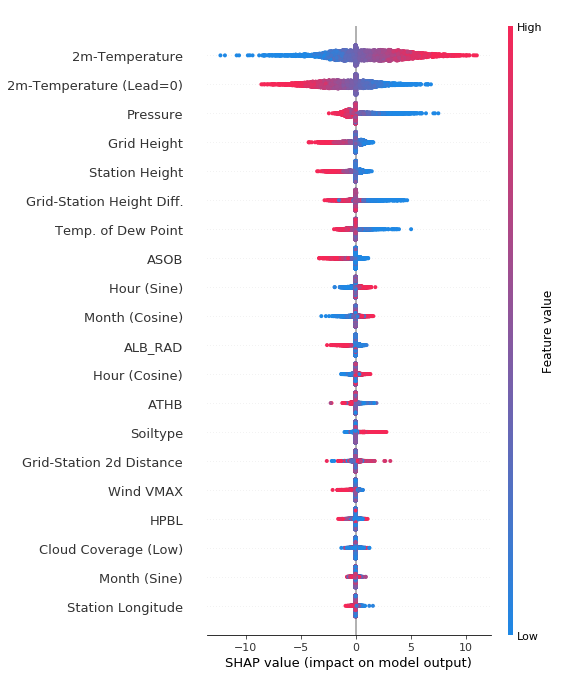

In [35]:
# SHAP summary plot of the 20 features with the highest impact
shap.summary_plot(all_data_shap_values[0], shap_test_data, plot_type=plot_type)

# Experiment with Summer/Winter and Night/Afternoon data

### Prepare data winter/night

In [109]:
# fix seed to randomly sample 1000 samples from ~1M train points
seed = 17257
# select points in january and july from training set to train explanation model
jan_night_train_data_set = train_data[train_data['Init'].str.contains('..01..03')]
jan_nigh_test_data_set = test_data[test_data['Init'].str.contains('..01..03')]

In [110]:
#explanation_training_set = jan_train_data_set.sample(n=100000, random_state=seed)
explanation_training_set = jan_night_train_data_set
explanation_training_data = explanation_training_set.iloc[:,2:-2]
# select randomly test points from test set to calculate SHAP values
shap_test_set = jan_nigh_test_data_set
shap_test_data = shap_test_set.iloc[:,2:-2]

In [111]:
start = time()
dense_train_data = shap.kmeans(explanation_training_data, 200)
print("Run Time for KMeans: %ss" % str(time() - start))

Run Time for KMeans: 13.514986276626587s


In [112]:
explainer = shap.KernelExplainer(f, dense_train_data)

Using 200 background data samples could cause slower run times. Consider using shap.kmeans(data, K) to summarize the background as K weighted samples.


FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


In [113]:
shap_values_jan_night = explainer.shap_values(shap_test_data, nsamples=150)

  0%|          | 0/711 [00:00<?, ?it/s]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  0%|          | 1/711 [00:02<26:38,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  0%|          | 2/711 [00:03<22:49,  1.93s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  0%|          | 3/711 [00:06<23:58,  2.03s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 4/711 [00:08<24:23,  2.07s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 5/711 [00:10<24:35,  2.09s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 6/711 [00:12<24:49,  2.11s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 7/711 [00:14<25:00,  2.13s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 8/711 [00:16<24:46,  2.11s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


  1%|▏         | 9/711 [00:18<24:40,  2.11s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|▏         | 10/711 [00:21<24:47,  2.12s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 11/711 [00:23<24:46,  2.12s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 12/711 [00:25<24:41,  2.12s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 13/711 [00:27<24:29,  2.11s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 14/711 [00:29<24:28,  2.11s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 15/711 [00:31<24:33,  2.12s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 16/711 [00:33<24:34,  2.12s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 17/711 [00:35<24:13,  2.09s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 18/711 [00:37<24:09,  2.09s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 19/711 [00:39<24:11,  2.10s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


  3%|▎         | 20/711 [00:41<24:09,  2.10s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 21/711 [00:44<24:09,  2.10s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 22/711 [00:46<24:10,  2.11s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 23/711 [00:48<24:12,  2.11s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 24/711 [00:50<24:11,  2.11s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▎         | 25/711 [00:52<24:13,  2.12s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▎         | 26/711 [00:54<23:55,  2.10s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 27/711 [00:56<23:56,  2.10s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 28/711 [00:58<23:56,  2.10s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 29/711 [01:01<23:57,  2.11s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 30/711 [01:03<23:59,  2.11s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 31/711 [01:05<24:00,  2.12s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▍         | 32/711 [01:07<23:59,  2.12s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▍         | 33/711 [01:10<24:00,  2.12s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▍         | 34/711 [01:12<24:00,  2.13s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▍         | 35/711 [01:14<23:59,  2.13s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▌         | 36/711 [01:16<23:59,  2.13s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


  5%|▌         | 37/711 [01:18<23:54,  2.13s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▌         | 38/711 [01:20<23:54,  2.13s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▌         | 39/711 [01:23<23:52,  2.13s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 40/711 [01:25<23:51,  2.13s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


  6%|▌         | 41/711 [01:27<23:46,  2.13s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 42/711 [01:28<23:32,  2.11s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 43/711 [01:30<23:31,  2.11s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 44/711 [01:33<23:30,  2.12s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▋         | 45/711 [01:35<23:30,  2.12s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▋         | 46/711 [01:37<23:29,  2.12s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 47/711 [01:39<23:27,  2.12s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 48/711 [01:41<23:23,  2.12s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 49/711 [01:43<23:22,  2.12s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 50/711 [01:46<23:22,  2.12s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 51/711 [01:48<23:21,  2.12s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 52/711 [01:50<23:21,  2.13s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 53/711 [01:52<23:19,  2.13s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 54/711 [01:54<23:18,  2.13s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 55/711 [01:57<23:17,  2.13s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 56/711 [01:59<23:15,  2.13s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 57/711 [02:01<23:14,  2.13s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 58/711 [02:03<23:13,  2.13s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 59/711 [02:05<23:12,  2.14s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 60/711 [02:08<23:10,  2.14s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▊         | 61/711 [02:10<23:09,  2.14s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▊         | 62/711 [02:12<23:07,  2.14s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 63/711 [02:14<23:05,  2.14s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 64/711 [02:16<23:03,  2.14s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 65/711 [02:19<23:02,  2.14s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 66/711 [02:21<23:00,  2.14s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 67/711 [02:23<22:59,  2.14s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|▉         | 68/711 [02:25<22:58,  2.14s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|▉         | 69/711 [02:27<22:56,  2.14s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|▉         | 70/711 [02:30<22:54,  2.14s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|▉         | 71/711 [02:32<22:53,  2.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|█         | 72/711 [02:34<22:52,  2.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|█         | 73/711 [02:36<22:50,  2.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|█         | 74/711 [02:39<22:49,  2.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 75/711 [02:41<22:47,  2.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 76/711 [02:43<22:45,  2.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 77/711 [02:45<22:44,  2.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 78/711 [02:47<22:41,  2.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 79/711 [02:49<22:39,  2.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█▏        | 80/711 [02:52<22:37,  2.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█▏        | 81/711 [02:54<22:35,  2.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 82/711 [02:56<22:32,  2.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 83/711 [02:58<22:30,  2.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 84/711 [03:00<22:29,  2.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 85/711 [03:02<22:26,  2.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 86/711 [03:04<22:24,  2.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 87/711 [03:07<22:22,  2.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 88/711 [03:09<22:20,  2.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 89/711 [03:11<22:18,  2.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 90/711 [03:13<22:17,  2.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 91/711 [03:15<22:15,  2.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 92/711 [03:18<22:12,  2.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 93/711 [03:20<22:11,  2.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 94/711 [03:22<22:09,  2.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 95/711 [03:24<22:07,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▎        | 96/711 [03:27<22:06,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▎        | 97/711 [03:29<22:04,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 98/711 [03:31<22:02,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 99/711 [03:33<21:59,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 100/711 [03:35<21:57,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 101/711 [03:37<21:56,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 102/711 [03:40<21:54,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 103/711 [03:42<21:53,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▍        | 104/711 [03:44<21:51,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▍        | 105/711 [03:46<21:49,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▍        | 106/711 [03:49<21:47,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▌        | 107/711 [03:51<21:45,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▌        | 108/711 [03:53<21:43,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▌        | 109/711 [03:55<21:39,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▌        | 110/711 [03:57<21:37,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 111/711 [03:59<21:35,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 112/711 [04:01<21:33,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 113/711 [04:04<21:31,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 114/711 [04:06<21:30,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 115/711 [04:08<21:28,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▋        | 116/711 [04:10<21:26,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▋        | 117/711 [04:12<21:23,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 118/711 [04:15<21:21,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 119/711 [04:17<21:20,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 120/711 [04:19<21:18,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 121/711 [04:21<21:16,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 122/711 [04:24<21:15,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 123/711 [04:26<21:13,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 124/711 [04:28<21:11,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 125/711 [04:30<21:09,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 126/711 [04:33<21:07,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 127/711 [04:35<21:05,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 128/711 [04:37<21:04,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 129/711 [04:39<21:00,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 130/711 [04:41<20:58,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 131/711 [04:43<20:55,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▊        | 132/711 [04:45<20:54,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▊        | 133/711 [04:48<20:52,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 134/711 [04:50<20:50,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 135/711 [04:52<20:48,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 136/711 [04:54<20:45,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 137/711 [04:56<20:40,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 138/711 [04:58<20:38,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|█▉        | 139/711 [05:00<20:36,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|█▉        | 140/711 [05:02<20:34,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|█▉        | 141/711 [05:04<20:32,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|█▉        | 142/711 [05:07<20:30,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|██        | 143/711 [05:09<20:27,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|██        | 144/711 [05:11<20:26,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|██        | 145/711 [05:13<20:24,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 146/711 [05:15<20:21,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 147/711 [05:17<20:19,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 148/711 [05:19<20:17,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 149/711 [05:22<20:15,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 150/711 [05:24<20:12,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 151/711 [05:26<20:10,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██▏       | 152/711 [05:28<20:08,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 153/711 [05:30<20:06,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 154/711 [05:33<20:04,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 155/711 [05:35<20:02,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 156/711 [05:37<20:00,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 157/711 [05:39<19:58,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 158/711 [05:41<19:56,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 159/711 [05:43<19:53,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 160/711 [05:45<19:51,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 161/711 [05:48<19:48,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 162/711 [05:50<19:46,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 163/711 [05:52<19:44,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 164/711 [05:54<19:42,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 165/711 [05:56<19:40,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 166/711 [05:58<19:38,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 167/711 [06:01<19:36,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▎       | 168/711 [06:03<19:34,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 169/711 [06:05<19:32,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 170/711 [06:07<19:30,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 171/711 [06:10<19:29,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 172/711 [06:12<19:27,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 24%|██▍       | 173/711 [06:14<19:24,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 174/711 [06:16<19:22,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▍       | 175/711 [06:18<19:20,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▍       | 176/711 [06:21<19:18,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▍       | 177/711 [06:22<19:14,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▌       | 178/711 [06:25<19:12,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▌       | 179/711 [06:27<19:10,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▌       | 180/711 [06:29<19:08,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▌       | 181/711 [06:31<19:06,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 182/711 [06:33<19:04,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 183/711 [06:35<19:01,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 184/711 [06:38<18:59,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 185/711 [06:40<18:57,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 186/711 [06:42<18:55,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▋       | 187/711 [06:44<18:53,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▋       | 188/711 [06:46<18:51,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 189/711 [06:48<18:48,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 190/711 [06:51<18:47,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 191/711 [06:53<18:44,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 192/711 [06:55<18:42,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 193/711 [06:57<18:40,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 194/711 [06:59<18:38,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 195/711 [07:01<18:36,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 196/711 [07:04<18:34,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 197/711 [07:06<18:32,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 198/711 [07:08<18:30,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 199/711 [07:10<18:28,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 200/711 [07:13<18:26,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 201/711 [07:15<18:24,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 202/711 [07:17<18:22,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▊       | 203/711 [07:19<18:20,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▊       | 204/711 [07:22<18:18,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 205/711 [07:24<18:16,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 206/711 [07:26<18:13,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 29%|██▉       | 207/711 [07:28<18:11,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 208/711 [07:30<18:09,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 209/711 [07:32<18:07,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|██▉       | 210/711 [07:34<18:05,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|██▉       | 211/711 [07:37<18:03,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|██▉       | 212/711 [07:39<18:00,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|██▉       | 213/711 [07:41<17:59,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|███       | 214/711 [07:43<17:56,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|███       | 215/711 [07:45<17:54,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|███       | 216/711 [07:48<17:52,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 217/711 [07:50<17:50,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 218/711 [07:52<17:48,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 219/711 [07:54<17:46,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 220/711 [07:56<17:44,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 221/711 [07:59<17:42,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 222/711 [08:01<17:40,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███▏      | 223/711 [08:03<17:38,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 224/711 [08:05<17:36,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 225/711 [08:08<17:34,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 226/711 [08:10<17:32,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 227/711 [08:12<17:30,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 32%|███▏      | 228/711 [08:14<17:27,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 229/711 [08:16<17:25,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 230/711 [08:18<17:22,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 231/711 [08:20<17:20,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 232/711 [08:22<17:18,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 233/711 [08:25<17:16,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 234/711 [08:27<17:14,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 235/711 [08:29<17:12,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 236/711 [08:31<17:10,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 237/711 [08:34<17:08,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 238/711 [08:36<17:06,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▎      | 239/711 [08:38<17:03,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 240/711 [08:40<17:01,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 241/711 [08:42<16:59,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 242/711 [08:45<16:57,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 243/711 [08:47<16:55,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 244/711 [08:49<16:53,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 245/711 [08:51<16:51,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▍      | 246/711 [08:53<16:48,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▍      | 247/711 [08:55<16:46,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▍      | 248/711 [08:57<16:44,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▌      | 249/711 [09:00<16:42,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▌      | 250/711 [09:02<16:40,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▌      | 251/711 [09:04<16:38,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▌      | 252/711 [09:06<16:36,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 253/711 [09:09<16:34,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 254/711 [09:11<16:32,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 255/711 [09:13<16:29,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 256/711 [09:15<16:27,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 257/711 [09:18<16:25,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▋      | 258/711 [09:20<16:23,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▋      | 259/711 [09:22<16:21,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 260/711 [09:24<16:19,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 261/711 [09:26<16:17,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 262/711 [09:28<16:14,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 263/711 [09:31<16:12,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 264/711 [09:33<16:10,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 265/711 [09:35<16:08,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 266/711 [09:37<16:06,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 267/711 [09:40<16:04,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 268/711 [09:42<16:02,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 269/711 [09:44<16:00,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 270/711 [09:46<15:58,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 271/711 [09:48<15:56,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 272/711 [09:51<15:54,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 273/711 [09:53<15:52,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▊      | 274/711 [09:55<15:50,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▊      | 275/711 [09:58<15:48,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 276/711 [10:00<15:46,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 277/711 [10:02<15:43,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 278/711 [10:04<15:41,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 39%|███▉      | 279/711 [10:06<15:39,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 280/711 [10:08<15:37,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|███▉      | 281/711 [10:11<15:35,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|███▉      | 282/711 [10:13<15:33,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|███▉      | 283/711 [10:15<15:31,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|███▉      | 284/711 [10:17<15:29,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|████      | 285/711 [10:20<15:27,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|████      | 286/711 [10:22<15:24,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 40%|████      | 287/711 [10:23<15:21,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 288/711 [10:26<15:19,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 289/711 [10:28<15:17,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 290/711 [10:30<15:15,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 291/711 [10:32<15:13,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 292/711 [10:34<15:11,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 293/711 [10:37<15:09,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████▏     | 294/711 [10:39<15:06,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████▏     | 295/711 [10:41<15:04,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 296/711 [10:43<15:02,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 297/711 [10:45<15:00,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 298/711 [10:47<14:57,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 299/711 [10:50<14:55,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 300/711 [10:52<14:53,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 301/711 [10:54<14:51,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 302/711 [10:56<14:49,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 303/711 [10:58<14:46,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 43%|████▎     | 304/711 [11:00<14:44,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 305/711 [11:02<14:42,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 306/711 [11:05<14:40,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 307/711 [11:07<14:38,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 43%|████▎     | 308/711 [11:08<14:35,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 309/711 [11:10<14:32,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▎     | 310/711 [11:13<14:30,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▎     | 311/711 [11:15<14:28,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 312/711 [11:17<14:26,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 44%|████▍     | 313/711 [11:19<14:24,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 314/711 [11:21<14:22,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 315/711 [11:24<14:19,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 316/711 [11:26<14:17,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▍     | 317/711 [11:28<14:15,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▍     | 318/711 [11:30<14:13,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▍     | 319/711 [11:32<14:11,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▌     | 320/711 [11:35<14:09,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▌     | 321/711 [11:37<14:07,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▌     | 322/711 [11:39<14:05,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▌     | 323/711 [11:41<14:02,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 324/711 [11:43<14:00,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 325/711 [11:45<13:57,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 326/711 [11:47<13:55,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 327/711 [11:49<13:53,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 328/711 [11:52<13:51,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▋     | 329/711 [11:54<13:49,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▋     | 330/711 [11:56<13:47,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 331/711 [11:58<13:45,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 332/711 [12:01<13:43,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 333/711 [12:03<13:41,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 334/711 [12:05<13:38,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 335/711 [12:07<13:36,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 336/711 [12:10<13:34,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 337/711 [12:12<13:32,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 338/711 [12:14<13:30,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 339/711 [12:16<13:28,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 340/711 [12:18<13:26,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 341/711 [12:21<13:24,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 342/711 [12:23<13:22,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 343/711 [12:25<13:19,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 344/711 [12:27<13:17,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▊     | 345/711 [12:30<13:15,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 49%|████▊     | 346/711 [12:31<13:13,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 347/711 [12:33<13:10,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 348/711 [12:36<13:08,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 349/711 [12:38<13:06,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 350/711 [12:40<13:04,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 49%|████▉     | 351/711 [12:41<13:01,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|████▉     | 352/711 [12:44<12:59,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|████▉     | 353/711 [12:46<12:57,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|████▉     | 354/711 [12:48<12:55,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|████▉     | 355/711 [12:50<12:52,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|█████     | 356/711 [12:53<12:50,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|█████     | 357/711 [12:55<12:48,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|█████     | 358/711 [12:57<12:46,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|█████     | 359/711 [12:59<12:44,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 360/711 [13:01<12:42,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 361/711 [13:04<12:40,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 362/711 [13:06<12:38,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 363/711 [13:08<12:36,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 364/711 [13:10<12:33,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████▏    | 365/711 [13:12<12:31,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████▏    | 366/711 [13:14<12:29,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 367/711 [13:17<12:27,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 368/711 [13:19<12:25,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 369/711 [13:21<12:22,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 370/711 [13:23<12:20,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 371/711 [13:26<12:18,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 372/711 [13:28<12:16,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 373/711 [13:30<12:14,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 374/711 [13:32<12:12,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 375/711 [13:34<12:10,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 376/711 [13:37<12:07,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 377/711 [13:39<12:05,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 378/711 [13:41<12:03,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 379/711 [13:43<12:01,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 380/711 [13:45<11:58,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▎    | 381/711 [13:47<11:56,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▎    | 382/711 [13:49<11:54,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 383/711 [13:51<11:52,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 384/711 [13:53<11:50,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 385/711 [13:56<11:48,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 386/711 [13:58<11:45,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 387/711 [14:00<11:43,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▍    | 388/711 [14:02<11:41,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▍    | 389/711 [14:05<11:39,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▍    | 390/711 [14:07<11:37,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▍    | 391/711 [14:09<11:35,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▌    | 392/711 [14:11<11:33,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▌    | 393/711 [14:13<11:30,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▌    | 394/711 [14:16<11:28,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 395/711 [14:18<11:26,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 396/711 [14:20<11:24,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 397/711 [14:22<11:22,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 398/711 [14:24<11:20,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 399/711 [14:26<11:17,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▋    | 400/711 [14:29<11:15,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▋    | 401/711 [14:31<11:13,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 402/711 [14:33<11:11,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 403/711 [14:35<11:09,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 404/711 [14:38<11:07,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 405/711 [14:40<11:05,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 406/711 [14:42<11:02,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 407/711 [14:44<11:00,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 408/711 [14:46<10:58,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 409/711 [14:49<10:56,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 410/711 [14:51<10:54,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 411/711 [14:53<10:52,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 412/711 [14:55<10:50,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 413/711 [14:57<10:47,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 414/711 [15:00<10:45,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 415/711 [15:02<10:43,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▊    | 416/711 [15:04<10:41,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▊    | 417/711 [15:06<10:39,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 418/711 [15:08<10:37,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 419/711 [15:11<10:34,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 420/711 [15:13<10:32,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 421/711 [15:15<10:30,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 422/711 [15:17<10:28,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 423/711 [15:20<10:26,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|█████▉    | 424/711 [15:22<10:24,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|█████▉    | 425/711 [15:24<10:22,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|█████▉    | 426/711 [15:26<10:20,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|██████    | 427/711 [15:28<10:17,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|██████    | 428/711 [15:31<10:15,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|██████    | 429/711 [15:33<10:13,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|██████    | 430/711 [15:35<10:11,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 431/711 [15:37<10:09,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 432/711 [15:40<10:07,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 433/711 [15:42<10:04,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 434/711 [15:44<10:02,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 435/711 [15:46<10:00,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████▏   | 436/711 [15:48<09:58,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████▏   | 437/711 [15:51<09:56,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 438/711 [15:52<09:53,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 62%|██████▏   | 439/711 [15:54<09:51,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 440/711 [15:56<09:49,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 441/711 [15:59<09:47,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 442/711 [16:01<09:45,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 443/711 [16:03<09:42,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 444/711 [16:05<09:40,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 445/711 [16:07<09:38,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 446/711 [16:09<09:36,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 447/711 [16:12<09:34,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 448/711 [16:13<09:31,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 449/711 [16:15<09:29,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 450/711 [16:18<09:27,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 451/711 [16:20<09:25,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▎   | 452/711 [16:22<09:22,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▎   | 453/711 [16:24<09:20,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 454/711 [16:26<09:18,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 455/711 [16:29<09:16,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 456/711 [16:31<09:14,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 457/711 [16:33<09:12,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 458/711 [16:35<09:10,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▍   | 459/711 [16:38<09:07,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▍   | 460/711 [16:40<09:05,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▍   | 461/711 [16:42<09:03,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▍   | 462/711 [16:44<09:01,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▌   | 463/711 [16:46<08:59,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▌   | 464/711 [16:49<08:57,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▌   | 465/711 [16:51<08:55,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 466/711 [16:53<08:52,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 467/711 [16:55<08:50,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 468/711 [16:57<08:48,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 469/711 [17:00<08:46,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 470/711 [17:02<08:44,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 471/711 [17:04<08:42,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▋   | 472/711 [17:06<08:39,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 473/711 [17:08<08:37,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 474/711 [17:11<08:35,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 475/711 [17:13<08:33,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 476/711 [17:15<08:31,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 477/711 [17:17<08:29,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 478/711 [17:20<08:26,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 479/711 [17:22<08:24,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 480/711 [17:24<08:22,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 481/711 [17:26<08:20,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 482/711 [17:28<08:18,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 483/711 [17:30<08:16,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 484/711 [17:33<08:13,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 485/711 [17:35<08:11,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 486/711 [17:36<08:09,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 487/711 [17:39<08:07,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▊   | 488/711 [17:41<08:05,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 489/711 [17:43<08:02,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 490/711 [17:45<08:00,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 491/711 [17:47<07:58,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 69%|██████▉   | 492/711 [17:49<07:56,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 493/711 [17:52<07:54,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 494/711 [17:54<07:51,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|██████▉   | 495/711 [17:56<07:49,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|██████▉   | 496/711 [17:58<07:47,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|██████▉   | 497/711 [18:00<07:45,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|███████   | 498/711 [18:03<07:43,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|███████   | 499/711 [18:05<07:41,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|███████   | 500/711 [18:07<07:38,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|███████   | 501/711 [18:09<07:36,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 502/711 [18:11<07:34,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 503/711 [18:13<07:32,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 504/711 [18:16<07:30,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 505/711 [18:18<07:28,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 506/711 [18:20<07:25,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████▏  | 507/711 [18:22<07:23,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████▏  | 508/711 [18:25<07:21,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 509/711 [18:27<07:19,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 510/711 [18:29<07:17,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 511/711 [18:31<07:15,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 512/711 [18:33<07:12,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 513/711 [18:36<07:10,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 514/711 [18:38<07:08,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 515/711 [18:40<07:06,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 516/711 [18:42<07:04,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 517/711 [18:44<07:02,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 518/711 [18:47<06:59,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 519/711 [18:49<06:57,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 520/711 [18:51<06:55,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 521/711 [18:53<06:53,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 522/711 [18:55<06:51,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▎  | 523/711 [18:57<06:49,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▎  | 524/711 [19:00<06:46,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 525/711 [19:02<06:44,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 526/711 [19:04<06:42,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 527/711 [19:06<06:40,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 528/711 [19:09<06:38,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 74%|███████▍  | 529/711 [19:11<06:36,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▍  | 530/711 [19:13<06:33,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▍  | 531/711 [19:15<06:31,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▍  | 532/711 [19:17<06:29,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▍  | 533/711 [19:19<06:27,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▌  | 534/711 [19:21<06:25,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▌  | 535/711 [19:24<06:22,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▌  | 536/711 [19:26<06:20,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 537/711 [19:28<06:18,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 538/711 [19:31<06:16,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 539/711 [19:33<06:14,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 540/711 [19:35<06:12,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 541/711 [19:37<06:10,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 542/711 [19:40<06:07,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▋  | 543/711 [19:42<06:05,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 544/711 [19:44<06:03,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 545/711 [19:46<06:01,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 546/711 [19:49<05:59,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 547/711 [19:51<05:57,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 548/711 [19:53<05:54,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 77%|███████▋  | 549/711 [19:55<05:52,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 550/711 [19:57<05:50,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 551/711 [19:59<05:48,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 552/711 [20:02<05:46,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 553/711 [20:04<05:44,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 554/711 [20:06<05:41,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 555/711 [20:08<05:39,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 556/711 [20:11<05:37,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 557/711 [20:13<05:35,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 558/711 [20:15<05:33,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▊  | 559/711 [20:17<05:31,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 560/711 [20:20<05:29,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 561/711 [20:22<05:26,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 562/711 [20:24<05:24,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 563/711 [20:26<05:22,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 564/711 [20:29<05:20,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 565/711 [20:31<05:18,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|███████▉  | 566/711 [20:33<05:15,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|███████▉  | 567/711 [20:35<05:13,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|███████▉  | 568/711 [20:37<05:11,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|████████  | 569/711 [20:40<05:09,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|████████  | 570/711 [20:42<05:07,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|████████  | 571/711 [20:44<05:05,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|████████  | 572/711 [20:46<05:02,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 573/711 [20:48<05:00,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 81%|████████  | 574/711 [20:50<04:58,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 575/711 [20:53<04:56,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 576/711 [20:55<04:54,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 577/711 [20:57<04:52,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████▏ | 578/711 [20:59<04:49,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████▏ | 579/711 [21:02<04:47,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 580/711 [21:04<04:45,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 581/711 [21:06<04:43,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 582/711 [21:08<04:41,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 583/711 [21:10<04:38,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 584/711 [21:12<04:36,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 585/711 [21:15<04:34,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 586/711 [21:17<04:32,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 587/711 [21:19<04:30,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 588/711 [21:21<04:28,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 589/711 [21:23<04:25,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 590/711 [21:26<04:23,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 591/711 [21:28<04:21,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 592/711 [21:30<04:19,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 593/711 [21:32<04:17,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▎ | 594/711 [21:34<04:15,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▎ | 595/711 [21:37<04:12,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 596/711 [21:39<04:10,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 597/711 [21:41<04:08,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 598/711 [21:43<04:06,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 599/711 [21:45<04:04,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 600/711 [21:48<04:02,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▍ | 601/711 [21:50<03:59,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▍ | 602/711 [21:52<03:57,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▍ | 603/711 [21:54<03:55,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▍ | 604/711 [21:57<03:53,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▌ | 605/711 [21:59<03:51,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▌ | 606/711 [22:01<03:48,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▌ | 607/711 [22:03<03:46,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 608/711 [22:05<03:44,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 609/711 [22:08<03:42,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 610/711 [22:10<03:40,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 611/711 [22:12<03:38,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 612/711 [22:14<03:35,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 613/711 [22:17<03:33,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▋ | 614/711 [22:19<03:31,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▋ | 615/711 [22:21<03:29,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 616/711 [22:23<03:27,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 617/711 [22:25<03:25,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 618/711 [22:28<03:22,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 619/711 [22:30<03:20,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 620/711 [22:32<03:18,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 621/711 [22:33<03:16,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 622/711 [22:36<03:14,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 623/711 [22:38<03:11,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 624/711 [22:40<03:09,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 625/711 [22:42<03:07,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 626/711 [22:45<03:05,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 627/711 [22:47<03:03,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 628/711 [22:49<03:01,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 629/711 [22:51<02:58,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▊ | 630/711 [22:53<02:56,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▊ | 631/711 [22:56<02:54,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 632/711 [22:58<02:52,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 633/711 [23:00<02:50,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 634/711 [23:02<02:47,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 635/711 [23:04<02:45,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 636/711 [23:06<02:43,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|████████▉ | 637/711 [23:08<02:41,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|████████▉ | 638/711 [23:11<02:39,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|████████▉ | 639/711 [23:13<02:36,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|█████████ | 640/711 [23:15<02:34,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|█████████ | 641/711 [23:17<02:32,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|█████████ | 642/711 [23:20<02:30,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|█████████ | 643/711 [23:22<02:28,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 644/711 [23:24<02:26,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 645/711 [23:26<02:23,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 646/711 [23:28<02:21,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 647/711 [23:30<02:19,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 648/711 [23:33<02:17,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████▏| 649/711 [23:35<02:15,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████▏| 650/711 [23:37<02:13,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 651/711 [23:39<02:10,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 652/711 [23:41<02:08,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 653/711 [23:43<02:06,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 654/711 [23:46<02:04,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 655/711 [23:48<02:02,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 656/711 [23:50<01:59,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 657/711 [23:52<01:57,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 658/711 [23:55<01:55,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 659/711 [23:57<01:53,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 660/711 [23:59<01:51,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 661/711 [24:01<01:49,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 662/711 [24:04<01:46,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 663/711 [24:06<01:44,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 664/711 [24:08<01:42,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▎| 665/711 [24:10<01:40,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▎| 666/711 [24:12<01:38,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 667/711 [24:15<01:35,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 668/711 [24:17<01:33,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 669/711 [24:19<01:31,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 670/711 [24:21<01:29,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 671/711 [24:23<01:27,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▍| 672/711 [24:25<01:25,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▍| 673/711 [24:27<01:22,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▍| 674/711 [24:29<01:20,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▍| 675/711 [24:32<01:18,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▌| 676/711 [24:34<01:16,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▌| 677/711 [24:36<01:14,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▌| 678/711 [24:38<01:11,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▌| 679/711 [24:40<01:09,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 680/711 [24:43<01:07,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 681/711 [24:45<01:05,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 682/711 [24:47<01:03,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 683/711 [24:49<01:01,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 684/711 [24:52<00:58,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▋| 685/711 [24:54<00:56,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▋| 686/711 [24:56<00:54,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 687/711 [24:58<00:52,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 688/711 [25:00<00:50,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 689/711 [25:03<00:47,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 690/711 [25:05<00:45,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 691/711 [25:07<00:43,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 692/711 [25:09<00:41,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 693/711 [25:12<00:39,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 694/711 [25:14<00:37,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 695/711 [25:16<00:34,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 696/711 [25:18<00:32,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 697/711 [25:20<00:30,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 698/711 [25:23<00:28,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 699/711 [25:25<00:26,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 700/711 [25:27<00:24,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▊| 701/711 [25:29<00:21,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▊| 702/711 [25:31<00:19,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 703/711 [25:34<00:17,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 704/711 [25:36<00:15,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 705/711 [25:38<00:13,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 706/711 [25:40<00:10,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 707/711 [25:42<00:08,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

100%|█████████▉| 708/711 [25:44<00:06,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

100%|█████████▉| 709/711 [25:47<00:04,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

100%|█████████▉| 710/711 [25:49<00:02,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

100%|██████████| 711/711 [25:51<00:00,  2.18s/it]


In [ ]:
if load_existing:
    with open('/mnt/ds3lab-scratch/ninow/final_results/network/model_predictions/knn_1/shap/shap_values_january_night_k_200_nsamples_150.pkl','rb') as handle:
        shap_values_jan_night = pkl.load(handle)    
else:
    shap_values_jan_night = explainer.shap_values(shap_test_data, nsamples=150)

In [ ]:
if not load_existing:
    with open('/home/ninow/master_thesis/code/project/results/runs/knn_1/shap/shap_values_january_night_k_200_nsamples_150.pkl','wb') as handle:
        pkl.dump(shap_values_jan_night, handle, protocol=pkl.HIGHEST_PROTOCOL)

In [114]:
shap.force_plot(shap_values_jan_night[0][4], shap_test_data.iloc[0,:])

In [115]:
shap.force_plot(shap_values_jan_night[0], shap_test_data)

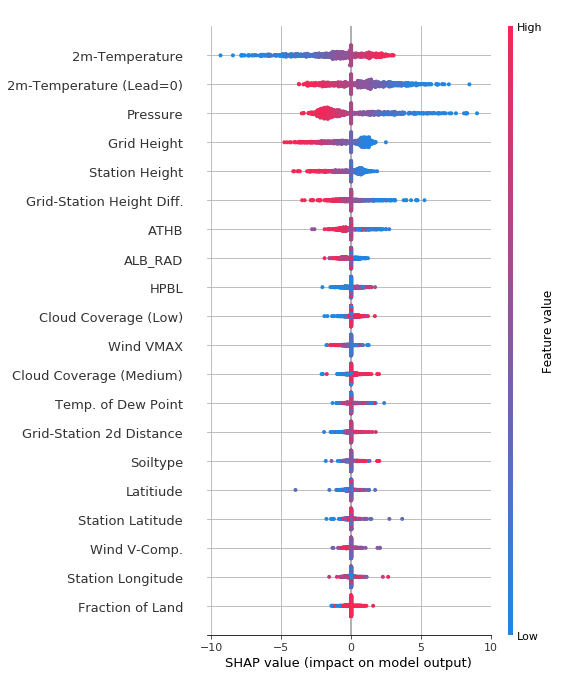

In [116]:
shap.summary_plot(shap_values_jan_night[0], shap_test_data, plot_type=plot_type)

### Prepare data winter/afternoon

In [117]:
# fix seed to randomly sample 1000 samples from ~1M train points
seed = 17257
# select points in january and july from training set to train explanation model
jan_afternoon_train_data_set = train_data[train_data['Init'].str.contains('..01..15')]
jan_afternoon_test_data_set = test_data[test_data['Init'].str.contains('..01..15')]

In [118]:
#explanation_training_set = jan_train_data_set.sample(n=100000, random_state=seed)
explanation_training_set = jan_afternoon_train_data_set
explanation_training_data = explanation_training_set.iloc[:,2:-2]
# select randomly test points from test set to calculate SHAP values
shap_test_set = jan_afternoon_test_data_set
shap_test_data = shap_test_set.iloc[:,2:-2]

In [119]:
start = time()
dense_train_data = shap.kmeans(explanation_training_data, 200)
print("Run Time for KMeans: %ss" % str(time() - start))

Run Time for KMeans: 13.768498659133911s


In [120]:
explainer = shap.KernelExplainer(f, dense_train_data)

Using 200 background data samples could cause slower run times. Consider using shap.kmeans(data, K) to summarize the background as K weighted samples.


FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


In [121]:
shap_values_jan_afternoon = explainer.shap_values(shap_test_data, nsamples=150)

  0%|          | 0/711 [00:00<?, ?it/s]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  0%|          | 1/711 [00:01<21:57,  1.86s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  0%|          | 2/711 [00:04<24:43,  2.09s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  0%|          | 3/711 [00:06<24:44,  2.10s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 4/711 [00:08<23:59,  2.04s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


  1%|          | 5/711 [00:10<24:10,  2.05s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 6/711 [00:12<24:38,  2.10s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 7/711 [00:14<24:48,  2.11s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 8/711 [00:17<25:05,  2.14s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|▏         | 9/711 [00:19<25:22,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|▏         | 10/711 [00:21<25:33,  2.19s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 11/711 [00:24<25:43,  2.20s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 12/711 [00:26<25:36,  2.20s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 13/711 [00:28<25:40,  2.21s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 14/711 [00:31<25:45,  2.22s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 15/711 [00:33<25:47,  2.22s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 16/711 [00:35<25:48,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 17/711 [00:37<25:48,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 18/711 [00:40<25:46,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 19/711 [00:42<25:47,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 20/711 [00:44<25:47,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 21/711 [00:47<25:47,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 22/711 [00:49<25:44,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 23/711 [00:51<25:45,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 24/711 [00:53<25:44,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▎         | 25/711 [00:56<25:45,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▎         | 26/711 [00:58<25:39,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 27/711 [01:00<25:35,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 28/711 [01:02<25:31,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 29/711 [01:04<25:22,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 30/711 [01:07<25:22,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 31/711 [01:09<25:20,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▍         | 32/711 [01:11<25:20,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▍         | 33/711 [01:13<25:19,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▍         | 34/711 [01:16<25:19,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▍         | 35/711 [01:18<25:18,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▌         | 36/711 [01:20<25:18,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


  5%|▌         | 37/711 [01:23<25:14,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▌         | 38/711 [01:25<25:13,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▌         | 39/711 [01:27<25:09,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 40/711 [01:29<25:08,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 41/711 [01:32<25:06,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 42/711 [01:34<25:05,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 43/711 [01:36<25:02,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 44/711 [01:39<25:01,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▋         | 45/711 [01:41<24:59,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▋         | 46/711 [01:43<24:57,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 47/711 [01:45<24:56,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 48/711 [01:48<24:54,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 49/711 [01:50<24:53,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 50/711 [01:52<24:51,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 51/711 [01:55<24:49,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 52/711 [01:57<24:45,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 53/711 [01:59<24:43,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 54/711 [02:01<24:37,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 55/711 [02:03<24:35,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 56/711 [02:05<24:33,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 57/711 [02:08<24:32,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 58/711 [02:10<24:29,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 59/711 [02:12<24:28,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 60/711 [02:15<24:27,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▊         | 61/711 [02:17<24:25,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▊         | 62/711 [02:19<24:23,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 63/711 [02:22<24:21,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 64/711 [02:23<24:12,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 65/711 [02:25<24:10,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 66/711 [02:28<24:07,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 67/711 [02:30<24:05,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|▉         | 68/711 [02:32<24:04,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|▉         | 69/711 [02:35<24:02,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|▉         | 70/711 [02:37<23:59,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|▉         | 71/711 [02:39<23:58,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|█         | 72/711 [02:41<23:55,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|█         | 73/711 [02:43<23:49,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|█         | 74/711 [02:46<23:49,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 75/711 [02:48<23:47,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 76/711 [02:50<23:41,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 77/711 [02:52<23:39,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 78/711 [02:54<23:38,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 79/711 [02:57<23:36,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█▏        | 80/711 [02:59<23:33,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█▏        | 81/711 [03:01<23:31,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 82/711 [03:03<23:25,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 83/711 [03:05<23:24,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 84/711 [03:07<23:19,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 85/711 [03:09<23:18,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 86/711 [03:11<23:12,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 87/711 [03:13<23:10,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 88/711 [03:16<23:08,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 89/711 [03:18<23:06,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 90/711 [03:20<23:05,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 91/711 [03:23<23:03,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 92/711 [03:25<23:01,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 13%|█▎        | 93/711 [03:27<22:59,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 94/711 [03:29<22:58,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 95/711 [03:32<22:56,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▎        | 96/711 [03:34<22:54,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▎        | 97/711 [03:36<22:52,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 98/711 [03:39<22:50,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 99/711 [03:41<22:49,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 100/711 [03:43<22:47,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 101/711 [03:46<22:46,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 102/711 [03:48<22:44,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 103/711 [03:50<22:42,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▍        | 104/711 [03:53<22:40,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▍        | 105/711 [03:55<22:38,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▍        | 106/711 [03:57<22:36,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▌        | 107/711 [03:59<22:31,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▌        | 108/711 [04:01<22:29,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▌        | 109/711 [04:03<22:27,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▌        | 110/711 [04:06<22:25,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 111/711 [04:08<22:21,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 112/711 [04:10<22:19,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 113/711 [04:12<22:17,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 114/711 [04:15<22:15,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 115/711 [04:17<22:13,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 16%|█▋        | 116/711 [04:18<22:07,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▋        | 117/711 [04:21<22:06,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 17%|█▋        | 118/711 [04:22<22:01,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 119/711 [04:25<21:59,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 120/711 [04:27<21:57,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 121/711 [04:29<21:54,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 122/711 [04:31<21:52,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 123/711 [04:33<21:49,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 124/711 [04:36<21:47,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 125/711 [04:38<21:45,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 126/711 [04:40<21:41,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 127/711 [04:42<21:40,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 128/711 [04:45<21:38,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 129/711 [04:47<21:35,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 130/711 [04:48<21:31,  2.22s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 131/711 [04:51<21:29,  2.22s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▊        | 132/711 [04:53<21:27,  2.22s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▊        | 133/711 [04:55<21:25,  2.22s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 134/711 [04:58<21:23,  2.22s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 135/711 [05:00<21:21,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 136/711 [05:02<21:20,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 137/711 [05:05<21:18,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 138/711 [05:07<21:16,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|█▉        | 139/711 [05:09<21:14,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|█▉        | 140/711 [05:12<21:12,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|█▉        | 141/711 [05:14<21:10,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|█▉        | 142/711 [05:16<21:08,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|██        | 143/711 [05:18<21:06,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|██        | 144/711 [05:21<21:04,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|██        | 145/711 [05:23<21:02,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 146/711 [05:25<21:00,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 147/711 [05:27<20:58,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 148/711 [05:30<20:55,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 149/711 [05:32<20:53,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 150/711 [05:34<20:51,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 151/711 [05:36<20:49,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██▏       | 152/711 [05:39<20:47,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 153/711 [05:41<20:45,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 154/711 [05:43<20:43,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 155/711 [05:46<20:41,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 156/711 [05:48<20:39,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 157/711 [05:50<20:37,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 158/711 [05:53<20:35,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 159/711 [05:55<20:34,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 160/711 [05:57<20:32,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 161/711 [06:00<20:30,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 162/711 [06:02<20:28,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 163/711 [06:04<20:26,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 164/711 [06:06<20:24,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 23%|██▎       | 165/711 [06:08<20:20,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 166/711 [06:10<20:15,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 167/711 [06:12<20:13,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▎       | 168/711 [06:14<20:11,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 169/711 [06:17<20:09,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 170/711 [06:19<20:07,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 171/711 [06:21<20:05,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 172/711 [06:23<20:02,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 173/711 [06:25<19:59,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 174/711 [06:28<19:57,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▍       | 175/711 [06:30<19:56,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▍       | 176/711 [06:32<19:53,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▍       | 177/711 [06:35<19:51,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▌       | 178/711 [06:37<19:49,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▌       | 179/711 [06:39<19:48,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▌       | 180/711 [06:42<19:46,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▌       | 181/711 [06:44<19:44,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 182/711 [06:46<19:42,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 183/711 [06:48<19:40,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 184/711 [06:51<19:37,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 185/711 [06:53<19:35,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 186/711 [06:55<19:33,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▋       | 187/711 [06:58<19:31,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▋       | 188/711 [07:00<19:29,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 189/711 [07:02<19:27,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 190/711 [07:04<19:22,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 191/711 [07:06<19:20,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 192/711 [07:08<19:17,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 193/711 [07:10<19:15,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 27%|██▋       | 194/711 [07:12<19:11,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 27%|██▋       | 195/711 [07:14<19:09,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 196/711 [07:16<19:06,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 197/711 [07:18<19:04,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 198/711 [07:21<19:02,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 199/711 [07:23<19:00,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 200/711 [07:25<18:58,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 201/711 [07:27<18:56,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 202/711 [07:30<18:54,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▊       | 203/711 [07:32<18:51,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▊       | 204/711 [07:34<18:49,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 205/711 [07:36<18:46,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 206/711 [07:38<18:44,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 207/711 [07:41<18:42,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 208/711 [07:43<18:40,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 209/711 [07:45<18:38,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|██▉       | 210/711 [07:47<18:36,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|██▉       | 211/711 [07:50<18:34,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|██▉       | 212/711 [07:52<18:32,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|██▉       | 213/711 [07:54<18:30,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|███       | 214/711 [07:57<18:28,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|███       | 215/711 [07:59<18:26,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 30%|███       | 216/711 [08:01<18:23,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 217/711 [08:03<18:21,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 218/711 [08:05<18:18,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 219/711 [08:08<18:16,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 220/711 [08:10<18:14,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 221/711 [08:12<18:11,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 222/711 [08:14<18:09,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███▏      | 223/711 [08:16<18:07,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 224/711 [08:19<18:04,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 225/711 [08:21<18:02,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 226/711 [08:23<18:00,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 227/711 [08:25<17:58,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 228/711 [08:28<17:56,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 229/711 [08:30<17:54,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 230/711 [08:32<17:52,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 231/711 [08:34<17:50,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 232/711 [08:37<17:47,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 233/711 [08:39<17:45,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 234/711 [08:41<17:43,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 235/711 [08:44<17:41,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 236/711 [08:46<17:39,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 237/711 [08:48<17:37,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 238/711 [08:51<17:35,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▎      | 239/711 [08:53<17:33,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 240/711 [08:55<17:30,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 241/711 [08:57<17:28,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 242/711 [09:00<17:26,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 243/711 [09:02<17:24,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 244/711 [09:04<17:22,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 245/711 [09:06<17:20,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▍      | 246/711 [09:09<17:18,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▍      | 247/711 [09:11<17:16,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▍      | 248/711 [09:13<17:14,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▌      | 249/711 [09:16<17:12,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▌      | 250/711 [09:18<17:10,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▌      | 251/711 [09:20<17:08,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▌      | 252/711 [09:23<17:05,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 253/711 [09:25<17:03,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 254/711 [09:27<17:01,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 255/711 [09:30<16:59,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 256/711 [09:32<16:57,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 257/711 [09:34<16:55,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▋      | 258/711 [09:37<16:53,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▋      | 259/711 [09:38<16:50,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 260/711 [09:41<16:48,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 261/711 [09:43<16:45,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 262/711 [09:45<16:43,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 263/711 [09:48<16:41,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 264/711 [09:50<16:39,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 265/711 [09:52<16:36,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 266/711 [09:54<16:34,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 267/711 [09:56<16:32,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 268/711 [09:59<16:30,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 269/711 [10:01<16:28,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 270/711 [10:03<16:26,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 271/711 [10:05<16:23,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 272/711 [10:08<16:21,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 273/711 [10:10<16:19,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▊      | 274/711 [10:12<16:17,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▊      | 275/711 [10:15<16:15,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 276/711 [10:17<16:13,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 277/711 [10:19<16:11,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 278/711 [10:22<16:08,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 279/711 [10:24<16:06,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 39%|███▉      | 280/711 [10:26<16:04,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|███▉      | 281/711 [10:28<16:01,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|███▉      | 282/711 [10:30<15:59,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|███▉      | 283/711 [10:33<15:57,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|███▉      | 284/711 [10:35<15:55,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|████      | 285/711 [10:37<15:53,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|████      | 286/711 [10:40<15:51,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|████      | 287/711 [10:42<15:49,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 288/711 [10:44<15:47,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 289/711 [10:47<15:44,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 290/711 [10:49<15:42,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 291/711 [10:51<15:40,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 292/711 [10:54<15:38,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 293/711 [10:56<15:36,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████▏     | 294/711 [10:58<15:34,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████▏     | 295/711 [11:01<15:32,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 296/711 [11:03<15:30,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 297/711 [11:05<15:27,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 298/711 [11:07<15:25,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 299/711 [11:10<15:23,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 300/711 [11:12<15:21,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 301/711 [11:14<15:19,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 302/711 [11:17<15:16,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 303/711 [11:19<15:14,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 304/711 [11:21<15:12,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 305/711 [11:24<15:10,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 306/711 [11:26<15:08,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 307/711 [11:28<15:06,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 308/711 [11:31<15:04,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 309/711 [11:33<15:01,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▎     | 310/711 [11:35<14:59,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▎     | 311/711 [11:37<14:57,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 312/711 [11:40<14:55,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 313/711 [11:42<14:53,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 314/711 [11:44<14:51,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 315/711 [11:47<14:48,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 316/711 [11:49<14:46,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▍     | 317/711 [11:51<14:44,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 45%|████▍     | 318/711 [11:53<14:41,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▍     | 319/711 [11:55<14:39,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▌     | 320/711 [11:58<14:37,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▌     | 321/711 [12:00<14:35,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▌     | 322/711 [12:02<14:32,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▌     | 323/711 [12:04<14:30,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 324/711 [12:07<14:28,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 325/711 [12:09<14:26,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 326/711 [12:11<14:24,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 327/711 [12:14<14:22,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 328/711 [12:16<14:20,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▋     | 329/711 [12:19<14:18,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▋     | 330/711 [12:21<14:15,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 331/711 [12:23<14:13,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 332/711 [12:26<14:11,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 333/711 [12:28<14:09,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 334/711 [12:30<14:07,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 335/711 [12:33<14:05,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 336/711 [12:35<14:03,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 337/711 [12:37<14:00,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 338/711 [12:40<13:58,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 339/711 [12:42<13:56,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 340/711 [12:44<13:53,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 341/711 [12:46<13:51,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 342/711 [12:48<13:49,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 343/711 [12:50<13:47,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 344/711 [12:53<13:45,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▊     | 345/711 [12:55<13:42,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▊     | 346/711 [12:58<13:40,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 347/711 [13:00<13:38,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 348/711 [13:02<13:36,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 349/711 [13:05<13:34,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 350/711 [13:07<13:32,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 351/711 [13:09<13:29,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|████▉     | 352/711 [13:11<13:27,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|████▉     | 353/711 [13:14<13:25,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|████▉     | 354/711 [13:16<13:23,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|████▉     | 355/711 [13:18<13:21,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|█████     | 356/711 [13:21<13:18,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|█████     | 357/711 [13:22<13:16,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|█████     | 358/711 [13:25<13:13,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|█████     | 359/711 [13:27<13:11,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 360/711 [13:29<13:09,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 361/711 [13:32<13:07,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 362/711 [13:34<13:05,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 363/711 [13:36<13:02,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 364/711 [13:39<13:00,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████▏    | 365/711 [13:41<12:58,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████▏    | 366/711 [13:43<12:56,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 367/711 [13:46<12:54,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 368/711 [13:48<12:51,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 52%|█████▏    | 369/711 [13:50<12:49,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 370/711 [13:52<12:47,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 371/711 [13:54<12:45,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 372/711 [13:56<12:42,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 373/711 [13:59<12:40,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 374/711 [14:01<12:38,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 375/711 [14:03<12:35,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 376/711 [14:06<12:33,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 377/711 [14:08<12:31,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 378/711 [14:10<12:29,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 379/711 [14:12<12:27,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 380/711 [14:15<12:24,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▎    | 381/711 [14:17<12:22,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▎    | 382/711 [14:19<12:20,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 383/711 [14:22<12:18,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 384/711 [14:24<12:16,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 385/711 [14:26<12:13,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 54%|█████▍    | 386/711 [14:28<12:11,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 387/711 [14:30<12:08,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▍    | 388/711 [14:33<12:06,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▍    | 389/711 [14:35<12:04,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▍    | 390/711 [14:37<12:02,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▍    | 391/711 [14:40<12:00,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▌    | 392/711 [14:42<11:58,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▌    | 393/711 [14:44<11:55,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▌    | 394/711 [14:47<11:53,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 395/711 [14:49<11:51,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 396/711 [14:51<11:49,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 56%|█████▌    | 397/711 [14:53<11:46,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 398/711 [14:56<11:44,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 399/711 [14:58<11:42,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▋    | 400/711 [15:00<11:39,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▋    | 401/711 [15:02<11:37,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 402/711 [15:04<11:35,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 403/711 [15:06<11:33,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 404/711 [15:09<11:30,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 405/711 [15:11<11:28,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 406/711 [15:13<11:26,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 407/711 [15:16<11:24,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 408/711 [15:18<11:22,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 409/711 [15:20<11:19,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 410/711 [15:23<11:17,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 411/711 [15:25<11:15,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 412/711 [15:27<11:13,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 413/711 [15:29<11:11,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 414/711 [15:32<11:08,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 415/711 [15:34<11:06,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▊    | 416/711 [15:36<11:04,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▊    | 417/711 [15:39<11:02,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 418/711 [15:41<10:59,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 419/711 [15:43<10:57,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 420/711 [15:46<10:55,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 421/711 [15:48<10:53,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 422/711 [15:50<10:50,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 423/711 [15:52<10:48,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|█████▉    | 424/711 [15:55<10:46,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|█████▉    | 425/711 [15:57<10:44,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|█████▉    | 426/711 [15:59<10:42,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|██████    | 427/711 [16:02<10:39,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|██████    | 428/711 [16:04<10:37,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|██████    | 429/711 [16:06<10:35,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|██████    | 430/711 [16:09<10:33,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 431/711 [16:11<10:31,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 432/711 [16:13<10:28,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 433/711 [16:15<10:26,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 61%|██████    | 434/711 [16:18<10:24,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 435/711 [16:20<10:22,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████▏   | 436/711 [16:22<10:19,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████▏   | 437/711 [16:25<10:17,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 438/711 [16:27<10:15,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 439/711 [16:29<10:13,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 440/711 [16:32<10:11,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 441/711 [16:34<10:08,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 442/711 [16:36<10:06,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 443/711 [16:39<10:04,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 444/711 [16:41<10:02,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 445/711 [16:43<09:59,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 446/711 [16:45<09:57,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 447/711 [16:48<09:55,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 448/711 [16:50<09:53,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 449/711 [16:52<09:51,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 450/711 [16:55<09:48,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 451/711 [16:57<09:46,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▎   | 452/711 [16:59<09:44,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▎   | 453/711 [17:02<09:42,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 454/711 [17:04<09:39,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 455/711 [17:06<09:37,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 456/711 [17:08<09:35,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 457/711 [17:11<09:33,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 458/711 [17:13<09:30,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▍   | 459/711 [17:15<09:28,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▍   | 460/711 [17:17<09:26,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▍   | 461/711 [17:19<09:23,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▍   | 462/711 [17:21<09:21,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▌   | 463/711 [17:24<09:19,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▌   | 464/711 [17:26<09:17,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▌   | 465/711 [17:28<09:14,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 466/711 [17:30<09:12,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 467/711 [17:33<09:10,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 468/711 [17:35<09:07,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 469/711 [17:37<09:05,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 470/711 [17:39<09:03,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 471/711 [17:41<09:01,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▋   | 472/711 [17:43<08:58,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 473/711 [17:46<08:56,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 67%|██████▋   | 474/711 [17:48<08:54,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 475/711 [17:50<08:51,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 476/711 [17:52<08:49,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 477/711 [17:54<08:47,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 478/711 [17:57<08:45,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 479/711 [17:59<08:42,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 480/711 [18:01<08:40,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 481/711 [18:04<08:38,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 482/711 [18:06<08:36,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 483/711 [18:08<08:33,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 484/711 [18:10<08:31,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 485/711 [18:13<08:29,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 486/711 [18:15<08:27,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 487/711 [18:17<08:24,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▊   | 488/711 [18:19<08:22,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 489/711 [18:22<08:20,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 490/711 [18:24<08:18,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 491/711 [18:26<08:15,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 492/711 [18:29<08:13,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 493/711 [18:30<08:11,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 494/711 [18:33<08:09,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|██████▉   | 495/711 [18:35<08:06,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|██████▉   | 496/711 [18:37<08:04,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|██████▉   | 497/711 [18:40<08:02,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|███████   | 498/711 [18:42<08:00,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|███████   | 499/711 [18:44<07:57,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|███████   | 500/711 [18:47<07:55,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|███████   | 501/711 [18:49<07:53,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 502/711 [18:51<07:51,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 503/711 [18:53<07:48,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 504/711 [18:56<07:46,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 505/711 [18:58<07:44,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 506/711 [19:00<07:42,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████▏  | 507/711 [19:02<07:39,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████▏  | 508/711 [19:04<07:37,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 509/711 [19:07<07:35,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 510/711 [19:09<07:32,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 511/711 [19:11<07:30,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 512/711 [19:13<07:28,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 513/711 [19:16<07:26,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 514/711 [19:18<07:24,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 515/711 [19:20<07:21,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 516/711 [19:22<07:19,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 517/711 [19:25<07:17,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 518/711 [19:27<07:14,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 519/711 [19:29<07:12,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 520/711 [19:31<07:10,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 521/711 [19:34<07:08,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 522/711 [19:36<07:05,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▎  | 523/711 [19:38<07:03,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▎  | 524/711 [19:40<07:01,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 525/711 [19:43<06:59,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 526/711 [19:45<06:56,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 527/711 [19:47<06:54,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 528/711 [19:49<06:52,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 74%|███████▍  | 529/711 [19:51<06:49,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▍  | 530/711 [19:54<06:47,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▍  | 531/711 [19:56<06:45,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▍  | 532/711 [19:58<06:43,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▍  | 533/711 [20:00<06:41,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▌  | 534/711 [20:03<06:38,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▌  | 535/711 [20:05<06:36,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▌  | 536/711 [20:07<06:34,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 537/711 [20:09<06:32,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 538/711 [20:12<06:29,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 539/711 [20:14<06:27,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 540/711 [20:16<06:25,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 541/711 [20:18<06:22,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 542/711 [20:21<06:20,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▋  | 543/711 [20:23<06:18,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 544/711 [20:25<06:16,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 545/711 [20:27<06:13,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 546/711 [20:30<06:11,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 547/711 [20:32<06:09,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 548/711 [20:34<06:07,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 549/711 [20:37<06:05,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 550/711 [20:39<06:02,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 551/711 [20:41<06:00,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 552/711 [20:43<05:58,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 553/711 [20:46<05:56,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 554/711 [20:48<05:53,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 555/711 [20:50<05:51,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 556/711 [20:53<05:49,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 557/711 [20:55<05:47,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 558/711 [20:57<05:44,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▊  | 559/711 [20:59<05:42,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 560/711 [21:02<05:40,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 561/711 [21:04<05:38,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 562/711 [21:06<05:35,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 563/711 [21:08<05:33,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 564/711 [21:11<05:31,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 565/711 [21:13<05:29,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|███████▉  | 566/711 [21:15<05:26,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|███████▉  | 567/711 [21:18<05:24,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|███████▉  | 568/711 [21:20<05:22,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|████████  | 569/711 [21:22<05:20,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|████████  | 570/711 [21:25<05:17,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|████████  | 571/711 [21:27<05:15,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|████████  | 572/711 [21:29<05:13,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 573/711 [21:32<05:11,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 574/711 [21:34<05:08,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 575/711 [21:36<05:06,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 576/711 [21:39<05:04,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 577/711 [21:41<05:02,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████▏ | 578/711 [21:43<04:59,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████▏ | 579/711 [21:46<04:57,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 580/711 [21:48<04:55,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 581/711 [21:50<04:53,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 582/711 [21:53<04:51,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 583/711 [21:55<04:48,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 584/711 [21:57<04:46,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 82%|████████▏ | 585/711 [21:59<04:44,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 586/711 [22:01<04:41,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 587/711 [22:03<04:39,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 588/711 [22:05<04:37,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 589/711 [22:07<04:35,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 590/711 [22:10<04:32,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 591/711 [22:12<04:30,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 592/711 [22:14<04:28,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 593/711 [22:16<04:26,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▎ | 594/711 [22:19<04:23,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▎ | 595/711 [22:21<04:21,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 596/711 [22:23<04:19,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 597/711 [22:25<04:17,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 598/711 [22:28<04:14,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 599/711 [22:30<04:12,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 600/711 [22:32<04:10,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▍ | 601/711 [22:35<04:08,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▍ | 602/711 [22:37<04:05,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▍ | 603/711 [22:39<04:03,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▍ | 604/711 [22:42<04:01,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▌ | 605/711 [22:44<03:59,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▌ | 606/711 [22:46<03:56,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▌ | 607/711 [22:49<03:54,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 608/711 [22:51<03:52,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 609/711 [22:53<03:50,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 610/711 [22:56<03:47,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 611/711 [22:58<03:45,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 612/711 [23:00<03:43,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 613/711 [23:03<03:41,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▋ | 614/711 [23:05<03:38,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▋ | 615/711 [23:07<03:36,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 616/711 [23:09<03:34,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 617/711 [23:12<03:32,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 618/711 [23:14<03:29,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 619/711 [23:17<03:27,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 620/711 [23:19<03:25,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 621/711 [23:21<03:23,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 622/711 [23:23<03:20,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 623/711 [23:26<03:18,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 624/711 [23:28<03:16,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 625/711 [23:31<03:14,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 626/711 [23:33<03:11,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 627/711 [23:35<03:09,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 628/711 [23:38<03:07,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 629/711 [23:40<03:05,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▊ | 630/711 [23:42<03:02,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▊ | 631/711 [23:44<03:00,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 632/711 [23:47<02:58,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 633/711 [23:49<02:56,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 634/711 [23:51<02:53,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 635/711 [23:54<02:51,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 636/711 [23:56<02:49,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|████████▉ | 637/711 [23:58<02:47,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 90%|████████▉ | 638/711 [24:00<02:44,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|████████▉ | 639/711 [24:02<02:42,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|█████████ | 640/711 [24:05<02:40,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|█████████ | 641/711 [24:07<02:38,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|█████████ | 642/711 [24:09<02:35,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|█████████ | 643/711 [24:12<02:33,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 644/711 [24:14<02:31,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 645/711 [24:16<02:29,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 646/711 [24:18<02:26,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 647/711 [24:21<02:24,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 648/711 [24:23<02:22,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████▏| 649/711 [24:25<02:20,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████▏| 650/711 [24:28<02:17,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 651/711 [24:30<02:15,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 652/711 [24:32<02:13,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 653/711 [24:35<02:11,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 654/711 [24:37<02:08,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 655/711 [24:39<02:06,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 656/711 [24:42<02:04,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 657/711 [24:44<02:02,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 658/711 [24:46<01:59,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 659/711 [24:49<01:57,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 660/711 [24:51<01:55,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 661/711 [24:53<01:52,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 662/711 [24:56<01:50,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 663/711 [24:58<01:48,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 664/711 [25:00<01:46,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▎| 665/711 [25:02<01:43,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▎| 666/711 [25:05<01:41,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 667/711 [25:07<01:39,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 668/711 [25:09<01:37,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 669/711 [25:12<01:34,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 670/711 [25:14<01:32,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 671/711 [25:16<01:30,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▍| 672/711 [25:18<01:28,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▍| 673/711 [25:21<01:25,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▍| 674/711 [25:23<01:23,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▍| 675/711 [25:25<01:21,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▌| 676/711 [25:28<01:19,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▌| 677/711 [25:30<01:16,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▌| 678/711 [25:32<01:14,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▌| 679/711 [25:34<01:12,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 680/711 [25:37<01:10,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 681/711 [25:39<01:07,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 682/711 [25:41<01:05,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 683/711 [25:44<01:03,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 684/711 [25:46<01:01,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▋| 685/711 [25:48<00:58,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▋| 686/711 [25:50<00:56,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 687/711 [25:53<00:54,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 688/711 [25:55<00:52,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 689/711 [25:57<00:49,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 690/711 [26:00<00:47,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 691/711 [26:02<00:45,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 692/711 [26:04<00:42,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 693/711 [26:07<00:40,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 694/711 [26:09<00:38,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 695/711 [26:11<00:36,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 696/711 [26:14<00:33,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 697/711 [26:16<00:31,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 698/711 [26:18<00:29,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 699/711 [26:21<00:27,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 700/711 [26:23<00:24,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▊| 701/711 [26:25<00:22,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▊| 702/711 [26:28<00:20,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 703/711 [26:30<00:18,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 99%|█████████▉| 704/711 [26:32<00:15,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 705/711 [26:34<00:13,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 706/711 [26:37<00:11,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 707/711 [26:39<00:09,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

100%|█████████▉| 708/711 [26:41<00:06,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

100%|█████████▉| 709/711 [26:43<00:04,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

100%|█████████▉| 710/711 [26:46<00:02,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

100%|██████████| 711/711 [26:48<00:00,  2.26s/it]


In [ ]:
if load_existing:
    with open('/mnt/ds3lab-scratch/ninow/final_results/network/model_predictions/knn_1/shap/shap_values_january_afternoon_k_200_nsamples_150.pkl','rb') as handle:
        shap_values_jan_afternoon = pkl.load(handle)    
else:
    shap_values_jan_afternoon = explainer.shap_values(shap_test_data, nsamples=150)

In [ ]:
with open('/home/ninow/master_thesis/code/project/results/runs/knn_1/shap/shap_values_january_afternoon_k_200_nsamples_150.pkl','wb') as handle:
    pkl.dump(shap_values_jan_afternoon, handle, protocol=pkl.HIGHEST_PROTOCOL)

In [122]:
shap.force_plot(shap_values_jan_afternoon[0][4], shap_test_data.iloc[0,:])

In [123]:
shap.force_plot(shap_values_jan_afternoon[0], shap_test_data)

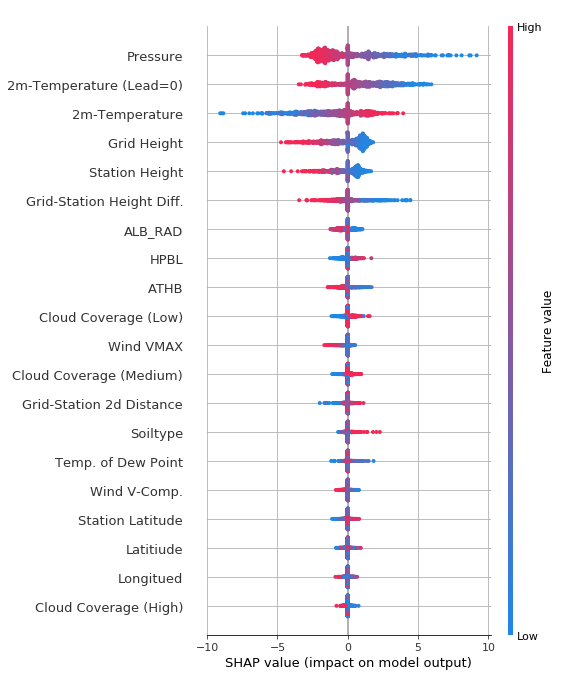

In [124]:
shap.summary_plot(shap_values_jan_afternoon[0], shap_test_data, plot_type=plot_type)

### Prepare data summer/night

In [125]:
# fix seed to randomly sample 1000 samples from ~1M train points
seed = 17257
# select points in january and july from training set to train explanation model
july_night_train_data_set = train_data[train_data['Init'].str.contains('..07..03')]
july_nigh_test_data_set = test_data[test_data['Init'].str.contains('..07..03')]

In [126]:
#explanation_training_set = jan_train_data_set.sample(n=100000, random_state=seed)
explanation_training_set = july_night_train_data_set
explanation_training_data = explanation_training_set.iloc[:,2:-2]
# select randomly test points from test set to calculate SHAP values
shap_test_set = july_nigh_test_data_set
shap_test_data = shap_test_set.iloc[:,2:-2]

In [127]:
start = time()
dense_train_data = shap.kmeans(explanation_training_data, 200)
print("Run Time for KMeans: %ss" % str(time() - start))

Run Time for KMeans: 7.006768465042114s


In [128]:
explainer = shap.KernelExplainer(f, dense_train_data)

Using 200 background data samples could cause slower run times. Consider using shap.kmeans(data, K) to summarize the background as K weighted samples.


FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


In [129]:
shap_values_july_night = explainer.shap_values(shap_test_data, nsamples=150)

  0%|          | 0/1292 [00:00<?, ?it/s]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  0%|          | 1/1292 [00:02<49:56,  2.32s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


  0%|          | 2/1292 [00:04<45:29,  2.12s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  0%|          | 3/1292 [00:06<47:16,  2.20s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  0%|          | 4/1292 [00:08<47:00,  2.19s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  0%|          | 5/1292 [00:11<47:24,  2.21s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  0%|          | 6/1292 [00:13<47:36,  2.22s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 7/1292 [00:15<47:53,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 8/1292 [00:17<47:36,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 9/1292 [00:20<47:39,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 10/1292 [00:22<47:51,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 11/1292 [00:24<47:51,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 12/1292 [00:27<48:00,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 13/1292 [00:29<48:06,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 14/1292 [00:31<48:07,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 15/1292 [00:33<48:05,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 16/1292 [00:36<48:08,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|▏         | 17/1292 [00:38<48:04,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|▏         | 18/1292 [00:40<48:06,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|▏         | 19/1292 [00:43<48:08,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 20/1292 [00:45<48:01,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 21/1292 [00:47<48:04,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 22/1292 [00:49<48:04,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 23/1292 [00:52<48:04,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 24/1292 [00:54<48:02,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 25/1292 [00:56<48:03,  2.28s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 26/1292 [00:59<48:02,  2.28s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 27/1292 [01:01<48:00,  2.28s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 28/1292 [01:03<47:59,  2.28s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 29/1292 [01:06<48:00,  2.28s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 30/1292 [01:07<47:34,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 31/1292 [01:10<47:28,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 32/1292 [01:12<47:28,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


  3%|▎         | 33/1292 [01:14<47:17,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 34/1292 [01:16<47:17,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 35/1292 [01:18<47:14,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 36/1292 [01:21<47:15,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 37/1292 [01:23<47:03,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 38/1292 [01:25<47:01,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 39/1292 [01:27<47:01,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 40/1292 [01:30<47:01,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 41/1292 [01:32<46:59,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 42/1292 [01:34<46:59,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 43/1292 [01:37<46:57,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 44/1292 [01:39<46:55,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 45/1292 [01:41<46:54,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▎         | 46/1292 [01:43<46:50,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


  4%|▎         | 47/1292 [01:45<46:35,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▎         | 48/1292 [01:47<46:30,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 49/1292 [01:49<46:29,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 50/1292 [01:52<46:29,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 51/1292 [01:54<46:28,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 52/1292 [01:56<46:23,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 53/1292 [01:59<46:23,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 54/1292 [02:01<46:22,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 55/1292 [02:03<46:20,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


  4%|▍         | 56/1292 [02:04<45:57,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 57/1292 [02:07<45:55,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 58/1292 [02:09<45:54,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▍         | 59/1292 [02:11<45:53,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▍         | 60/1292 [02:14<45:53,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▍         | 61/1292 [02:16<45:53,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▍         | 62/1292 [02:18<45:52,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▍         | 63/1292 [02:21<45:51,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▍         | 64/1292 [02:23<45:51,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▌         | 65/1292 [02:25<45:50,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▌         | 66/1292 [02:28<45:49,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▌         | 67/1292 [02:30<45:48,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▌         | 68/1292 [02:32<45:48,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▌         | 69/1292 [02:35<45:48,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▌         | 70/1292 [02:37<45:47,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▌         | 71/1292 [02:39<45:48,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 72/1292 [02:42<45:46,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 73/1292 [02:44<45:46,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 74/1292 [02:46<45:43,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 75/1292 [02:48<45:42,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 76/1292 [02:51<45:40,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 77/1292 [02:53<45:38,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 78/1292 [02:55<45:36,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 79/1292 [02:58<45:35,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 80/1292 [03:00<45:33,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


  6%|▋         | 81/1292 [03:02<45:24,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▋         | 82/1292 [03:04<45:20,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▋         | 83/1292 [03:06<45:19,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 84/1292 [03:08<45:17,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 85/1292 [03:11<45:17,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 86/1292 [03:12<45:06,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 87/1292 [03:15<45:04,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 88/1292 [03:17<45:03,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 89/1292 [03:19<45:01,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 90/1292 [03:22<45:00,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 91/1292 [03:24<44:58,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 92/1292 [03:26<44:57,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 93/1292 [03:29<44:55,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 94/1292 [03:31<44:53,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 95/1292 [03:33<44:52,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 96/1292 [03:35<44:50,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 97/1292 [03:38<44:49,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 98/1292 [03:40<44:48,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 99/1292 [03:42<44:46,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 100/1292 [03:45<44:45,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 101/1292 [03:47<44:43,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 102/1292 [03:49<44:42,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 103/1292 [03:52<44:41,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 104/1292 [03:54<44:40,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 105/1292 [03:57<44:39,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 106/1292 [03:59<44:38,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 107/1292 [04:01<44:37,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 108/1292 [04:03<44:33,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 109/1292 [04:06<44:32,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▊         | 110/1292 [04:08<44:31,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▊         | 111/1292 [04:10<44:30,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▊         | 112/1292 [04:13<44:28,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▊         | 113/1292 [04:15<44:27,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 114/1292 [04:17<44:25,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 115/1292 [04:20<44:23,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 116/1292 [04:22<44:22,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 117/1292 [04:24<44:21,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 118/1292 [04:27<44:19,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 119/1292 [04:29<44:17,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 120/1292 [04:31<44:15,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 121/1292 [04:34<44:13,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 122/1292 [04:36<44:12,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|▉         | 123/1292 [04:38<44:10,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|▉         | 124/1292 [04:41<44:08,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|▉         | 125/1292 [04:43<44:06,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|▉         | 126/1292 [04:45<44:04,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|▉         | 127/1292 [04:48<44:02,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|▉         | 128/1292 [04:50<44:00,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|▉         | 129/1292 [04:52<43:58,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|█         | 130/1292 [04:54<43:56,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|█         | 131/1292 [04:57<43:54,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|█         | 132/1292 [04:59<43:53,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|█         | 133/1292 [05:01<43:49,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|█         | 134/1292 [05:04<43:47,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|█         | 135/1292 [05:06<43:45,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 136/1292 [05:08<43:43,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 137/1292 [05:10<43:41,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 138/1292 [05:13<43:40,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 139/1292 [05:15<43:37,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 140/1292 [05:17<43:32,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 141/1292 [05:19<43:31,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 142/1292 [05:22<43:29,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 143/1292 [05:24<43:27,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 144/1292 [05:26<43:24,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 145/1292 [05:29<43:22,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█▏        | 146/1292 [05:31<43:21,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█▏        | 147/1292 [05:33<43:18,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█▏        | 148/1292 [05:35<43:16,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 149/1292 [05:38<43:14,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 150/1292 [05:40<43:12,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 151/1292 [05:42<43:10,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 152/1292 [05:45<43:08,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 153/1292 [05:47<43:06,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 154/1292 [05:49<43:03,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 155/1292 [05:51<43:01,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 156/1292 [05:54<42:59,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 157/1292 [05:56<42:57,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 158/1292 [05:58<42:56,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 159/1292 [06:01<42:54,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 160/1292 [06:03<42:52,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 161/1292 [06:05<42:49,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 162/1292 [06:08<42:47,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 163/1292 [06:10<42:46,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 164/1292 [06:12<42:44,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 165/1292 [06:15<42:41,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 166/1292 [06:17<42:39,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 167/1292 [06:19<42:37,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 168/1292 [06:21<42:35,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 169/1292 [06:24<42:32,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 170/1292 [06:26<42:30,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 171/1292 [06:28<42:27,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 172/1292 [06:30<42:25,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 173/1292 [06:33<42:23,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 174/1292 [06:35<42:20,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▎        | 175/1292 [06:37<42:18,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▎        | 176/1292 [06:40<42:16,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▎        | 177/1292 [06:42<42:12,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 14%|█▍        | 178/1292 [06:43<42:05,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 179/1292 [06:45<42:01,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 180/1292 [06:47<41:59,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 181/1292 [06:50<41:58,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 182/1292 [06:52<41:56,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 183/1292 [06:54<41:54,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 184/1292 [06:57<41:52,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 185/1292 [06:59<41:50,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 186/1292 [07:01<41:47,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 187/1292 [07:04<41:45,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▍        | 188/1292 [07:06<41:43,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▍        | 189/1292 [07:08<41:40,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▍        | 190/1292 [07:10<41:37,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▍        | 191/1292 [07:12<41:35,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▍        | 192/1292 [07:15<41:33,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▍        | 193/1292 [07:17<41:30,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▌        | 194/1292 [07:19<41:28,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▌        | 195/1292 [07:22<41:26,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▌        | 196/1292 [07:24<41:24,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▌        | 197/1292 [07:26<41:22,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▌        | 198/1292 [07:29<41:20,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▌        | 199/1292 [07:31<41:17,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▌        | 200/1292 [07:33<41:15,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 201/1292 [07:35<41:13,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 202/1292 [07:37<41:11,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 203/1292 [07:40<41:09,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 204/1292 [07:42<41:07,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 205/1292 [07:44<41:05,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 206/1292 [07:47<41:03,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 207/1292 [07:49<41:01,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 208/1292 [07:51<40:59,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 209/1292 [07:54<40:57,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▋        | 210/1292 [07:56<40:55,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▋        | 211/1292 [07:58<40:52,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▋        | 212/1292 [08:01<40:50,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▋        | 213/1292 [08:03<40:48,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 214/1292 [08:05<40:46,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 215/1292 [08:07<40:43,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 17%|█▋        | 216/1292 [08:09<40:40,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 217/1292 [08:12<40:38,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 218/1292 [08:14<40:36,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 219/1292 [08:16<40:34,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 220/1292 [08:19<40:32,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 221/1292 [08:21<40:30,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 222/1292 [08:23<40:28,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 223/1292 [08:26<40:25,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 224/1292 [08:28<40:23,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 225/1292 [08:30<40:21,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 226/1292 [08:32<40:19,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 227/1292 [08:35<40:17,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 228/1292 [08:37<40:15,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 229/1292 [08:39<40:13,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 230/1292 [08:42<40:11,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 231/1292 [08:44<40:08,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 232/1292 [08:46<40:06,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 233/1292 [08:49<40:04,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 234/1292 [08:51<40:02,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 235/1292 [08:53<40:00,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 236/1292 [08:55<39:57,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 237/1292 [08:58<39:55,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 238/1292 [09:00<39:53,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 239/1292 [09:02<39:51,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▊        | 240/1292 [09:05<39:49,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▊        | 241/1292 [09:07<39:47,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▊        | 242/1292 [09:09<39:45,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 243/1292 [09:11<39:42,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 244/1292 [09:14<39:40,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 245/1292 [09:16<39:38,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 246/1292 [09:18<39:36,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 247/1292 [09:21<39:33,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 248/1292 [09:23<39:31,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 249/1292 [09:25<39:27,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 250/1292 [09:27<39:25,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 251/1292 [09:29<39:23,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|█▉        | 252/1292 [09:32<39:21,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|█▉        | 253/1292 [09:34<39:19,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|█▉        | 254/1292 [09:36<39:16,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|█▉        | 255/1292 [09:39<39:14,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|█▉        | 256/1292 [09:41<39:12,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|█▉        | 257/1292 [09:43<39:10,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|█▉        | 258/1292 [09:45<39:08,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|██        | 259/1292 [09:47<39:04,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|██        | 260/1292 [09:50<39:02,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|██        | 261/1292 [09:52<39:00,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|██        | 262/1292 [09:54<38:57,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|██        | 263/1292 [09:56<38:55,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|██        | 264/1292 [09:59<38:53,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 265/1292 [10:01<38:51,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 266/1292 [10:03<38:48,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 267/1292 [10:05<38:46,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 268/1292 [10:08<38:44,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 269/1292 [10:10<38:41,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 270/1292 [10:12<38:39,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 271/1292 [10:15<38:37,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 272/1292 [10:17<38:35,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 273/1292 [10:19<38:32,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 274/1292 [10:21<38:30,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██▏       | 275/1292 [10:24<38:28,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██▏       | 276/1292 [10:26<38:26,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██▏       | 277/1292 [10:28<38:24,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 22%|██▏       | 278/1292 [10:31<38:22,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 279/1292 [10:33<38:19,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 280/1292 [10:35<38:17,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 281/1292 [10:37<38:15,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 282/1292 [10:40<38:13,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 283/1292 [10:42<38:10,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 284/1292 [10:44<38:08,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 285/1292 [10:47<38:06,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 286/1292 [10:49<38:04,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 287/1292 [10:51<38:01,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 288/1292 [10:53<37:58,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 289/1292 [10:55<37:56,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 290/1292 [10:58<37:53,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 291/1292 [11:00<37:51,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 292/1292 [11:02<37:49,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 293/1292 [11:05<37:47,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 294/1292 [11:07<37:45,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 295/1292 [11:09<37:43,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 296/1292 [11:11<37:41,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 297/1292 [11:14<37:38,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 298/1292 [11:16<37:36,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 299/1292 [11:18<37:34,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 300/1292 [11:21<37:31,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 301/1292 [11:23<37:29,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 302/1292 [11:25<37:27,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 303/1292 [11:27<37:25,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▎       | 304/1292 [11:30<37:23,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▎       | 305/1292 [11:32<37:21,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▎       | 306/1292 [11:34<37:18,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 307/1292 [11:37<37:16,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 308/1292 [11:39<37:15,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 309/1292 [11:41<37:12,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 310/1292 [11:44<37:10,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 311/1292 [11:46<37:08,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 312/1292 [11:48<37:06,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 313/1292 [11:51<37:03,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 314/1292 [11:53<37:01,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 315/1292 [11:55<36:59,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 316/1292 [11:57<36:57,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▍       | 317/1292 [12:00<36:55,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▍       | 318/1292 [12:02<36:52,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▍       | 319/1292 [12:04<36:50,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▍       | 320/1292 [12:06<36:47,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▍       | 321/1292 [12:09<36:45,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▍       | 322/1292 [12:11<36:43,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▌       | 323/1292 [12:13<36:41,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▌       | 324/1292 [12:16<36:39,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▌       | 325/1292 [12:18<36:36,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▌       | 326/1292 [12:20<36:34,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▌       | 327/1292 [12:22<36:32,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▌       | 328/1292 [12:25<36:30,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▌       | 329/1292 [12:27<36:27,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 330/1292 [12:29<36:25,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 331/1292 [12:31<36:23,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 332/1292 [12:34<36:21,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 333/1292 [12:36<36:18,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 334/1292 [12:38<36:16,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 335/1292 [12:41<36:14,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 336/1292 [12:43<36:11,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 337/1292 [12:45<36:09,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 338/1292 [12:47<36:07,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 339/1292 [12:50<36:05,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▋       | 340/1292 [12:52<36:03,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▋       | 341/1292 [12:54<36:01,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▋       | 342/1292 [12:57<35:58,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 343/1292 [12:59<35:56,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 344/1292 [13:01<35:54,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 345/1292 [13:03<35:51,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 346/1292 [13:06<35:49,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 347/1292 [13:08<35:47,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 348/1292 [13:10<35:44,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 349/1292 [13:12<35:42,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 350/1292 [13:15<35:40,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 351/1292 [13:17<35:38,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 352/1292 [13:19<35:35,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 353/1292 [13:22<35:33,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 354/1292 [13:24<35:31,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 355/1292 [13:26<35:28,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 356/1292 [13:28<35:26,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 357/1292 [13:31<35:24,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 358/1292 [13:33<35:22,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 359/1292 [13:35<35:20,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 360/1292 [13:37<35:17,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 361/1292 [13:40<35:15,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 362/1292 [13:42<35:13,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 363/1292 [13:44<35:10,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 364/1292 [13:47<35:08,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 365/1292 [13:49<35:06,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 366/1292 [13:51<35:04,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 367/1292 [13:54<35:02,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 368/1292 [13:56<34:59,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▊       | 369/1292 [13:58<34:56,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▊       | 370/1292 [14:00<34:54,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▊       | 371/1292 [14:02<34:52,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 372/1292 [14:05<34:50,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 373/1292 [14:07<34:48,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 374/1292 [14:09<34:45,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 375/1292 [14:12<34:43,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 376/1292 [14:14<34:41,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 377/1292 [14:16<34:39,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 378/1292 [14:19<34:37,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 379/1292 [14:21<34:35,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 380/1292 [14:23<34:33,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 381/1292 [14:26<34:30,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|██▉       | 382/1292 [14:28<34:28,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|██▉       | 383/1292 [14:30<34:26,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|██▉       | 384/1292 [14:33<34:24,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|██▉       | 385/1292 [14:34<34:21,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|██▉       | 386/1292 [14:37<34:18,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 30%|██▉       | 387/1292 [14:39<34:16,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|███       | 388/1292 [14:41<34:14,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|███       | 389/1292 [14:44<34:12,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|███       | 390/1292 [14:46<34:10,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|███       | 391/1292 [14:48<34:06,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|███       | 392/1292 [14:50<34:04,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|███       | 393/1292 [14:52<34:02,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 30%|███       | 394/1292 [14:54<33:59,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 395/1292 [14:57<33:57,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 396/1292 [14:59<33:55,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 397/1292 [15:01<33:53,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 398/1292 [15:04<33:50,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 31%|███       | 399/1292 [15:05<33:47,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 400/1292 [15:08<33:44,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 401/1292 [15:10<33:42,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 402/1292 [15:12<33:40,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 403/1292 [15:14<33:38,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███▏      | 404/1292 [15:17<33:36,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███▏      | 405/1292 [15:19<33:34,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███▏      | 406/1292 [15:21<33:31,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 407/1292 [15:24<33:29,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 408/1292 [15:26<33:27,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 409/1292 [15:28<33:23,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 410/1292 [15:30<33:21,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 411/1292 [15:32<33:19,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 412/1292 [15:35<33:17,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 413/1292 [15:37<33:15,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 414/1292 [15:39<33:13,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 415/1292 [15:42<33:10,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 416/1292 [15:43<33:07,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 417/1292 [15:46<33:05,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 418/1292 [15:48<33:03,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 419/1292 [15:50<33:00,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 420/1292 [15:53<32:58,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 421/1292 [15:55<32:56,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 422/1292 [15:57<32:54,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 423/1292 [15:59<32:50,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 424/1292 [16:01<32:48,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 33%|███▎      | 425/1292 [16:03<32:45,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 426/1292 [16:05<32:41,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 427/1292 [16:07<32:39,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 428/1292 [16:09<32:36,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 429/1292 [16:11<32:33,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 430/1292 [16:13<32:31,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 431/1292 [16:15<32:29,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 432/1292 [16:18<32:27,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▎      | 433/1292 [16:20<32:25,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▎      | 434/1292 [16:22<32:22,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▎      | 435/1292 [16:24<32:20,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▎      | 436/1292 [16:27<32:18,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 437/1292 [16:29<32:15,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 438/1292 [16:31<32:13,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 439/1292 [16:33<32:11,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 440/1292 [16:36<32:09,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 441/1292 [16:38<32:07,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 442/1292 [16:40<32:04,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 34%|███▍      | 443/1292 [16:43<32:02,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 444/1292 [16:45<32:00,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 445/1292 [16:47<31:57,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▍      | 446/1292 [16:49<31:55,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▍      | 447/1292 [16:52<31:53,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▍      | 448/1292 [16:54<31:51,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▍      | 449/1292 [16:56<31:49,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▍      | 450/1292 [16:59<31:46,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▍      | 451/1292 [17:01<31:44,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▍      | 452/1292 [17:03<31:42,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▌      | 453/1292 [17:05<31:40,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▌      | 454/1292 [17:08<31:38,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▌      | 455/1292 [17:10<31:35,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▌      | 456/1292 [17:13<31:33,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▌      | 457/1292 [17:15<31:31,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▌      | 458/1292 [17:17<31:29,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 459/1292 [17:19<31:27,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 460/1292 [17:22<31:24,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 461/1292 [17:24<31:22,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 462/1292 [17:26<31:20,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 463/1292 [17:29<31:18,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 464/1292 [17:31<31:16,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 465/1292 [17:33<31:13,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 466/1292 [17:36<31:11,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 467/1292 [17:38<31:09,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 468/1292 [17:40<31:07,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▋      | 469/1292 [17:43<31:05,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▋      | 470/1292 [17:45<31:02,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▋      | 471/1292 [17:47<31:00,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 472/1292 [17:49<30:58,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 37%|███▋      | 473/1292 [17:51<30:56,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 474/1292 [17:54<30:53,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 475/1292 [17:56<30:51,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 476/1292 [17:58<30:48,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 37%|███▋      | 477/1292 [18:00<30:45,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 478/1292 [18:02<30:43,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 479/1292 [18:04<30:41,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 480/1292 [18:06<30:38,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 481/1292 [18:08<30:35,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 482/1292 [18:11<30:33,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 37%|███▋      | 483/1292 [18:13<30:31,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 484/1292 [18:15<30:28,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 485/1292 [18:17<30:26,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 486/1292 [18:20<30:24,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 487/1292 [18:22<30:22,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 488/1292 [18:24<30:19,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 489/1292 [18:26<30:17,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 490/1292 [18:28<30:15,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 491/1292 [18:31<30:12,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 492/1292 [18:33<30:10,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 493/1292 [18:35<30:08,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 494/1292 [18:37<30:05,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 495/1292 [18:40<30:03,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 496/1292 [18:42<30:01,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 497/1292 [18:44<29:59,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▊      | 498/1292 [18:47<29:57,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▊      | 499/1292 [18:49<29:55,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▊      | 500/1292 [18:51<29:52,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 501/1292 [18:54<29:50,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 502/1292 [18:56<29:48,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 503/1292 [18:58<29:46,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 504/1292 [19:00<29:43,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 505/1292 [19:03<29:41,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 506/1292 [19:05<29:39,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 507/1292 [19:07<29:37,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 508/1292 [19:10<29:34,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 509/1292 [19:12<29:32,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 510/1292 [19:14<29:30,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|███▉      | 511/1292 [19:17<29:28,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|███▉      | 512/1292 [19:19<29:26,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|███▉      | 513/1292 [19:21<29:23,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|███▉      | 514/1292 [19:23<29:21,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|███▉      | 515/1292 [19:26<29:19,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|███▉      | 516/1292 [19:28<29:17,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|████      | 517/1292 [19:30<29:15,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|████      | 518/1292 [19:33<29:12,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|████      | 519/1292 [19:35<29:10,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 40%|████      | 520/1292 [19:37<29:08,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|████      | 521/1292 [19:39<29:05,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|████      | 522/1292 [19:42<29:03,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|████      | 523/1292 [19:44<29:01,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 524/1292 [19:46<28:59,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 525/1292 [19:48<28:56,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 526/1292 [19:51<28:54,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 527/1292 [19:53<28:52,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 528/1292 [19:55<28:50,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 529/1292 [19:57<28:47,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 530/1292 [20:00<28:45,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 531/1292 [20:02<28:43,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 532/1292 [20:04<28:41,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████▏     | 533/1292 [20:07<28:38,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████▏     | 534/1292 [20:09<28:36,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████▏     | 535/1292 [20:11<28:34,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████▏     | 536/1292 [20:13<28:31,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 537/1292 [20:15<28:29,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 538/1292 [20:17<28:26,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 539/1292 [20:19<28:24,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 42%|████▏     | 540/1292 [20:22<28:21,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 541/1292 [20:24<28:19,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 542/1292 [20:26<28:17,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 543/1292 [20:28<28:15,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 544/1292 [20:31<28:13,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 545/1292 [20:33<28:10,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 546/1292 [20:36<28:08,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 547/1292 [20:38<28:06,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 42%|████▏     | 548/1292 [20:40<28:03,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 549/1292 [20:42<28:01,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 550/1292 [20:44<27:59,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 551/1292 [20:46<27:56,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 552/1292 [20:49<27:54,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 553/1292 [20:51<27:52,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 554/1292 [20:53<27:50,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 555/1292 [20:55<27:47,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 556/1292 [20:58<27:45,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 557/1292 [21:00<27:43,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 558/1292 [21:02<27:40,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 559/1292 [21:04<27:38,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 560/1292 [21:07<27:36,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 561/1292 [21:09<27:34,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 562/1292 [21:11<27:31,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▎     | 563/1292 [21:14<27:29,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▎     | 564/1292 [21:16<27:27,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▎     | 565/1292 [21:18<27:25,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 566/1292 [21:20<27:23,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 567/1292 [21:23<27:20,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 568/1292 [21:25<27:18,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 569/1292 [21:27<27:16,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 570/1292 [21:30<27:14,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 571/1292 [21:32<27:12,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 572/1292 [21:34<27:09,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 573/1292 [21:37<27:07,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 574/1292 [21:39<27:05,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▍     | 575/1292 [21:41<27:03,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▍     | 576/1292 [21:44<27:01,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▍     | 577/1292 [21:46<26:58,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▍     | 578/1292 [21:48<26:56,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▍     | 579/1292 [21:51<26:54,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 45%|████▍     | 580/1292 [21:53<26:52,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▍     | 581/1292 [21:55<26:50,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▌     | 582/1292 [21:57<26:47,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▌     | 583/1292 [22:00<26:45,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▌     | 584/1292 [22:02<26:43,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▌     | 585/1292 [22:04<26:41,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▌     | 586/1292 [22:07<26:38,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▌     | 587/1292 [22:09<26:36,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 588/1292 [22:11<26:34,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 46%|████▌     | 589/1292 [22:13<26:31,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 590/1292 [22:16<26:29,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 591/1292 [22:18<26:27,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 592/1292 [22:20<26:25,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 593/1292 [22:22<26:23,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 594/1292 [22:25<26:20,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 595/1292 [22:27<26:18,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 596/1292 [22:29<26:16,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 597/1292 [22:31<26:13,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▋     | 598/1292 [22:34<26:11,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▋     | 599/1292 [22:36<26:09,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▋     | 600/1292 [22:38<26:06,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 601/1292 [22:40<26:04,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 602/1292 [22:43<26:02,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 603/1292 [22:45<26:00,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 604/1292 [22:47<25:58,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 605/1292 [22:50<25:55,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 606/1292 [22:52<25:53,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 607/1292 [22:54<25:51,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 608/1292 [22:57<25:49,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 609/1292 [22:59<25:47,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 610/1292 [23:01<25:44,  2.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 611/1292 [23:03<25:42,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 612/1292 [23:05<25:39,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 613/1292 [23:08<25:37,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 614/1292 [23:10<25:35,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 615/1292 [23:12<25:33,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 48%|████▊     | 616/1292 [23:15<25:30,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 617/1292 [23:17<25:28,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 618/1292 [23:19<25:26,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 619/1292 [23:21<25:24,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 620/1292 [23:23<25:21,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 621/1292 [23:26<25:19,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 622/1292 [23:28<25:16,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 623/1292 [23:30<25:14,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 624/1292 [23:32<25:12,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 625/1292 [23:35<25:10,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 626/1292 [23:37<25:08,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▊     | 627/1292 [23:39<25:05,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▊     | 628/1292 [23:41<25:03,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▊     | 629/1292 [23:43<25:00,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 630/1292 [23:46<24:58,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 631/1292 [23:48<24:56,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 632/1292 [23:50<24:53,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 633/1292 [23:52<24:51,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 634/1292 [23:54<24:49,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 635/1292 [23:57<24:46,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 636/1292 [23:59<24:44,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 637/1292 [24:01<24:42,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 638/1292 [24:03<24:40,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 639/1292 [24:06<24:37,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|████▉     | 640/1292 [24:08<24:35,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|████▉     | 641/1292 [24:10<24:33,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|████▉     | 642/1292 [24:13<24:31,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 50%|████▉     | 643/1292 [24:15<24:28,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|████▉     | 644/1292 [24:17<24:26,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|████▉     | 645/1292 [24:19<24:23,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|█████     | 646/1292 [24:21<24:21,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|█████     | 647/1292 [24:23<24:19,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|█████     | 648/1292 [24:25<24:16,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|█████     | 649/1292 [24:27<24:14,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|█████     | 650/1292 [24:30<24:12,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|█████     | 651/1292 [24:32<24:09,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|█████     | 652/1292 [24:34<24:07,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 653/1292 [24:37<24:05,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 654/1292 [24:38<24:02,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 655/1292 [24:41<24:00,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 51%|█████     | 656/1292 [24:43<23:58,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 657/1292 [24:45<23:55,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 658/1292 [24:47<23:53,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 659/1292 [24:50<23:51,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 660/1292 [24:52<23:49,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 661/1292 [24:54<23:47,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 662/1292 [24:57<23:44,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 51%|█████▏    | 663/1292 [24:59<23:42,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████▏    | 664/1292 [25:01<23:40,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 51%|█████▏    | 665/1292 [25:03<23:37,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 666/1292 [25:05<23:35,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 667/1292 [25:07<23:32,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 668/1292 [25:10<23:30,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 669/1292 [25:12<23:28,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 670/1292 [25:14<23:26,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 671/1292 [25:17<23:24,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 672/1292 [25:19<23:21,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 673/1292 [25:21<23:19,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 674/1292 [25:23<23:17,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 675/1292 [25:26<23:15,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 676/1292 [25:28<23:12,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 52%|█████▏    | 677/1292 [25:29<23:09,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 678/1292 [25:32<23:07,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 679/1292 [25:34<23:05,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 680/1292 [25:36<23:03,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 53%|█████▎    | 681/1292 [25:38<23:00,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 682/1292 [25:41<22:58,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 683/1292 [25:43<22:56,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 53%|█████▎    | 684/1292 [25:45<22:53,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 685/1292 [25:47<22:51,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 53%|█████▎    | 686/1292 [25:49<22:49,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 687/1292 [25:51<22:46,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 688/1292 [25:53<22:44,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 689/1292 [25:56<22:42,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 690/1292 [25:58<22:39,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 691/1292 [26:00<22:37,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▎    | 692/1292 [26:03<22:35,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▎    | 693/1292 [26:05<22:33,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▎    | 694/1292 [26:07<22:30,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 695/1292 [26:09<22:28,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 54%|█████▍    | 696/1292 [26:11<22:25,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 697/1292 [26:13<22:23,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 698/1292 [26:15<22:20,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 699/1292 [26:17<22:17,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 700/1292 [26:18<22:15,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 701/1292 [26:20<22:12,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 702/1292 [26:23<22:10,  2.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 54%|█████▍    | 703/1292 [26:24<22:07,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 704/1292 [26:26<22:05,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▍    | 705/1292 [26:28<22:02,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▍    | 706/1292 [26:30<21:59,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▍    | 707/1292 [26:32<21:57,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▍    | 708/1292 [26:33<21:54,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 55%|█████▍    | 709/1292 [26:35<21:52,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▍    | 710/1292 [26:37<21:49,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▌    | 711/1292 [26:39<21:47,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▌    | 712/1292 [26:41<21:44,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 55%|█████▌    | 713/1292 [26:43<21:42,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▌    | 714/1292 [26:45<21:39,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▌    | 715/1292 [26:47<21:37,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▌    | 716/1292 [26:49<21:34,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 55%|█████▌    | 717/1292 [26:51<21:31,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 718/1292 [26:53<21:29,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 719/1292 [26:54<21:26,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 720/1292 [26:56<21:24,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 721/1292 [26:58<21:22,  2.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 722/1292 [27:00<21:19,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 56%|█████▌    | 723/1292 [27:02<21:17,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 724/1292 [27:04<21:14,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 725/1292 [27:06<21:12,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 726/1292 [27:08<21:09,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▋    | 727/1292 [27:10<21:07,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▋    | 728/1292 [27:12<21:04,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▋    | 729/1292 [27:14<21:02,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 57%|█████▋    | 730/1292 [27:16<20:59,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 731/1292 [27:17<20:56,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 732/1292 [27:19<20:54,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 57%|█████▋    | 733/1292 [27:21<20:51,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 734/1292 [27:23<20:49,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 735/1292 [27:24<20:46,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 736/1292 [27:25<20:43,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 737/1292 [27:27<20:40,  2.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 57%|█████▋    | 738/1292 [27:28<20:37,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 739/1292 [27:29<20:34,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 740/1292 [27:31<20:31,  2.23s/it]


FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_

 57%|█████▋    | 741/1292 [27:32<20:28,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 57%|█████▋    | 742/1292 [27:34<20:26,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 743/1292 [27:35<20:23,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 744/1292 [27:36<20:20,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 745/1292 [27:38<20:17,  2.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 58%|█████▊    | 746/1292 [27:39<20:14,  2.22s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 747/1292 [27:41<20:11,  2.22s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 748/1292 [27:42<20:09,  2.22s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 749/1292 [27:44<20:06,  2.22s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 58%|█████▊    | 750/1292 [27:45<20:03,  2.22s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 751/1292 [27:47<20:01,  2.22s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 752/1292 [27:48<19:58,  2.22s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 58%|█████▊    | 753/1292 [27:50<19:55,  2.22s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 754/1292 [27:51<19:52,  2.22s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 755/1292 [27:52<19:49,  2.22s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▊    | 756/1292 [27:54<19:46,  2.21s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▊    | 757/1292 [27:55<19:44,  2.21s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▊    | 758/1292 [27:56<19:41,  2.21s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▊    | 759/1292 [27:58<19:38,  2.21s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 59%|█████▉    | 760/1292 [27:59<19:35,  2.21s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 761/1292 [28:00<19:32,  2.21s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 762/1292 [28:01<19:29,  2.21s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 763/1292 [28:03<19:26,  2.21s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 764/1292 [28:04<19:24,  2.20s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 765/1292 [28:05<19:21,  2.20s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 766/1292 [28:07<19:18,  2.20s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 767/1292 [28:08<19:15,  2.20s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 768/1292 [28:09<19:12,  2.20s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|█████▉    | 769/1292 [28:11<19:10,  2.20s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|█████▉    | 770/1292 [28:12<19:07,  2.20s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|█████▉    | 771/1292 [28:14<19:04,  2.20s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|█████▉    | 772/1292 [28:15<19:01,  2.20s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|█████▉    | 773/1292 [28:16<18:59,  2.19s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|█████▉    | 774/1292 [28:18<18:56,  2.19s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|█████▉    | 775/1292 [28:19<18:53,  2.19s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|██████    | 776/1292 [28:20<18:50,  2.19s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|██████    | 777/1292 [28:22<18:48,  2.19s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|██████    | 778/1292 [28:23<18:45,  2.19s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|██████    | 779/1292 [28:24<18:42,  2.19s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|██████    | 780/1292 [28:26<18:39,  2.19s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|██████    | 781/1292 [28:27<18:37,  2.19s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 61%|██████    | 782/1292 [28:28<18:34,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 783/1292 [28:29<18:31,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 784/1292 [28:31<18:28,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 785/1292 [28:32<18:26,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 786/1292 [28:33<18:23,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 787/1292 [28:35<18:20,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 788/1292 [28:36<18:17,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 789/1292 [28:38<18:15,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 790/1292 [28:39<18:12,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 791/1292 [28:40<18:09,  2.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████▏   | 792/1292 [28:41<18:07,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 61%|██████▏   | 793/1292 [28:43<18:04,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████▏   | 794/1292 [28:44<18:01,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 795/1292 [28:46<17:59,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 796/1292 [28:47<17:56,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 797/1292 [28:48<17:53,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 798/1292 [28:49<17:50,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 799/1292 [28:50<17:47,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 800/1292 [28:52<17:45,  2.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 801/1292 [28:53<17:42,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 802/1292 [28:54<17:39,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 803/1292 [28:55<17:37,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 804/1292 [28:57<17:34,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 805/1292 [28:58<17:31,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 806/1292 [29:00<17:29,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 807/1292 [29:02<17:26,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 808/1292 [29:03<17:24,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 809/1292 [29:04<17:21,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 63%|██████▎   | 810/1292 [29:05<17:18,  2.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 811/1292 [29:07<17:16,  2.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 812/1292 [29:08<17:13,  2.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 813/1292 [29:09<17:10,  2.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 814/1292 [29:11<17:08,  2.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 815/1292 [29:12<17:05,  2.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 63%|██████▎   | 816/1292 [29:13<17:03,  2.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 817/1292 [29:15<17:00,  2.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 818/1292 [29:16<16:57,  2.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 819/1292 [29:17<16:55,  2.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 820/1292 [29:18<16:52,  2.14s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 64%|██████▎   | 821/1292 [29:20<16:49,  2.14s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▎   | 822/1292 [29:21<16:47,  2.14s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▎   | 823/1292 [29:22<16:44,  2.14s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 824/1292 [29:23<16:41,  2.14s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 825/1292 [29:25<16:39,  2.14s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 826/1292 [29:26<16:36,  2.14s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 827/1292 [29:27<16:33,  2.14s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 828/1292 [29:28<16:31,  2.14s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 829/1292 [29:30<16:28,  2.14s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 830/1292 [29:31<16:25,  2.13s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 831/1292 [29:32<16:23,  2.13s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 832/1292 [29:33<16:20,  2.13s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 833/1292 [29:34<16:17,  2.13s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▍   | 834/1292 [29:35<16:15,  2.13s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▍   | 835/1292 [29:37<16:12,  2.13s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 65%|██████▍   | 836/1292 [29:38<16:10,  2.13s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▍   | 837/1292 [29:39<16:07,  2.13s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▍   | 838/1292 [29:40<16:04,  2.13s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▍   | 839/1292 [29:42<16:02,  2.12s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▌   | 840/1292 [29:44<16:00,  2.12s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 65%|██████▌   | 841/1292 [29:45<15:57,  2.12s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▌   | 842/1292 [29:47<15:55,  2.12s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▌   | 843/1292 [29:48<15:52,  2.12s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▌   | 844/1292 [29:49<15:49,  2.12s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▌   | 845/1292 [29:50<15:47,  2.12s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▌   | 846/1292 [29:52<15:44,  2.12s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 847/1292 [29:53<15:42,  2.12s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 848/1292 [29:54<15:39,  2.12s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 849/1292 [29:56<15:37,  2.12s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 850/1292 [29:57<15:34,  2.11s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 851/1292 [29:58<15:31,  2.11s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 852/1292 [29:59<15:29,  2.11s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 853/1292 [30:01<15:26,  2.11s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 854/1292 [30:02<15:24,  2.11s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 855/1292 [30:03<15:21,  2.11s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▋   | 856/1292 [30:04<15:19,  2.11s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▋   | 857/1292 [30:06<15:16,  2.11s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▋   | 858/1292 [30:07<15:14,  2.11s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▋   | 859/1292 [30:08<15:11,  2.11s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 860/1292 [30:09<15:09,  2.10s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 861/1292 [30:10<15:06,  2.10s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 862/1292 [30:11<15:03,  2.10s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 863/1292 [30:13<15:01,  2.10s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 864/1292 [30:14<14:58,  2.10s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 865/1292 [30:15<14:56,  2.10s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 866/1292 [30:17<14:53,  2.10s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 867/1292 [30:18<14:51,  2.10s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 868/1292 [30:19<14:48,  2.10s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 869/1292 [30:20<14:46,  2.10s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 870/1292 [30:23<14:44,  2.10s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 67%|██████▋   | 871/1292 [30:24<14:41,  2.09s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 872/1292 [30:25<14:39,  2.09s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 873/1292 [30:26<14:36,  2.09s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 874/1292 [30:27<14:34,  2.09s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 875/1292 [30:28<14:31,  2.09s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 876/1292 [30:30<14:29,  2.09s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 877/1292 [30:31<14:26,  2.09s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 878/1292 [30:32<14:24,  2.09s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 879/1292 [30:33<14:21,  2.09s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 880/1292 [30:34<14:18,  2.08s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 881/1292 [30:35<14:16,  2.08s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 882/1292 [30:37<14:13,  2.08s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 883/1292 [30:38<14:11,  2.08s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 884/1292 [30:39<14:08,  2.08s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 885/1292 [30:40<14:06,  2.08s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▊   | 886/1292 [30:41<14:03,  2.08s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▊   | 887/1292 [30:42<14:01,  2.08s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▊   | 888/1292 [30:43<13:58,  2.08s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 889/1292 [30:45<13:56,  2.08s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 890/1292 [30:46<13:53,  2.07s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 891/1292 [30:47<13:51,  2.07s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 892/1292 [30:48<13:49,  2.07s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 893/1292 [30:49<13:46,  2.07s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 894/1292 [30:51<13:44,  2.07s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 895/1292 [30:52<13:41,  2.07s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 896/1292 [30:53<13:39,  2.07s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 897/1292 [30:54<13:36,  2.07s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|██████▉   | 898/1292 [30:55<13:34,  2.07s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|██████▉   | 899/1292 [30:57<13:31,  2.07s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|██████▉   | 900/1292 [30:58<13:29,  2.06s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|██████▉   | 901/1292 [30:59<13:26,  2.06s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|██████▉   | 902/1292 [31:00<13:24,  2.06s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|██████▉   | 903/1292 [31:01<13:21,  2.06s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|██████▉   | 904/1292 [31:02<13:19,  2.06s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|███████   | 905/1292 [31:03<13:17,  2.06s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|███████   | 906/1292 [31:05<13:14,  2.06s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|███████   | 907/1292 [31:06<13:12,  2.06s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|███████   | 908/1292 [31:07<13:09,  2.06s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|███████   | 909/1292 [31:08<13:07,  2.06s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|███████   | 910/1292 [31:09<13:04,  2.05s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 911/1292 [31:11<13:02,  2.05s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 912/1292 [31:12<13:00,  2.05s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 913/1292 [31:13<12:57,  2.05s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 914/1292 [31:14<12:55,  2.05s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 915/1292 [31:16<12:52,  2.05s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 916/1292 [31:17<12:50,  2.05s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 917/1292 [31:18<12:48,  2.05s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 918/1292 [31:19<12:45,  2.05s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 919/1292 [31:20<12:43,  2.05s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 920/1292 [31:21<12:40,  2.05s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████▏  | 921/1292 [31:23<12:38,  2.04s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████▏  | 922/1292 [31:24<12:36,  2.04s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████▏  | 923/1292 [31:25<12:33,  2.04s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 924/1292 [31:26<12:31,  2.04s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 925/1292 [31:27<12:28,  2.04s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 926/1292 [31:28<12:26,  2.04s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 927/1292 [31:30<12:24,  2.04s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 928/1292 [31:31<12:21,  2.04s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 929/1292 [31:32<12:19,  2.04s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 930/1292 [31:33<12:17,  2.04s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 931/1292 [31:34<12:14,  2.04s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 932/1292 [31:35<12:12,  2.03s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 933/1292 [31:37<12:09,  2.03s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 934/1292 [31:38<12:07,  2.03s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 935/1292 [31:39<12:05,  2.03s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 936/1292 [31:40<12:02,  2.03s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 937/1292 [31:41<12:00,  2.03s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 938/1292 [31:43<11:58,  2.03s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 939/1292 [31:44<11:55,  2.03s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 940/1292 [31:45<11:53,  2.03s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 941/1292 [31:46<11:51,  2.03s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 942/1292 [31:47<11:48,  2.03s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 943/1292 [31:48<11:46,  2.02s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 944/1292 [31:50<11:44,  2.02s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 945/1292 [31:51<11:41,  2.02s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 946/1292 [31:52<11:39,  2.02s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 947/1292 [31:53<11:37,  2.02s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 948/1292 [31:54<11:34,  2.02s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 949/1292 [31:55<11:32,  2.02s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▎  | 950/1292 [31:57<11:30,  2.02s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▎  | 951/1292 [31:58<11:27,  2.02s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▎  | 952/1292 [31:59<11:25,  2.02s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 953/1292 [32:00<11:23,  2.02s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 954/1292 [32:01<11:20,  2.01s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 955/1292 [32:02<11:18,  2.01s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 956/1292 [32:04<11:16,  2.01s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 957/1292 [32:05<11:13,  2.01s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 958/1292 [32:06<11:11,  2.01s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 959/1292 [32:07<11:09,  2.01s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 960/1292 [32:08<11:06,  2.01s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 961/1292 [32:09<11:04,  2.01s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 962/1292 [32:10<11:02,  2.01s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▍  | 963/1292 [32:12<11:00,  2.01s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▍  | 964/1292 [32:13<10:57,  2.01s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▍  | 965/1292 [32:14<10:55,  2.00s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▍  | 966/1292 [32:15<10:53,  2.00s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▍  | 967/1292 [32:16<10:50,  2.00s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▍  | 968/1292 [32:17<10:48,  2.00s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▌  | 969/1292 [32:19<10:46,  2.00s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▌  | 970/1292 [32:20<10:44,  2.00s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▌  | 971/1292 [32:21<10:41,  2.00s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▌  | 972/1292 [32:22<10:39,  2.00s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▌  | 973/1292 [32:23<10:37,  2.00s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▌  | 974/1292 [32:24<10:34,  2.00s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▌  | 975/1292 [32:25<10:32,  2.00s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 976/1292 [32:26<10:30,  1.99s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 977/1292 [32:28<10:28,  1.99s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 978/1292 [32:29<10:25,  1.99s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 979/1292 [32:30<10:23,  1.99s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 980/1292 [32:31<10:21,  1.99s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 981/1292 [32:32<10:19,  1.99s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 982/1292 [32:33<10:16,  1.99s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 983/1292 [32:35<10:14,  1.99s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 984/1292 [32:36<10:12,  1.99s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 985/1292 [32:37<10:10,  1.99s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▋  | 986/1292 [32:38<10:07,  1.99s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▋  | 987/1292 [32:39<10:05,  1.99s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▋  | 988/1292 [32:40<10:03,  1.98s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 989/1292 [32:41<10:01,  1.98s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 990/1292 [32:43<09:58,  1.98s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 991/1292 [32:44<09:56,  1.98s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 992/1292 [32:45<09:54,  1.98s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 993/1292 [32:46<09:52,  1.98s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 994/1292 [32:47<09:49,  1.98s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 995/1292 [32:48<09:47,  1.98s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 996/1292 [32:50<09:45,  1.98s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 997/1292 [32:51<09:43,  1.98s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 998/1292 [32:52<09:41,  1.98s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 999/1292 [32:53<09:38,  1.98s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 1000/1292 [32:54<09:36,  1.97s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 1001/1292 [32:55<09:34,  1.97s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 1002/1292 [32:56<09:32,  1.97s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 1003/1292 [32:58<09:29,  1.97s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 1004/1292 [32:59<09:27,  1.97s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 1005/1292 [33:00<09:25,  1.97s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 1006/1292 [33:01<09:23,  1.97s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 1007/1292 [33:02<09:21,  1.97s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 1008/1292 [33:03<09:18,  1.97s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 1009/1292 [33:05<09:16,  1.97s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 1010/1292 [33:06<09:14,  1.97s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 1011/1292 [33:07<09:12,  1.97s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 1012/1292 [33:08<09:10,  1.96s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 1013/1292 [33:09<09:07,  1.96s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 1014/1292 [33:10<09:05,  1.96s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▊  | 1015/1292 [33:11<09:03,  1.96s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▊  | 1016/1292 [33:13<09:01,  1.96s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▊  | 1017/1292 [33:14<08:59,  1.96s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 1018/1292 [33:15<08:57,  1.96s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 1019/1292 [33:16<08:54,  1.96s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 1020/1292 [33:17<08:52,  1.96s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 1021/1292 [33:18<08:50,  1.96s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 1022/1292 [33:20<08:48,  1.96s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 1023/1292 [33:21<08:46,  1.96s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 1024/1292 [33:22<08:44,  1.96s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 1025/1292 [33:23<08:41,  1.95s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 1026/1292 [33:24<08:39,  1.95s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 1027/1292 [33:25<08:37,  1.95s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|███████▉  | 1028/1292 [33:27<08:35,  1.95s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|███████▉  | 1029/1292 [33:28<08:33,  1.95s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|███████▉  | 1030/1292 [33:29<08:31,  1.95s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|███████▉  | 1031/1292 [33:30<08:28,  1.95s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|███████▉  | 1032/1292 [33:31<08:26,  1.95s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|███████▉  | 1033/1292 [33:32<08:24,  1.95s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|████████  | 1034/1292 [33:33<08:22,  1.95s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|████████  | 1035/1292 [33:35<08:20,  1.95s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|████████  | 1036/1292 [33:36<08:18,  1.95s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|████████  | 1037/1292 [33:37<08:16,  1.95s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|████████  | 1038/1292 [33:38<08:13,  1.94s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|████████  | 1039/1292 [33:39<08:11,  1.94s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|████████  | 1040/1292 [33:40<08:09,  1.94s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 1041/1292 [33:41<08:07,  1.94s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 1042/1292 [33:43<08:05,  1.94s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 1043/1292 [33:44<08:03,  1.94s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 1044/1292 [33:45<08:01,  1.94s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 1045/1292 [33:46<07:59,  1.94s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 1046/1292 [33:47<07:56,  1.94s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 1047/1292 [33:48<07:54,  1.94s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 1048/1292 [33:50<07:52,  1.94s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 1049/1292 [33:51<07:50,  1.94s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████▏ | 1050/1292 [33:52<07:48,  1.94s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████▏ | 1051/1292 [33:53<07:46,  1.93s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████▏ | 1052/1292 [33:54<07:44,  1.93s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 1053/1292 [33:55<07:42,  1.93s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 1054/1292 [33:57<07:39,  1.93s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 1055/1292 [33:58<07:37,  1.93s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 1056/1292 [33:59<07:35,  1.93s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 1057/1292 [34:00<07:33,  1.93s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 1058/1292 [34:01<07:31,  1.93s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 1059/1292 [34:02<07:29,  1.93s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 1060/1292 [34:03<07:27,  1.93s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 1061/1292 [34:05<07:25,  1.93s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 1062/1292 [34:06<07:23,  1.93s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 1063/1292 [34:07<07:21,  1.93s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 1064/1292 [34:08<07:18,  1.93s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 1065/1292 [34:09<07:16,  1.92s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 1066/1292 [34:10<07:14,  1.92s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 1067/1292 [34:11<07:12,  1.92s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 1068/1292 [34:13<07:10,  1.92s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 1069/1292 [34:14<07:08,  1.92s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 1070/1292 [34:15<07:06,  1.92s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 1071/1292 [34:16<07:04,  1.92s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 1072/1292 [34:17<07:02,  1.92s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 1073/1292 [34:18<07:00,  1.92s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 1074/1292 [34:20<06:58,  1.92s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 1075/1292 [34:21<06:56,  1.92s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 1076/1292 [34:22<06:54,  1.92s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 1077/1292 [34:23<06:51,  1.92s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 1078/1292 [34:24<06:49,  1.92s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▎ | 1079/1292 [34:25<06:47,  1.91s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▎ | 1080/1292 [34:27<06:45,  1.91s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▎ | 1081/1292 [34:28<06:43,  1.91s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▎ | 1082/1292 [34:29<06:41,  1.91s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 1083/1292 [34:30<06:39,  1.91s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 1084/1292 [34:31<06:37,  1.91s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 1085/1292 [34:32<06:35,  1.91s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 1086/1292 [34:33<06:33,  1.91s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 1087/1292 [34:35<06:31,  1.91s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 1088/1292 [34:36<06:29,  1.91s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 1089/1292 [34:37<06:27,  1.91s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 1090/1292 [34:38<06:25,  1.91s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 1091/1292 [34:39<06:23,  1.91s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▍ | 1092/1292 [34:40<06:21,  1.91s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▍ | 1093/1292 [34:42<06:19,  1.90s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▍ | 1094/1292 [34:43<06:17,  1.90s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▍ | 1095/1292 [34:44<06:15,  1.90s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▍ | 1096/1292 [34:45<06:12,  1.90s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▍ | 1097/1292 [34:46<06:10,  1.90s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▍ | 1098/1292 [34:47<06:08,  1.90s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▌ | 1099/1292 [34:49<06:06,  1.90s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▌ | 1100/1292 [34:50<06:04,  1.90s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▌ | 1101/1292 [34:51<06:02,  1.90s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▌ | 1102/1292 [34:52<06:00,  1.90s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▌ | 1103/1292 [34:53<05:58,  1.90s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▌ | 1104/1292 [34:54<05:56,  1.90s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 1105/1292 [34:56<05:54,  1.90s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 1106/1292 [34:57<05:52,  1.90s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 1107/1292 [34:58<05:50,  1.90s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 1108/1292 [34:59<05:48,  1.89s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 1109/1292 [35:00<05:46,  1.89s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 1110/1292 [35:01<05:44,  1.89s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 1111/1292 [35:03<05:42,  1.89s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 1112/1292 [35:04<05:40,  1.89s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 1113/1292 [35:05<05:38,  1.89s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 1114/1292 [35:06<05:36,  1.89s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▋ | 1115/1292 [35:07<05:34,  1.89s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▋ | 1116/1292 [35:09<05:32,  1.89s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▋ | 1117/1292 [35:10<05:30,  1.89s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 1118/1292 [35:11<05:28,  1.89s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 1119/1292 [35:12<05:26,  1.89s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 1120/1292 [35:13<05:24,  1.89s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 1121/1292 [35:14<05:22,  1.89s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 1122/1292 [35:16<05:20,  1.89s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 1123/1292 [35:17<05:18,  1.89s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 1124/1292 [35:18<05:16,  1.88s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 1125/1292 [35:19<05:14,  1.88s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 1126/1292 [35:20<05:12,  1.88s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 1127/1292 [35:21<05:10,  1.88s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 1128/1292 [35:23<05:08,  1.88s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 1129/1292 [35:24<05:06,  1.88s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 1130/1292 [35:25<05:04,  1.88s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 1131/1292 [35:26<05:02,  1.88s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 1132/1292 [35:27<05:00,  1.88s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 1133/1292 [35:28<04:58,  1.88s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 1134/1292 [35:29<04:56,  1.88s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 1135/1292 [35:31<04:54,  1.88s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 1136/1292 [35:32<04:52,  1.88s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 1137/1292 [35:33<04:50,  1.88s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 1138/1292 [35:34<04:48,  1.88s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 1139/1292 [35:35<04:46,  1.88s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 1140/1292 [35:36<04:44,  1.87s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 1141/1292 [35:38<04:42,  1.87s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 1142/1292 [35:39<04:41,  1.87s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 1143/1292 [35:40<04:39,  1.87s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▊ | 1144/1292 [35:41<04:37,  1.87s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▊ | 1145/1292 [35:42<04:35,  1.87s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▊ | 1146/1292 [35:44<04:33,  1.87s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 1147/1292 [35:45<04:31,  1.87s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 1148/1292 [35:46<04:29,  1.87s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 1149/1292 [35:47<04:27,  1.87s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 1150/1292 [35:48<04:25,  1.87s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 1151/1292 [35:49<04:23,  1.87s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 1152/1292 [35:51<04:21,  1.87s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 1153/1292 [35:52<04:19,  1.87s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 1154/1292 [35:53<04:17,  1.87s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 1155/1292 [35:54<04:15,  1.87s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 1156/1292 [35:55<04:13,  1.86s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|████████▉ | 1157/1292 [35:56<04:11,  1.86s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|████████▉ | 1158/1292 [35:58<04:09,  1.86s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|████████▉ | 1159/1292 [35:59<04:07,  1.86s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|████████▉ | 1160/1292 [36:00<04:05,  1.86s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|████████▉ | 1161/1292 [36:01<04:03,  1.86s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|████████▉ | 1162/1292 [36:02<04:01,  1.86s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|█████████ | 1163/1292 [36:03<04:00,  1.86s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|█████████ | 1164/1292 [36:04<03:58,  1.86s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|█████████ | 1165/1292 [36:06<03:56,  1.86s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|█████████ | 1166/1292 [36:07<03:54,  1.86s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|█████████ | 1167/1292 [36:08<03:52,  1.86s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|█████████ | 1168/1292 [36:09<03:50,  1.86s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|█████████ | 1169/1292 [36:10<03:48,  1.86s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 1170/1292 [36:11<03:46,  1.86s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 1171/1292 [36:13<03:44,  1.86s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 1172/1292 [36:14<03:42,  1.86s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 1173/1292 [36:15<03:40,  1.85s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 1174/1292 [36:16<03:38,  1.85s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 1175/1292 [36:17<03:36,  1.85s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 1176/1292 [36:18<03:34,  1.85s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 1177/1292 [36:19<03:32,  1.85s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 1178/1292 [36:21<03:31,  1.85s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████▏| 1179/1292 [36:22<03:29,  1.85s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████▏| 1180/1292 [36:23<03:27,  1.85s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████▏| 1181/1292 [36:24<03:25,  1.85s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████▏| 1182/1292 [36:25<03:23,  1.85s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 1183/1292 [36:26<03:21,  1.85s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 1184/1292 [36:28<03:19,  1.85s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 1185/1292 [36:29<03:17,  1.85s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 1186/1292 [36:30<03:15,  1.85s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 1187/1292 [36:31<03:13,  1.85s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 1188/1292 [36:32<03:11,  1.85s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 1189/1292 [36:33<03:10,  1.85s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 1190/1292 [36:35<03:08,  1.84s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 1191/1292 [36:36<03:06,  1.84s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 1192/1292 [36:37<03:04,  1.84s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 1193/1292 [36:38<03:02,  1.84s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 1194/1292 [36:39<03:00,  1.84s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 1195/1292 [36:40<02:58,  1.84s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 1196/1292 [36:42<02:56,  1.84s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 1197/1292 [36:43<02:54,  1.84s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 1198/1292 [36:44<02:52,  1.84s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 1199/1292 [36:45<02:51,  1.84s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 1200/1292 [36:46<02:49,  1.84s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 1201/1292 [36:48<02:47,  1.84s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 1202/1292 [36:49<02:45,  1.84s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 1203/1292 [36:50<02:43,  1.84s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 1204/1292 [36:51<02:41,  1.84s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 1205/1292 [36:52<02:39,  1.84s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 1206/1292 [36:53<02:37,  1.84s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 1207/1292 [36:54<02:35,  1.84s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 1208/1292 [36:56<02:34,  1.83s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▎| 1209/1292 [36:57<02:32,  1.83s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▎| 1210/1292 [36:58<02:30,  1.83s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▎| 1211/1292 [36:59<02:28,  1.83s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 1212/1292 [37:00<02:26,  1.83s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 1213/1292 [37:02<02:24,  1.83s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 1214/1292 [37:03<02:22,  1.83s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 1215/1292 [37:04<02:20,  1.83s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 1216/1292 [37:05<02:19,  1.83s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 1217/1292 [37:06<02:17,  1.83s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 1218/1292 [37:07<02:15,  1.83s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 1219/1292 [37:09<02:13,  1.83s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 1220/1292 [37:10<02:11,  1.83s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▍| 1221/1292 [37:11<02:09,  1.83s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▍| 1222/1292 [37:12<02:07,  1.83s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▍| 1223/1292 [37:13<02:06,  1.83s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▍| 1224/1292 [37:15<02:04,  1.83s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▍| 1225/1292 [37:16<02:02,  1.83s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▍| 1226/1292 [37:17<02:00,  1.83s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▍| 1227/1292 [37:18<01:58,  1.82s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▌| 1228/1292 [37:19<01:56,  1.82s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▌| 1229/1292 [37:20<01:54,  1.82s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▌| 1230/1292 [37:22<01:53,  1.82s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▌| 1231/1292 [37:23<01:51,  1.82s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▌| 1232/1292 [37:24<01:49,  1.82s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▌| 1233/1292 [37:25<01:47,  1.82s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 1234/1292 [37:26<01:45,  1.82s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 1235/1292 [37:27<01:43,  1.82s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 1236/1292 [37:29<01:41,  1.82s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 1237/1292 [37:30<01:40,  1.82s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 1238/1292 [37:31<01:38,  1.82s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 1239/1292 [37:32<01:36,  1.82s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 1240/1292 [37:33<01:34,  1.82s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 1241/1292 [37:34<01:32,  1.82s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 1242/1292 [37:36<01:30,  1.82s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 1243/1292 [37:37<01:28,  1.82s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▋| 1244/1292 [37:38<01:27,  1.82s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▋| 1245/1292 [37:39<01:25,  1.82s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▋| 1246/1292 [37:40<01:23,  1.81s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 1247/1292 [37:41<01:21,  1.81s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 1248/1292 [37:43<01:19,  1.81s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 1249/1292 [37:44<01:17,  1.81s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 1250/1292 [37:45<01:16,  1.81s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 1251/1292 [37:46<01:14,  1.81s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 1252/1292 [37:47<01:12,  1.81s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 1253/1292 [37:48<01:10,  1.81s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 1254/1292 [37:50<01:08,  1.81s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 1255/1292 [37:51<01:06,  1.81s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 1256/1292 [37:52<01:05,  1.81s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 1257/1292 [37:53<01:03,  1.81s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 1258/1292 [37:54<01:01,  1.81s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 1259/1292 [37:55<00:59,  1.81s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 1260/1292 [37:57<00:57,  1.81s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 1261/1292 [37:58<00:56,  1.81s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 1262/1292 [37:59<00:54,  1.81s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 1263/1292 [38:00<00:52,  1.81s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 1264/1292 [38:01<00:50,  1.81s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 1265/1292 [38:02<00:48,  1.80s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 1266/1292 [38:04<00:46,  1.80s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 1267/1292 [38:05<00:45,  1.80s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 1268/1292 [38:06<00:43,  1.80s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 1269/1292 [38:07<00:41,  1.80s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 1270/1292 [38:08<00:39,  1.80s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 1271/1292 [38:09<00:37,  1.80s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 1272/1292 [38:11<00:36,  1.80s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▊| 1273/1292 [38:12<00:34,  1.80s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▊| 1274/1292 [38:13<00:32,  1.80s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▊| 1275/1292 [38:14<00:30,  1.80s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 1276/1292 [38:15<00:28,  1.80s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 1277/1292 [38:17<00:26,  1.80s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 1278/1292 [38:18<00:25,  1.80s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 1279/1292 [38:19<00:23,  1.80s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 1280/1292 [38:20<00:21,  1.80s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 1281/1292 [38:21<00:19,  1.80s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 1282/1292 [38:22<00:17,  1.80s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 1283/1292 [38:24<00:16,  1.80s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 1284/1292 [38:25<00:14,  1.80s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 1285/1292 [38:26<00:12,  1.79s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

100%|█████████▉| 1286/1292 [38:27<00:10,  1.79s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

100%|█████████▉| 1287/1292 [38:28<00:08,  1.79s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

100%|█████████▉| 1288/1292 [38:30<00:07,  1.79s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

100%|█████████▉| 1289/1292 [38:31<00:05,  1.79s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

100%|█████████▉| 1290/1292 [38:32<00:03,  1.79s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

100%|█████████▉| 1291/1292 [38:33<00:01,  1.79s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

100%|██████████| 1292/1292 [38:34<00:00,  1.79s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


In [ ]:
if load_existing:
    with open('/mnt/ds3lab-scratch/ninow/final_results/network/model_predictions/knn_1/shap/shap_values_july_night_k_200_nsamples_150.pkl','rb') as handle:
        shap_values_july_night = pkl.load(handle)    
else:
    shap_values_july_night = explainer.shap_values(shap_test_data, nsamples=150)

In [ ]:
if not load_existing:
    with open('/home/ninow/master_thesis/code/project/results/runs/knn_1/shap/shap_values_july_night_k_200_nsamples_150.pkl','wb') as handle:
        pkl.dump(shap_values_july_night, handle, protocol=pkl.HIGHEST_PROTOCOL)

In [130]:
shap.force_plot(shap_values_july_night[0][4], shap_test_data.iloc[0,:])

In [131]:
shap.force_plot(shap_values_july_night[0], shap_test_data)

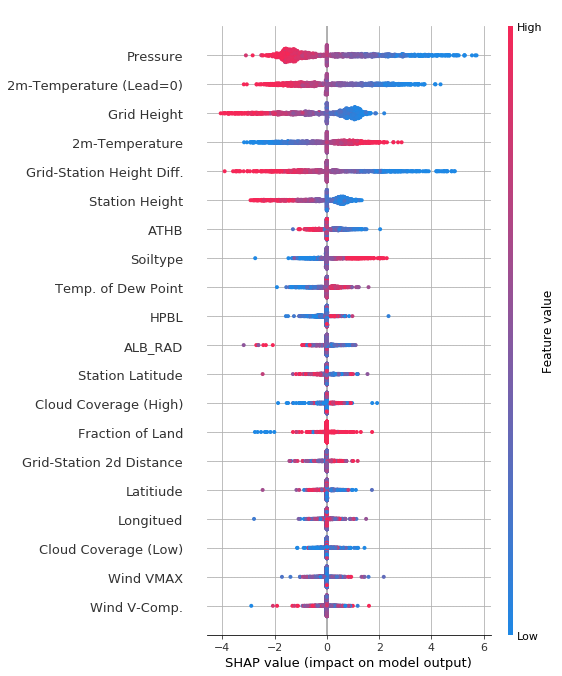

In [132]:
shap.summary_plot(shap_values_july_night[0], shap_test_data, plot_type=plot_type)

### Prepare data summer/afternoon

In [133]:
# fix seed to randomly sample 1000 samples from ~1M train points
seed = 17257
# select points in january and july from training set to train explanation model
july_afternoon_train_data_set = train_data[train_data['Init'].str.contains('..07..15')]
july_afternoon_test_data_set = test_data[test_data['Init'].str.contains('..07..15')]

In [134]:
#explanation_training_set = jan_train_data_set.sample(n=100000, random_state=seed)
explanation_training_set = july_afternoon_train_data_set
explanation_training_data = explanation_training_set.iloc[:,2:-2]
# select randomly test points from test set to calculate SHAP values
shap_test_set = july_afternoon_test_data_set
shap_test_data = shap_test_set.iloc[:,2:-2]

In [135]:
start = time()
dense_train_data = shap.kmeans(explanation_training_data, 200)
print("Run Time for KMeans: %ss" % str(time() - start))

Run Time for KMeans: 6.48830771446228s


In [136]:
explainer = shap.KernelExplainer(f, dense_train_data)

Using 200 background data samples could cause slower run times. Consider using shap.kmeans(data, K) to summarize the background as K weighted samples.


FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


In [137]:
shap_values_july_afternoon = explainer.shap_values(shap_test_data, nsamples=150)

  0%|          | 0/1293 [00:00<?, ?it/s]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


  0%|          | 1/1293 [00:01<24:21,  1.13s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  0%|          | 2/1293 [00:02<24:45,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  0%|          | 3/1293 [00:03<24:33,  1.14s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  0%|          | 4/1293 [00:04<24:30,  1.14s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  0%|          | 5/1293 [00:05<24:31,  1.14s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  0%|          | 6/1293 [00:06<24:33,  1.14s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 7/1293 [00:08<24:30,  1.14s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 8/1293 [00:09<24:30,  1.14s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 9/1293 [00:10<24:28,  1.14s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 10/1293 [00:11<24:27,  1.14s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 11/1293 [00:12<24:26,  1.14s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 12/1293 [00:13<24:24,  1.14s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 13/1293 [00:14<24:22,  1.14s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 14/1293 [00:15<24:20,  1.14s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 15/1293 [00:17<24:19,  1.14s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|          | 16/1293 [00:18<24:18,  1.14s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|▏         | 17/1293 [00:19<24:17,  1.14s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|▏         | 18/1293 [00:20<24:16,  1.14s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  1%|▏         | 19/1293 [00:21<24:15,  1.14s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 20/1293 [00:22<24:14,  1.14s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 21/1293 [00:23<24:12,  1.14s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 22/1293 [00:25<24:12,  1.14s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 23/1293 [00:26<24:11,  1.14s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 24/1293 [00:27<24:11,  1.14s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 25/1293 [00:28<24:10,  1.14s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 26/1293 [00:29<24:09,  1.14s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 27/1293 [00:30<24:07,  1.14s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 28/1293 [00:32<24:06,  1.14s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 29/1293 [00:33<24:05,  1.14s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 30/1293 [00:34<24:04,  1.14s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 31/1293 [00:35<24:03,  1.14s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  2%|▏         | 32/1293 [00:36<24:02,  1.14s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 33/1293 [00:37<24:02,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 34/1293 [00:38<24:03,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 35/1293 [00:40<24:03,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 36/1293 [00:41<24:03,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 37/1293 [00:42<24:01,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 38/1293 [00:43<24:02,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 39/1293 [00:44<24:00,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 40/1293 [00:45<23:59,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 41/1293 [00:47<23:58,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 42/1293 [00:48<23:57,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 43/1293 [00:49<23:56,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 44/1293 [00:50<23:55,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  3%|▎         | 45/1293 [00:51<23:54,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▎         | 46/1293 [00:52<23:53,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▎         | 47/1293 [00:54<23:52,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▎         | 48/1293 [00:55<23:51,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 49/1293 [00:56<23:49,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 50/1293 [00:57<23:49,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 51/1293 [00:58<23:49,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 52/1293 [00:59<23:48,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 53/1293 [01:01<23:48,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 54/1293 [01:02<23:47,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 55/1293 [01:03<23:45,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 56/1293 [01:04<23:44,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 57/1293 [01:05<23:43,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  4%|▍         | 58/1293 [01:06<23:41,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▍         | 59/1293 [01:07<23:40,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▍         | 60/1293 [01:09<23:38,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▍         | 61/1293 [01:10<23:37,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▍         | 62/1293 [01:11<23:35,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▍         | 63/1293 [01:12<23:34,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▍         | 64/1293 [01:13<23:33,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▌         | 65/1293 [01:14<23:32,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▌         | 66/1293 [01:15<23:31,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▌         | 67/1293 [01:17<23:29,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▌         | 68/1293 [01:18<23:28,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▌         | 69/1293 [01:19<23:27,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▌         | 70/1293 [01:20<23:26,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  5%|▌         | 71/1293 [01:21<23:24,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 72/1293 [01:22<23:23,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 73/1293 [01:23<23:22,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 74/1293 [01:25<23:20,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 75/1293 [01:26<23:19,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 76/1293 [01:27<23:18,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 77/1293 [01:28<23:16,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 78/1293 [01:29<23:15,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 79/1293 [01:30<23:14,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▌         | 80/1293 [01:31<23:12,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▋         | 81/1293 [01:33<23:11,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▋         | 82/1293 [01:34<23:10,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▋         | 83/1293 [01:35<23:09,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  6%|▋         | 84/1293 [01:36<23:08,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 85/1293 [01:37<23:07,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 86/1293 [01:38<23:05,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 87/1293 [01:39<23:04,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 88/1293 [01:41<23:03,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 89/1293 [01:42<23:02,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 90/1293 [01:43<23:01,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 91/1293 [01:44<23:00,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 92/1293 [01:45<22:58,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 93/1293 [01:46<22:57,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 94/1293 [01:47<22:56,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 95/1293 [01:49<22:55,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  7%|▋         | 96/1293 [01:50<22:53,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 97/1293 [01:51<22:52,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 98/1293 [01:52<22:51,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 99/1293 [01:53<22:50,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 100/1293 [01:54<22:49,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 101/1293 [01:55<22:47,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 102/1293 [01:57<22:46,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 103/1293 [01:58<22:45,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 104/1293 [01:59<22:44,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 105/1293 [02:00<22:43,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 106/1293 [02:01<22:42,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 107/1293 [02:02<22:40,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 108/1293 [02:03<22:39,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  8%|▊         | 109/1293 [02:05<22:38,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▊         | 110/1293 [02:06<22:37,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▊         | 111/1293 [02:07<22:35,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▊         | 112/1293 [02:08<22:34,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▊         | 113/1293 [02:09<22:33,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 114/1293 [02:10<22:32,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 115/1293 [02:11<22:31,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 116/1293 [02:13<22:30,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 117/1293 [02:14<22:29,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 118/1293 [02:15<22:27,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 119/1293 [02:16<22:26,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 120/1293 [02:17<22:25,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 121/1293 [02:18<22:24,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

  9%|▉         | 122/1293 [02:19<22:23,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|▉         | 123/1293 [02:21<22:22,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|▉         | 124/1293 [02:22<22:21,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|▉         | 125/1293 [02:23<22:20,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|▉         | 126/1293 [02:24<22:18,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|▉         | 127/1293 [02:25<22:17,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|▉         | 128/1293 [02:26<22:16,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|▉         | 129/1293 [02:28<22:15,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|█         | 130/1293 [02:29<22:14,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|█         | 131/1293 [02:30<22:13,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|█         | 132/1293 [02:31<22:12,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|█         | 133/1293 [02:32<22:11,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|█         | 134/1293 [02:33<22:10,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 10%|█         | 135/1293 [02:35<22:09,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 136/1293 [02:36<22:08,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 137/1293 [02:37<22:07,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 138/1293 [02:38<22:06,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 139/1293 [02:39<22:05,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 140/1293 [02:40<22:04,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 141/1293 [02:41<22:02,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 142/1293 [02:43<22:02,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 143/1293 [02:44<22:01,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 144/1293 [02:45<22:00,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█         | 145/1293 [02:46<21:59,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█▏        | 146/1293 [02:47<21:58,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█▏        | 147/1293 [02:48<21:57,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 11%|█▏        | 148/1293 [02:50<21:55,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 149/1293 [02:51<21:54,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 150/1293 [02:52<21:53,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 151/1293 [02:53<21:52,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 152/1293 [02:54<21:51,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 153/1293 [02:55<21:50,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 154/1293 [02:56<21:49,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 155/1293 [02:58<21:47,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 156/1293 [02:59<21:46,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 157/1293 [03:00<21:46,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 158/1293 [03:01<21:44,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 159/1293 [03:02<21:43,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 160/1293 [03:03<21:42,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 12%|█▏        | 161/1293 [03:05<21:41,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 162/1293 [03:06<21:40,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 163/1293 [03:07<21:38,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 164/1293 [03:08<21:37,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 165/1293 [03:09<21:36,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 166/1293 [03:10<21:35,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 167/1293 [03:12<21:34,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 168/1293 [03:13<21:33,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 169/1293 [03:14<21:32,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 170/1293 [03:15<21:31,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 171/1293 [03:16<21:30,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 172/1293 [03:17<21:29,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 173/1293 [03:19<21:28,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 13%|█▎        | 174/1293 [03:20<21:27,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▎        | 175/1293 [03:21<21:26,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▎        | 176/1293 [03:22<21:25,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▎        | 177/1293 [03:23<21:24,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 178/1293 [03:24<21:23,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 179/1293 [03:26<21:22,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 180/1293 [03:27<21:21,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 181/1293 [03:28<21:20,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 182/1293 [03:29<21:19,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 183/1293 [03:30<21:19,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 184/1293 [03:32<21:18,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 185/1293 [03:33<21:16,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 186/1293 [03:34<21:15,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 14%|█▍        | 187/1293 [03:35<21:15,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▍        | 188/1293 [03:36<21:14,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▍        | 189/1293 [03:37<21:13,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▍        | 190/1293 [03:39<21:12,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▍        | 191/1293 [03:40<21:11,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▍        | 192/1293 [03:41<21:10,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▍        | 193/1293 [03:42<21:09,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▌        | 194/1293 [03:43<21:08,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▌        | 195/1293 [03:45<21:07,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▌        | 196/1293 [03:46<21:06,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▌        | 197/1293 [03:47<21:05,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▌        | 198/1293 [03:48<21:04,  1.15s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▌        | 199/1293 [03:49<21:03,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 15%|█▌        | 200/1293 [03:51<21:02,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 201/1293 [03:52<21:01,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 202/1293 [03:53<21:00,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 203/1293 [03:54<20:59,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 204/1293 [03:55<20:58,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 205/1293 [03:57<20:57,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 206/1293 [03:58<20:56,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 207/1293 [03:59<20:55,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 208/1293 [04:00<20:54,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 209/1293 [04:01<20:53,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▌        | 210/1293 [04:02<20:52,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▋        | 211/1293 [04:04<20:51,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▋        | 212/1293 [04:05<20:50,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 16%|█▋        | 213/1293 [04:06<20:49,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 214/1293 [04:07<20:48,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 215/1293 [04:08<20:47,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 216/1293 [04:09<20:46,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 217/1293 [04:11<20:45,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 218/1293 [04:12<20:43,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 219/1293 [04:13<20:42,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 220/1293 [04:14<20:41,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 221/1293 [04:15<20:40,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 222/1293 [04:16<20:38,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 223/1293 [04:17<20:37,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 224/1293 [04:19<20:36,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 225/1293 [04:20<20:35,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 17%|█▋        | 226/1293 [04:21<20:33,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 227/1293 [04:22<20:32,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 228/1293 [04:23<20:31,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 229/1293 [04:24<20:30,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 230/1293 [04:26<20:29,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 231/1293 [04:27<20:28,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 232/1293 [04:28<20:27,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 233/1293 [04:29<20:26,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 234/1293 [04:30<20:25,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 235/1293 [04:31<20:23,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 236/1293 [04:32<20:22,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 237/1293 [04:34<20:21,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 238/1293 [04:35<20:20,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 18%|█▊        | 239/1293 [04:36<20:19,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▊        | 240/1293 [04:37<20:18,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▊        | 241/1293 [04:38<20:17,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▊        | 242/1293 [04:40<20:16,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 243/1293 [04:41<20:15,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 244/1293 [04:42<20:14,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 245/1293 [04:43<20:13,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 246/1293 [04:44<20:11,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 247/1293 [04:45<20:10,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 248/1293 [04:46<20:09,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 249/1293 [04:48<20:08,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 250/1293 [04:49<20:07,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 251/1293 [04:50<20:06,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 19%|█▉        | 252/1293 [04:51<20:04,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|█▉        | 253/1293 [04:52<20:03,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|█▉        | 254/1293 [04:54<20:02,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|█▉        | 255/1293 [04:55<20:01,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|█▉        | 256/1293 [04:56<20:00,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|█▉        | 257/1293 [04:57<19:59,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|█▉        | 258/1293 [04:58<19:58,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|██        | 259/1293 [04:59<19:57,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|██        | 260/1293 [05:01<19:56,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|██        | 261/1293 [05:02<19:55,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|██        | 262/1293 [05:03<19:53,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|██        | 263/1293 [05:04<19:52,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|██        | 264/1293 [05:05<19:51,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 20%|██        | 265/1293 [05:06<19:50,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 266/1293 [05:08<19:49,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 267/1293 [05:09<19:48,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 268/1293 [05:10<19:47,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 269/1293 [05:11<19:46,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 270/1293 [05:12<19:44,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 271/1293 [05:13<19:43,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 272/1293 [05:15<19:42,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 273/1293 [05:16<19:41,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██        | 274/1293 [05:17<19:40,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██▏       | 275/1293 [05:18<19:39,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██▏       | 276/1293 [05:19<19:38,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 21%|██▏       | 277/1293 [05:20<19:36,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 278/1293 [05:22<19:35,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 279/1293 [05:23<19:34,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 280/1293 [05:24<19:33,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 281/1293 [05:25<19:32,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 282/1293 [05:26<19:31,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 283/1293 [05:27<19:30,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 284/1293 [05:29<19:29,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 285/1293 [05:30<19:28,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 286/1293 [05:31<19:26,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 287/1293 [05:32<19:25,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 288/1293 [05:33<19:24,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 289/1293 [05:34<19:23,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 22%|██▏       | 290/1293 [05:36<19:22,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 291/1293 [05:37<19:21,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 292/1293 [05:38<19:20,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 293/1293 [05:39<19:19,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 294/1293 [05:40<19:18,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 295/1293 [05:42<19:17,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 296/1293 [05:43<19:15,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 297/1293 [05:44<19:14,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 298/1293 [05:45<19:13,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 299/1293 [05:46<19:12,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 300/1293 [05:47<19:11,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 301/1293 [05:48<19:10,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 302/1293 [05:50<19:08,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 23%|██▎       | 303/1293 [05:51<19:07,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▎       | 304/1293 [05:52<19:06,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▎       | 305/1293 [05:53<19:05,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▎       | 306/1293 [05:54<19:04,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▎       | 307/1293 [05:56<19:03,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 308/1293 [05:57<19:02,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 309/1293 [05:58<19:01,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 310/1293 [05:59<19:00,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 311/1293 [06:00<18:58,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 312/1293 [06:01<18:57,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 313/1293 [06:03<18:56,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 314/1293 [06:04<18:55,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 315/1293 [06:05<18:54,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 24%|██▍       | 316/1293 [06:06<18:53,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▍       | 317/1293 [06:07<18:52,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▍       | 318/1293 [06:08<18:51,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▍       | 319/1293 [06:10<18:50,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▍       | 320/1293 [06:11<18:49,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▍       | 321/1293 [06:12<18:47,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▍       | 322/1293 [06:13<18:46,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▍       | 323/1293 [06:14<18:45,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▌       | 324/1293 [06:15<18:44,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▌       | 325/1293 [06:17<18:43,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▌       | 326/1293 [06:18<18:42,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▌       | 327/1293 [06:19<18:41,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▌       | 328/1293 [06:20<18:40,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 25%|██▌       | 329/1293 [06:21<18:38,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 330/1293 [06:23<18:37,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 331/1293 [06:24<18:36,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 332/1293 [06:25<18:35,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 333/1293 [06:26<18:33,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 334/1293 [06:27<18:32,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 335/1293 [06:28<18:31,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 336/1293 [06:29<18:30,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 337/1293 [06:31<18:29,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 338/1293 [06:32<18:28,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▌       | 339/1293 [06:33<18:26,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▋       | 340/1293 [06:34<18:25,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▋       | 341/1293 [06:35<18:24,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 26%|██▋       | 342/1293 [06:36<18:23,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 343/1293 [06:37<18:21,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 344/1293 [06:38<18:20,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 345/1293 [06:40<18:19,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 346/1293 [06:41<18:18,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 347/1293 [06:42<18:17,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 348/1293 [06:43<18:15,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 349/1293 [06:44<18:14,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 350/1293 [06:45<18:13,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 351/1293 [06:47<18:12,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 352/1293 [06:48<18:11,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 353/1293 [06:49<18:10,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 354/1293 [06:50<18:08,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 27%|██▋       | 355/1293 [06:51<18:07,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 356/1293 [06:52<18:06,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 357/1293 [06:53<18:05,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 358/1293 [06:55<18:04,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 359/1293 [06:56<18:02,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 360/1293 [06:57<18:01,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 361/1293 [06:58<18:00,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 362/1293 [06:59<17:59,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 363/1293 [07:02<18:01,  1.16s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 364/1293 [07:04<18:02,  1.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 365/1293 [07:06<18:04,  1.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 366/1293 [07:08<18:06,  1.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 367/1293 [07:11<18:07,  1.17s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 28%|██▊       | 368/1293 [07:13<18:09,  1.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▊       | 369/1293 [07:15<18:11,  1.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▊       | 370/1293 [07:17<18:12,  1.18s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▊       | 371/1293 [07:20<18:14,  1.19s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 372/1293 [07:22<18:15,  1.19s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 373/1293 [07:24<18:16,  1.19s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 374/1293 [07:26<18:18,  1.20s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 375/1293 [07:29<18:20,  1.20s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 376/1293 [07:31<18:21,  1.20s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 377/1293 [07:33<18:22,  1.20s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 378/1293 [07:36<18:24,  1.21s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 379/1293 [07:38<18:25,  1.21s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 380/1293 [07:40<18:27,  1.21s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 29%|██▉       | 381/1293 [07:43<18:28,  1.22s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|██▉       | 382/1293 [07:45<18:30,  1.22s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|██▉       | 383/1293 [07:47<18:31,  1.22s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|██▉       | 384/1293 [07:49<18:32,  1.22s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|██▉       | 385/1293 [07:52<18:33,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|██▉       | 386/1293 [07:54<18:35,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|██▉       | 387/1293 [07:56<18:36,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|███       | 388/1293 [07:59<18:37,  1.23s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|███       | 389/1293 [08:01<18:38,  1.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|███       | 390/1293 [08:03<18:40,  1.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|███       | 391/1293 [08:05<18:41,  1.24s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|███       | 392/1293 [08:08<18:42,  1.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 30%|███       | 393/1293 [08:10<18:43,  1.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 30%|███       | 394/1293 [08:12<18:44,  1.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 395/1293 [08:15<18:45,  1.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 396/1293 [08:16<18:45,  1.25s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 397/1293 [08:19<18:46,  1.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 398/1293 [08:21<18:48,  1.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 399/1293 [08:23<18:49,  1.26s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 400/1293 [08:26<18:50,  1.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 401/1293 [08:28<18:51,  1.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 402/1293 [08:30<18:52,  1.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 403/1293 [08:33<18:53,  1.27s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███       | 404/1293 [08:35<18:54,  1.28s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███▏      | 405/1293 [08:37<18:54,  1.28s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███▏      | 406/1293 [08:39<18:55,  1.28s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 31%|███▏      | 407/1293 [08:42<18:56,  1.28s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 408/1293 [08:44<18:57,  1.29s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 409/1293 [08:46<18:58,  1.29s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 410/1293 [08:49<18:59,  1.29s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 411/1293 [08:50<18:59,  1.29s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 412/1293 [08:53<19:00,  1.29s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 413/1293 [08:55<19:00,  1.30s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 414/1293 [08:57<19:02,  1.30s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 415/1293 [09:00<19:02,  1.30s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 416/1293 [09:02<19:03,  1.30s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 417/1293 [09:04<19:04,  1.31s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 418/1293 [09:06<19:04,  1.31s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 419/1293 [09:08<19:04,  1.31s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 32%|███▏      | 420/1293 [09:11<19:05,  1.31s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 421/1293 [09:13<19:06,  1.31s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 422/1293 [09:15<19:07,  1.32s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 423/1293 [09:17<19:07,  1.32s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 424/1293 [09:20<19:08,  1.32s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 425/1293 [09:22<19:08,  1.32s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 426/1293 [09:24<19:09,  1.33s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 427/1293 [09:26<19:09,  1.33s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 428/1293 [09:29<19:10,  1.33s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 33%|███▎      | 429/1293 [09:31<19:10,  1.33s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 430/1293 [09:32<19:09,  1.33s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 431/1293 [09:35<19:10,  1.33s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 432/1293 [09:37<19:11,  1.34s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 33%|███▎      | 433/1293 [09:39<19:11,  1.34s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▎      | 434/1293 [09:42<19:12,  1.34s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▎      | 435/1293 [09:44<19:12,  1.34s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▎      | 436/1293 [09:46<19:13,  1.35s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 437/1293 [09:48<19:13,  1.35s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 438/1293 [09:51<19:14,  1.35s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 439/1293 [09:53<19:14,  1.35s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 440/1293 [09:55<19:14,  1.35s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 441/1293 [09:58<19:15,  1.36s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 442/1293 [10:00<19:15,  1.36s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 443/1293 [10:02<19:16,  1.36s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 444/1293 [10:05<19:16,  1.36s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 445/1293 [10:07<19:17,  1.36s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 34%|███▍      | 446/1293 [10:09<19:18,  1.37s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▍      | 447/1293 [10:12<19:18,  1.37s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▍      | 448/1293 [10:14<19:19,  1.37s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▍      | 449/1293 [10:16<19:19,  1.37s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▍      | 450/1293 [10:18<19:19,  1.38s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▍      | 451/1293 [10:21<19:19,  1.38s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▍      | 452/1293 [10:23<19:19,  1.38s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▌      | 453/1293 [10:25<19:19,  1.38s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▌      | 454/1293 [10:27<19:20,  1.38s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▌      | 455/1293 [10:30<19:20,  1.38s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▌      | 456/1293 [10:31<19:20,  1.39s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▌      | 457/1293 [10:34<19:20,  1.39s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▌      | 458/1293 [10:36<19:20,  1.39s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 35%|███▌      | 459/1293 [10:38<19:20,  1.39s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 460/1293 [10:40<19:20,  1.39s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 461/1293 [10:43<19:20,  1.40s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 462/1293 [10:45<19:21,  1.40s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 463/1293 [10:47<19:21,  1.40s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 464/1293 [10:50<19:21,  1.40s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 36%|███▌      | 465/1293 [10:52<19:21,  1.40s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 466/1293 [10:54<19:21,  1.40s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 467/1293 [10:56<19:21,  1.41s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▌      | 468/1293 [10:59<19:21,  1.41s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▋      | 469/1293 [11:01<19:21,  1.41s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 36%|███▋      | 470/1293 [11:03<19:21,  1.41s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 36%|███▋      | 471/1293 [11:05<19:21,  1.41s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 472/1293 [11:08<19:21,  1.42s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 473/1293 [11:10<19:21,  1.42s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 474/1293 [11:12<19:22,  1.42s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 475/1293 [11:14<19:22,  1.42s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 476/1293 [11:17<19:22,  1.42s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 477/1293 [11:19<19:22,  1.42s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 478/1293 [11:21<19:22,  1.43s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 37%|███▋      | 479/1293 [11:23<19:22,  1.43s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 480/1293 [11:26<19:22,  1.43s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 481/1293 [11:28<19:22,  1.43s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 482/1293 [11:30<19:22,  1.43s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 483/1293 [11:33<19:22,  1.43s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 37%|███▋      | 484/1293 [11:35<19:22,  1.44s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 485/1293 [11:37<19:22,  1.44s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 486/1293 [11:39<19:22,  1.44s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 487/1293 [11:42<19:22,  1.44s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 488/1293 [11:44<19:21,  1.44s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 489/1293 [11:46<19:21,  1.44s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 490/1293 [11:48<19:21,  1.45s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 491/1293 [11:51<19:21,  1.45s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 492/1293 [11:53<19:21,  1.45s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 493/1293 [11:55<19:21,  1.45s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 494/1293 [11:57<19:21,  1.45s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 495/1293 [12:00<19:20,  1.45s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 496/1293 [12:02<19:20,  1.46s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 38%|███▊      | 497/1293 [12:04<19:20,  1.46s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▊      | 498/1293 [12:07<19:20,  1.46s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▊      | 499/1293 [12:09<19:20,  1.46s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▊      | 500/1293 [12:11<19:19,  1.46s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▊      | 501/1293 [12:13<19:19,  1.46s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 502/1293 [12:15<19:18,  1.46s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 503/1293 [12:17<19:18,  1.47s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 504/1293 [12:19<19:18,  1.47s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 505/1293 [12:22<19:18,  1.47s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 506/1293 [12:24<19:17,  1.47s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 507/1293 [12:26<19:17,  1.47s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 39%|███▉      | 508/1293 [12:28<19:16,  1.47s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 509/1293 [12:30<19:16,  1.48s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 39%|███▉      | 510/1293 [12:33<19:16,  1.48s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|███▉      | 511/1293 [12:34<19:15,  1.48s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|███▉      | 512/1293 [12:37<19:15,  1.48s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|███▉      | 513/1293 [12:39<19:15,  1.48s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 40%|███▉      | 514/1293 [12:41<19:14,  1.48s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|███▉      | 515/1293 [12:43<19:14,  1.48s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|███▉      | 516/1293 [12:46<19:13,  1.49s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|███▉      | 517/1293 [12:48<19:13,  1.49s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|████      | 518/1293 [12:50<19:13,  1.49s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|████      | 519/1293 [12:53<19:12,  1.49s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|████      | 520/1293 [12:55<19:12,  1.49s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|████      | 521/1293 [12:57<19:12,  1.49s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|████      | 522/1293 [12:59<19:11,  1.49s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 40%|████      | 523/1293 [13:01<19:10,  1.49s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 524/1293 [13:04<19:10,  1.50s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 525/1293 [13:06<19:10,  1.50s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 526/1293 [13:08<19:09,  1.50s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 527/1293 [13:10<19:09,  1.50s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 528/1293 [13:12<19:08,  1.50s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 529/1293 [13:15<19:08,  1.50s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 530/1293 [13:17<19:08,  1.50s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 531/1293 [13:19<19:07,  1.51s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 532/1293 [13:22<19:07,  1.51s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████      | 533/1293 [13:24<19:07,  1.51s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████▏     | 534/1293 [13:26<19:06,  1.51s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████▏     | 535/1293 [13:29<19:06,  1.51s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 41%|████▏     | 536/1293 [13:31<19:06,  1.51s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 537/1293 [13:33<19:05,  1.52s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 538/1293 [13:36<19:05,  1.52s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 539/1293 [13:38<19:04,  1.52s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 540/1293 [13:40<19:04,  1.52s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 541/1293 [13:42<19:03,  1.52s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 542/1293 [13:45<19:03,  1.52s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 543/1293 [13:47<19:02,  1.52s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 544/1293 [13:49<19:02,  1.53s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 545/1293 [13:52<19:02,  1.53s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 546/1293 [13:54<19:01,  1.53s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 547/1293 [13:56<19:01,  1.53s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 548/1293 [13:59<19:00,  1.53s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 42%|████▏     | 549/1293 [14:01<19:00,  1.53s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 550/1293 [14:03<18:59,  1.53s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 551/1293 [14:06<18:59,  1.54s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 552/1293 [14:08<18:58,  1.54s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 553/1293 [14:10<18:58,  1.54s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 43%|████▎     | 554/1293 [14:12<18:56,  1.54s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 555/1293 [14:14<18:56,  1.54s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 556/1293 [14:16<18:55,  1.54s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 557/1293 [14:18<18:54,  1.54s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 558/1293 [14:20<18:53,  1.54s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 559/1293 [14:23<18:53,  1.54s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 560/1293 [14:25<18:52,  1.55s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 561/1293 [14:27<18:52,  1.55s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 43%|████▎     | 562/1293 [14:29<18:51,  1.55s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▎     | 563/1293 [14:32<18:50,  1.55s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▎     | 564/1293 [14:34<18:50,  1.55s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▎     | 565/1293 [14:36<18:49,  1.55s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 566/1293 [14:39<18:49,  1.55s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 567/1293 [14:41<18:48,  1.55s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 568/1293 [14:43<18:47,  1.56s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 569/1293 [14:45<18:46,  1.56s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 570/1293 [14:48<18:46,  1.56s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 571/1293 [14:50<18:45,  1.56s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 572/1293 [14:52<18:45,  1.56s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 573/1293 [14:55<18:44,  1.56s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 574/1293 [14:57<18:43,  1.56s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 44%|████▍     | 575/1293 [14:59<18:43,  1.56s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▍     | 576/1293 [15:01<18:42,  1.57s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▍     | 577/1293 [15:04<18:41,  1.57s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▍     | 578/1293 [15:06<18:41,  1.57s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▍     | 579/1293 [15:08<18:40,  1.57s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▍     | 580/1293 [15:10<18:39,  1.57s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▍     | 581/1293 [15:13<18:39,  1.57s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▌     | 582/1293 [15:15<18:38,  1.57s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▌     | 583/1293 [15:17<18:37,  1.57s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▌     | 584/1293 [15:20<18:37,  1.58s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▌     | 585/1293 [15:22<18:36,  1.58s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▌     | 586/1293 [15:24<18:35,  1.58s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▌     | 587/1293 [15:27<18:35,  1.58s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 45%|████▌     | 588/1293 [15:29<18:34,  1.58s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 589/1293 [15:31<18:33,  1.58s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 590/1293 [15:33<18:32,  1.58s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 591/1293 [15:36<18:32,  1.58s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 592/1293 [15:38<18:31,  1.59s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 593/1293 [15:40<18:30,  1.59s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 594/1293 [15:43<18:29,  1.59s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 595/1293 [15:45<18:28,  1.59s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 596/1293 [15:47<18:28,  1.59s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 597/1293 [15:49<18:27,  1.59s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▌     | 598/1293 [15:52<18:26,  1.59s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▋     | 599/1293 [15:54<18:26,  1.59s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▋     | 600/1293 [15:56<18:25,  1.59s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 46%|████▋     | 601/1293 [15:59<18:24,  1.60s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 47%|████▋     | 602/1293 [16:01<18:23,  1.60s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 603/1293 [16:03<18:22,  1.60s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 604/1293 [16:05<18:21,  1.60s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 605/1293 [16:07<18:20,  1.60s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 606/1293 [16:10<18:19,  1.60s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 607/1293 [16:12<18:19,  1.60s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 608/1293 [16:14<18:18,  1.60s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 609/1293 [16:16<18:17,  1.60s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 610/1293 [16:19<18:16,  1.61s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 611/1293 [16:21<18:15,  1.61s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 612/1293 [16:23<18:14,  1.61s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 613/1293 [16:26<18:13,  1.61s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 47%|████▋     | 614/1293 [16:28<18:12,  1.61s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 615/1293 [16:30<18:11,  1.61s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 616/1293 [16:32<18:11,  1.61s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 617/1293 [16:35<18:10,  1.61s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 618/1293 [16:37<18:09,  1.61s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 619/1293 [16:39<18:08,  1.62s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 620/1293 [16:42<18:07,  1.62s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 621/1293 [16:44<18:06,  1.62s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 622/1293 [16:46<18:05,  1.62s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 623/1293 [16:49<18:05,  1.62s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 624/1293 [16:51<18:04,  1.62s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 625/1293 [16:53<18:03,  1.62s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 626/1293 [16:55<18:02,  1.62s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 48%|████▊     | 627/1293 [16:58<18:01,  1.62s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▊     | 628/1293 [17:00<18:00,  1.62s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▊     | 629/1293 [17:02<17:59,  1.63s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▊     | 630/1293 [17:04<17:58,  1.63s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 631/1293 [17:07<17:57,  1.63s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 632/1293 [17:09<17:56,  1.63s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 633/1293 [17:11<17:55,  1.63s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 634/1293 [17:14<17:55,  1.63s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 635/1293 [17:16<17:54,  1.63s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 636/1293 [17:18<17:53,  1.63s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 637/1293 [17:21<17:52,  1.63s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 638/1293 [17:23<17:51,  1.64s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 639/1293 [17:25<17:50,  1.64s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 49%|████▉     | 640/1293 [17:27<17:49,  1.64s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|████▉     | 641/1293 [17:30<17:48,  1.64s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|████▉     | 642/1293 [17:32<17:47,  1.64s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|████▉     | 643/1293 [17:34<17:46,  1.64s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|████▉     | 644/1293 [17:37<17:45,  1.64s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|████▉     | 645/1293 [17:39<17:44,  1.64s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|████▉     | 646/1293 [17:41<17:43,  1.64s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|█████     | 647/1293 [17:43<17:42,  1.64s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|█████     | 648/1293 [17:46<17:41,  1.65s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|█████     | 649/1293 [17:48<17:40,  1.65s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|█████     | 650/1293 [17:50<17:39,  1.65s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|█████     | 651/1293 [17:53<17:38,  1.65s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 50%|█████     | 652/1293 [17:55<17:37,  1.65s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 51%|█████     | 653/1293 [17:57<17:36,  1.65s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 654/1293 [17:59<17:34,  1.65s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 655/1293 [18:01<17:33,  1.65s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 656/1293 [18:04<17:32,  1.65s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 657/1293 [18:06<17:31,  1.65s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 51%|█████     | 658/1293 [18:08<17:30,  1.65s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 659/1293 [18:10<17:29,  1.66s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 660/1293 [18:13<17:28,  1.66s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 661/1293 [18:15<17:27,  1.66s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████     | 662/1293 [18:17<17:26,  1.66s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████▏    | 663/1293 [18:19<17:25,  1.66s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████▏    | 664/1293 [18:21<17:23,  1.66s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 51%|█████▏    | 665/1293 [18:24<17:22,  1.66s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 666/1293 [18:26<17:21,  1.66s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 667/1293 [18:28<17:20,  1.66s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 668/1293 [18:31<17:19,  1.66s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 669/1293 [18:33<17:18,  1.66s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 670/1293 [18:35<17:17,  1.67s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 671/1293 [18:38<17:16,  1.67s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 672/1293 [18:40<17:15,  1.67s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 673/1293 [18:42<17:14,  1.67s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 674/1293 [18:44<17:13,  1.67s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 675/1293 [18:47<17:11,  1.67s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 676/1293 [18:49<17:10,  1.67s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 677/1293 [18:51<17:09,  1.67s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 52%|█████▏    | 678/1293 [18:53<17:08,  1.67s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 679/1293 [18:55<17:06,  1.67s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 680/1293 [18:57<17:05,  1.67s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 681/1293 [19:00<17:04,  1.67s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 682/1293 [19:02<17:03,  1.68s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 683/1293 [19:04<17:02,  1.68s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 684/1293 [19:07<17:01,  1.68s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 685/1293 [19:09<17:00,  1.68s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 686/1293 [19:11<16:59,  1.68s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 687/1293 [19:13<16:57,  1.68s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 688/1293 [19:16<16:56,  1.68s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 689/1293 [19:18<16:55,  1.68s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 690/1293 [19:20<16:54,  1.68s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 53%|█████▎    | 691/1293 [19:23<16:53,  1.68s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▎    | 692/1293 [19:25<16:52,  1.68s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▎    | 693/1293 [19:27<16:50,  1.68s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 54%|█████▎    | 694/1293 [19:29<16:49,  1.69s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 695/1293 [19:32<16:48,  1.69s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 696/1293 [19:34<16:47,  1.69s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 697/1293 [19:36<16:45,  1.69s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 698/1293 [19:38<16:44,  1.69s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 699/1293 [19:40<16:43,  1.69s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 700/1293 [19:43<16:42,  1.69s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 701/1293 [19:45<16:41,  1.69s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 702/1293 [19:47<16:39,  1.69s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 703/1293 [19:50<16:38,  1.69s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 54%|█████▍    | 704/1293 [19:52<16:37,  1.69s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▍    | 705/1293 [19:54<16:36,  1.69s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▍    | 706/1293 [19:56<16:34,  1.69s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▍    | 707/1293 [19:58<16:33,  1.70s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▍    | 708/1293 [20:01<16:32,  1.70s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▍    | 709/1293 [20:03<16:30,  1.70s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▍    | 710/1293 [20:05<16:29,  1.70s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▍    | 711/1293 [20:07<16:28,  1.70s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▌    | 712/1293 [20:09<16:27,  1.70s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▌    | 713/1293 [20:12<16:26,  1.70s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▌    | 714/1293 [20:14<16:24,  1.70s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▌    | 715/1293 [20:16<16:23,  1.70s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▌    | 716/1293 [20:19<16:22,  1.70s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 55%|█████▌    | 717/1293 [20:21<16:21,  1.70s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 718/1293 [20:23<16:19,  1.70s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 719/1293 [20:26<16:18,  1.71s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 720/1293 [20:28<16:17,  1.71s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 721/1293 [20:30<16:15,  1.71s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 722/1293 [20:32<16:14,  1.71s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 723/1293 [20:33<16:12,  1.71s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 724/1293 [20:36<16:11,  1.71s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 725/1293 [20:38<16:10,  1.71s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 726/1293 [20:40<16:09,  1.71s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▌    | 727/1293 [20:43<16:07,  1.71s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▋    | 728/1293 [20:45<16:06,  1.71s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▋    | 729/1293 [20:47<16:05,  1.71s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 56%|█████▋    | 730/1293 [20:49<16:04,  1.71s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 731/1293 [20:52<16:02,  1.71s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 732/1293 [20:54<16:01,  1.71s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 733/1293 [20:56<16:00,  1.71s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 734/1293 [20:59<15:58,  1.72s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 735/1293 [21:01<15:57,  1.72s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 736/1293 [21:03<15:56,  1.72s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 737/1293 [21:06<15:55,  1.72s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 738/1293 [21:08<15:53,  1.72s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 739/1293 [21:10<15:52,  1.72s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 740/1293 [21:13<15:51,  1.72s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 741/1293 [21:15<15:50,  1.72s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 742/1293 [21:17<15:48,  1.72s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 57%|█████▋    | 743/1293 [21:20<15:47,  1.72s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 744/1293 [21:22<15:46,  1.72s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 745/1293 [21:24<15:44,  1.72s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 746/1293 [21:26<15:43,  1.73s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 747/1293 [21:29<15:42,  1.73s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 748/1293 [21:31<15:40,  1.73s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 749/1293 [21:33<15:39,  1.73s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 750/1293 [21:35<15:38,  1.73s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 751/1293 [21:38<15:36,  1.73s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 752/1293 [21:40<15:35,  1.73s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 753/1293 [21:42<15:34,  1.73s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 754/1293 [21:45<15:32,  1.73s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 755/1293 [21:47<15:31,  1.73s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 58%|█████▊    | 756/1293 [21:49<15:30,  1.73s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▊    | 757/1293 [21:51<15:28,  1.73s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▊    | 758/1293 [21:54<15:27,  1.73s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▊    | 759/1293 [21:56<15:26,  1.73s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 760/1293 [21:58<15:24,  1.74s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 761/1293 [22:00<15:23,  1.74s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 762/1293 [22:03<15:21,  1.74s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 763/1293 [22:05<15:20,  1.74s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 764/1293 [22:07<15:19,  1.74s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 765/1293 [22:10<15:17,  1.74s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 766/1293 [22:12<15:16,  1.74s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 767/1293 [22:14<15:15,  1.74s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 768/1293 [22:17<15:13,  1.74s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 59%|█████▉    | 769/1293 [22:19<15:12,  1.74s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|█████▉    | 770/1293 [22:21<15:11,  1.74s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|█████▉    | 771/1293 [22:23<15:09,  1.74s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|█████▉    | 772/1293 [22:26<15:08,  1.74s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|█████▉    | 773/1293 [22:28<15:07,  1.74s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|█████▉    | 774/1293 [22:30<15:05,  1.75s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|█████▉    | 775/1293 [22:32<15:03,  1.75s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|██████    | 776/1293 [22:34<15:02,  1.75s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|██████    | 777/1293 [22:36<15:01,  1.75s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|██████    | 778/1293 [22:39<14:59,  1.75s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|██████    | 779/1293 [22:41<14:58,  1.75s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|██████    | 780/1293 [22:43<14:56,  1.75s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|██████    | 781/1293 [22:46<14:55,  1.75s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 60%|██████    | 782/1293 [22:48<14:54,  1.75s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 783/1293 [22:50<14:52,  1.75s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 784/1293 [22:52<14:51,  1.75s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 785/1293 [22:55<14:49,  1.75s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 786/1293 [22:57<14:48,  1.75s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 787/1293 [22:59<14:47,  1.75s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 788/1293 [23:02<14:45,  1.75s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 789/1293 [23:04<14:44,  1.75s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 790/1293 [23:06<14:42,  1.76s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████    | 791/1293 [23:08<14:41,  1.76s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████▏   | 792/1293 [23:11<14:40,  1.76s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████▏   | 793/1293 [23:13<14:38,  1.76s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████▏   | 794/1293 [23:15<14:37,  1.76s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 61%|██████▏   | 795/1293 [23:17<14:35,  1.76s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 796/1293 [23:20<14:34,  1.76s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 797/1293 [23:22<14:32,  1.76s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 798/1293 [23:24<14:31,  1.76s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 799/1293 [23:26<14:29,  1.76s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 800/1293 [23:29<14:28,  1.76s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 801/1293 [23:31<14:26,  1.76s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 802/1293 [23:33<14:25,  1.76s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 803/1293 [23:36<14:24,  1.76s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 804/1293 [23:37<14:22,  1.76s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 805/1293 [23:40<14:20,  1.76s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 806/1293 [23:42<14:19,  1.76s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 807/1293 [23:44<14:17,  1.77s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 62%|██████▏   | 808/1293 [23:46<14:16,  1.77s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 809/1293 [23:49<14:15,  1.77s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 810/1293 [23:51<14:13,  1.77s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 811/1293 [23:53<14:12,  1.77s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 812/1293 [23:56<14:10,  1.77s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 813/1293 [23:58<14:09,  1.77s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 814/1293 [24:00<14:07,  1.77s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 815/1293 [24:02<14:06,  1.77s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 816/1293 [24:04<14:04,  1.77s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 817/1293 [24:07<14:03,  1.77s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 818/1293 [24:09<14:01,  1.77s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 819/1293 [24:11<14:00,  1.77s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 820/1293 [24:13<13:58,  1.77s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 63%|██████▎   | 821/1293 [24:15<13:57,  1.77s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▎   | 822/1293 [24:18<13:55,  1.77s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▎   | 823/1293 [24:20<13:54,  1.77s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▎   | 824/1293 [24:22<13:52,  1.78s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 825/1293 [24:24<13:50,  1.78s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 826/1293 [24:27<13:49,  1.78s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 827/1293 [24:29<13:48,  1.78s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 828/1293 [24:31<13:46,  1.78s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 829/1293 [24:34<13:45,  1.78s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 830/1293 [24:36<13:43,  1.78s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 831/1293 [24:38<13:41,  1.78s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 832/1293 [24:40<13:40,  1.78s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 64%|██████▍   | 833/1293 [24:43<13:39,  1.78s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▍   | 834/1293 [24:45<13:37,  1.78s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▍   | 835/1293 [24:47<13:36,  1.78s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▍   | 836/1293 [24:50<13:34,  1.78s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▍   | 837/1293 [24:52<13:32,  1.78s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▍   | 838/1293 [24:54<13:31,  1.78s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▍   | 839/1293 [24:56<13:29,  1.78s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▍   | 840/1293 [24:59<13:28,  1.78s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▌   | 841/1293 [25:01<13:26,  1.79s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▌   | 842/1293 [25:03<13:25,  1.79s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▌   | 843/1293 [25:05<13:23,  1.79s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▌   | 844/1293 [25:08<13:22,  1.79s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▌   | 845/1293 [25:10<13:20,  1.79s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 65%|██████▌   | 846/1293 [25:12<13:19,  1.79s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 847/1293 [25:14<13:17,  1.79s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 848/1293 [25:17<13:16,  1.79s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 849/1293 [25:19<13:14,  1.79s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 850/1293 [25:21<13:13,  1.79s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 851/1293 [25:24<13:11,  1.79s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 66%|██████▌   | 852/1293 [25:25<13:09,  1.79s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 853/1293 [25:28<13:08,  1.79s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 854/1293 [25:30<13:06,  1.79s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 855/1293 [25:32<13:05,  1.79s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▌   | 856/1293 [25:35<13:03,  1.79s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▋   | 857/1293 [25:37<13:02,  1.79s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▋   | 858/1293 [25:39<13:00,  1.79s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 66%|██████▋   | 859/1293 [25:41<12:59,  1.80s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 860/1293 [25:44<12:57,  1.80s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 861/1293 [25:46<12:55,  1.80s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 862/1293 [25:48<12:54,  1.80s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 863/1293 [25:50<12:52,  1.80s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 864/1293 [25:52<12:50,  1.80s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 865/1293 [25:54<12:49,  1.80s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 866/1293 [25:57<12:47,  1.80s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 867/1293 [25:59<12:46,  1.80s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 868/1293 [26:01<12:44,  1.80s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 869/1293 [26:03<12:42,  1.80s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 870/1293 [26:06<12:41,  1.80s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 871/1293 [26:08<12:39,  1.80s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 67%|██████▋   | 872/1293 [26:10<12:38,  1.80s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 873/1293 [26:12<12:36,  1.80s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 874/1293 [26:15<12:35,  1.80s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 875/1293 [26:17<12:33,  1.80s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 876/1293 [26:19<12:31,  1.80s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 877/1293 [26:21<12:30,  1.80s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 878/1293 [26:24<12:28,  1.80s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 879/1293 [26:26<12:27,  1.80s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 880/1293 [26:28<12:25,  1.81s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 881/1293 [26:31<12:24,  1.81s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 882/1293 [26:33<12:22,  1.81s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 883/1293 [26:35<12:20,  1.81s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 884/1293 [26:37<12:19,  1.81s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 68%|██████▊   | 885/1293 [26:40<12:17,  1.81s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▊   | 886/1293 [26:42<12:16,  1.81s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▊   | 887/1293 [26:45<12:14,  1.81s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▊   | 888/1293 [26:47<12:13,  1.81s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 889/1293 [26:49<12:11,  1.81s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 890/1293 [26:52<12:09,  1.81s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 891/1293 [26:54<12:08,  1.81s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 892/1293 [26:56<12:06,  1.81s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 893/1293 [26:58<12:05,  1.81s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 894/1293 [27:01<12:03,  1.81s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 895/1293 [27:03<12:01,  1.81s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 896/1293 [27:05<12:00,  1.81s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 897/1293 [27:07<11:58,  1.81s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 69%|██████▉   | 898/1293 [27:10<11:57,  1.82s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|██████▉   | 899/1293 [27:12<11:55,  1.82s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|██████▉   | 900/1293 [27:14<11:53,  1.82s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|██████▉   | 901/1293 [27:17<11:52,  1.82s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|██████▉   | 902/1293 [27:19<11:50,  1.82s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|██████▉   | 903/1293 [27:21<11:49,  1.82s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|██████▉   | 904/1293 [27:23<11:47,  1.82s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|██████▉   | 905/1293 [27:25<11:45,  1.82s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|███████   | 906/1293 [27:28<11:43,  1.82s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|███████   | 907/1293 [27:30<11:42,  1.82s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|███████   | 908/1293 [27:32<11:40,  1.82s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|███████   | 909/1293 [27:34<11:39,  1.82s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|███████   | 910/1293 [27:36<11:37,  1.82s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 70%|███████   | 911/1293 [27:39<11:35,  1.82s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 912/1293 [27:41<11:34,  1.82s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 913/1293 [27:43<11:32,  1.82s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 71%|███████   | 914/1293 [27:45<11:30,  1.82s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 915/1293 [27:47<11:28,  1.82s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 916/1293 [27:49<11:27,  1.82s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 917/1293 [27:51<11:25,  1.82s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 918/1293 [27:54<11:23,  1.82s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 919/1293 [27:56<11:22,  1.82s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████   | 920/1293 [27:58<11:20,  1.82s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 71%|███████   | 921/1293 [28:01<11:19,  1.83s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████▏  | 922/1293 [28:03<11:17,  1.83s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████▏  | 923/1293 [28:05<11:15,  1.83s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 71%|███████▏  | 924/1293 [28:07<11:13,  1.83s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 72%|███████▏  | 925/1293 [28:08<11:11,  1.83s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 926/1293 [28:11<11:10,  1.83s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 927/1293 [28:13<11:08,  1.83s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 928/1293 [28:15<11:06,  1.83s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 929/1293 [28:17<11:05,  1.83s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 930/1293 [28:20<11:03,  1.83s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 931/1293 [28:22<11:01,  1.83s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 932/1293 [28:24<11:00,  1.83s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 933/1293 [28:27<10:58,  1.83s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 934/1293 [28:29<10:56,  1.83s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 935/1293 [28:31<10:55,  1.83s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 936/1293 [28:33<10:53,  1.83s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 72%|███████▏  | 937/1293 [28:36<10:52,  1.83s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 938/1293 [28:38<10:50,  1.83s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 939/1293 [28:40<10:48,  1.83s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 940/1293 [28:42<10:46,  1.83s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 941/1293 [28:45<10:45,  1.83s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 942/1293 [28:47<10:43,  1.83s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 943/1293 [28:49<10:41,  1.83s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 944/1293 [28:51<10:40,  1.83s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 945/1293 [28:54<10:38,  1.83s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 946/1293 [28:56<10:36,  1.84s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 947/1293 [28:58<10:35,  1.84s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 948/1293 [29:00<10:33,  1.84s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 949/1293 [29:03<10:31,  1.84s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 73%|███████▎  | 950/1293 [29:05<10:30,  1.84s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▎  | 951/1293 [29:07<10:28,  1.84s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▎  | 952/1293 [29:10<10:26,  1.84s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▎  | 953/1293 [29:11<10:24,  1.84s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 954/1293 [29:14<10:23,  1.84s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 955/1293 [29:16<10:21,  1.84s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 956/1293 [29:18<10:19,  1.84s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 957/1293 [29:21<10:18,  1.84s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 958/1293 [29:23<10:16,  1.84s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 959/1293 [29:25<10:14,  1.84s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 960/1293 [29:27<10:13,  1.84s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 961/1293 [29:30<10:11,  1.84s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 962/1293 [29:32<10:09,  1.84s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 74%|███████▍  | 963/1293 [29:34<10:08,  1.84s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▍  | 964/1293 [29:37<10:06,  1.84s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▍  | 965/1293 [29:39<10:04,  1.84s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▍  | 966/1293 [29:41<10:03,  1.84s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▍  | 967/1293 [29:43<10:01,  1.84s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▍  | 968/1293 [29:45<09:59,  1.84s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▍  | 969/1293 [29:47<09:57,  1.85s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▌  | 970/1293 [29:50<09:56,  1.85s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▌  | 971/1293 [29:52<09:54,  1.85s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▌  | 972/1293 [29:54<09:52,  1.85s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 75%|███████▌  | 973/1293 [29:56<09:50,  1.85s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▌  | 974/1293 [29:58<09:49,  1.85s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▌  | 975/1293 [30:00<09:47,  1.85s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 75%|███████▌  | 976/1293 [30:02<09:45,  1.85s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 977/1293 [30:04<09:43,  1.85s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 978/1293 [30:07<09:42,  1.85s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 979/1293 [30:09<09:40,  1.85s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 980/1293 [30:11<09:38,  1.85s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 981/1293 [30:14<09:36,  1.85s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 982/1293 [30:16<09:35,  1.85s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 983/1293 [30:18<09:33,  1.85s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 984/1293 [30:20<09:31,  1.85s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▌  | 985/1293 [30:23<09:30,  1.85s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▋  | 986/1293 [30:25<09:28,  1.85s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▋  | 987/1293 [30:27<09:26,  1.85s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▋  | 988/1293 [30:29<09:24,  1.85s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 76%|███████▋  | 989/1293 [30:32<09:23,  1.85s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 990/1293 [30:34<09:21,  1.85s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 991/1293 [30:36<09:19,  1.85s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 992/1293 [30:39<09:18,  1.85s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 993/1293 [30:41<09:16,  1.85s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 994/1293 [30:43<09:14,  1.85s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 77%|███████▋  | 995/1293 [30:45<09:12,  1.85s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 996/1293 [30:47<09:11,  1.86s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 997/1293 [30:50<09:09,  1.86s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 77%|███████▋  | 998/1293 [30:52<09:07,  1.86s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 999/1293 [30:54<09:05,  1.86s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 1000/1293 [30:56<09:04,  1.86s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 1001/1293 [30:59<09:02,  1.86s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 77%|███████▋  | 1002/1293 [31:01<09:00,  1.86s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 1003/1293 [31:03<08:58,  1.86s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 1004/1293 [31:06<08:57,  1.86s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 1005/1293 [31:08<08:55,  1.86s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 1006/1293 [31:10<08:53,  1.86s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 1007/1293 [31:12<08:51,  1.86s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 1008/1293 [31:15<08:50,  1.86s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 1009/1293 [31:17<08:48,  1.86s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 1010/1293 [31:19<08:46,  1.86s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 1011/1293 [31:21<08:44,  1.86s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 1012/1293 [31:24<08:43,  1.86s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 1013/1293 [31:26<08:41,  1.86s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 1014/1293 [31:28<08:39,  1.86s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 78%|███████▊  | 1015/1293 [31:30<08:37,  1.86s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▊  | 1016/1293 [31:33<08:36,  1.86s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▊  | 1017/1293 [31:35<08:34,  1.86s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▊  | 1018/1293 [31:37<08:32,  1.86s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 1019/1293 [31:40<08:30,  1.86s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 79%|███████▉  | 1020/1293 [31:42<08:29,  1.86s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 1021/1293 [31:44<08:27,  1.87s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 1022/1293 [31:46<08:25,  1.87s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 1023/1293 [31:49<08:23,  1.87s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 1024/1293 [31:51<08:22,  1.87s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 1025/1293 [31:53<08:20,  1.87s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 1026/1293 [31:55<08:18,  1.87s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 79%|███████▉  | 1027/1293 [31:58<08:16,  1.87s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|███████▉  | 1028/1293 [32:00<08:15,  1.87s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|███████▉  | 1029/1293 [32:02<08:13,  1.87s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|███████▉  | 1030/1293 [32:04<08:11,  1.87s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|███████▉  | 1031/1293 [32:07<08:09,  1.87s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|███████▉  | 1032/1293 [32:09<08:07,  1.87s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|███████▉  | 1033/1293 [32:11<08:06,  1.87s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|███████▉  | 1034/1293 [32:13<08:04,  1.87s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|████████  | 1035/1293 [32:16<08:02,  1.87s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|████████  | 1036/1293 [32:18<08:00,  1.87s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|████████  | 1037/1293 [32:20<07:59,  1.87s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|████████  | 1038/1293 [32:23<07:57,  1.87s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|████████  | 1039/1293 [32:25<07:55,  1.87s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 80%|████████  | 1040/1293 [32:27<07:53,  1.87s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 1041/1293 [32:29<07:51,  1.87s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 1042/1293 [32:32<07:50,  1.87s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 1043/1293 [32:34<07:48,  1.87s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 1044/1293 [32:36<07:46,  1.87s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 1045/1293 [32:38<07:44,  1.87s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 1046/1293 [32:41<07:43,  1.87s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 1047/1293 [32:43<07:41,  1.88s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 1048/1293 [32:45<07:39,  1.88s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 1049/1293 [32:48<07:37,  1.88s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████  | 1050/1293 [32:50<07:35,  1.88s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████▏ | 1051/1293 [32:52<07:34,  1.88s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████▏ | 1052/1293 [32:54<07:32,  1.88s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 81%|████████▏ | 1053/1293 [32:57<07:30,  1.88s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 1054/1293 [32:59<07:28,  1.88s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 1055/1293 [33:02<07:27,  1.88s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 1056/1293 [33:04<07:25,  1.88s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 1057/1293 [33:06<07:23,  1.88s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 1058/1293 [33:09<07:21,  1.88s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 1059/1293 [33:11<07:20,  1.88s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 1060/1293 [33:13<07:18,  1.88s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 1061/1293 [33:15<07:16,  1.88s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 1062/1293 [33:18<07:14,  1.88s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 1063/1293 [33:20<07:12,  1.88s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 1064/1293 [33:22<07:11,  1.88s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 1065/1293 [33:25<07:09,  1.88s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 82%|████████▏ | 1066/1293 [33:27<07:07,  1.88s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 1067/1293 [33:29<07:05,  1.88s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 1068/1293 [33:32<07:03,  1.88s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 1069/1293 [33:34<07:02,  1.88s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 1070/1293 [33:36<07:00,  1.88s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 1071/1293 [33:39<06:58,  1.89s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 1072/1293 [33:41<06:56,  1.89s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 1073/1293 [33:43<06:54,  1.89s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 1074/1293 [33:46<06:53,  1.89s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 1075/1293 [33:48<06:51,  1.89s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 1076/1293 [33:50<06:49,  1.89s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 1077/1293 [33:52<06:47,  1.89s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 1078/1293 [33:55<06:45,  1.89s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 83%|████████▎ | 1079/1293 [33:57<06:44,  1.89s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▎ | 1080/1293 [33:59<06:42,  1.89s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▎ | 1081/1293 [34:02<06:40,  1.89s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▎ | 1082/1293 [34:04<06:38,  1.89s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 1083/1293 [34:06<06:36,  1.89s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 1084/1293 [34:08<06:35,  1.89s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 1085/1293 [34:11<06:33,  1.89s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 1086/1293 [34:13<06:31,  1.89s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 1087/1293 [34:15<06:29,  1.89s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 1088/1293 [34:18<06:27,  1.89s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 1089/1293 [34:20<06:25,  1.89s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 84%|████████▍ | 1090/1293 [34:22<06:24,  1.89s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 1091/1293 [34:24<06:22,  1.89s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 84%|████████▍ | 1092/1293 [34:26<06:20,  1.89s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▍ | 1093/1293 [34:29<06:18,  1.89s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▍ | 1094/1293 [34:31<06:16,  1.89s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▍ | 1095/1293 [34:33<06:14,  1.89s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▍ | 1096/1293 [34:35<06:13,  1.89s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▍ | 1097/1293 [34:38<06:11,  1.89s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▍ | 1098/1293 [34:40<06:09,  1.89s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▍ | 1099/1293 [34:42<06:07,  1.90s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 85%|████████▌ | 1100/1293 [34:44<06:05,  1.90s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▌ | 1101/1293 [34:47<06:03,  1.90s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▌ | 1102/1293 [34:49<06:02,  1.90s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▌ | 1103/1293 [34:51<06:00,  1.90s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▌ | 1104/1293 [34:54<05:58,  1.90s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 85%|████████▌ | 1105/1293 [34:56<05:56,  1.90s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 1106/1293 [34:58<05:54,  1.90s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 1107/1293 [35:00<05:52,  1.90s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 1108/1293 [35:02<05:51,  1.90s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 1109/1293 [35:05<05:49,  1.90s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 1110/1293 [35:07<05:47,  1.90s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 1111/1293 [35:09<05:45,  1.90s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 1112/1293 [35:11<05:43,  1.90s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 1113/1293 [35:14<05:41,  1.90s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 1114/1293 [35:16<05:40,  1.90s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▌ | 1115/1293 [35:18<05:38,  1.90s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▋ | 1116/1293 [35:21<05:36,  1.90s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▋ | 1117/1293 [35:23<05:34,  1.90s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 86%|████████▋ | 1118/1293 [35:25<05:32,  1.90s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 1119/1293 [35:28<05:30,  1.90s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 1120/1293 [35:30<05:29,  1.90s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 1121/1293 [35:32<05:27,  1.90s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 1122/1293 [35:34<05:25,  1.90s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 1123/1293 [35:37<05:23,  1.90s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 1124/1293 [35:39<05:21,  1.90s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 1125/1293 [35:41<05:19,  1.90s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 1126/1293 [35:44<05:18,  1.90s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 1127/1293 [35:46<05:16,  1.90s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 1128/1293 [35:48<05:14,  1.90s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 87%|████████▋ | 1129/1293 [35:50<05:12,  1.90s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 1130/1293 [35:52<05:10,  1.90s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 87%|████████▋ | 1131/1293 [35:54<05:08,  1.90s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 1132/1293 [35:56<05:06,  1.91s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 1133/1293 [35:58<05:04,  1.91s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 1134/1293 [36:01<05:03,  1.91s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 1135/1293 [36:03<05:01,  1.91s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 1136/1293 [36:05<04:59,  1.91s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 1137/1293 [36:07<04:57,  1.91s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 1138/1293 [36:09<04:55,  1.91s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 1139/1293 [36:12<04:53,  1.91s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 1140/1293 [36:14<04:51,  1.91s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 1141/1293 [36:16<04:49,  1.91s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 1142/1293 [36:19<04:48,  1.91s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 1143/1293 [36:21<04:46,  1.91s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 88%|████████▊ | 1144/1293 [36:23<04:44,  1.91s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▊ | 1145/1293 [36:25<04:42,  1.91s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▊ | 1146/1293 [36:28<04:40,  1.91s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▊ | 1147/1293 [36:30<04:38,  1.91s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 1148/1293 [36:32<04:36,  1.91s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 1149/1293 [36:35<04:35,  1.91s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 1150/1293 [36:37<04:33,  1.91s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 1151/1293 [36:39<04:31,  1.91s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 1152/1293 [36:41<04:29,  1.91s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 1153/1293 [36:44<04:27,  1.91s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 1154/1293 [36:46<04:25,  1.91s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 1155/1293 [36:48<04:23,  1.91s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 1156/1293 [36:50<04:21,  1.91s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 89%|████████▉ | 1157/1293 [36:52<04:20,  1.91s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|████████▉ | 1158/1293 [36:55<04:18,  1.91s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|████████▉ | 1159/1293 [36:57<04:16,  1.91s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|████████▉ | 1160/1293 [36:59<04:14,  1.91s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|████████▉ | 1161/1293 [37:02<04:12,  1.91s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 90%|████████▉ | 1162/1293 [37:04<04:10,  1.91s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|████████▉ | 1163/1293 [37:06<04:08,  1.91s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|█████████ | 1164/1293 [37:08<04:07,  1.91s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|█████████ | 1165/1293 [37:11<04:05,  1.92s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|█████████ | 1166/1293 [37:13<04:03,  1.92s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|█████████ | 1167/1293 [37:15<04:01,  1.92s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|█████████ | 1168/1293 [37:17<03:59,  1.92s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|█████████ | 1169/1293 [37:19<03:57,  1.92s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 90%|█████████ | 1170/1293 [37:22<03:55,  1.92s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 1171/1293 [37:24<03:53,  1.92s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 1172/1293 [37:26<03:51,  1.92s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 1173/1293 [37:28<03:50,  1.92s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 1174/1293 [37:31<03:48,  1.92s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 1175/1293 [37:33<03:46,  1.92s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 1176/1293 [37:35<03:44,  1.92s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 1177/1293 [37:37<03:42,  1.92s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 1178/1293 [37:40<03:40,  1.92s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████ | 1179/1293 [37:42<03:38,  1.92s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████▏| 1180/1293 [37:44<03:36,  1.92s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████▏| 1181/1293 [37:46<03:34,  1.92s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████▏| 1182/1293 [37:49<03:33,  1.92s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 91%|█████████▏| 1183/1293 [37:51<03:31,  1.92s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 1184/1293 [37:53<03:29,  1.92s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 1185/1293 [37:55<03:27,  1.92s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 1186/1293 [37:58<03:25,  1.92s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 1187/1293 [38:00<03:23,  1.92s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 1188/1293 [38:02<03:21,  1.92s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 1189/1293 [38:04<03:19,  1.92s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 1190/1293 [38:06<03:17,  1.92s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 1191/1293 [38:09<03:16,  1.92s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 1192/1293 [38:11<03:14,  1.92s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 1193/1293 [38:13<03:12,  1.92s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 1194/1293 [38:16<03:10,  1.92s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 1195/1293 [38:18<03:08,  1.92s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 92%|█████████▏| 1196/1293 [38:20<03:06,  1.92s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 1197/1293 [38:22<03:04,  1.92s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 1198/1293 [38:25<03:02,  1.92s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 1199/1293 [38:27<03:00,  1.92s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 1200/1293 [38:29<02:58,  1.92s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 1201/1293 [38:31<02:57,  1.92s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 1202/1293 [38:34<02:55,  1.93s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 1203/1293 [38:36<02:53,  1.93s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 1204/1293 [38:38<02:51,  1.93s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 1205/1293 [38:41<02:49,  1.93s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 1206/1293 [38:43<02:47,  1.93s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 1207/1293 [38:45<02:45,  1.93s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 93%|█████████▎| 1208/1293 [38:48<02:43,  1.93s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▎| 1209/1293 [38:50<02:41,  1.93s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▎| 1210/1293 [38:52<02:40,  1.93s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▎| 1211/1293 [38:55<02:38,  1.93s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▎| 1212/1293 [38:57<02:36,  1.93s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 1213/1293 [38:59<02:34,  1.93s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 1214/1293 [39:01<02:32,  1.93s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 1215/1293 [39:04<02:30,  1.93s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 1216/1293 [39:06<02:28,  1.93s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 1217/1293 [39:08<02:26,  1.93s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 1218/1293 [39:10<02:24,  1.93s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 1219/1293 [39:13<02:22,  1.93s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 1220/1293 [39:15<02:20,  1.93s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 94%|█████████▍| 1221/1293 [39:17<02:19,  1.93s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▍| 1222/1293 [39:19<02:17,  1.93s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▍| 1223/1293 [39:22<02:15,  1.93s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▍| 1224/1293 [39:24<02:13,  1.93s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▍| 1225/1293 [39:26<02:11,  1.93s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▍| 1226/1293 [39:28<02:09,  1.93s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▍| 1227/1293 [39:31<02:07,  1.93s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▍| 1228/1293 [39:33<02:05,  1.93s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▌| 1229/1293 [39:35<02:03,  1.93s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▌| 1230/1293 [39:37<02:01,  1.93s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▌| 1231/1293 [39:39<01:59,  1.93s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▌| 1232/1293 [39:41<01:57,  1.93s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▌| 1233/1293 [39:43<01:55,  1.93s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 95%|█████████▌| 1234/1293 [39:45<01:54,  1.93s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 1235/1293 [39:48<01:52,  1.93s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 1236/1293 [39:50<01:50,  1.93s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 1237/1293 [39:52<01:48,  1.93s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 1238/1293 [39:55<01:46,  1.93s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 1239/1293 [39:57<01:44,  1.93s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 1240/1293 [39:59<01:42,  1.94s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 1241/1293 [40:01<01:40,  1.93s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 1242/1293 [40:03<01:38,  1.93s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 1243/1293 [40:05<01:36,  1.94s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▌| 1244/1293 [40:07<01:34,  1.94s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▋| 1245/1293 [40:09<01:32,  1.94s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▋| 1246/1293 [40:12<01:30,  1.94s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 96%|█████████▋| 1247/1293 [40:14<01:29,  1.94s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 1248/1293 [40:16<01:27,  1.94s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 1249/1293 [40:18<01:25,  1.94s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 1250/1293 [40:20<01:23,  1.94s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 1251/1293 [40:23<01:21,  1.94s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 1252/1293 [40:25<01:19,  1.94s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 1253/1293 [40:27<01:17,  1.94s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 1254/1293 [40:30<01:15,  1.94s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 1255/1293 [40:32<01:13,  1.94s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 1256/1293 [40:34<01:11,  1.94s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 1257/1293 [40:37<01:09,  1.94s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 1258/1293 [40:39<01:07,  1.94s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 1259/1293 [40:41<01:05,  1.94s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 97%|█████████▋| 1260/1293 [40:44<01:04,  1.94s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 1261/1293 [40:46<01:02,  1.94s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 1262/1293 [40:48<01:00,  1.94s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 1263/1293 [40:50<00:58,  1.94s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 1264/1293 [40:53<00:56,  1.94s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 1265/1293 [40:55<00:54,  1.94s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 1266/1293 [40:57<00:52,  1.94s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 1267/1293 [40:59<00:50,  1.94s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 98%|█████████▊| 1268/1293 [41:02<00:48,  1.94s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 1269/1293 [41:04<00:46,  1.94s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 1270/1293 [41:06<00:44,  1.94s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 1271/1293 [41:09<00:42,  1.94s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 1272/1293 [41:11<00:40,  1.94s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 98%|█████████▊| 1273/1293 [41:13<00:38,  1.94s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▊| 1274/1293 [41:15<00:36,  1.94s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▊| 1275/1293 [41:18<00:34,  1.94s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▊| 1276/1293 [41:20<00:33,  1.94s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 1277/1293 [41:22<00:31,  1.94s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 1278/1293 [41:25<00:29,  1.94s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 1279/1293 [41:27<00:27,  1.94s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 1280/1293 [41:29<00:25,  1.95s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 1281/1293 [41:32<00:23,  1.95s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 1282/1293 [41:34<00:21,  1.95s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)


 99%|█████████▉| 1283/1293 [41:36<00:19,  1.95s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 1284/1293 [41:38<00:17,  1.95s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 1285/1293 [41:41<00:15,  1.95s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

 99%|█████████▉| 1286/1293 [41:43<00:13,  1.95s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

100%|█████████▉| 1287/1293 [41:45<00:11,  1.95s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

100%|█████████▉| 1288/1293 [41:47<00:09,  1.95s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

100%|█████████▉| 1289/1293 [41:50<00:07,  1.95s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

100%|█████████▉| 1290/1293 [41:52<00:05,  1.95s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

100%|█████████▉| 1291/1293 [41:54<00:03,  1.95s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

100%|█████████▉| 1292/1293 [41:57<00:01,  1.95s/it]

FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_features=64, out_features=1, bias=True)
  (dropout3): Dropout(p=0)
)
FullyConnectedSingleGrid3L(
  (fc1): Linear(in_features=30, out_features=1024, bias=True)
  (fc2): Linear(in_features=1024, out_features=256, bias=True)
  (dropout1): Dropout(p=0)
  (fc3): Linear(in_features=256, out_features=64, bias=True)
  (dropout2): Dropout(p=0)
  (fc4): Linear(in_f

100%|██████████| 1293/1293 [41:59<00:00,  1.95s/it]


In [ ]:
if load_existing:
    with open('/mnt/ds3lab-scratch/ninow/final_results/network/model_predictions/knn_1/shap/shap_values_july_afternoon_k_200_nsamples_150.pkl','rb') as handle:
        shap_values_july_afternoon = pkl.load(handle)    
else:
    shap_values_july_afternoon = explainer.shap_values(shap_test_data, nsamples=150)

In [ ]:
if not load_existing:
    with open('/home/ninow/master_thesis/code/project/results/runs/knn_1/shap/shap_values_july_afternoon_k_200_nsamples_150.pkl','wb') as handle:
        pkl.dump(shap_values_july_afternoon, handle, protocol=pkl.HIGHEST_PROTOCOL)

In [138]:
shap.force_plot(shap_values_july_afternoon[0][4], shap_test_data.iloc[0,:])

In [139]:
shap.force_plot(shap_values_july_afternoon[0], shap_test_data)

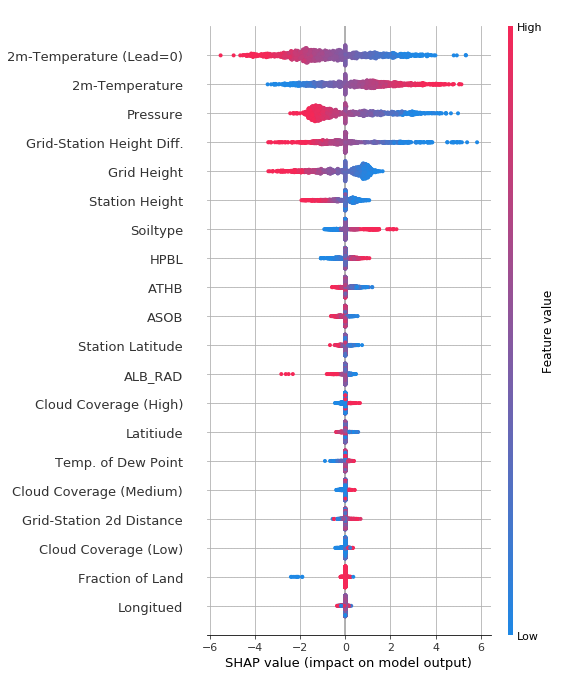

In [140]:
shap.summary_plot(shap_values_july_afternoon[0], shap_test_data, plot_type=plot_type)

### Get for each (Month/Time) type a vector with the mean absolute feature importance of each feature and plot the difference in mean absolut feature importance for different data splits

In [144]:
mean_absolute_feature_importance_january_night = getMeanAbsoluteImportanceByFeature(shap_values_jan_night[0], test_data.columns)
mean_absolute_feature_importance_january_afternoon = getMeanAbsoluteImportanceByFeature(shap_values_jan_afternoon[0], test_data.columns)
mean_absolute_feature_importance_july_night = getMeanAbsoluteImportanceByFeature(shap_values_july_night[0], test_data.columns)
mean_absolute_feature_importance_july_afternoon = getMeanAbsoluteImportanceByFeature(shap_values_july_afternoon[0], test_data.columns)

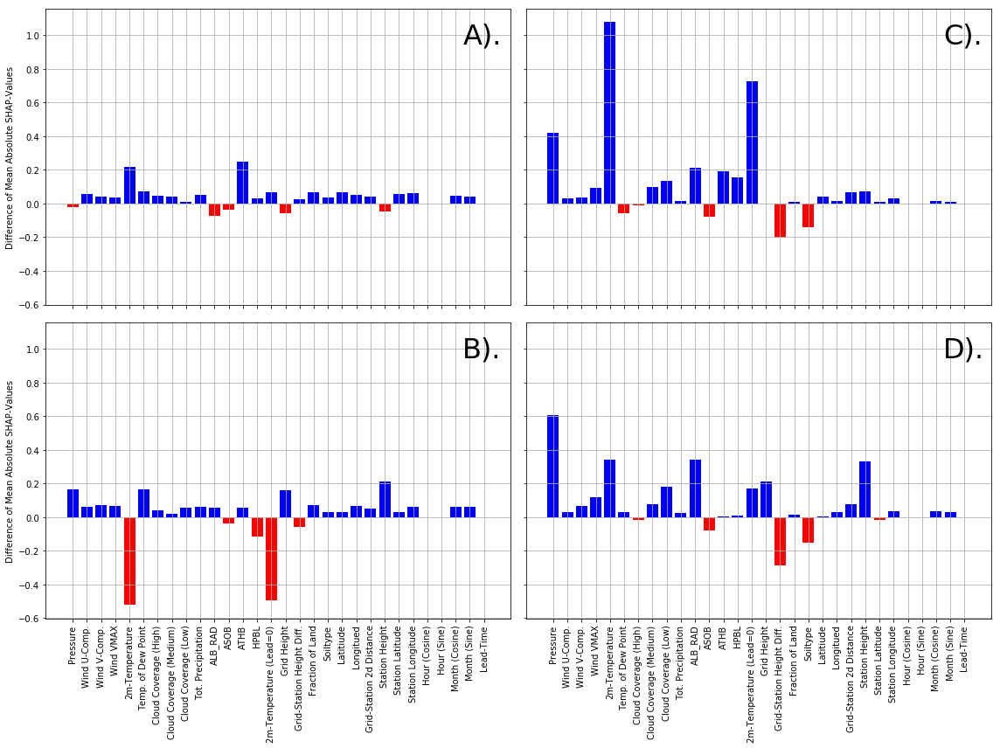

In [145]:
feature_importance_difference_january_diurnal = (mean_absolute_feature_importance_january_night-mean_absolute_feature_importance_january_afternoon).values[0]
feature_importance_difference_july_diurnal = (mean_absolute_feature_importance_july_night-mean_absolute_feature_importance_july_afternoon).values[0]
feature_importance_difference_night_seasonal = (mean_absolute_feature_importance_january_night-mean_absolute_feature_importance_july_night).values[0]
feature_importance_difference_afternoon_seasonal = (mean_absolute_feature_importance_january_afternoon-mean_absolute_feature_importance_july_afternoon).values[0]


fig, ax = plt.subplots(2,2, figsize=(16,12), sharex=True, sharey=True)
plt.rcParams['axes.grid'] = True
plt.xticks(np.arange(0,30), rotation='vertical')
for idx, feature_importance_difference in enumerate([feature_importance_difference_january_diurnal, feature_importance_difference_july_diurnal, feature_importance_difference_night_seasonal, feature_importance_difference_afternoon_seasonal]):
    colors = ["r" if i < 0 else "b" for i in feature_importance_difference]
    ax[idx%2, idx//2].bar(np.arange(0,30), feature_importance_difference, color=colors)
    
for axis in fig.axes:
    plt.sca(axis)
    plt.xticks(rotation=90)
    
for idx, letter in enumerate(['A', 'B', 'C', 'D']):
    ax[idx%2, idx//2].text(27.5, 0.95, "%s)." % letter, fontsize=32)
    
ax[1,0].set_xticklabels(test_data.columns[2:-1])
ax[1,1].set_xticklabels(test_data.columns[2:-1])

ax[0,0].set_ylabel('Difference of Mean Absolute SHAP-Values')
ax[1,0].set_ylabel('Difference of Mean Absolute SHAP-Values')
fig.tight_layout()
plt.show()

# Backup (not used)

### Get for each (Month/Time) type a vector with the rank of each feature and plot the difference in rank for different data splits

In [141]:
feature_rank_january_night = getImportanceIdxByFeature(shap_values_jan_night[0], test_data.columns)
feature_rank_january_afternoon = getImportanceIdxByFeature(shap_values_jan_afternoon[0], test_data.columns)
feature_rank_july_night = getImportanceIdxByFeature(shap_values_july_night[0], test_data.columns)
feature_rank_july_afternoon = getImportanceIdxByFeature(shap_values_july_afternoon[0], test_data.columns)

In [142]:
(feature_rank_january_night-feature_rank_january_afternoon).values

array([[ 2, -2,  2,  0, -2, -2,  3,  0,  0, -1,  1,  1, -2,  1,  0,  0,
         0, -5,  1, -2,  3,  1,  0,  0, -2,  0, -1,  2,  2,  0]])

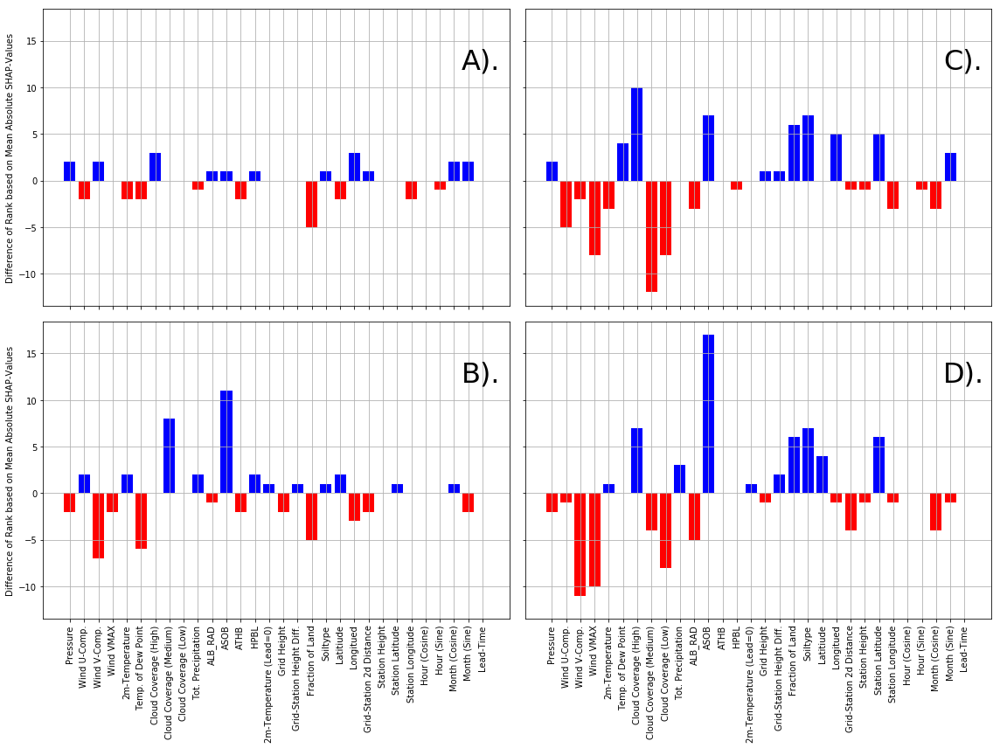

In [143]:
feature_rank_difference_january_diurnal = (feature_rank_january_night-feature_rank_january_afternoon).values[0]
feature_rank_difference_july_diurnal = (feature_rank_july_night-feature_rank_july_afternoon).values[0]
feature_rank_difference_night_seasonal = (feature_rank_january_night-feature_rank_july_night).values[0]
feature_rank_difference_afternoon_seasonal = (feature_rank_january_afternoon-feature_rank_july_afternoon).values[0]


fig, ax = plt.subplots(2,2, figsize=(16,12), sharex=True, sharey=True)
plt.rcParams['axes.grid'] = True
plt.xticks(np.arange(0,30), rotation='vertical')
for idx, feature_rank_difference in enumerate([feature_rank_difference_january_diurnal, feature_rank_difference_july_diurnal, feature_rank_difference_night_seasonal, feature_rank_difference_afternoon_seasonal]):
    colors = ["r" if i < 0 else "b" for i in feature_rank_difference]
    ax[idx%2, idx//2].bar(np.arange(0,30), feature_rank_difference, color=colors)
    
for axis in fig.axes:
    plt.sca(axis)
    plt.xticks(rotation=90)
    
for idx, letter in enumerate(['A', 'B', 'C', 'D']):
    ax[idx%2, idx//2].text(27.5, 12, "%s)." % letter, fontsize=32)
    
ax[1,0].set_xticklabels(test_data.columns[2:-1])
ax[1,1].set_xticklabels(test_data.columns[2:-1])

ax[0,0].set_ylabel('Difference of Rank based on Mean Absolute SHAP-Values')
ax[1,0].set_ylabel('Difference of Rank based on Mean Absolute SHAP-Values')
fig.tight_layout()
plt.show()

# Experiment with La Brévine (high diurnal effect (cosine))

### Prepare data La Brévine

In [ ]:
# fix seed to randomly sample 1000 samples from ~1M train points
seed = 17257
# select points in january and july from training set to train explanation model
brevine_train_data_set = train_data[train_data['Station'] == 852]
brevine_test_data_set = test_data[test_data['Station'] == 852]

In [ ]:
#explanation_training_set = jan_train_data_set.sample(n=100000, random_state=seed)
explanation_training_set = brevine_train_data_set
explanation_training_data = explanation_training_set.iloc[:,2:-1]
# select randomly test points from test set to calculate SHAP values
shap_test_set = brevine_test_data_set
shap_test_data = shap_test_set.iloc[:,2:-1]

In [ ]:
start = time()
dense_train_data = shap.kmeans(explanation_training_data, 200)
print("Run Time for KMeans: %ss" % str(time() - start))

In [ ]:
explainer = shap.KernelExplainer(f, dense_train_data)

In [ ]:
if load_existing:
    with open('/mnt/ds3lab-scratch/ninow/final_results/network/model_predictions/knn_1/shap/station_shap_values/shap_values_brevine_k_200_nsamples_150.pkl','rb') as handle:
        shap_values_brevine = pkl.load(handle)    
else:
    shap_values_brevine = explainer.shap_values(shap_test_data, nsamples=150)

In [ ]:
if not load_existing:
    with open('/home/ninow/master_thesis/code/project/results/runs/knn_1/shap/shap_values_brevine_k_200_nsamples_150.pkl','wb') as handle:
        pkl.dump(shap_values_brevine, handle, protocol=pkl.HIGHEST_PROTOCOL)

In [ ]:
shap.force_plot(shap_values_brevine[0][4], shap_test_data.iloc[0,:])

In [ ]:
shap.force_plot(shap_values_brevine[0], shap_test_data)

In [ ]:
shap.summary_plot(shap_values_brevine[0], shap_test_data, plot_type=plot_type)

# Experiment with Mottec (high diurnal error (-cosine))

### Prepare data Mottec

In [ ]:
# fix seed to randomly sample 1000 samples from ~1M train points
seed = 17257
# get station_id for mottec (statin_idx = 103)
mottec_id = stations[103].item()
# select points in january and july from training set to train explanation model
mottec_train_data_set = train_data[train_data['Station'] == mottec_id]
mottec_test_data_set = test_data[test_data['Station'] == mottec_id]

In [ ]:
#explanation_training_set = jan_train_data_set.sample(n=100000, random_state=seed)
explanation_training_set = mottec_train_data_set
explanation_training_data = explanation_training_set.iloc[:,2:-1]
# select randomly test points from test set to calculate SHAP values
shap_test_set = mottec_test_data_set
shap_test_data = shap_test_set.iloc[:,2:-1]

In [ ]:
dense_train_data = shap.kmeans(explanation_training_data, 200)

In [ ]:
explainer = shap.KernelExplainer(f, dense_train_data)

In [ ]:
if load_existing:
    with open('/mnt/ds3lab-scratch/ninow/final_results/network/model_predictions/knn_1/shap/station_shap_values/shap_values_mottec_k_200_nsamples_150.pkl','rb') as handle:
        shap_values_mottec = pkl.load(handle)    
else:
    shap_values_mottec = explainer.shap_values(shap_test_data, nsamples=150)

In [ ]:
if not load_existing:
    with open('/home/ninow/master_thesis/code/project/results/runs/knn_1/shap/shap_values_mottec_k_200_nsamples_150.pkl','wb') as handle:
        pkl.dump(shap_values_mottec, handle, protocol=pkl.HIGHEST_PROTOCOL)

In [ ]:
shap.force_plot(shap_values_mottec[0][4], shap_test_data.iloc[0,:])

In [ ]:
shap.force_plot(shap_values_mottec[0], shap_test_data)

# Experiment with Lachen / Galgenen (low diurnal error)

### Prepare data Lachen / Galgenen

In [ ]:
# fix seed to randomly sample 1000 samples from ~1M train points
seed = 17257
# get station_id for Lachen / Galgenen (statin_idx = 114 )
lachen_galgen_id = stations[114].item()
# select points in january and july from training set to train explanation model
lachen_galgen_train_set = train_data[train_data['Station'] == lachen_galgen_id]
lachen_galgen_test_set = test_data[test_data['Station'] == lachen_galgen_id]

In [ ]:
#explanation_training_set = jan_train_data_set.sample(n=100000, random_state=seed)
explanation_training_set = lachen_galgen_train_set
explanation_training_data = explanation_training_set.iloc[:,2:-1]
# select randomly test points from test set to calculate SHAP values
shap_test_set = lachen_galgen_test_set
shap_test_data = shap_test_set.iloc[:,2:-1]

In [ ]:
dense_train_data = shap.kmeans(explanation_training_data, 200)

In [ ]:
explainer = shap.KernelExplainer(f, dense_train_data)

In [ ]:
if load_existing:
    with open('/mnt/ds3lab-scratch/ninow/final_results/network/model_predictions/knn_1/shap/station_shap_values/shap_values_lachen_galgen_k_200_nsamples_150.pkl','rb') as handle:
        shap_values_lachen_galgen = pkl.load(handle)    
else:
    shap_values_lachen_galgen = explainer.shap_values(shap_test_data, nsamples=150)

In [ ]:
if not load_existing:
    with open('/home/ninow/master_thesis/code/project/results/runs/knn_1/shap/shap_values_lachen_galgen_k_200_nsamples_150.pkl','wb') as handle:
        pkl.dump(shap_values_lachen_galgen, handle, protocol=pkl.HIGHEST_PROTOCOL)

In [ ]:
shap.force_plot(shap_values_lachen_galgen[0][4], shap_test_data.iloc[0,:])

In [ ]:
shap.force_plot(shap_values_lachen_galgen[0], shap_test_data)

In [ ]:
shap.summary_plot(shap_values_lachen_galgen[0], shap_test_data, plot_type=plot_type)

# Experiment with Grimsel Hospitz (best forecast skill, 65%)

### Prepare data Grimsel Hospitz

In [ ]:
# fix seed to randomly sample 1000 samples from ~1M train points
seed = 17257
# get station_id for Grimsel Hospitz (statin_idx = 83 )
grimsel_id = stations[83].item()
print(grimsel_id)
# select points in january and july from training set to train explanation model
grimsel_train_set = train_data[train_data['Station'] == grimsel_id]
grimsel_test_set = test_data[test_data['Station'] == grimsel_id]

In [ ]:
#explanation_training_set = jan_train_data_set.sample(n=100000, random_state=seed)
explanation_training_set = grimsel_train_set
explanation_training_data = explanation_training_set.iloc[:,2:-1]
# select randomly test points from test set to calculate SHAP values
shap_test_set = grimsel_test_set
shap_test_data = shap_test_set.iloc[:,2:-1]

In [ ]:
dense_train_data = shap.kmeans(explanation_training_data, 200)

In [ ]:
explainer = shap.KernelExplainer(f, dense_train_data)

In [ ]:
if load_existing:
    with open('/mnt/ds3lab-scratch/ninow/final_results/network/model_predictions/knn_1/shap/station_shap_values/shap_values_grimsel_k_200_nsamples_150.pkl','rb') as handle:
        shap_values_grimsel = pkl.load(handle)    
else:
    shap_values_grimsel = explainer.shap_values(shap_test_data, nsamples=150)

In [ ]:
if not load_existing:
    with open('/home/ninow/master_thesis/code/project/results/runs/knn_1/shap/shap_values_grimsel_k_200_nsamples_150.pkl','wb') as handle:
        pkl.dump(shap_values_grimsel, handle, protocol=pkl.HIGHEST_PROTOCOL)

In [ ]:
shap.force_plot(shap_values_grimsel[0][4], shap_test_data.iloc[0,:])

In [ ]:
shap.force_plot(shap_values_grimsel[0], shap_test_data)

In [ ]:
shap.summary_plot(shap_values_grimsel[0], shap_test_data, plot_type=plot_type)

# Experiment with complete Grid (16061903)

### We see that water has feature value "Soiltype == 1.0"

In [ ]:
plt.figure(figsize=(16,9))
plt.imshow(complete_grid_data_set['Soiltype'].reshape((674,1058)))
plt.colorbar()
plt.gca().invert_yaxis()
plt.show()

#### Split train test set to water and not water

In [3]:
# select points in january and july from training set to train explanation model
no_water_train_set = complete_grid_data_set[complete_grid_data_set['Soiltype'] < 1]
water_test_set = complete_grid_data_set[complete_grid_data_set['Soiltype'] == 1.0]

NameError: name 'complete_grid_data_set' is not defined

In [ ]:
# fix seed to randomly sample 1000 samples from ~1M train points
seed = 17257
# training points to be used in K-means generating reference values
explanation_training_set = no_water_train_set
explanation_training_data = explanation_training_set


In [ ]:
# test points to calculate SHAP values
shap_test_set = water_test_set.sample(n=1000, random_state=seed)
shap_test_data = shap_test_set

In [ ]:
start = time()
dense_train_data = shap.kmeans(explanation_training_data, 200)
print("Run Time for KMeans: %ss" % str(time() - start))

In [ ]:
feature = 'Station Height'

fig, ax = plt.subplots(1,4, figsize=(16,6), sharex=True)
ax[0].hist(train_data[feature])
ax[1].hist(water_test_set[feature])
ax[2].hist(no_water_train_set[feature])
ax[3].hist(pd.DataFrame(data=dense_train_data.data, columns=test_data.columns[2:-1])[feature])
plt.show()

In [ ]:
set(train_data['Grid Height']), set(water_test_set['Grid Height']), set(no_water_train_set['Grid Height'])

In [ ]:
train_data['Grid Height']

In [ ]:
set(pd.DataFrame(data=dense_train_data.data, columns=test_data.columns[2:-1])['Grid Height'])

In [ ]:
explainer = shap.KernelExplainer(f, dense_train_data)

In [ ]:
load_existing = False
if load_existing:
    with open('/mnt/ds3lab-scratch/ninow/final_results/network/model_predictions/knn_1/shap/shap_values_water_test_1000_k_200_nsamples_150_corrected.pkl','rb') as handle:
        shap_values_water = pkl.load(handle)    
else:
    shap_values_water = explainer.shap_values(shap_test_data, nsamples=150)
load_existing = True

In [ ]:
with open('/mnt/ds3lab-scratch/ninow/final_results/network/model_predictions/knn_1/shap/shap_values_water_test_1000_k_200_nsamples_150.pkl','wb') as handle:
    pkl.dump(shap_values_water, handle, protocol=pkl.HIGHEST_PROTOCOL)

In [ ]:
shap.force_plot(shap_values_water[0][5], shap_test_data.iloc[0,:])

In [ ]:
shap.force_plot(shap_values_water[0], shap_test_data)

In [ ]:
shap.summary_plot(shap_values_water[0], shap_test_data, plot_type='violin')

### Load and dump calculated SHAP-values

In [ ]:
with open('/home/ninow/master_thesis/code/project/results/runs/knn_1/shap/shap_values_train_50000_test_1000_permutation_150.pkl','wb') as handle:
    pkl.dump(shap_values, handle, protocol=pkl.HIGHEST_PROTOCOL)

In [ ]:
with open('/home/ninow/master_thesis/code/project/results/runs/plot_run_error_over_time/shap/shap_values.pkl','rb') as handle:
    shap_values = pkl.load(handle)

# Feature Interpretation of Error Prediction

# Experiment with all data

### Prepare data

In [ ]:
# fix seed to randomly sample 1000 samples from ~1M train points
seed = 17257
# select randomly points from training set to train explanation model
#explanation_training_set = train_data.sample(n=100000, random_state=seed)
explanation_training_set = train_data
explanation_training_data = explanation_training_set.iloc[:,2:-2]


In [ ]:
# select randomly test points from test set to calculate SHAP values
shap_test_set = test_data.sample(n=5000, random_state=seed)
shap_test_data = shap_test_set.iloc[:,2:-2]

In [ ]:
start = time()
dense_train_data = shap.kmeans(explanation_training_data, 200)
print("Run Time for KMeans: %ss" % str(time() - start))

In [ ]:
explainer = shap.KernelExplainer(f, dense_train_data)

In [ ]:
if load_existing:
    with open('/mnt/ds3lab-scratch/ninow/final_results/network/model_predictions/knn_1/shap/shap_values_all_train_error_prediction_k_200_test_5000_nsamples_150.pkl','rb') as handle:
        all_data_shap_values = pkl.load(handle)
else:
    all_data_shap_values = explainer.shap_values(shap_test_data, nsamples=150)

In [ ]:
if not load_existing:
    with open('/mnt/ds3lab-scratch/ninow/final_results/network/model_predictions/knn_1/shap/shap_values_all_train_error_prediction_k_200_test_5000_nsamples_150.pkl','wb') as handle:
        pkl.dump(all_data_shap_values, handle, protocol=pkl.HIGHEST_PROTOCOL)

In [ ]:
shap.force_plot(all_data_shap_values[0][4], shap_test_data.iloc[0,:])

In [ ]:
shap.force_plot(all_data_shap_values[0][::10], shap_test_data[::10])

In [ ]:
shap.summary_plot(all_data_shap_values[0], shap_test_data, plot_type=plot_type)

In [ ]:
for feature in shap_test_data.columns:
    shap.dependence_plot(feature, all_data_shap_values[0], shap_test_data)

# Feature Interpretation of Error Prediction with dropout

# Experiment with all data

### Prepare data

In [ ]:
# fix seed to randomly sample 1000 samples from ~1M train points
seed = 17257
# select randomly points from training set to train explanation model
#explanation_training_set = train_data.sample(n=100000, random_state=seed)
explanation_training_set = train_data
explanation_training_data = explanation_training_set.iloc[:,2:-2]


In [ ]:
### Load network

In [ ]:
config = pkl.load(open('/mnt/ds3lab-scratch/ninow/final_results/network/model_predictions/knn_1/shap/config.pkl', 'rb'))
config['experiment_path'] = '/mnt/ds3lab-scratch/ninow/final_results/variational_dropout/error_prediction/dropout_0_1/'
model = config['model']
model['path'] = '/mnt/ds3lab-scratch/ninow/final_results/variational_dropout/error_prediction/dropout_0_1/models/FC_L3_1024_256_64_TD_GTI_STI.txt'
config['model'] = model
config['trained_model_output_path'] = '/mnt/ds3lab-scratch/ninow/final_results/variational_dropout/error_prediction/dropout_0_1/FC_L3_1024_256_64_TD_GTI_STI_grid_1_bs_64_tf_0.1_optim_sgd_lr_0.0005_sl_24/'

In [ ]:
# assign all program arguments to local variables
with open(config['model']['path']) as handle:
    ModelDict = json.loads(handle.read())

# initialize network, optimizer and loss function
net = model_factory(model_dict=ModelDict, params=len(config['input_parameters']),
                             time_invariant_params=len(config['grid_time_invariant_parameters']),
                             grid=config['grid_size'], prediction_times=config['prediction_times'])

# get optimizer config
optimizer_config = config['optimizer']

# if not explicitly specified, don't use regularization
if 'weight_decay' not in optimizer_config: optimizer_config['weight_decay'] = 0

optimizer = torch.optim.SGD(net.parameters(), lr=optimizer_config['learning_rate'],
                            momentum=optimizer_config['momentum'], weight_decay=optimizer_config['weight_decay'])


net, optimizer, *_ = load_checkpoint(config['trained_model_output_path'] + '/stored_models/run_0', model=net,
                                                optimizer=optimizer)

if torch.cuda.is_available():
    net.cuda()

# we do not train, but only output the evaluation of the network on train and test data
net.eval()

In [ ]:
# select randomly test points from test set to calculate SHAP values
shap_test_set = test_data.sample(n=5000, random_state=seed)
shap_test_data = shap_test_set.iloc[:,2:-2]

In [ ]:
start = time()
dense_train_data = shap.kmeans(explanation_training_data, 200)
print("Run Time for KMeans: %ss" % str(time() - start))

In [ ]:
explainer = shap.KernelExplainer(f, dense_train_data)

In [ ]:
load_existing=False
if load_existing:
    with open('/mnt/ds3lab-scratch/ninow/final_results/network/model_predictions/knn_1/shap/shap_values_all_train_error_prediction_k_200_test_5000_nsamples_150.pkl','rb') as handle:
        all_data_shap_values = pkl.load(handle)
else:
    all_data_shap_values = explainer.shap_values(shap_test_data, nsamples=150)

In [ ]:
if not load_existing:
    with open('/mnt/ds3lab-scratch/ninow/final_results/network/model_predictions/knn_1/shap/shap_values_all_train_error_prediction_k_200_test_5000_nsamples_150.pkl','wb') as handle:
        pkl.dump(all_data_shap_values, handle, protocol=pkl.HIGHEST_PROTOCOL)

In [ ]:
shap.force_plot(all_data_shap_values[0][4], shap_test_data.iloc[0,:])

In [ ]:
shap.force_plot(all_data_shap_values[0][::10], shap_test_data[::10])

In [ ]:
shap.summary_plot(all_data_shap_values[0], shap_test_data, plot_type=plot_type)

In [ ]:
for feature in shap_test_data.columns:
    shap.dependence_plot(feature, all_data_shap_values[0], shap_test_data)

# Correlation analysis for Error Prediction

### Create data frame with column names for SHAP values

In [ ]:
shap_data_frame = pd.DataFrame(all_data_shap_values[0][:,:-1], columns=shap_test_data.columns)

### Calculate mean absolute impact & 20 most impactful features

In [ ]:
data_column_names = shap_test_data.columns
mean_absolute_impact = np.mean(np.absolute(all_data_shap_values[0][:,:-1]), axis=0)
most_impactful_features_indices = np.argsort(mean_absolute_impact)[::-1][:20]
most_impactful_features_name = list(data_column_names[most_impactful_features_indices])

### Calculate correlation in data and SHAP values

In [ ]:
data_most_impactful = shap_test_data[most_impactful_features_name]
shap_most_impactful = shap_data_frame[most_impactful_features_name]

In [ ]:
corr_data = data_most_impactful.corr().round(3)
corr_shap = shap_most_impactful.corr().round(3)

In [ ]:
corr_data

In [ ]:
corr_shap

In [ ]:
corr_shap[np.absolute(corr_shap) >= 0.3]

In [ ]:
columns_with_mid_high_correlation = ['2m-Temperature', '2m-Temperature (Lead=0)', 'Pressure', 'Grid Height', 'Station Height', 'Grid-Station Height Diff.', 'Temp. of Dew Point', 'ASOB', 'Month (Cosine)', 'ALB_RAD', 'ATHB']

In [ ]:
def highlight_mid_correlation(s):
    is_mid_correlation = np.abs(s) >= 0.3
    not_one = s != 1
    is_mid_correlation_without_identity = ar(is_mid_correlation) & ar(not_one)
    return ['background-color: lemonchiffon' if v else '' for v in is_mid_correlation_without_identity]

def highlight_high_correlation(s):
    is_high_correlation = np.abs(s) >=0.5
    not_one = s != 1
    is_high_correlation_without_identity = ar(is_high_correlation) & ar(not_one)
    return ['background-color: orange' if v else '' for v in is_high_correlation_without_identity]

mid_high_correlated_table = corr_shap[columns_with_mid_high_correlation].loc[columns_with_mid_high_correlation]
styled_table = mid_high_correlated_table.style.apply(highlight_mid_correlation).apply(highlight_high_correlation)
styled_table

In [ ]:
mid_high_correlated_table.to_csv('/home/ninow/master_thesis/code/project/results/feature_interpretation/shap_correlation_table_data.csv')